# Measuring all 5 protocols and 4 player sizes (720p+) (quality auto) on the seven vantage points -- 2 videos, one resolver per video

In [1]:
import pandas as pd
import sqlite3
import datetime
import numpy as np
import matplotlib as mpl
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
from matplotlib.ticker import PercentFormatter
import math
import Cdf
import Pmf
from urllib.parse import urlparse, parse_qs
mpl.rcParams['figure.dpi'] = 200
okabe_ito = ["#000000", "#E69F00", "#56B4E9", "#009E73", "#F0E442", "#0072B2", "#D55E00", "#CC79A7"]
sns.set_context('paper')
sns.set_palette(sns.color_palette(okabe_ito))
#https://stackoverflow.com/a/45846841
def human_format(num):
    num = float('{:.3g}'.format(num))
    magnitude = 0
    while abs(num) >= 1000:
        magnitude += 1
        num /= 1000.0
    return '{}{}'.format('{:f}'.format(num).rstrip('0').rstrip('.'), ['', 'K', 'M', 'B', 'T'][magnitude])
def make_cdf(series):
    return series.value_counts(normalize=True).sort_index().cumsum()
def make_pdf(series):
    return series.value_counts(normalize=True).sort_index()
from mpl_toolkits.axes_grid1 import make_axes_locatable
from datetime import datetime
mpl.rcParams['figure.dpi'] = 100

In [2]:
conn = sqlite3.connect('first-msm-run-on-all-vms/web-performance-youtube-merged.db')

#### remove measurements where googlevideo subdomain changed

In [303]:
googlevideo_subdomains = pd.read_sql_query("SELECT msm_id, name FROM page_resources", conn)
googlevideo_subdomains['googlevideo'] = googlevideo_subdomains.name.str.split('/').str[2]

In [304]:
googlevideo_subdomains.groupby('msm_id', as_index=False).agg({'googlevideo':pd.Series.nunique}).sort_values('googlevideo').googlevideo.value_counts()

1    54842
2     2343
3      449
4        1
Name: googlevideo, dtype: int64

In [305]:
msm_ids_to_remove = googlevideo_subdomains.groupby('msm_id', as_index=False).filter(lambda x: pd.Series.nunique(x['googlevideo']) > 1).msm_id.unique().tolist()

#### remove measurement runs where resolution failed in the lookups table -- sadly the timestamps of dnsproxy are not reliable, so we cannot know from just looking at the lookups at which point of playback it failed -- in this run no googlevideo.com resolution failed, however removing them anyway in case it skews results -- also all errors happened over DoUDP

In [306]:
failed_lookups = pd.read_sql_query('SELECT measurement_id as msm_id FROM lookups WHERE status <> "NOERROR"', conn).msm_id.tolist()

In [307]:
len(failed_lookups)

583

In [308]:
msm_ids_to_remove.extend(failed_lookups)

In [309]:
#conn = sqlite3.connect('web-performance-youtube-two-videos.db')
measurements = pd.read_sql_query("SELECT * FROM measurements", conn)
measurements
#conn.close()

,msm_id,py_time,js_time,resource_time_origin,protocol,server,domain,vantagePoint,timestamp,suggested_quality,player_width,player_height,start_time,play_time,video_ids,cacheWarming,error
0,a019d80e-bda1-6022-2330-422d0ff0b319,-1,-1.000000e+00,-1.000000e+00,tls,154.0.173.6,aqz-KE-bpKQ,Africa South,2022-03-07 17:18:09.937705,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,failed loading player for cache warming ### Me...
1,ed2ebf9a-57a5-ed44-5b2a-012b8fb3755c,-1,-1.000000e+00,-1.000000e+00,tls,185.121.25.64,aqz-KE-bpKQ,Africa South,2022-03-07 17:22:38.140803,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,
2,544b9c53-fb16-e2fe-5fb0-0268b693a586,1646673799468697071,1.646674e+12,1.646674e+12,tls,185.121.25.64,aqz-KE-bpKQ,Africa South,2022-03-07 17:22:43.846963,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,
3,30b40159-f0f0-88d6-3bc6-a1ea77c5ef1f,-1,-1.000000e+00,-1.000000e+00,tls,185.121.25.64,lqiN98z6Dak,Africa South,2022-03-07 17:23:21.023793,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,
4,7a1a699c-6c32-6b28-f8f1-cac46c3d96c8,1646673842497402384,1.646674e+12,1.646674e+12,tls,185.121.25.64,lqiN98z6Dak,Africa South,2022-03-07 17:23:26.657266,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115356,892bb7e6-6971-f8e2-dbad-f9193758c29c,1647109802531703775,1.647110e+12,1.647110e+12,udp,94.140.14.59,lqiN98z6Dak,US West,2022-03-12 18:29:29.181181,auto,2560,1440,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,
115357,31c645c5-08b4-ebaf-9448-a759575f57d7,-1,-1.000000e+00,-1.000000e+00,udp,94.140.14.59,aqz-KE-bpKQ,US West,2022-03-12 18:30:07.431304,auto,3840,2160,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,
115358,651c800b-d38c-86f8-5228-bdbb1bf68384,1647109844114445223,1.647110e+12,1.647110e+12,udp,94.140.14.59,aqz-KE-bpKQ,US West,2022-03-12 18:30:10.764789,auto,3840,2160,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,
115359,8cbf089c-63bb-f1af-efce-73aca6d84a1f,-1,-1.000000e+00,-1.000000e+00,udp,94.140.14.59,lqiN98z6Dak,US West,2022-03-12 18:30:45.815109,auto,3840,2160,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,


In [310]:
#measurements = measurements[measurements.timestamp < '2022-03-11 17:30']

# data pre-processing

In [311]:
measurements.groupby(['cacheWarming', 'error']).agg({'msm_id':pd.Series.nunique})

msm_id
cacheWarming error                                                     
0                                                                 57635
             failed loading player ### Message: \n                    2
             failed loading player ### Message: javascript e...       1
             failed switching selenium focus to youtube ifra...      24
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
             failed switching selenium focus to youtube ifra...       1
1                                                                 57679
             failed loading player for cache warming ### Mes...       2

In [312]:
measurements = measurements[measurements.error == '']

remove cache warming runs early to reduce processing later on

In [313]:
measurements = measurements[measurements.cacheWarming == 0]

In [314]:
measurements.groupby('vantagePoint', as_index=False).agg({'msm_id':pd.Series.nunique})

,vantagePoint,msm_id
0,Africa South,8218
1,Asia Pacific Northeast,8237
2,Asia Pacific Southeast,8236
3,Europe Central,8238
4,South America East,8232
5,US East,8236
6,US West,8238


In [315]:
af_measurements = pd.read_sql_query("SELECT * FROM measurements WHERE vantagePoint = 'Africa South'", conn)
af_measurements

,msm_id,py_time,js_time,resource_time_origin,protocol,server,domain,vantagePoint,timestamp,suggested_quality,player_width,player_height,start_time,play_time,video_ids,cacheWarming,error
0,a019d80e-bda1-6022-2330-422d0ff0b319,-1,-1.000000e+00,-1.000000e+00,tls,154.0.173.6,aqz-KE-bpKQ,Africa South,2022-03-07 17:18:09.937705,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,failed loading player for cache warming ### Me...
1,ed2ebf9a-57a5-ed44-5b2a-012b8fb3755c,-1,-1.000000e+00,-1.000000e+00,tls,185.121.25.64,aqz-KE-bpKQ,Africa South,2022-03-07 17:22:38.140803,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,
2,544b9c53-fb16-e2fe-5fb0-0268b693a586,1646673799468697071,1.646674e+12,1.646674e+12,tls,185.121.25.64,aqz-KE-bpKQ,Africa South,2022-03-07 17:22:43.846963,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,
3,30b40159-f0f0-88d6-3bc6-a1ea77c5ef1f,-1,-1.000000e+00,-1.000000e+00,tls,185.121.25.64,lqiN98z6Dak,Africa South,2022-03-07 17:23:21.023793,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,
4,7a1a699c-6c32-6b28-f8f1-cac46c3d96c8,1646673842497402384,1.646674e+12,1.646674e+12,tls,185.121.25.64,lqiN98z6Dak,Africa South,2022-03-07 17:23:26.657266,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16476,f7f9b2d5-4f9c-e7cd-40ab-be4bea662e21,1647110003151453521,1.647110e+12,1.647110e+12,udp,185.121.25.64,lqiN98z6Dak,Africa South,2022-03-12 18:32:47.758479,auto,2560,1440,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,
16477,17e883fb-e8f2-1a6e-a266-44818490b97c,-1,-1.000000e+00,-1.000000e+00,udp,185.121.25.64,aqz-KE-bpKQ,Africa South,2022-03-12 18:33:27.979132,auto,3840,2160,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,
16478,bd8ae6fb-4b91-e26b-9faf-7b282fafae46,1647110048819265099,1.647110e+12,1.647110e+12,udp,185.121.25.64,aqz-KE-bpKQ,Africa South,2022-03-12 18:33:33.368348,auto,3840,2160,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,
16479,b7d80371-e689-6041-d515-6728c0adf342,-1,-1.000000e+00,-1.000000e+00,udp,185.121.25.64,lqiN98z6Dak,Africa South,2022-03-12 18:34:10.466761,auto,3840,2160,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",1,


In [316]:
af_measurements['player_width'] = af_measurements['player_width'].astype(str)
af_measurements['player_height'] = af_measurements['player_height'].astype(str)
af_measurements['player_dimensions'] = af_measurements['player_width']+"x"+af_measurements['player_height']
af_measurements[af_measurements.cacheWarming == 0].groupby(['domain', 'player_dimensions', 'protocol']).agg({'msm_id':'count'})

msm_id
domain      player_dimensions protocol        
aqz-KE-bpKQ 1280x720          https        206
                              quic         206
                              tcp          206
                              tls          206
                              udp          206
            1920x1080         https        206
                              quic         206
                              tcp          206
                              tls          206
                              udp          206
            2560x1440         https        206
                              quic         206
                              tcp          206
                              tls          206
                              udp          206
            3840x2160         https        206
                              quic         206
                              tcp          206
                              tls          206
                              udp          206
lqiN98z6Dak 1280x720          https        206
                              quic         206
                              tcp          206
                              tls          206
                              udp          206
            1920x1080         https        206
                              quic         206
                              tcp          206
                              tls          206
                              udp          206
            2560x1440         https        206
                              quic         206
                              tcp          206
                              tls          206
                              udp          206
            3840x2160         https        206
                              quic         206
                              tcp          206
                              tls          206
                              udp          206

In [317]:
af_measurements['timestamp'] = pd.to_datetime(af_measurements['timestamp'])

In [318]:
af_measurements[(af_measurements.error == '') & (af_measurements.cacheWarming == 0)].groupby(['domain', 'player_dimensions', 'protocol']).agg({'msm_id':'count'})

msm_id
domain      player_dimensions protocol        
aqz-KE-bpKQ 1280x720          https        204
                              quic         203
                              tcp          203
                              tls          205
                              udp          205
            1920x1080         https        206
                              quic         206
                              tcp          205
                              tls          206
                              udp          205
            2560x1440         https        205
                              quic         205
                              tcp          206
                              tls          205
                              udp          203
            3840x2160         https        204
                              quic         206
                              tcp          206
                              tls          206
                              udp          205
lqiN98z6Dak 1280x720          https        206
                              quic         206
                              tcp          206
                              tls          206
                              udp          206
            1920x1080         https        206
                              quic         206
                              tcp          206
                              tls          206
                              udp          206
            2560x1440         https        206
                              quic         206
                              tcp          206
                              tls          206
                              udp          206
            3840x2160         https        205
                              quic         206
                              tcp          206
                              tls          206
                              udp          206

#### runs where the googlevideo subdomain changed -> no clear trend

In [319]:
measurements[measurements.msm_id.isin(msm_ids_to_remove)].groupby(['domain', 'player_width', 'player_height']).size()

domain       player_width  player_height
aqz-KE-bpKQ  1280          720              633
             1920          1080             625
             2560          1440             643
             3840          2160             661
lqiN98z6Dak  1280          720              116
             1920          1080             145
             2560          1440             192
             3840          2160             195
dtype: int64

In [320]:
measurements.msm_id.nunique()

57635

In [321]:
measurements = measurements[~measurements.msm_id.isin(msm_ids_to_remove)]

In [322]:
measurements.msm_id.nunique()

54425

In [323]:
measurements['timestamp'] = pd.to_datetime(measurements['timestamp'])

In [324]:
measurements['player_width'] = measurements['player_width'].astype(str)
measurements['player_height'] = measurements['player_height'].astype(str)
measurements['player_dimensions'] = measurements['player_width']+"x"+measurements['player_height']

In [325]:
measurements[measurements.vantagePoint == 'Africa South'].groupby(['domain', 'player_dimensions', 'protocol']).agg({'msm_id':'count'})

msm_id
domain      player_dimensions protocol        
aqz-KE-bpKQ 1280x720          https         94
                              quic          91
                              tcp           94
                              tls           93
                              udp           91
            1920x1080         https         95
                              quic          94
                              tcp           95
                              tls           94
                              udp           86
            2560x1440         https         95
                              quic          93
                              tcp           93
                              tls           93
                              udp           90
            3840x2160         https         90
                              quic          94
                              tcp           93
                              tls           94
                              udp           91
lqiN98z6Dak 1280x720          https        199
                              quic         198
                              tcp          198
                              tls          195
                              udp          194
            1920x1080         https        193
                              quic         196
                              tcp          200
                              tls          195
                              udp          188
            2560x1440         https        186
                              quic         181
                              tcp          184
                              tls          178
                              udp          182
            3840x2160         https        186
                              quic         186
                              tcp          179
                              tls          179
                              udp          184

In [326]:
measurements[measurements.vantagePoint == 'Europe Central'].groupby(['domain', 'player_dimensions', 'protocol']).agg({'msm_id':'count'})

msm_id
domain      player_dimensions protocol        
aqz-KE-bpKQ 1280x720          https        204
                              quic         206
                              tcp          203
                              tls          206
                              udp          206
            1920x1080         https        204
                              quic         206
                              tcp          205
                              tls          204
                              udp          206
            2560x1440         https        204
                              quic         206
                              tcp          206
                              tls          205
                              udp          206
            3840x2160         https        204
                              quic         206
                              tcp          205
                              tls          204
                              udp          203
lqiN98z6Dak 1280x720          https        205
                              quic         205
                              tcp          206
                              tls          206
                              udp          206
            1920x1080         https        205
                              quic         206
                              tcp          205
                              tls          206
                              udp          206
            2560x1440         https        206
                              quic         205
                              tcp          206
                              tls          205
                              udp          205
            3840x2160         https        206
                              quic         205
                              tcp          204
                              tls          205
                              udp          206

In [327]:
measurements['protocol'] = measurements['protocol'].str.upper()

In [328]:
dns_proto_mapping = {'QUIC':'DoQ', 'HTTPS':'DoH', 'TLS':'DoT', 'TCP':'DoTCP', 'UDP':'DoUDP'}
def map_proto_to_dns(x):
    return dns_proto_mapping[x]
measurements['protocol'] = measurements['protocol'].map(map_proto_to_dns)

In [329]:
cache_warming_failed = pd.read_sql_query("SELECT msm_id as cw_msm_id, protocol, server, domain, vantagePoint, suggested_quality, (player_width || 'x' || player_height) as player_dimensions, timestamp, start_time, play_time, video_ids FROM measurements WHERE error <> '' AND cacheWarming = 1", conn)
cache_warming_failed['timestamp'] = pd.to_datetime(cache_warming_failed['timestamp'])
cache_warming_failed

,cw_msm_id,protocol,server,domain,vantagePoint,suggested_quality,player_dimensions,timestamp,start_time,play_time,video_ids
0,a019d80e-bda1-6022-2330-422d0ff0b319,tls,154.0.173.6,aqz-KE-bpKQ,Africa South,auto,1280x720,2022-03-07 17:18:09.937705,0,30,"aqz-KE-bpKQ, lqiN98z6Dak"
1,c73e8abd-f126-6bae-d417-30fbbf8e5c0e,tls,185.121.25.64,aqz-KE-bpKQ,Africa South,auto,1280x720,2022-03-09 12:15:04.771172,0,30,"aqz-KE-bpKQ, lqiN98z6Dak"


In [330]:
measurements_to_remove_due_to_failed_cachewarming = pd.merge_asof(cache_warming_failed.sort_values('timestamp'), measurements.sort_values('timestamp'), by=['protocol', 'server', 'domain', 'vantagePoint', 'suggested_quality', 'player_dimensions', 'start_time', 'play_time', 'video_ids'], on='timestamp', direction='forward', tolerance=pd.Timedelta("30s")).dropna().msm_id.unique().tolist()
if len(measurements_to_remove_due_to_failed_cachewarming) > 0:
    measurements = measurements[~measurements.msm_id.isin(measurements_to_remove_due_to_failed_cachewarming)]

In [331]:
#af_measurements[af_measurements.timestamp >= datetime.strptime('2022-03-07 17:18:09.937705', "%Y-%m-%d %H:%M:%S.%f")].sort_values('timestamp')

## find the optimal resolution as determined by the youtube player for each run

In [419]:
df_optimal_resolutions = pd.read_sql_query("""
SELECT msm_id, resolution, time FROM nerd_stats
""", conn)

In [420]:
df_optimal_resolutions['current_res'] = df_optimal_resolutions['resolution'].str.split(' / ').str[0]
df_optimal_resolutions['current_res'] = df_optimal_resolutions['current_res'].str.split('@').str[0]
df_optimal_resolutions['optimal_res'] = df_optimal_resolutions['resolution'].str.split(' / ').str[1]
df_optimal_resolutions['optimal_res'] = df_optimal_resolutions['optimal_res'].str.split('@').str[0]
df_optimal_resolutions['time'] = pd.to_datetime(df_optimal_resolutions['time'], unit='ms', origin='unix')

In [421]:
df_optimal_resolutions = df_optimal_resolutions[['msm_id','optimal_res', 'time', 'current_res']]

In [422]:
df_optimal_resolutions.groupby('msm_id').optimal_res.nunique().sort_values()

msm_id
0000c85d-710c-e4df-8f0d-f4bc64dbac17    1
aacae369-63ac-61e1-c21b-e52948cbe03b    1
aacb60e0-2a51-7897-7284-b180451a06c3    1
aacbc6c3-ce5b-789a-172c-f3f9de9f98bd    1
aacc4140-3310-9b62-34be-4c5e80661e30    1
                                       ..
cd163479-7d52-068d-7abc-177f85d5e217    2
1dc270cd-ba20-35f7-1986-7e742e462d15    2
61cb7d44-8969-ae86-9d74-1faa7b78d848    2
230b668a-c2a6-a2fa-b0b4-683775f0466b    2
e1a40d9a-8eea-0755-f7be-928d15a4b3a6    2
Name: optimal_res, Length: 57635, dtype: int64

### filter out measurements where the player changes the optimal resolution within the run (mostly from 4k to 1440p)

In [423]:
s_filter_msm = df_optimal_resolutions.groupby('msm_id').optimal_res.nunique()

In [424]:
s_filter_msm[s_filter_msm > 1].index.tolist()

['0281ff9d-660d-53e7-166e-032c608b9216',
 '02ca93cb-49da-ac7f-d61e-3fbafd8b102c',
 '0345f3ba-80ac-6e95-b7f2-78cda3cdc426',
 '0359dd3d-f503-a641-2e8c-929026059ee7',
 '041b17ed-be65-626c-7231-de4512ac5061',
 '0438cfca-b2f5-9371-7493-b54041199d19',
 '058385f1-3c81-e679-54ef-788eb384edd6',
 '0584efc7-3cde-5eeb-ddaf-fa395089e39a',
 '05b6f059-9eb9-5498-6f8f-0d2b79afa3ad',
 '075f13c9-94f3-e8ef-66c3-df3af99c2ba5',
 '07ca1b9b-1d1d-8c13-4f17-65b3186c93dc',
 '07da1c82-b7b5-1b0b-eeca-db6c702d15d6',
 '082068eb-4499-30db-a7f8-b9f6f4a57ecc',
 '09c3afb8-9d2d-a78c-a8c9-bfe6e9870126',
 '0a14b025-3020-a7cd-56b3-bc8d9a532c8e',
 '0a89e88b-0a93-4784-39f7-d79977f155ee',
 '0ae33cac-34b3-30f0-ef02-a70d3df72915',
 '0b0f9b94-c67a-d4eb-cbf5-2c19581d87fa',
 '0b57ec07-4803-f870-57b1-008d760366fd',
 '0b65606a-9ded-964a-5742-fff05d876742',
 '0bfa8ba9-e840-d0bf-d553-1e3581adcd52',
 '0c09ff96-2a4a-d1ac-fb31-266c6accdb7f',
 '0cc26b5d-91d6-68e6-cfa5-a97c3bdc5152',
 '0ccfc993-0b81-340d-58f3-ff49e0002cb2',
 '0e118943-b8d2-

In [425]:
df_optimal_resolutions[df_optimal_resolutions.msm_id.isin(s_filter_msm[s_filter_msm > 1].index.tolist())].sort_values('time').groupby(['msm_id', 'optimal_res']).agg({'time':'min'}).sort_values('time')

time
msm_id                               optimal_res                              
5ef8a03a-06a9-02cc-cd81-0feb1e2979b1 3840x2160   2022-03-07 19:00:09.670900224
                                     2560x1440   2022-03-07 19:00:27.889999872
05b6f059-9eb9-5498-6f8f-0d2b79afa3ad 3840x2160   2022-03-07 20:29:33.564300032
                                     2560x1440   2022-03-07 20:30:03.950800128
7b682e43-4460-71c2-b6d0-2c088244fd73 3840x2160   2022-03-07 20:45:24.246100224
...                                                                        ...
dd880476-f2ca-e7f2-5316-6a4dc82830a7 3840x2160   2022-03-12 18:30:05.973799936
ab1b34e4-16a2-db47-4cfb-1afd5ea75f43 2560x1440   2022-03-12 18:30:29.725100032
dd880476-f2ca-e7f2-5316-6a4dc82830a7 2560x1440   2022-03-12 18:30:31.681600000
5d9a2aa1-c209-f890-bbf1-e24bd1729469 3840x2160   2022-03-12 18:32:24.946500096
                                     2560x1440   2022-03-12 18:32:55.751399936

[1380 rows x 1 columns]

first idea: we take the nerd stats optimal res at the end of playback (i.e. the furthest in terms of video playback) as the "true" optimal res  ------ probably dumb idea, see example above, for now just filter out the ones with multiple optimal resolutions?

In [426]:
#assert set(df_optimal_resolutions.loc[df_optimal_resolutions.groupby('msm_id').time.idxmax()].msm_id.value_counts().values) == {1}
#assert df_optimal_resolutions.loc[df_optimal_resolutions.groupby('msm_id').time.idxmax()].msm_id.nunique() == measurements.msm_id.nunique()
#df_optimal_resolutions = df_optimal_resolutions.loc[df_optimal_resolutions.groupby('msm_id').time.idxmax()].reset_index(drop=True)


In [427]:
df_msms_with_multiple_opt_res = df_optimal_resolutions.groupby('msm_id', as_index=False).agg(opt_res_num=('optimal_res',pd.Series.nunique), opt_res_list=('optimal_res',pd.Series.unique)).sort_values('opt_res_num')

In [428]:
df_msms_with_multiple_opt_res[df_msms_with_multiple_opt_res.opt_res_num > 1]

,msm_id,opt_res_num,opt_res_list
28857,80af6859-7936-796f-4f41-b82fa931b263,2,"[3840x2160, 2560x1440]"
23027,666f07a7-9355-e339-85b4-f52c7f031b84,2,"[3840x2160, 2560x1440]"
53693,ef0da62c-52c2-4159-16ef-1b75548f12da,2,"[3840x2160, 2560x1440]"
5510,186d51c1-7de5-0c46-8666-91f91c3e11e8,2,"[3840x2160, 2560x1440]"
50297,dfcf0d4f-e30a-37ed-5d03-4bf38a4eedaf,2,"[3840x2160, 2560x1440]"
...,...,...,...
46145,cd163479-7d52-068d-7abc-177f85d5e217,2,"[3840x2160, 2560x1440]"
6765,1dc270cd-ba20-35f7-1986-7e742e462d15,2,"[3840x2160, 2560x1440]"
22016,61cb7d44-8969-ae86-9d74-1faa7b78d848,2,"[3840x2160, 2560x1440]"
7978,230b668a-c2a6-a2fa-b0b4-683775f0466b,2,"[3840x2160, 2560x1440]"


In [429]:
measurements_to_remove = df_msms_with_multiple_opt_res[df_msms_with_multiple_opt_res.opt_res_num > 1].msm_id.unique().tolist()

In [430]:
measurements_to_remove

['80af6859-7936-796f-4f41-b82fa931b263',
 '666f07a7-9355-e339-85b4-f52c7f031b84',
 'ef0da62c-52c2-4159-16ef-1b75548f12da',
 '186d51c1-7de5-0c46-8666-91f91c3e11e8',
 'dfcf0d4f-e30a-37ed-5d03-4bf38a4eedaf',
 'bdbf3775-b465-60a8-08a4-76dc62cff4a7',
 'e0d5c5f0-637f-d04b-5810-4ec4f123dfdc',
 'e89eb685-98b5-f22c-da85-18f5b8cff556',
 '9ecc28fd-dd73-7959-c5b8-7d1c62001869',
 'ded7a3a3-1fb0-38aa-79f4-99d00b86fe79',
 'afdc52eb-f898-f2f2-dd4b-e84c6d35b2db',
 '09c3afb8-9d2d-a78c-a8c9-bfe6e9870126',
 'b68d61c2-0d24-7213-143b-7d4d77573ab1',
 '1fe53601-8c41-143b-5f96-105a1ba0c387',
 'ffff298b-3fff-8159-9ac6-036e0e494386',
 'd68c46f5-d348-1f3d-23cd-5a7903df8850',
 'd5b27188-e696-a3a0-f0c9-174486a992b8',
 'dfd11587-c103-2e7e-8eeb-54dc0af32f01',
 '7dfcf1cb-4d37-6678-b9a3-76db77cc938a',
 '98d31aa0-c76b-1a94-0848-ec6e8c61e12a',
 'c0ed9aa4-6039-bbf4-7cf9-29eb1c679488',
 '3e5747ba-b0e8-f1f7-8b53-4e6533af46bb',
 '880e2744-e5dd-0bc3-6346-205dc4caf4b3',
 'c7bd179c-d75b-9405-b2ec-00f186285012',
 '760605f7-df80-

In [431]:
measurements[measurements.msm_id.isin(measurements_to_remove)].player_dimensions.value_counts()

Series([], Name: player_dimensions, dtype: int64)

In [432]:
measurements[measurements.msm_id.isin(measurements_to_remove)].protocol.value_counts()

Series([], Name: protocol, dtype: int64)

In [433]:
measurements[measurements.player_dimensions == "3840x2160"].protocol.value_counts()

DoTCP    2602
DoH      2598
DoQ      2595
DoT      2589
DoUDP    2456
Name: protocol, dtype: int64

In [434]:
measurements = measurements[~measurements.msm_id.isin(measurements_to_remove)]

In [435]:
df_optimal_resolutions = df_optimal_resolutions[~df_optimal_resolutions.msm_id.isin(measurements_to_remove)][['msm_id', 'optimal_res']].drop_duplicates().reset_index().drop('index', axis=1)

In [436]:
df_optimal_resolutions

,msm_id,optimal_res
0,544b9c53-fb16-e2fe-5fb0-0268b693a586,1280x720
1,7a1a699c-6c32-6b28-f8f1-cac46c3d96c8,1280x720
2,e2576b0d-50a9-f803-e475-4d880109c675,1920x1080
3,22cb024f-8247-54be-730f-b2b57f8a4074,1920x1080
4,150bdff4-3e93-9c75-8236-5c550ea665e1,2560x1440
...,...,...
56940,3c7e0c54-cae9-53bd-6256-b9189b271137,1920x1080
56941,2cf02006-5094-efc4-77ec-750435ef9ad0,2560x1440
56942,892bb7e6-6971-f8e2-dbad-f9193758c29c,2560x1440
56943,651c800b-d38c-86f8-5228-bdbb1bf68384,3840x2160


In [437]:
df_optimal_resolutions = pd.merge(df_optimal_resolutions, measurements[['msm_id', 'player_dimensions']], on='msm_id')
df_optimal_resolutions

,msm_id,optimal_res,player_dimensions
0,544b9c53-fb16-e2fe-5fb0-0268b693a586,1280x720,1280x720
1,7a1a699c-6c32-6b28-f8f1-cac46c3d96c8,1280x720,1280x720
2,e2576b0d-50a9-f803-e475-4d880109c675,1920x1080,1920x1080
3,22cb024f-8247-54be-730f-b2b57f8a4074,1920x1080,1920x1080
4,150bdff4-3e93-9c75-8236-5c550ea665e1,2560x1440,2560x1440
...,...,...,...
53665,3c7e0c54-cae9-53bd-6256-b9189b271137,1920x1080,1920x1080
53666,2cf02006-5094-efc4-77ec-750435ef9ad0,2560x1440,2560x1440
53667,892bb7e6-6971-f8e2-dbad-f9193758c29c,2560x1440,2560x1440
53668,651c800b-d38c-86f8-5228-bdbb1bf68384,3840x2160,3840x2160


### make sure the optimal resolutions match what we set as the player size

In [438]:
df_optimal_resolutions[df_optimal_resolutions.optimal_res != df_optimal_resolutions.player_dimensions]

,msm_id,optimal_res,player_dimensions


### make sure each run has a start playing event that fired before 1s of playtime passed (there seems to always be a little bit of playtime (i.e. the curr play time when the event fires is never zero) presumably due to the delay from javascript execution between getting the playback time within the callback)

In [439]:
df_player_state_playing = pd.read_sql_query("select time, msm_id, curr_play_time from iframe_api where event_type = 'PlayerStatePLAYING'", conn)

In [440]:
df_player_state_playing[df_player_state_playing.curr_play_time > 1].curr_play_time.describe()

count    18279.000000
mean        19.967138
std          3.622111
min          3.157333
25%         17.963667
50%         19.350333
75%         21.651628
max         30.530852
Name: curr_play_time, dtype: float64

In [441]:
df_player_state_playing[df_player_state_playing.curr_play_time < 1].curr_play_time.describe()

count    57634.000000
mean         0.024539
std          0.017511
min          0.001265
25%          0.017762
50%          0.021219
75%          0.025427
max          0.443020
Name: curr_play_time, dtype: float64

In [442]:
df_player_state_intial_playback = df_player_state_playing[(df_player_state_playing.curr_play_time < 1) & 
                                    (df_player_state_playing.msm_id.isin(measurements.msm_id.unique()))]

make sure each measurement only has one corresponding initial playing state event and that all measurements have such an event

In [443]:
assert set(df_player_state_intial_playback.msm_id.value_counts().values) == {1}
assert pd.Series.nunique(df_player_state_intial_playback.msm_id.value_counts().index) == \
pd.Series.nunique(measurements['msm_id'])

### if the 1s metric produced a unique start playing state event for each run, we can use it to calculate the startup delay between when we tell the player to start playing and when it actually plays

In [444]:
df_start_time = pd.read_sql_query("""
SELECT start_time, play_time, msm_id, current_quality AS initial_quality FROM
(SELECT time AS start_time, msm_id FROM iframe_api WHERE event_type = 'PlayStartedFromFunction')
JOIN
(SELECT time AS play_time, msm_id, current_quality FROM iframe_api WHERE event_type = 'PlayerStatePLAYING' AND curr_play_time < 1)
USING (msm_id);
""", conn)
df_start_time = df_start_time[df_start_time.msm_id.isin(measurements.msm_id.unique())]

df_start_time['start_time'] = pd.to_datetime(df_start_time['start_time'], unit='ms', origin='unix')
df_start_time['play_time'] = pd.to_datetime(df_start_time['play_time'], unit='ms', origin='unix')

df_start_time['startup_delay'] = (df_start_time['play_time'] - df_start_time['start_time']).dt.total_seconds()

In [445]:
df_start_time

,start_time,play_time,msm_id,initial_quality,startup_delay
0,2022-03-07 17:22:48.808699904,2022-03-07 17:22:50.372699904,544b9c53-fb16-e2fe-5fb0-0268b693a586,medium,1.5640
1,2022-03-07 17:23:31.761400064,2022-03-07 17:23:33.217299968,7a1a699c-6c32-6b28-f8f1-cac46c3d96c8,large,1.4559
2,2022-03-07 17:24:17.763799808,2022-03-07 17:24:20.984399872,e2576b0d-50a9-f803-e475-4d880109c675,hd720,3.2206
3,2022-03-07 17:25:00.748999936,2022-03-07 17:25:02.334400000,22cb024f-8247-54be-730f-b2b57f8a4074,large,1.5854
4,2022-03-07 17:25:46.862300160,2022-03-07 17:25:48.305100032,150bdff4-3e93-9c75-8236-5c550ea665e1,medium,1.4428
...,...,...,...,...,...
57629,2022-03-12 18:28:12.513499904,2022-03-12 18:28:12.898800128,3c7e0c54-cae9-53bd-6256-b9189b271137,hd1080,0.3853
57630,2022-03-12 18:28:53.415500032,2022-03-12 18:28:53.764699904,2cf02006-5094-efc4-77ec-750435ef9ad0,hd1440,0.3492
57631,2022-03-12 18:29:31.626400256,2022-03-12 18:29:31.949600000,892bb7e6-6971-f8e2-dbad-f9193758c29c,hd1440,0.3232
57632,2022-03-12 18:30:12.968499968,2022-03-12 18:30:13.469600000,651c800b-d38c-86f8-5228-bdbb1bf68384,large,0.5011


### for each measurement we call getQuality when the player fires the start playing callback, however this seems to again be susceptible to some delay, some measurements have quality change events for that resolution fire __after__ the recorded timestamp for the playing event ---> thus we figure out the quality change event that happened closest to the timestamp of the start playing event but still happened before it

In [446]:
df_player_quality_change_event = pd.read_sql_query("select msm_id, time, curr_play_time, current_quality from iframe_api where event_type LIKE 'QualityChange%'", conn)
df_player_quality_change_event = df_player_quality_change_event[df_player_quality_change_event.msm_id.isin(measurements.msm_id.unique())]

In [447]:
df_player_quality_change_event['time'] = pd.to_datetime(df_player_quality_change_event['time'], unit='ms', origin='unix')

In [448]:
df_player_quality_change_event.curr_play_time.value_counts().sort_index()

0.000000     99691
0.007959         1
0.008187         1
0.008442         1
0.008531         1
             ...  
27.970494        1
28.232737        1
28.506468        1
29.120218        1
30.413892        1
Name: curr_play_time, Length: 21425, dtype: int64

In [449]:
df_player_quality_change_event[df_player_quality_change_event.curr_play_time == 0].msm_id.value_counts()

2b52d4c7-c93a-4235-c3f5-32ebb962ab0e    3
11170d25-ef58-63bf-6002-0449d679dfbd    3
77e85d98-5841-522a-a980-9d4eb9770988    3
c553d06c-c29f-1e11-a671-b7d64a6accd9    3
8d278e21-ea4f-1d99-3f8e-f2185d755f38    3
                                       ..
8a720e37-67c8-56a5-318a-7e5e26cdfa22    1
ad5dc61b-0dce-e64b-60c0-f999ebe78bc8    1
58338e2e-141a-0a4b-8e67-bf1df06e6f6f    1
9ef8c9f1-6d3e-3a46-fea2-5aad77dd41ab    1
544b9c53-fb16-e2fe-5fb0-0268b693a586    1
Name: msm_id, Length: 53670, dtype: int64

In [450]:
df_player_quality_change_event[df_player_quality_change_event.msm_id == "e37a4c5f-daee-4fc3-41de-3a2787a97d81"]

,msm_id,time,curr_play_time,current_quality


In [451]:
measurements[measurements.msm_id == "e37a4c5f-daee-4fc3-41de-3a2787a97d81"]

,msm_id,py_time,js_time,resource_time_origin,protocol,server,domain,vantagePoint,timestamp,suggested_quality,player_width,player_height,start_time,play_time,video_ids,cacheWarming,error,player_dimensions


In [452]:
df_start_time[df_start_time.msm_id == "e37a4c5f-daee-4fc3-41de-3a2787a97d81"]

,start_time,play_time,msm_id,initial_quality,startup_delay


In [453]:
df_true_initial_quality = pd.merge(df_start_time[['msm_id', 'play_time', 'initial_quality']], df_player_quality_change_event[df_player_quality_change_event.curr_play_time < 1][['time', 'current_quality', 'msm_id']], on='msm_id')


In [454]:
df_true_initial_quality['delay_to_play_time'] = (df_true_initial_quality['play_time'] - df_true_initial_quality['time']).dt.total_seconds()

In [455]:
df_true_initial_quality[df_true_initial_quality.msm_id == "e37a4c5f-daee-4fc3-41de-3a2787a97d81"]

,msm_id,play_time,initial_quality,time,current_quality,delay_to_play_time


In [456]:
df_true_initial_quality = df_true_initial_quality[df_true_initial_quality.delay_to_play_time > 0]

In [457]:
df_true_initial_quality = df_true_initial_quality.loc[df_true_initial_quality.groupby('msm_id').delay_to_play_time.idxmin()].reset_index(drop=True)

In [458]:
df_true_initial_quality[df_true_initial_quality.initial_quality != df_true_initial_quality.current_quality]

,msm_id,play_time,initial_quality,time,current_quality,delay_to_play_time
31,001ae553-f9c7-88aa-1b60-f58b0af36f65,2022-03-12 14:41:47.040200192,hd720,2022-03-12 14:41:46.824200192,large,0.2160
65,0044080f-435c-a956-90b8-8fe4a432bd72,2022-03-10 00:23:43.795700224,hd1440,2022-03-10 00:23:43.678600192,medium,0.1171
105,0082ed0c-79dc-c632-ab03-9afdbaeae4b9,2022-03-09 08:15:18.692000000,hd1440,2022-03-09 08:15:18.476000000,large,0.2160
129,00a5abfe-ca2e-5f94-bf5e-d5c4a41b15cd,2022-03-08 11:10:27.507500032,hd720,2022-03-08 11:10:27.375000064,medium,0.1325
132,00ace685-1b7c-7841-0661-db7ca6daad55,2022-03-09 03:15:51.420300032,hd2160,2022-03-09 03:15:51.289199872,large,0.1311
...,...,...,...,...,...,...
53549,ff82f922-0a20-3c04-8f19-04bd0cc6769f,2022-03-07 23:08:29.014200064,hd1080,2022-03-07 23:08:28.805600000,large,0.2086
53584,ffa0cb63-428b-2d5b-6d9e-890b6185e8a0,2022-03-08 11:05:49.412399872,hd720,2022-03-08 11:05:49.291500032,large,0.1209
53588,ffa33107-dae1-9924-da9d-091d27a5fb3a,2022-03-08 10:06:19.481799680,hd720,2022-03-08 10:06:19.398000128,large,0.0838
53625,ffca68b7-5ded-7b79-d863-91bf3effcf87,2022-03-12 08:17:29.199899904,hd1080,2022-03-12 08:17:29.093699840,large,0.1062


In [459]:
df_true_initial_quality.rename(columns=lambda x: x.replace('current_quality', 'true_initial_quality'), inplace=True)

In [460]:
df_true_initial_quality

,msm_id,play_time,initial_quality,time,true_initial_quality,delay_to_play_time
0,0000c85d-710c-e4df-8f0d-f4bc64dbac17,2022-03-10 04:26:46.704599808,hd1440,2022-03-10 04:26:46.677499904,hd1440,0.0271
1,0000ca8c-557d-f4c0-f38f-9ab4f628316f,2022-03-08 11:56:15.965900032,hd720,2022-03-08 11:56:15.950200064,hd720,0.0157
2,00011cc2-bc8e-214c-20b9-4a29610cbdfc,2022-03-12 03:48:01.170400256,hd1080,2022-03-12 03:48:01.007000064,hd1080,0.1634
3,0001402c-2c01-8135-e4c9-a91107183767,2022-03-10 16:55:10.684399872,hd720,2022-03-10 16:55:10.599000064,hd720,0.0854
4,00016162-7fd0-7bad-e433-9b925952d80e,2022-03-09 13:15:48.493899776,hd1080,2022-03-09 13:15:48.488000000,hd1080,0.0059
...,...,...,...,...,...,...
53665,fff91fc5-d7ea-f6a4-4021-c02882311d11,2022-03-09 17:08:42.490300160,hd720,2022-03-09 17:08:41.582100224,hd720,0.9082
53666,fffb4bf1-cf69-04c9-0bb1-c6546f2571e4,2022-03-09 15:13:07.064999936,hd1440,2022-03-09 15:13:06.979200000,hd1440,0.0858
53667,fffbc4d3-c081-c9e3-8970-aae83393cf3e,2022-03-09 03:20:43.827699968,hd1080,2022-03-09 03:20:43.789299968,hd1080,0.0384
53668,fffead2c-a9a9-4ad7-b84d-402e40fcee08,2022-03-10 04:44:35.901599744,hd720,2022-03-10 04:44:35.824099840,hd720,0.0775


### helper functions

In [461]:
res_to_quality = {
    "unknown":"auto","256x144":"tiny", "426x240": "small", "640x360": "medium", "854x480": "large",
    "1280x720": "hd720", "1920x1080": "hd1080", "2560x1440": "hd1440", "3840x2160": "hd2160"
}

quality_to_res = {v: k for k, v in res_to_quality.items()}

def map_quality_to_res(quality):
    return quality_to_res[quality]
def map_res_to_quality(resolution):
    return res_to_quality[resolution]

def make_quality_column_sortable(df_, col_name_):
    df_[col_name_] = pd.Categorical(df_[col_name_], ['auto', 'tiny', 'small', 'medium', 'large', 'hd720', 'hd1080', 'highres', 'hd1440', 'hd2160'])

def make_res_column_sortable(df_, col_name_):
    df_[col_name_] = pd.Categorical(df_[col_name_], ['256x144', '426x240', '640x360', '854x480', '1280x720', '1920x1080', '2560x1440', '3840x2160'])

In [462]:
quality_to_res

{'auto': 'unknown',
 'tiny': '256x144',
 'small': '426x240',
 'medium': '640x360',
 'large': '854x480',
 'hd720': '1280x720',
 'hd1080': '1920x1080',
 'hd1440': '2560x1440',
 'hd2160': '3840x2160'}

In [602]:
df_resource_timing = pd.read_sql_query("SELECT msm_id, name, nextHopProtocol, domainLookupStart, domainLookupEnd FROM page_resources", conn)
#df_resource_timing = df_resource_timing[df_resource_timing.msm_id.isin(measurements.msm_id.unique())]

In [603]:
df_resource_timing['googlevideo'] = df_resource_timing.name.str.split('/').str[2]

In [604]:
df_resource_timing.googlevideo.unique()

array(['rr2---sn-5hnekn7z.googlevideo.com',
       'rr4---sn-5hnekn7k.googlevideo.com',
       'rr4---sn-5hne6nz6.googlevideo.com',
       'rr2---sn-5hne6nsr.googlevideo.com',
       'rr4---sn-woc7ln7y.googlevideo.com',
       'rr2---sn-woc7ln7y.googlevideo.com',
       'rr2---sn-4g5ednly.googlevideo.com',
       'r4---sn-woc7ln7y.googlevideo.com', 'redirector.googlevideo.com',
       'r2---sn-5hnekn7z.googlevideo.com',
       'rr4---sn-5hnedn7e.googlevideo.com',
       'r4---sn-5hnekn7k.googlevideo.com',
       'r2---sn-woc7ln7y.googlevideo.com',
       'rr6---sn-3pm7sn7y.googlevideo.com',
       'rr4---sn-3pm76n7d.googlevideo.com',
       'rr4---sn-3pm7dn7k.googlevideo.com',
       'rr6---sn-3pm76n7s.googlevideo.com',
       'rr4---sn-npoe7nss.googlevideo.com',
       'rr2---sn-npoe7nsl.googlevideo.com',
       'rr3---sn-npoe7nsl.googlevideo.com',
       'rr6---sn-oguesnz6.googlevideo.com',
       'rr4---sn-oguelnl7.googlevideo.com',
       'rr2---sn-oguelnss.googlevideo.com',
      

In [466]:
def find_initial_requests(url_):
    parse_res = urlparse(url_)
    opts = parse_qs(parse_res.query)
    if opts['range'][0][0] == '0':
        return True
    return False
df_resource_timing['first_request'] = df_resource_timing['name'].map(find_initial_requests)

In [467]:
df_resource_timing['h1_first_request'] = False
df_resource_timing['h1_first_request'] = np.where((df_resource_timing.nextHopProtocol == 'http/1.1') & (df_resource_timing.first_request == True), True, df_resource_timing['h1_first_request'])

In [605]:
measurements.dtypes

msm_id                          object
py_time                          int64
js_time                        float64
resource_time_origin           float64
protocol                        object
server                          object
domain                          object
vantagePoint                    object
timestamp               datetime64[ns]
suggested_quality               object
player_width                    object
player_height                   object
start_time                       int64
play_time                        int64
video_ids                       object
cacheWarming                     int64
error                           object
player_dimensions               object
dtype: object

In [606]:
df_resource_timing = pd.merge(df_resource_timing, pd.read_sql_query("SELECT msm_id, cacheWarming, (player_width || 'x' || player_height) as player_dimensions, timestamp, vantagePoint, protocol, server, domain FROM measurements", conn))

In [469]:
df_resource_timing[df_resource_timing.cacheWarming == 0].groupby('msm_id', as_index=False).agg({'googlevideo':pd.Series.nunique}).sort_values('googlevideo')

,msm_id,googlevideo
0,0000c85d-710c-e4df-8f0d-f4bc64dbac17,1
37969,a945889f-2288-ba92-b63d-ce7796e3a38e,1
37970,a945a2ba-b86b-0de2-adb5-e7b18ac1c061,1
37971,a9460ae2-606c-6f15-8a35-34a66a9fea21,1
37972,a9467dfe-e244-7f31-c7c6-93cfdb8e85a6,1
...,...,...
8554,25a06b3d-1a7c-b69c-ed6e-0c278ff23ced,3
56936,fd0b220d-456b-8c4c-5967-9611ef91eee5,3
35521,9e3c666b-7233-bf5d-e2ef-9230e4a1bb3d,3
28106,7d3eb795-7931-b53d-bcdb-a38e578ddc4f,3


In [470]:
df_caught_first_request = df_resource_timing.groupby('msm_id', as_index=False).agg({'first_request': lambda x: sum(x) > 0, 'h1_first_request': lambda x: sum(x) > 0})

In [471]:
print(df_caught_first_request[df_caught_first_request.first_request == True].msm_id.nunique())
print(df_caught_first_request[df_caught_first_request.first_request == False].msm_id.nunique())
print(df_caught_first_request.msm_id.nunique())
print(df_caught_first_request[df_caught_first_request.h1_first_request == True].msm_id.nunique())
print(df_caught_first_request[df_caught_first_request.h1_first_request == False].msm_id.nunique())
print(df_caught_first_request.msm_id.nunique())

23278
34357
57635
14037
43598
57635


In [472]:
df_caught_first_request = pd.merge(df_caught_first_request, pd.read_sql_query("SELECT msm_id, cacheWarming, (player_width || 'x' || player_height) as player_dimensions, timestamp FROM measurements", conn))

In [473]:
print(df_caught_first_request[(df_caught_first_request.first_request == True) & (df_caught_first_request.cacheWarming == 0)].msm_id.nunique())
print(df_caught_first_request[(df_caught_first_request.first_request == False) & (df_caught_first_request.cacheWarming == 0)].msm_id.nunique())
print(df_caught_first_request[df_caught_first_request.cacheWarming == 0].msm_id.nunique())
print(df_caught_first_request[(df_caught_first_request.h1_first_request == True) & (df_caught_first_request.cacheWarming == 0)].msm_id.nunique())
print(df_caught_first_request[(df_caught_first_request.h1_first_request == False) & (df_caught_first_request.cacheWarming == 0)].msm_id.nunique())
print(df_caught_first_request[df_caught_first_request.cacheWarming == 0].msm_id.nunique())

23278
34357
57635
14037
43598
57635


In [474]:
print(df_caught_first_request[(df_caught_first_request.first_request == True) & (df_caught_first_request.cacheWarming == 1)].msm_id.nunique())
print(df_caught_first_request[(df_caught_first_request.first_request == False) & (df_caught_first_request.cacheWarming == 1)].msm_id.nunique())
print(df_caught_first_request[df_caught_first_request.cacheWarming == 1].msm_id.nunique())
print(df_caught_first_request[(df_caught_first_request.h1_first_request == True) & (df_caught_first_request.cacheWarming == 1)].msm_id.nunique())
print(df_caught_first_request[(df_caught_first_request.h1_first_request == False) & (df_caught_first_request.cacheWarming == 1)].msm_id.nunique())
print(df_caught_first_request[df_caught_first_request.cacheWarming == 1].msm_id.nunique())

0
0
0
0
0
0


In [475]:
df_resource_timing.msm_id.nunique()

57635

In [476]:
df_resource_timing.domainLookupStart.describe()

count    811277.000000
mean      14962.582375
std        9332.614643
min           0.000000
25%        6209.900000
50%       13672.200000
75%       22939.600000
max       41282.000000
Name: domainLookupStart, dtype: float64

In [477]:
df_resource_timing.domainLookupEnd.describe()

count    811277.000000
mean      14967.884831
std        9326.701558
min           0.000000
25%        6211.600000
50%       13672.300000
75%       22939.800000
max       41282.000000
Name: domainLookupEnd, dtype: float64

In [478]:
df_resource_timing[df_resource_timing.domainLookupStart == 0]

,msm_id,name,nextHopProtocol,domainLookupStart,domainLookupEnd,googlevideo,first_request,h1_first_request,cacheWarming,player_dimensions,timestamp
2148,8c99c0dd-a232-115a-5d0e-a393a55acc87,https://rr2---sn-5hne6nsr.googlevideo.com/vide...,,0.0,0.0,rr2---sn-5hne6nsr.googlevideo.com,False,False,0,3840x2160,2022-03-07 20:00:38.455709
24057,454bdb50-39c6-32c6-321a-9bc7683117e7,https://rr2---sn-5hne6nsr.googlevideo.com/vide...,,0.0,0.0,rr2---sn-5hne6nsr.googlevideo.com,False,False,0,1920x1080,2022-03-08 15:35:30.437840
24435,36feeb77-7e04-919a-2446-63fa65c9be28,https://rr2---sn-5hne6nsr.googlevideo.com/vide...,,0.0,0.0,rr2---sn-5hne6nsr.googlevideo.com,False,False,0,1920x1080,2022-03-08 15:58:31.306162
31870,c4aec478-28d6-fe41-2a79-1bd65ea140b3,https://rr2---sn-woc7ln7y.googlevideo.com/vide...,,0.0,0.0,rr2---sn-woc7ln7y.googlevideo.com,False,False,0,1920x1080,2022-03-08 22:46:38.825880
35614,e4a74920-a957-6419-ae12-04194de4919a,https://rr2---sn-woc7ln7y.googlevideo.com/vide...,,0.0,0.0,rr2---sn-woc7ln7y.googlevideo.com,False,False,0,1920x1080,2022-03-09 02:04:26.349462
42907,7718a95a-5fa3-1efe-f882-37a5d270eae8,https://rr4---sn-woc7ln7y.googlevideo.com/vide...,,0.0,0.0,rr4---sn-woc7ln7y.googlevideo.com,False,False,0,1280x720,2022-03-09 08:27:58.244367
42932,42aef2f5-4e92-66c1-d24d-5aa09659fe8d,https://rr4---sn-woc7ln7y.googlevideo.com/vide...,,0.0,0.0,rr4---sn-woc7ln7y.googlevideo.com,False,False,0,1920x1080,2022-03-09 08:29:27.697381
87893,68ce6fd5-1b5c-6664-35ec-e0514752146c,https://rr4---sn-woc7ln7y.googlevideo.com/vide...,,0.0,0.0,rr4---sn-woc7ln7y.googlevideo.com,False,False,0,1280x720,2022-03-11 00:18:03.680146
115936,8c063aa3-50a8-911d-f8d6-4d3dbbc1d359,https://rr2---sn-5hne6nsr.googlevideo.com/vide...,,0.0,0.0,rr2---sn-5hne6nsr.googlevideo.com,False,False,0,1920x1080,2022-03-12 00:25:41.031223
168732,2d14f53f-eb9b-40d2-83ca-2514815507b3,https://rr6---sn-3pm76n7s.googlevideo.com/vide...,,0.0,0.0,rr6---sn-3pm76n7s.googlevideo.com,False,False,0,3840x2160,2022-03-09 08:14:02.580654


In [479]:
all_measurements = pd.read_sql_query("SELECT msm_id, cacheWarming, (player_width || 'x' || player_height) as player_dimensions, timestamp FROM measurements", conn)

In [480]:
df_start_time = pd.merge(df_start_time, measurements[['msm_id', 'player_dimensions', 'protocol', 'vantagePoint', 'domain']])

In [481]:
#df_start_time = df_start_time[df_start_time.cacheWarming == 0]

In [482]:
df_start_time.protocol.value_counts()

DoTCP    10843
DoH      10835
DoQ      10832
DoT      10822
DoUDP    10338
Name: protocol, dtype: int64

In [483]:
df_start_time.columns

Index(['start_time', 'play_time', 'msm_id', 'initial_quality', 'startup_delay',
       'player_dimensions', 'protocol', 'vantagePoint', 'domain'],
      dtype='object')

In [484]:
df_start_time = pd.merge(df_start_time, df_true_initial_quality[['msm_id', 'true_initial_quality']], on='msm_id')

In [485]:
df_start_time[df_start_time.initial_quality != df_start_time.true_initial_quality]

,start_time,play_time,msm_id,initial_quality,startup_delay,player_dimensions,protocol,vantagePoint,domain,true_initial_quality
269,2022-03-07 22:33:13.518000128,2022-03-07 22:33:14.323000064,c766d150-aa3e-edc7-56a8-e9c9a7a7576d,hd1440,0.8050,3840x2160,DoTCP,Africa South,lqiN98z6Dak,large
272,2022-03-07 22:37:39.007699968,2022-03-07 22:37:39.672699904,73139df7-0065-e857-6abd-7496b893cc0a,hd1440,0.6650,2560x1440,DoUDP,Africa South,lqiN98z6Dak,large
274,2022-03-07 22:45:58.258500096,2022-03-07 22:45:58.890700288,a986f27e-476f-b222-5344-e2351c34e36a,hd720,0.6322,1280x720,DoT,Africa South,lqiN98z6Dak,large
281,2022-03-07 22:56:21.007900160,2022-03-07 22:56:21.677199872,44061299-9f92-8352-4123-57670bfbcd0f,hd1440,0.6693,3840x2160,DoH,Africa South,lqiN98z6Dak,large
300,2022-03-07 23:28:22.507200000,2022-03-07 23:28:23.156800000,03e59c72-bafb-a63c-3f5d-4275f5718375,hd1080,0.6496,1920x1080,DoH,Africa South,lqiN98z6Dak,large
...,...,...,...,...,...,...,...,...,...,...
53532,2022-03-12 16:32:38.695500032,2022-03-12 16:32:39.014300160,90e7d5fa-410a-c74e-bf0f-c7eda2ed8ebc,hd1080,0.3188,1920x1080,DoQ,US West,lqiN98z6Dak,large
53561,2022-03-12 17:01:04.219100160,2022-03-12 17:01:04.708100096,ac879af4-58d9-53cb-40dd-28e09b887674,hd720,0.4890,1280x720,DoH,US West,lqiN98z6Dak,large
53606,2022-03-12 17:40:04.791900160,2022-03-12 17:40:05.192699904,358b7df4-4acd-5c12-83f4-9d0e8994b1e2,hd2160,0.4008,3840x2160,DoH,US West,lqiN98z6Dak,large
53621,2022-03-12 17:50:38.000499968,2022-03-12 17:50:38.515899904,25d39223-90e8-0b9f-bcdf-9ee3441c3964,hd1440,0.5154,3840x2160,DoTCP,US West,lqiN98z6Dak,large


In [486]:
make_quality_column_sortable(df_start_time, 'true_initial_quality')
make_quality_column_sortable(df_start_time, 'initial_quality')
make_res_column_sortable(df_start_time, 'player_dimensions')

In [487]:
df_start_time['player_dimensions_as_quality'] = df_start_time['player_dimensions'].map(map_res_to_quality)

In [488]:
pd.set_option('display.max_rows', 100)

In [489]:
df_start_time['suggested_with_initial_quality'] = df_start_time['player_dimensions_as_quality'].astype(str) +'<-'+ df_start_time['true_initial_quality'].astype(str)

In [490]:
df_start_time[df_start_time.domain == 'aqz-KE-bpKQ'].groupby(['suggested_with_initial_quality', 'protocol']).agg({'msm_id':pd.Series.nunique}).dropna()

msm_id
suggested_with_initial_quality protocol        
hd1080<-hd1080                 DoH          943
                               DoQ          918
                               DoT          926
                               DoTCP       1026
                               DoUDP        907
hd1080<-hd720                  DoH          281
                               DoQ          277
                               DoT          295
                               DoTCP        199
                               DoUDP        260
hd1080<-large                  DoH           29
                               DoQ           30
                               DoT           22
                               DoTCP         28
                               DoUDP         25
hd1080<-medium                 DoH           72
                               DoQ          101
                               DoT           80
                               DoTCP         74
                               DoUDP         77
hd1440<-hd1080                 DoH           77
                               DoQ           59
                               DoT           77
                               DoTCP        259
                               DoUDP         61
hd1440<-hd1440                 DoH          848
                               DoQ          849
                               DoT          836
                               DoTCP        765
                               DoUDP        825
hd1440<-hd720                  DoH          286
                               DoQ          291
                               DoT          288
                               DoTCP        214
                               DoUDP        263
hd1440<-large                  DoH           25
                               DoQ           33
                               DoT           33
                               DoTCP         27
                               DoUDP         32
hd1440<-medium                 DoH           83
                               DoQ           88
                               DoT           86
                               DoTCP         55
                               DoUDP         80
hd2160<-hd1080                 DoH           69
                               DoQ           60
                               DoT           77
                               DoTCP        268
                               DoUDP         69
hd2160<-hd1440                 DoH          509
                               DoQ          508
                               DoT          483
                               DoTCP        440
                               DoUDP        464
hd2160<-hd2160                 DoH          221
                               DoQ          233
                               DoT          216
                               DoTCP        201
                               DoUDP        202
hd2160<-hd720                  DoH          284
                               DoQ          269
                               DoT          284
                               DoTCP        208
                               DoUDP        270
hd2160<-large                  DoH           37
                               DoQ           29
                               DoT           27
                               DoTCP         24
                               DoUDP         20
hd2160<-medium                 DoH           60
                               DoQ           79
                               DoT           92
                               DoTCP         52
                               DoUDP         73
hd720<-hd720                   DoH         1221
                               DoQ         1238
                               DoT         1212
                               DoTCP       1239
                               DoUDP       1154
hd720<-large                   DoH           29
                               DoQ           29
         

In [491]:
df_start_time[df_start_time.domain == 'lqiN98z6Dak'].groupby(['suggested_with_initial_quality', 'protocol']).agg({'msm_id':pd.Series.nunique}).dropna()

msm_id
suggested_with_initial_quality protocol        
hd1080<-hd1080                 DoH         1152
                               DoQ         1201
                               DoT         1156
                               DoTCP       1219
                               DoUDP       1123
hd1080<-large                  DoH          271
                               DoQ          228
                               DoT          271
                               DoTCP        211
                               DoUDP        229
hd1440<-hd1080                 DoH           14
                               DoQ           16
                               DoT           15
                               DoTCP         51
                               DoUDP         12
hd1440<-hd1440                 DoH         1088
                               DoQ         1100
                               DoT         1070
                               DoTCP       1107
                               DoUDP       1056
hd1440<-hd720                  DoH            1
                               DoUDP          1
hd1440<-large                  DoH          310
                               DoQ          294
                               DoT          324
                               DoTCP        258
                               DoUDP        290
hd2160<-hd1080                 DoH           25
                               DoQ           15
                               DoT           11
                               DoTCP         41
                               DoUDP         21
hd2160<-hd1440                 DoH          287
                               DoQ          304
                               DoT          306
                               DoTCP        422
                               DoUDP        275
hd2160<-hd2160                 DoH          796
                               DoQ          795
                               DoT          795
                               DoTCP        675
                               DoUDP        764
hd2160<-hd720                  DoTCP          1
hd2160<-large                  DoH          310
                               DoQ          303
                               DoT          298
                               DoTCP        270
                               DoUDP        298
hd720<-hd720                   DoH         1131
                               DoQ         1139
                               DoT         1140
                               DoTCP       1191
                               DoUDP       1098
hd720<-large                   DoH          302
                               DoQ          288
                               DoT          289
                               DoTCP        237
                               DoUDP        275

In [492]:
df_player_quality_change_event['curr_qual_as_res'] = df_player_quality_change_event['current_quality'].map(map_quality_to_res)

In [493]:
df_player_started = pd.read_sql_query("""
SELECT time AS start_time, msm_id FROM iframe_api WHERE event_type = 'PlayStartedFromFunction'
""", conn)
df_player_started = df_player_started[df_player_started.msm_id.isin(measurements.msm_id.unique())]

df_player_started['start_time'] = pd.to_datetime(df_player_started['start_time'], unit='ms', origin='unix')


#df_start_time['startup_delay'] = (df_start_time['play_time'] - df_start_time['start_time']).dt.total_seconds()

In [494]:
df_player_quality_change_event = pd.merge(df_player_quality_change_event, df_optimal_resolutions[['msm_id', 'optimal_res']], on='msm_id')
df_player_quality_change_event

,msm_id,time,curr_play_time,current_quality,curr_qual_as_res,optimal_res
0,544b9c53-fb16-e2fe-5fb0-0268b693a586,2022-03-07 17:22:49.114599936,0.000000,medium,640x360,1280x720
1,544b9c53-fb16-e2fe-5fb0-0268b693a586,2022-03-07 17:22:51.294700032,0.902968,hd720,1280x720,1280x720
2,7a1a699c-6c32-6b28-f8f1-cac46c3d96c8,2022-03-07 17:23:32.038500096,0.000000,large,854x480,1280x720
3,7a1a699c-6c32-6b28-f8f1-cac46c3d96c8,2022-03-07 17:23:33.681699840,0.502660,hd720,1280x720,1280x720
4,e2576b0d-50a9-f803-e475-4d880109c675,2022-03-07 17:24:18.078400000,0.000000,medium,640x360,1920x1080
...,...,...,...,...,...,...
121151,892bb7e6-6971-f8e2-dbad-f9193758c29c,2022-03-12 18:29:31.915000064,0.000000,hd1440,2560x1440,2560x1440
121152,651c800b-d38c-86f8-5228-bdbb1bf68384,2022-03-12 18:30:13.160300032,0.000000,large,854x480,3840x2160
121153,651c800b-d38c-86f8-5228-bdbb1bf68384,2022-03-12 18:30:13.478400256,0.027610,hd2160,3840x2160,3840x2160
121154,d26cd0d1-ce4e-c917-9f5f-d1a416ce98f1,2022-03-12 18:30:51.195500032,0.000000,large,854x480,3840x2160


In [495]:
df_player_quality_change_event[df_player_quality_change_event.curr_qual_as_res == df_player_quality_change_event.optimal_res].msm_id.nunique()

53670

In [496]:
df_player_quality_change_event = df_player_quality_change_event[df_player_quality_change_event.curr_qual_as_res == df_player_quality_change_event.optimal_res]

In [497]:
df_player_quality_change_event.loc[df_player_quality_change_event.groupby('msm_id').time.idxmin()].curr_play_time.value_counts()

0.000000    36859
0.029333        3
0.023158        2
0.092041        2
0.025171        2
            ...  
0.134082        1
0.099259        1
2.989068        1
2.464266        1
0.322156        1
Name: curr_play_time, Length: 16784, dtype: int64

In [498]:
df_player_quality_change_event.loc[df_player_quality_change_event.groupby('msm_id').time.idxmin()].msm_id.nunique()

53670

In [499]:
measurements.msm_id.nunique()

53670

In [500]:
measurements_without_any_quality_change_events = list(set(measurements.msm_id.unique()) - set(df_player_quality_change_event.loc[df_player_quality_change_event.groupby('msm_id').time.idxmin()].msm_id.unique()))


In [501]:
measurements[measurements.msm_id.isin(measurements_without_any_quality_change_events)].vantagePoint.value_counts()

Series([], Name: vantagePoint, dtype: int64)

In [502]:
measurements[measurements.msm_id.isin(measurements_without_any_quality_change_events)].domain.value_counts()

Series([], Name: domain, dtype: int64)

In [503]:
measurements[measurements.msm_id.isin(measurements_without_any_quality_change_events)].timestamp.value_counts()

Series([], Name: timestamp, dtype: int64)

# if this assert fails, go back to the top to finding optimal resolutions

In [504]:
assert set(df_player_quality_change_event.loc[df_player_quality_change_event.groupby('msm_id').time.idxmin()].msm_id.value_counts().values) == {1}
assert df_player_quality_change_event.loc[df_player_quality_change_event.groupby('msm_id').time.idxmin()].msm_id.nunique() == measurements.msm_id.nunique()
df_player_quality_change_event_to_opt = df_player_quality_change_event.loc[df_player_quality_change_event.groupby('msm_id').time.idxmin()].reset_index(drop=True)


In [505]:
measurements = measurements[~measurements.msm_id.isin(measurements_without_any_quality_change_events)]

In [506]:
df_player_quality_change_event_to_opt = pd.merge(df_player_quality_change_event_to_opt[['msm_id', 'time', 'optimal_res']], df_player_started,on='msm_id')

In [507]:

df_player_quality_change_event_to_opt['optimal_quality_delay'] = (df_player_quality_change_event_to_opt['time'] - df_player_quality_change_event_to_opt['start_time']).dt.total_seconds()
df_player_quality_change_event_to_opt

,msm_id,time,optimal_res,start_time,optimal_quality_delay
0,0000c85d-710c-e4df-8f0d-f4bc64dbac17,2022-03-10 04:26:46.677499904,2560x1440,2022-03-10 04:26:45.862299904,0.8152
1,0000ca8c-557d-f4c0-f38f-9ab4f628316f,2022-03-08 11:56:16.359000064,3840x2160,2022-03-08 11:56:15.477199872,0.8818
2,00011cc2-bc8e-214c-20b9-4a29610cbdfc,2022-03-12 03:48:01.007000064,1920x1080,2022-03-12 03:48:00.670300160,0.3367
3,0001402c-2c01-8135-e4c9-a91107183767,2022-03-10 16:55:10.599000064,1280x720,2022-03-10 16:55:10.276999936,0.3220
4,00016162-7fd0-7bad-e433-9b925952d80e,2022-03-09 13:15:48.488000000,1920x1080,2022-03-09 13:15:48.012499968,0.4755
...,...,...,...,...,...
53665,fff91fc5-d7ea-f6a4-4021-c02882311d11,2022-03-09 17:08:45.499300096,1920x1080,2022-03-09 17:08:39.427300096,6.0720
53666,fffb4bf1-cf69-04c9-0bb1-c6546f2571e4,2022-03-09 15:13:06.979200000,2560x1440,2022-03-09 15:13:06.399899904,0.5793
53667,fffbc4d3-c081-c9e3-8970-aae83393cf3e,2022-03-09 03:20:43.789299968,1920x1080,2022-03-09 03:20:43.289699840,0.4996
53668,fffead2c-a9a9-4ad7-b84d-402e40fcee08,2022-03-10 04:44:36.251399936,3840x2160,2022-03-10 04:44:35.352399872,0.8990


In [508]:
df_player_quality_change_event_to_opt = pd.merge(df_player_quality_change_event_to_opt, measurements[['msm_id', 'player_dimensions', 'protocol', 'vantagePoint', 'domain']], on='msm_id')

In [509]:
df_buffering_events = pd.read_sql_query("""
SELECT time, curr_play_time, current_quality, msm_id FROM iframe_api WHERE event_type = 'PlayerStateBUFFERING'
""", conn)

df_buffering_events = df_buffering_events[df_buffering_events.msm_id.isin(measurements.msm_id.unique())]

#df_buffering_events_time = pd.merge(df_buffering_events, measurements[measurements.cacheWarming == 0][['msm_id', 'player_dimensions', 'domain']], on='msm_id')

In [510]:
df_buffering_events['time'] = pd.to_datetime(df_buffering_events['time'], unit='ms', origin='unix')

In [511]:
#df_buffering_events_time['time'] = pd.to_datetime(df_buffering_events_time['time'], unit='ms', origin='unix')

In [512]:
#df_buffering_events_time = df_buffering_events_time[~df_buffering_events_time.msm_id.isin(measurements_to_remove)]

In [513]:
df_buffering_events[df_buffering_events.curr_play_time > 1].current_quality.unique()

array(['hd2160', 'hd1080', 'hd1440', 'hd720', 'medium'], dtype=object)

filter out buffering events that happened before the player started playing

In [514]:
df_playback_started = pd.read_sql_query("""
SELECT time AS play_time, msm_id, current_quality FROM iframe_api WHERE event_type = 'PlayerStatePLAYING' AND curr_play_time < 1
""", conn)
df_playback_started = df_playback_started[df_playback_started.msm_id.isin(measurements.msm_id.unique())]

df_playback_started['play_time'] = pd.to_datetime(df_playback_started['play_time'], unit='ms', origin='unix')

In [515]:
#df_playback_started = df_playback_started[~df_playback_started.msm_id.isin(measurements_to_remove)]

In [516]:
df_playback_started

,play_time,msm_id,current_quality
0,2022-03-07 17:22:50.372699904,544b9c53-fb16-e2fe-5fb0-0268b693a586,medium
1,2022-03-07 17:23:33.217299968,7a1a699c-6c32-6b28-f8f1-cac46c3d96c8,large
2,2022-03-07 17:24:20.984399872,e2576b0d-50a9-f803-e475-4d880109c675,hd720
3,2022-03-07 17:25:02.334400000,22cb024f-8247-54be-730f-b2b57f8a4074,large
4,2022-03-07 17:25:48.305100032,150bdff4-3e93-9c75-8236-5c550ea665e1,medium
...,...,...,...
57629,2022-03-12 18:28:12.898800128,3c7e0c54-cae9-53bd-6256-b9189b271137,hd1080
57630,2022-03-12 18:28:53.764699904,2cf02006-5094-efc4-77ec-750435ef9ad0,hd1440
57631,2022-03-12 18:29:31.949600000,892bb7e6-6971-f8e2-dbad-f9193758c29c,hd1440
57632,2022-03-12 18:30:13.469600000,651c800b-d38c-86f8-5228-bdbb1bf68384,large


In [517]:
df_buffering_events_time = pd.merge(df_buffering_events, df_playback_started[['msm_id', 'play_time']], on='msm_id')

In [518]:
df_buffering_events_time = df_buffering_events_time[df_buffering_events_time.time > df_buffering_events_time.play_time]

In [519]:
df_buffering_events_time = pd.merge(df_buffering_events_time, measurements[['msm_id', 'player_dimensions', 'protocol', 'vantagePoint', 'domain']], on='msm_id')
df_buffering_events_time


,time,curr_play_time,current_quality,msm_id,play_time,player_dimensions,protocol,vantagePoint,domain
0,2022-03-09 00:40:08.034800128,23.126085,hd2160,8c1cc206-aa1f-0d3a-7daa-d84ad2e315c8,2022-03-09 00:39:44.879500032,3840x2160,DoT,Africa South,aqz-KE-bpKQ
1,2022-03-09 17:15:24.909799936,4.480307,hd1080,70c9591d-eb1c-e07d-279f-7ffeb3369d18,2022-03-09 17:15:20.424099840,1920x1080,DoTCP,Africa South,lqiN98z6Dak
2,2022-03-11 12:02:58.937100032,19.280040,hd2160,da401d1d-acd0-0fcc-3209-761aee84dbf4,2022-03-11 12:02:39.625600000,3840x2160,DoTCP,Africa South,aqz-KE-bpKQ
3,2022-03-12 10:39:33.761900032,19.269589,hd1440,0059c349-11f6-2290-5307-437feeb2440b,2022-03-12 10:39:14.416400128,2560x1440,DoH,Africa South,aqz-KE-bpKQ
4,2022-03-07 17:27:47.914400000,17.827641,hd2160,163547c6-bee5-f091-6ef0-1ade4403e4c0,2022-03-07 17:27:30.014200064,3840x2160,DoT,Asia Pacific Northeast,aqz-KE-bpKQ
...,...,...,...,...,...,...,...,...,...
17399,2022-03-12 18:25:15.549499904,17.907746,hd2160,dcf87d19-fd8e-6275-b47c-1d247d34cfec,2022-03-12 18:24:57.369299968,3840x2160,DoTCP,US West,aqz-KE-bpKQ
17400,2022-03-12 18:25:23.431000064,21.115078,hd2160,dcf87d19-fd8e-6275-b47c-1d247d34cfec,2022-03-12 18:24:57.369299968,3840x2160,DoTCP,US West,aqz-KE-bpKQ
17401,2022-03-12 18:29:13.100199936,19.263880,hd1440,2cf02006-5094-efc4-77ec-750435ef9ad0,2022-03-12 18:28:53.764699904,2560x1440,DoUDP,US West,aqz-KE-bpKQ
17402,2022-03-12 18:30:31.516700160,17.957637,hd2160,651c800b-d38c-86f8-5228-bdbb1bf68384,2022-03-12 18:30:13.469600000,3840x2160,DoUDP,US West,aqz-KE-bpKQ


In [520]:
df_buffering_events_time.domain.value_counts()

aqz-KE-bpKQ    17386
lqiN98z6Dak       18
Name: domain, dtype: int64

In [521]:
df_buffering_events_time.msm_id.value_counts().describe()

count    9015.000000
mean        1.930560
std         0.980876
min         1.000000
25%         1.000000
50%         2.000000
75%         3.000000
max         4.000000
Name: msm_id, dtype: float64

In [522]:
df_buffering_events_time.msm_id.nunique()

9015

In [523]:
df_buffering_events_time[df_buffering_events_time.domain == "aqz-KE-bpKQ"].groupby('player_dimensions').msm_id.nunique()

player_dimensions
1280x720        3
1920x1080      24
2560x1440    4320
3840x2160    4650
Name: msm_id, dtype: int64

In [524]:
measurements[(measurements.player_dimensions == "3840x2160") & (measurements.domain == "aqz-KE-bpKQ")].msm_id.nunique()

5828

In [525]:
measurements[(measurements.player_dimensions == "2560x1440") & (measurements.domain == "aqz-KE-bpKQ")].msm_id.nunique()

6540

In [526]:
#df_buffering_events_time.rename(columns=lambda x: x.replace('domain_x', 'domain'), inplace=True)
#df_buffering_events_time.rename(columns=lambda x: x.replace('player_dimensions_x', 'player_dimensions'), inplace=True)

In [527]:
df_playback_restarted = pd.read_sql_query("""
SELECT time AS play_time, msm_id, current_quality FROM iframe_api WHERE event_type = 'PlayerStatePLAYING' AND curr_play_time >= 1
""", conn)
df_playback_restarted = df_playback_restarted[df_playback_restarted.msm_id.isin(measurements.msm_id.unique())]

df_playback_restarted['play_time'] = pd.to_datetime(df_playback_restarted['play_time'], unit='ms', origin='unix')
#df_playback_restarted = df_playback_restarted[~df_playback_restarted.msm_id.isin(measurements_to_remove)]

In [528]:
df_buffering_events.dtypes


time               datetime64[ns]
curr_play_time            float64
current_quality            object
msm_id                     object
dtype: object

In [529]:
df_stall_times = pd.merge_asof(df_playback_restarted.sort_values('play_time'), df_buffering_events.sort_values('time'), by='msm_id', left_on='play_time', right_on='time', direction='backward')

In [530]:
df_stall_times = pd.merge(df_stall_times, measurements[['msm_id', 'player_dimensions', 'protocol', 'vantagePoint', 'domain']], on='msm_id')
df_stall_times

,play_time,msm_id,current_quality_x,time,curr_play_time,current_quality_y,player_dimensions,protocol,vantagePoint,domain
0,2022-03-07 17:04:18.884300032,854720cc-8fa4-d4d9-537c-168bf2438da4,hd1440,2022-03-07 17:04:18.296399872,19.279094,hd1440,2560x1440,DoT,US East,aqz-KE-bpKQ
1,2022-03-07 17:05:41.564900096,03ebe517-a5ea-2d89-6ade-710aa94a7575,hd2160,2022-03-07 17:05:36.827400192,17.852368,hd2160,3840x2160,DoT,US East,aqz-KE-bpKQ
2,2022-03-07 17:05:47.908999936,03ebe517-a5ea-2d89-6ade-710aa94a7575,hd2160,2022-03-07 17:05:44.754800128,21.055167,hd2160,3840x2160,DoT,US East,aqz-KE-bpKQ
3,2022-03-07 17:09:39.237600000,b4dcda70-4fe2-0161-4f20-effefc346bd2,hd1440,2022-03-07 17:09:38.670600192,19.263049,hd1440,2560x1440,DoH,US East,aqz-KE-bpKQ
4,2022-03-07 17:11:01.649699840,7f700783-e2c6-8138-5707-8c4c625c0b7e,hd2160,2022-03-07 17:10:57.019699968,17.839650,hd2160,3840x2160,DoH,US East,aqz-KE-bpKQ
...,...,...,...,...,...,...,...,...,...,...
15672,2022-03-12 18:30:36.021700096,651c800b-d38c-86f8-5228-bdbb1bf68384,hd2160,2022-03-12 18:30:31.516700160,17.957637,hd2160,3840x2160,DoUDP,US West,aqz-KE-bpKQ
15673,2022-03-12 18:30:42.118300160,651c800b-d38c-86f8-5228-bdbb1bf68384,hd2160,2022-03-12 18:30:39.205200128,21.132342,hd2160,3840x2160,DoUDP,US West,aqz-KE-bpKQ
15674,2022-03-12 18:30:45.954200320,70d9c865-9e04-0a2e-ad72-975f1e448521,hd2160,2022-03-12 18:30:45.712200192,12.949540,hd2160,3840x2160,DoUDP,US East,aqz-KE-bpKQ
15675,2022-03-12 18:30:52.918500096,70d9c865-9e04-0a2e-ad72-975f1e448521,hd2160,2022-03-12 18:30:49.764900096,16.764663,hd2160,3840x2160,DoUDP,US East,aqz-KE-bpKQ


In [531]:

df_stall_times['stall_time'] = (df_stall_times['play_time'] - df_stall_times['time']).dt.total_seconds()

In [532]:
df_stall_times

,play_time,msm_id,current_quality_x,time,curr_play_time,current_quality_y,player_dimensions,protocol,vantagePoint,domain,stall_time
0,2022-03-07 17:04:18.884300032,854720cc-8fa4-d4d9-537c-168bf2438da4,hd1440,2022-03-07 17:04:18.296399872,19.279094,hd1440,2560x1440,DoT,US East,aqz-KE-bpKQ,0.5879
1,2022-03-07 17:05:41.564900096,03ebe517-a5ea-2d89-6ade-710aa94a7575,hd2160,2022-03-07 17:05:36.827400192,17.852368,hd2160,3840x2160,DoT,US East,aqz-KE-bpKQ,4.7375
2,2022-03-07 17:05:47.908999936,03ebe517-a5ea-2d89-6ade-710aa94a7575,hd2160,2022-03-07 17:05:44.754800128,21.055167,hd2160,3840x2160,DoT,US East,aqz-KE-bpKQ,3.1542
3,2022-03-07 17:09:39.237600000,b4dcda70-4fe2-0161-4f20-effefc346bd2,hd1440,2022-03-07 17:09:38.670600192,19.263049,hd1440,2560x1440,DoH,US East,aqz-KE-bpKQ,0.5670
4,2022-03-07 17:11:01.649699840,7f700783-e2c6-8138-5707-8c4c625c0b7e,hd2160,2022-03-07 17:10:57.019699968,17.839650,hd2160,3840x2160,DoH,US East,aqz-KE-bpKQ,4.6300
...,...,...,...,...,...,...,...,...,...,...,...
15672,2022-03-12 18:30:36.021700096,651c800b-d38c-86f8-5228-bdbb1bf68384,hd2160,2022-03-12 18:30:31.516700160,17.957637,hd2160,3840x2160,DoUDP,US West,aqz-KE-bpKQ,4.5050
15673,2022-03-12 18:30:42.118300160,651c800b-d38c-86f8-5228-bdbb1bf68384,hd2160,2022-03-12 18:30:39.205200128,21.132342,hd2160,3840x2160,DoUDP,US West,aqz-KE-bpKQ,2.9131
15674,2022-03-12 18:30:45.954200320,70d9c865-9e04-0a2e-ad72-975f1e448521,hd2160,2022-03-12 18:30:45.712200192,12.949540,hd2160,3840x2160,DoUDP,US East,aqz-KE-bpKQ,0.2420
15675,2022-03-12 18:30:52.918500096,70d9c865-9e04-0a2e-ad72-975f1e448521,hd2160,2022-03-12 18:30:49.764900096,16.764663,hd2160,3840x2160,DoUDP,US East,aqz-KE-bpKQ,3.1536


In [533]:
def draw_cdf(df_, col_outer_groupby_, col_name_, col_metric_, log_list, xlabel, title, figname, xlim, draw_all=False):
    if col_name_ == 'protocol':
        line_order =['DoQ', 'DoH', 'DoT', 'DoTCP', 'DoUDP']
    else:
        line_order = sorted(df_[col_name_].unique().tolist())
    colors = dict(zip(line_order, ['C0','C1','C2','C3','C4','C5','C6','C7','C8','C9']))
    markers = dict(zip(line_order, ['o','v','^','>','s','p','h','d','<','.']))
    for vp in sorted(df_['vantagePoint'].unique().tolist()):
        print(vp)
        for video in sorted(df_['domain'].unique().tolist()):
            for log in log_list:
                for col_grp_ in df_[(df_['vantagePoint'] == vp) & (df_['domain'] == video)][col_outer_groupby_].sort_values().unique():
                    lnwidth = .5
                    mrksize = 3
                    df_tmp = df_[(df_[col_outer_groupby_]==col_grp_)&(df_['vantagePoint'] == vp) & (df_['domain'] == video)]
                    fig, ax = plt.subplots(figsize=(5,2))
                    for col_val_ in df_tmp[col_name_].sort_values().unique():
                        cdf = Cdf.MakeCdfFromList(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])
                        ax.plot(cdf.xs, cdf.ps, label=col_val_+'('+str(len(df_tmp[df_tmp[col_name_] == col_val_][col_metric_]))+')',
                                    linestyle='-', linewidth=lnwidth, 
                                    markersize=mrksize, fillstyle='none', 
                                    markevery=max(1, int(len(cdf.xs)/10)), drawstyle="default",
                                    color=colors[col_val_], marker=markers[col_val_]
                                )
                        #dfplt = make_cdf(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])
                        #dfplt.plot(ax=ax, label=col_val_, marker=markers[col_val_], markersize=mrksize, drawstyle="default", color=colors[col_val_], lw=lnwidth, logx=log)

                    ax.yaxis.set_major_formatter(PercentFormatter(xmax = 1.0))

                    ax.spines['right'].set_color('none')
                    ax.spines['top'].set_color('none')
                    ax.yaxis.set_ticks_position('left')
                    ax.xaxis.set_ticks_position('bottom')
                    ax.spines['bottom'].set_position(('axes', -0.0))
                    ax.spines['left'].set_position(('axes', -0.0))

                    if not log:
                        #ax.legend(loc='center', ncol=1, markerscale=10, bbox_to_anchor=(0.5, -.6))
                        ax.legend(loc='best', ncol=2, markerscale=2)
                    else:
                        ax.set_xscale('log')
                        #ax.set_xscale('symlog')
                        ax.legend(loc='center', ncol=2, markerscale=2, bbox_to_anchor=(.5, -.5))

                    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter("{x:g}"))
                    ax.xaxis.set_minor_formatter(ticker.StrMethodFormatter("{x:g}"))
                    ax.tick_params(axis='x', which='minor', labelsize=6)


                    ax.set_title(vp+' '+title+ ' ' + col_grp_ + ' ' + video)

                    ax.set_xlabel(xlabel)

                    ax.set_ylabel("CDF")
                    ax.set_ylim(-0.1,1.1)
                    if xlim != [0,0]:
                        ax.set_xlim(xlim)
                        
                    for line in ax.get_legend().get_lines():
                        line.set_linewidth(2.0)

                    if log:
                        fig.savefig('figures/cdf-'+figname+col_grp_+video+vp+'-log.pdf', format='pdf', bbox_inches='tight')
                    else:
                        fig.savefig('figures/cdf-'+figname+col_grp_+video+vp+'.pdf', format='pdf', bbox_inches='tight')
                    #plt.show()
    if draw_all:
        print('all vantage points')
        for video in sorted(df_['domain'].unique().tolist()):
            for log in log_list:
                for col_grp_ in df_[(df_['domain'] == video)][col_outer_groupby_].sort_values().unique():
                    lnwidth = .5
                    mrksize = 3
                    df_tmp = df_[(df_[col_outer_groupby_]==col_grp_)&(df_['domain'] == video)]
                    fig, ax = plt.subplots(figsize=(5,2))
                    for col_val_ in df_tmp[col_name_].sort_values().unique():
                        cdf = Cdf.MakeCdfFromList(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])
                        ax.plot(cdf.xs, cdf.ps, label=col_val_+'('+str(len(df_tmp[df_tmp[col_name_] == col_val_][col_metric_]))+')',
                                    linestyle='-', linewidth=lnwidth, 
                                    markersize=mrksize, fillstyle='none', 
                                    markevery=max(1, int(len(cdf.xs)/10)), drawstyle="default",
                                    color=colors[col_val_], marker=markers[col_val_]
                                )
                        #dfplt = make_cdf(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])
                        #dfplt.plot(ax=ax, label=col_val_, marker=markers[col_val_], markersize=mrksize, drawstyle="default", color=colors[col_val_], lw=lnwidth, logx=log)

                    ax.yaxis.set_major_formatter(PercentFormatter(xmax = 1.0))

                    ax.spines['right'].set_color('none')
                    ax.spines['top'].set_color('none')
                    ax.yaxis.set_ticks_position('left')
                    ax.xaxis.set_ticks_position('bottom')
                    ax.spines['bottom'].set_position(('axes', -0.0))
                    ax.spines['left'].set_position(('axes', -0.0))

                    if not log:
                        #ax.legend(loc='center', ncol=1, markerscale=10, bbox_to_anchor=(0.5, -.6))
                        ax.legend(loc='best', ncol=2, markerscale=2)
                    else:
                        ax.set_xscale('log')
                        #ax.set_xscale('symlog')
                        ax.legend(loc='center', ncol=2, markerscale=2, bbox_to_anchor=(.5, -.5))

                    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter("{x:g}"))
                    ax.xaxis.set_minor_formatter(ticker.StrMethodFormatter("{x:g}"))
                    ax.tick_params(axis='x', which='minor', labelsize=6)


                    ax.set_title(title+ ' ' + col_grp_ + ' ' + video)

                    ax.set_xlabel(xlabel)

                    ax.set_ylabel("CDF")
                    ax.set_ylim(-0.1,1.1)
                    if xlim != [0,0]:
                        ax.set_xlim(xlim)
                        
                    for line in ax.get_legend().get_lines():
                        line.set_linewidth(2.0)

                    if log:
                        fig.savefig('figures/cdf-'+figname+col_grp_+video+'-all-vps-log.pdf', format='pdf', bbox_inches='tight')
                    else:
                        fig.savefig('figures/cdf-'+figname+col_grp_+video+'-all-vps.pdf', format='pdf', bbox_inches='tight')
                    #plt.show()

In [534]:
def draw_cdf_grid(df_, col_outer_groupby_, col_name_, col_metric_, log_list, xlabel, title, figname, xlim, draw_all=False):
    if col_name_ == 'protocol':
        line_order = ['DoQ', 'DoH', 'DoT', 'DoTCP', 'DoUDP']
    else:
        line_order = sorted(df_[col_name_].unique().tolist())
    colors = dict(zip(line_order, ['C0','C1','C2','C3','C4','C5','C6','C7','C8','C9']))
    markers = dict(zip(line_order, ['o','v','^','>','s','p','h','d','<','.']))
    for vp in sorted(df_['vantagePoint'].unique().tolist()):
        print(vp)
        for video in sorted(df_['domain'].unique().tolist()):
            for log in log_list:
                num_rows = math.ceil(df_[(df_['vantagePoint'] == vp) & (df_['domain'] == video)][col_outer_groupby_].nunique()/2)
                if col_outer_groupby_ == 'true_initial_quality':
                    num_rows = 2
                if df_[(df_['vantagePoint'] == vp) & (df_['domain'] == video)][col_outer_groupby_].nunique() > 1:
                    fig, axs = plt.subplots(num_rows, 2, sharex='all', sharey='all', figsize=(12,3*num_rows))
                    fig.subplots_adjust(hspace=.5)
                    #turn off all axis before plotting, then only turn back on the ones we plot in
                    #https://stackoverflow.com/a/66799199
                    for ax in axs.flat:
                        ax.set_axis_off()
                    sample_size = dict()
                    legend_labels = df_[col_name_].unique()
                    for legend_label in legend_labels:
                        sample_size[legend_label] = []
                    col_outer_groupby_values = df_[(df_['vantagePoint'] == vp) & (df_['domain'] == video)][col_outer_groupby_].sort_values().unique()
                    #if col_outer_groupby_ == 'true_initial_quality':
                    #    col_outer_groupby_values = ['hd720', 'hd1080', 'hd1440', 'hd2160']
                    for col_grp_, ax in zip(col_outer_groupby_values, axs.flat):
                        ax.set_axis_on()
                        lnwidth = .5
                        mrksize = 3
                        df_tmp = df_[(df_[col_outer_groupby_]==col_grp_)&(df_['vantagePoint'] == vp) & (df_['domain'] == video)]
                        
                        for col_val_ in legend_labels:#df_tmp[col_name_].sort_values().unique():
                            sample_size[col_val_].append(str(len(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])))
                            if len(df_tmp[df_tmp[col_name_] == col_val_][col_metric_]) == 0:
                                continue
                            cdf = Cdf.MakeCdfFromList(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])
                            ax.plot(cdf.xs, cdf.ps, label=col_val_,
                                        linestyle='-', linewidth=lnwidth, 
                                        markersize=mrksize, fillstyle='none', 
                                        markevery=max(1, int(len(cdf.xs)/10)), drawstyle="default",
                                        color=colors[col_val_], marker=markers[col_val_]
                                    )
                            #dfplt = make_cdf(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])
                            #dfplt.plot(ax=ax, label=col_val_, marker=markers[col_val_], markersize=mrksize, drawstyle="default", color=colors[col_val_], lw=lnwidth, logx=log)

                            ax.yaxis.set_major_formatter(PercentFormatter(xmax = 1.0))

                            ax.spines['right'].set_color('none')
                            ax.spines['top'].set_color('none')
                            ax.yaxis.set_ticks_position('left')
                            ax.xaxis.set_ticks_position('bottom')
                            ax.spines['bottom'].set_position(('axes', -0.0))
                            ax.spines['left'].set_position(('axes', -0.0))
                            if log:
                                ax.set_xscale('log')
                            #if not log:
                            #    #ax.legend(loc='center', ncol=1, markerscale=10, bbox_to_anchor=(0.5, -.6))
                            #    ax.legend(loc='best', ncol=2, markerscale=2)
                            #else:
                            #    ax.set_xscale('log')
                            #    #ax.set_xscale('symlog')
                            #    ax.legend(loc='center', ncol=2, markerscale=2, bbox_to_anchor=(.5, -.4))
                            #if i == df_[col_outer_groupby_].nunique()-1:
                            #    handles, labels = ax.get_legend_handles_labels()
                            #    fig.legend(handles, labels, loc='upper center')

                            ax.xaxis.set_major_formatter(ticker.StrMethodFormatter("{x:g}"))
                            ax.xaxis.set_minor_formatter(ticker.StrMethodFormatter("{x:g}"))
                            ax.tick_params(axis='x', which='minor', labelsize=6)
                            ax.xaxis.set_tick_params(labelbottom=True, which='both')


                            ax.set_title(vp+' '+title+ ' ' + col_grp_ + ' ' + video)

                            ax.set_xlabel(xlabel)

                            ax.set_ylabel("CDF")
                            ax.set_ylim(-0.1,1.1)
                            if xlim != [0,0]:
                                ax.set_xlim(xlim)
                                
                        #for line in ax.get_legend().get_lines():
                            #    line.set_linewidth(2.0)
                    
                    legend_elements = [mpl.lines.Line2D([0], [0], color=colors[legend_item], lw=2, label=legend_item+"("+",".join(sample_size[legend_item])+")", marker=markers[legend_item]) for legend_item in legend_labels]
                    #handles, labels = ax.get_legend_handles_labels()
                    plt.gca().legend(handles=legend_elements, loc='lower left', ncol=2, bbox_to_anchor=(-.3, (-.4-num_rows*.1)))

                    if log:
                        fig.savefig('figures/cdf-'+figname+'-grid-'+video+vp+'-log.pdf', format='pdf', bbox_inches='tight')
                    else:
                        fig.savefig('figures/cdf-'+figname+'-grid-'+video+vp+'.pdf', format='pdf', bbox_inches='tight')
                    plt.show()
    if draw_all:
        print('all vantage points')
        for video in sorted(df_['domain'].unique().tolist()):
            for log in log_list:
                num_rows = math.ceil(df_[(df_['domain'] == video)][col_outer_groupby_].nunique()/2)
                if col_outer_groupby_ == 'true_initial_quality':
                    num_rows = 2
                if df_[(df_['domain'] == video)][col_outer_groupby_].nunique() > 1:
                    fig, axs = plt.subplots(num_rows, 2, sharex='all', sharey='all', figsize=(12,3*num_rows))
                    fig.subplots_adjust(hspace=.5)
                    #turn off all axis before plotting, then only turn back on the ones we plot in
                    #https://stackoverflow.com/a/66799199
                    for ax in axs.flat:
                        ax.set_axis_off()
                    sample_size = dict()
                    legend_labels = df_[col_name_].unique()
                    for legend_label in legend_labels:
                        sample_size[legend_label] = []
                    col_outer_groupby_values = df_[(df_['domain'] == video)][col_outer_groupby_].sort_values().unique()
                    #if col_outer_groupby_ == 'true_initial_quality':
                    #    col_outer_groupby_values = ['hd720', 'hd1080', 'hd1440', 'hd2160']
                    for col_grp_, ax in zip(col_outer_groupby_values, axs.flat):
                        ax.set_axis_on()
                        lnwidth = .5
                        mrksize = 3
                        df_tmp = df_[(df_[col_outer_groupby_]==col_grp_)&(df_['domain'] == video)]
                        
                        for col_val_ in legend_labels:#df_tmp[col_name_].sort_values().unique():
                            sample_size[col_val_].append(str(len(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])))
                            if len(df_tmp[df_tmp[col_name_] == col_val_][col_metric_]) == 0:
                                continue
                            cdf = Cdf.MakeCdfFromList(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])
                            ax.plot(cdf.xs, cdf.ps, label=col_val_,
                                        linestyle='-', linewidth=lnwidth, 
                                        markersize=mrksize, fillstyle='none', 
                                        markevery=max(1, int(len(cdf.xs)/10)), drawstyle="default",
                                        color=colors[col_val_], marker=markers[col_val_]
                                    )
                            #dfplt = make_cdf(df_tmp[df_tmp[col_name_] == col_val_][col_metric_])
                            #dfplt.plot(ax=ax, label=col_val_, marker=markers[col_val_], markersize=mrksize, drawstyle="default", color=colors[col_val_], lw=lnwidth, logx=log)

                            ax.yaxis.set_major_formatter(PercentFormatter(xmax = 1.0))

                            ax.spines['right'].set_color('none')
                            ax.spines['top'].set_color('none')
                            ax.yaxis.set_ticks_position('left')
                            ax.xaxis.set_ticks_position('bottom')
                            ax.spines['bottom'].set_position(('axes', -0.0))
                            ax.spines['left'].set_position(('axes', -0.0))
                            if log:
                                ax.set_xscale('log')
                            #if not log:
                            #    #ax.legend(loc='center', ncol=1, markerscale=10, bbox_to_anchor=(0.5, -.6))
                            #    ax.legend(loc='best', ncol=2, markerscale=2)
                            #else:
                            #    ax.set_xscale('log')
                            #    #ax.set_xscale('symlog')
                            #    ax.legend(loc='center', ncol=2, markerscale=2, bbox_to_anchor=(.5, -.4))
                            #if i == df_[col_outer_groupby_].nunique()-1:
                            #    handles, labels = ax.get_legend_handles_labels()
                            #    fig.legend(handles, labels, loc='upper center')

                            ax.xaxis.set_major_formatter(ticker.StrMethodFormatter("{x:g}"))
                            ax.xaxis.set_minor_formatter(ticker.StrMethodFormatter("{x:g}"))
                            ax.tick_params(axis='x', which='minor', labelsize=6)
                            ax.xaxis.set_tick_params(labelbottom=True, which='both')


                            ax.set_title(title+ ' ' + col_grp_ + ' ' + video)

                            ax.set_xlabel(xlabel)

                            ax.set_ylabel("CDF")
                            ax.set_ylim(-0.1,1.1)
                            if xlim != [0,0]:
                                ax.set_xlim(xlim)
                                
                        #for line in ax.get_legend().get_lines():
                            #    line.set_linewidth(2.0)
                    
                    legend_elements = [mpl.lines.Line2D([0], [0], color=colors[legend_item], lw=2, label=legend_item+"("+",".join(sample_size[legend_item])+")", marker=markers[legend_item]) for legend_item in legend_labels]
                    #handles, labels = ax.get_legend_handles_labels()
                    plt.gca().legend(handles=legend_elements, loc='lower left', ncol=2, bbox_to_anchor=(-.3, (-.4-num_rows*.1)))

                    if log:
                        fig.savefig('figures/cdf-'+figname+'-grid-'+video+'-all-vps-log.pdf', format='pdf', bbox_inches='tight')
                    else:
                        fig.savefig('figures/cdf-'+figname+'-grid-'+video+'-all-vps.pdf', format='pdf', bbox_inches='tight')
                    plt.show()

In [535]:
df_stall_times.vantagePoint.value_counts()

US West                   3710
Europe Central            3341
US East                   3286
Asia Pacific Northeast    2054
South America East        1726
Asia Pacific Southeast    1556
Africa South                 4
Name: vantagePoint, dtype: int64

Africa South


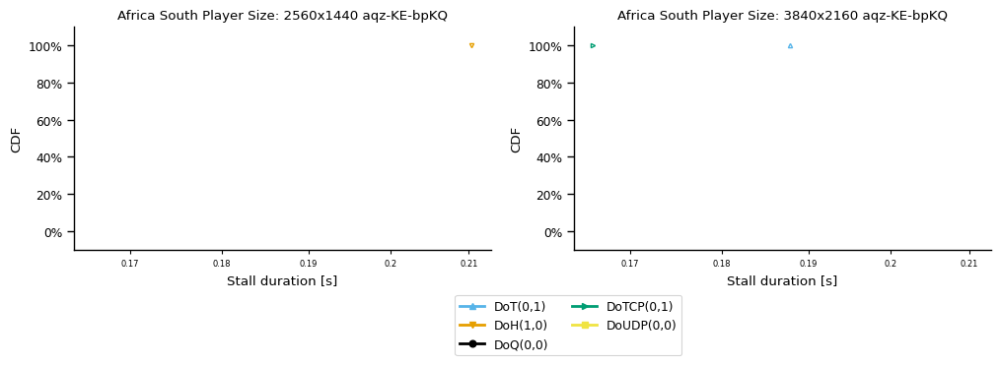

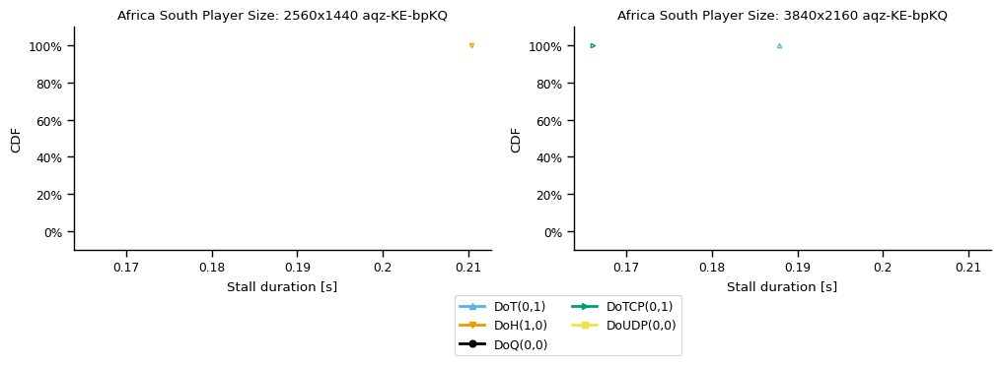

Asia Pacific Northeast


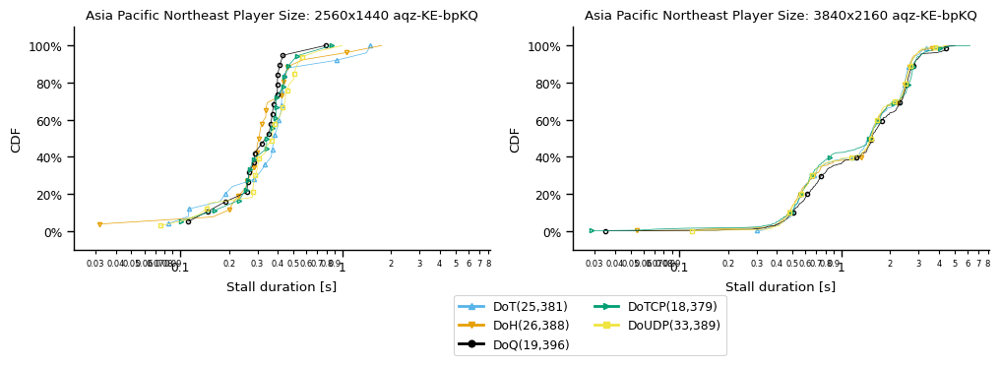

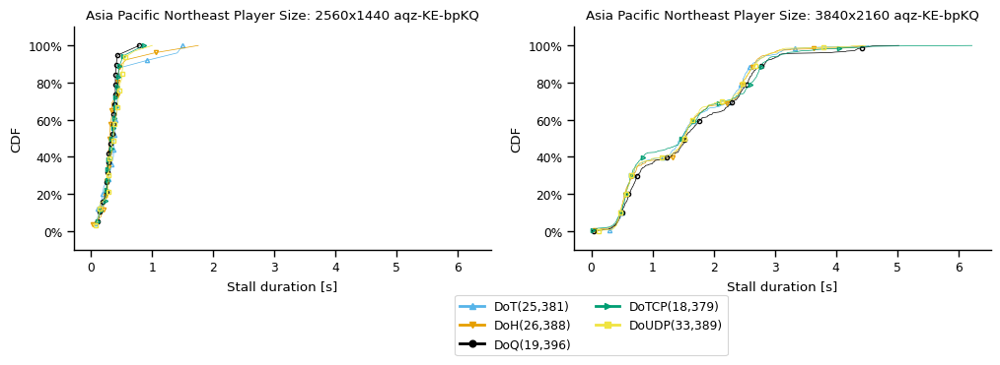

Asia Pacific Southeast


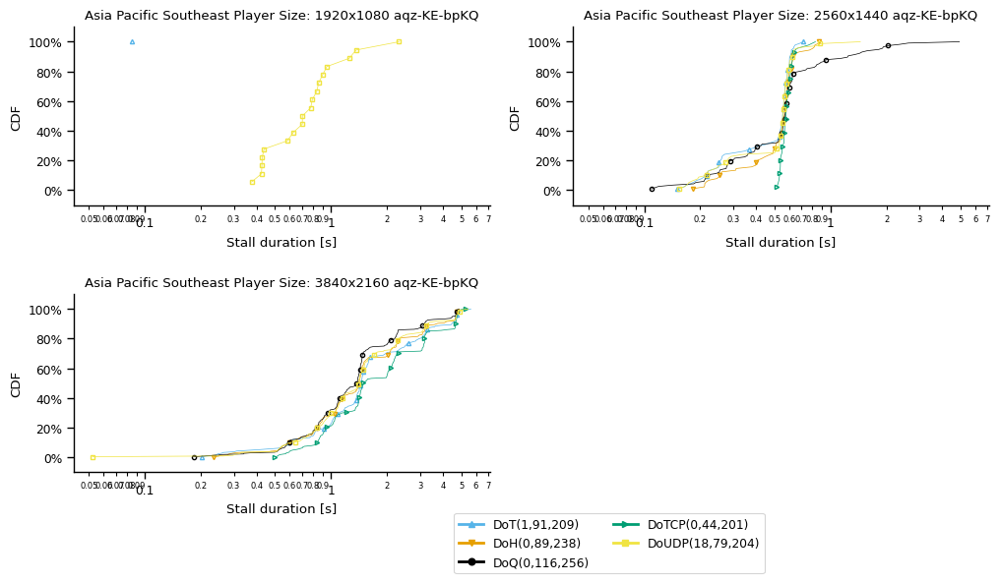

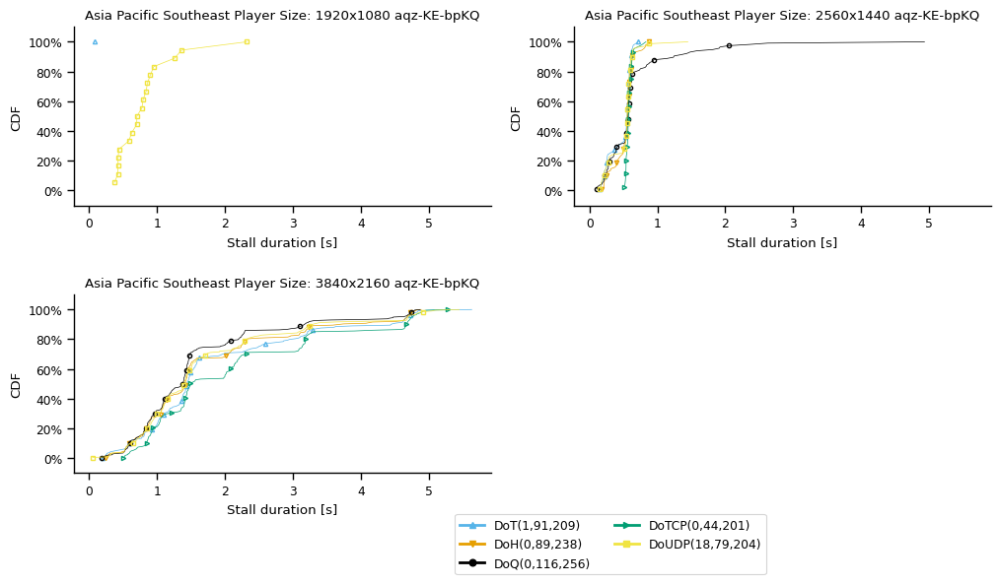

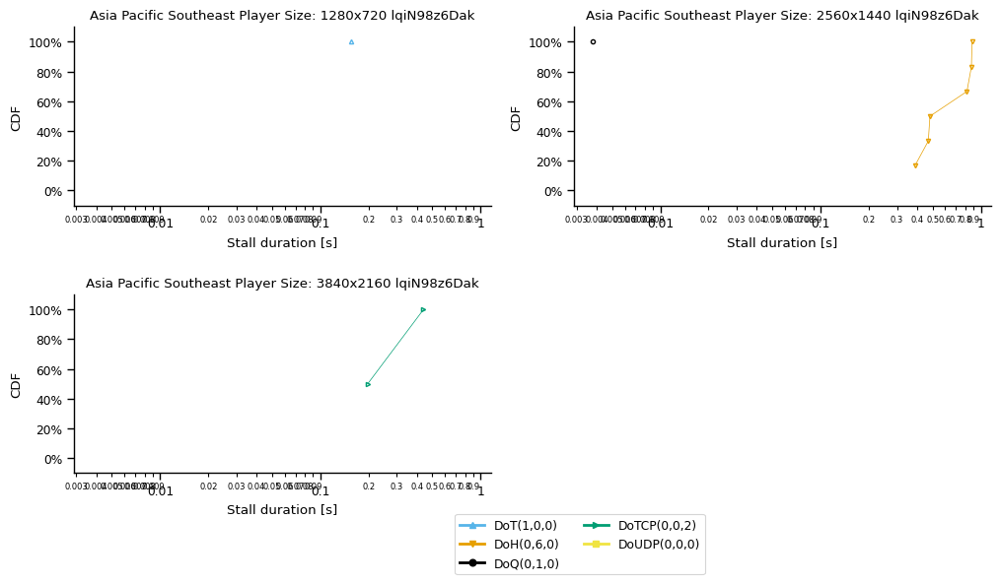

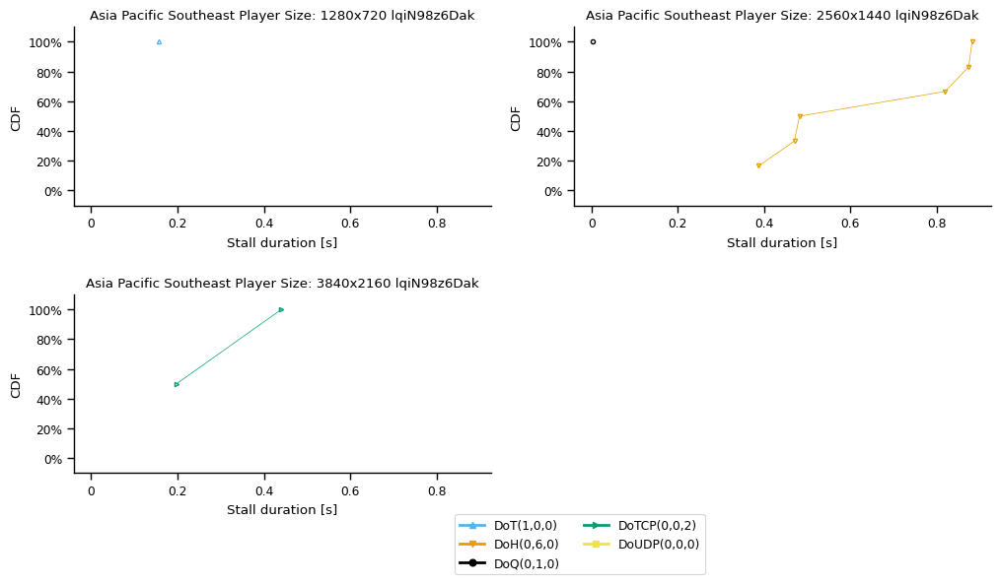

Europe Central


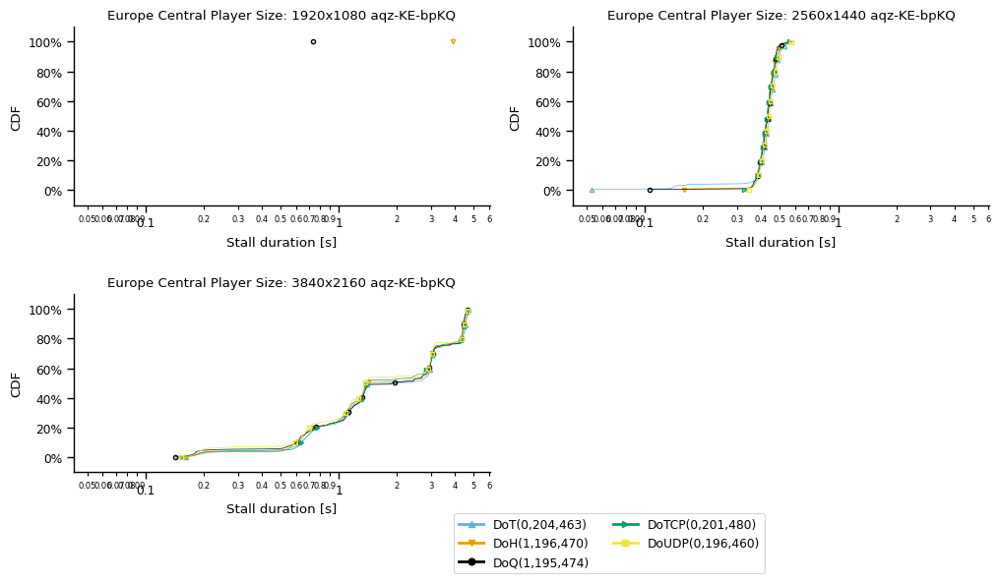

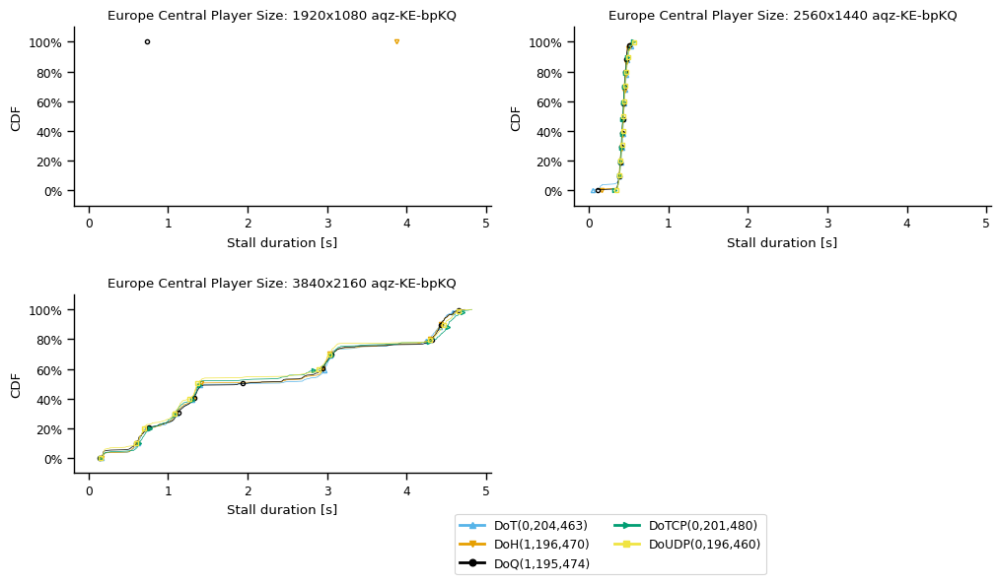

South America East


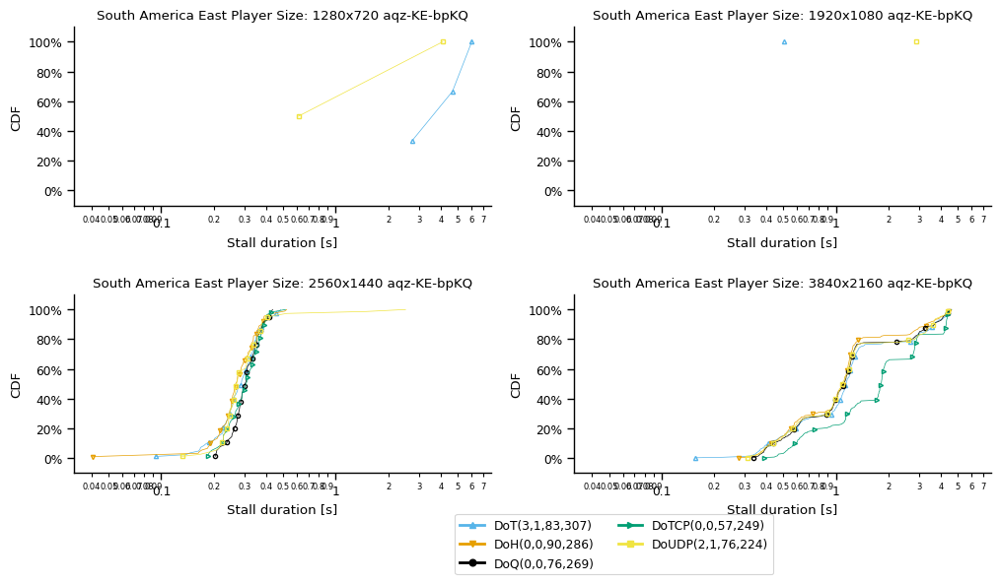

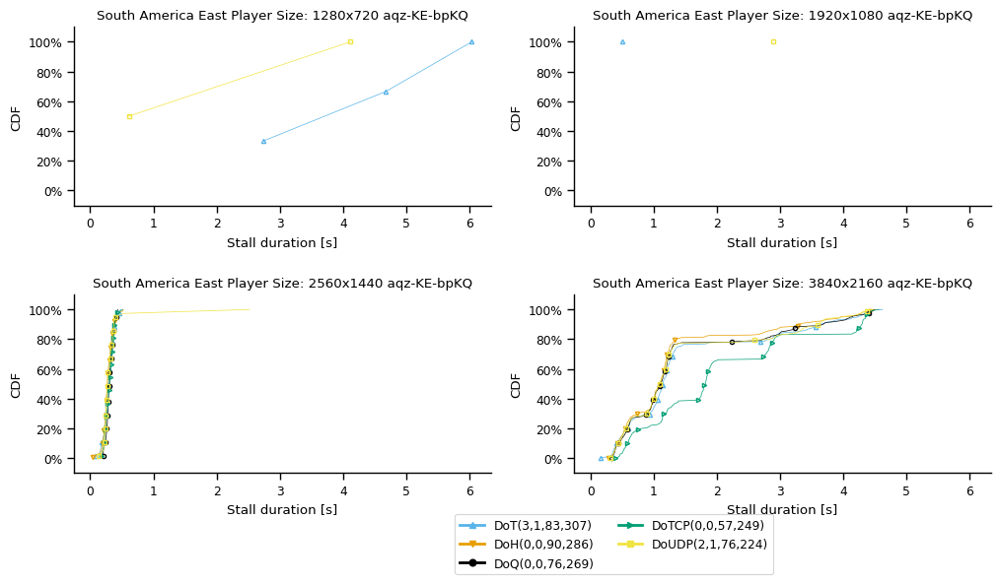

US East


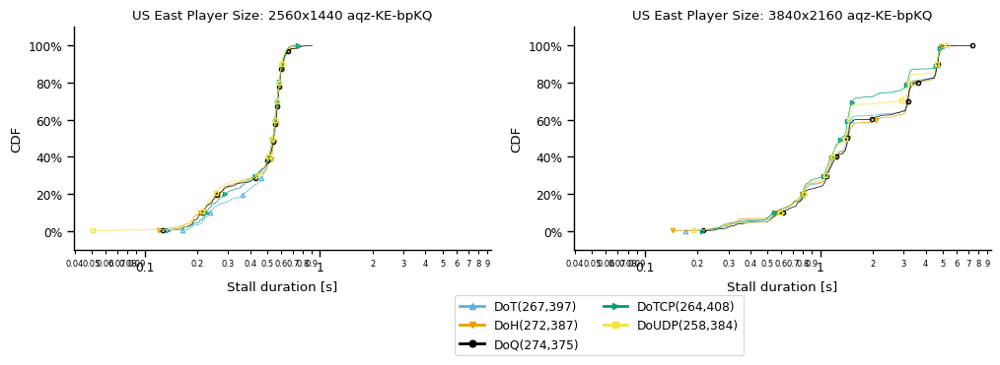

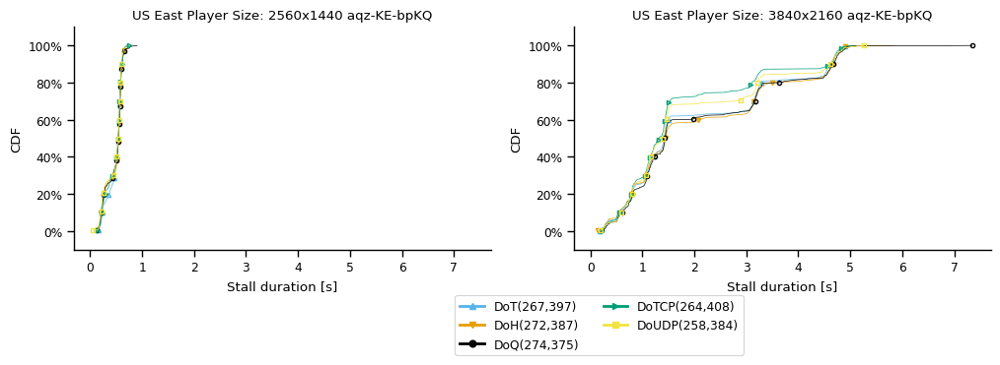

US West


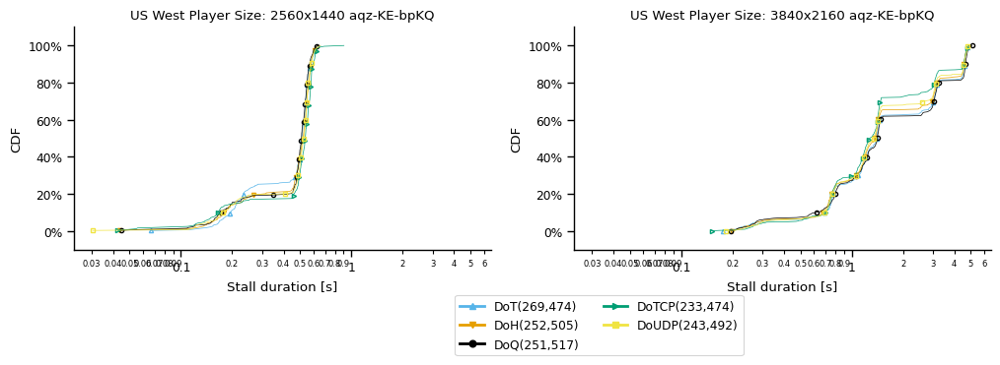

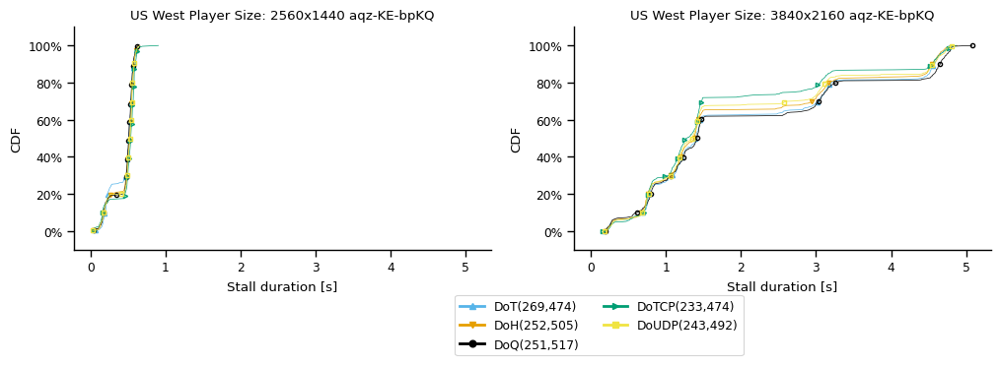

all vantage points


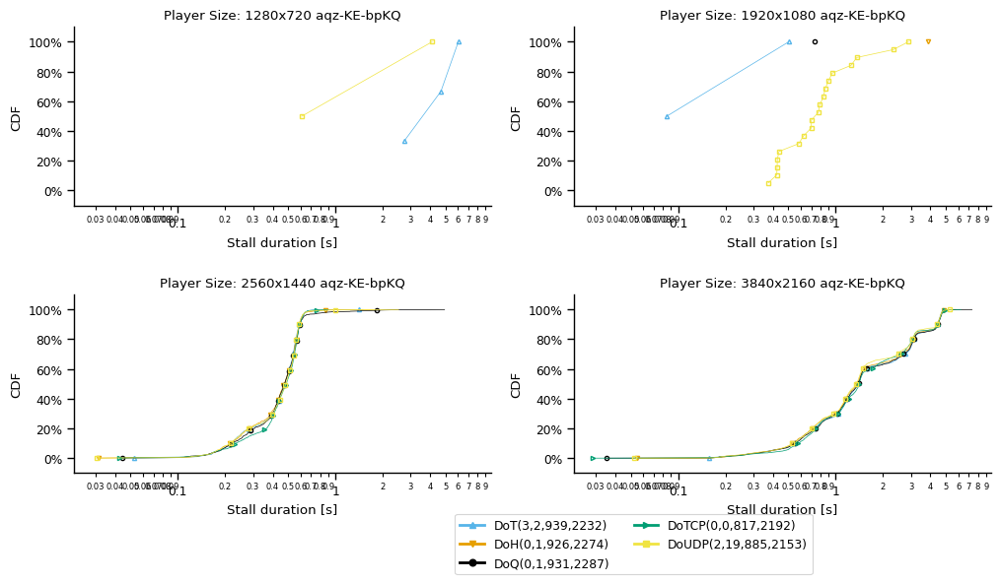

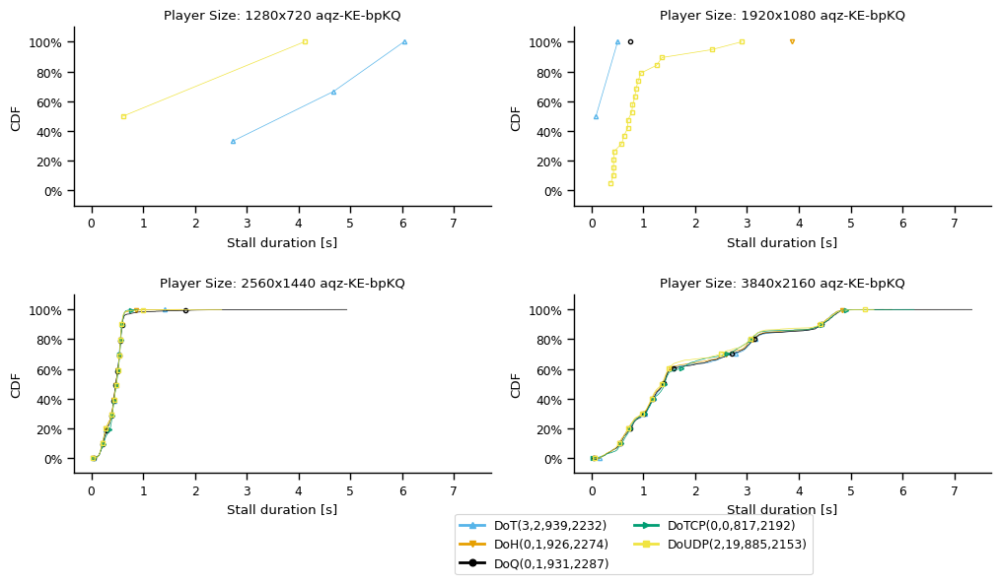

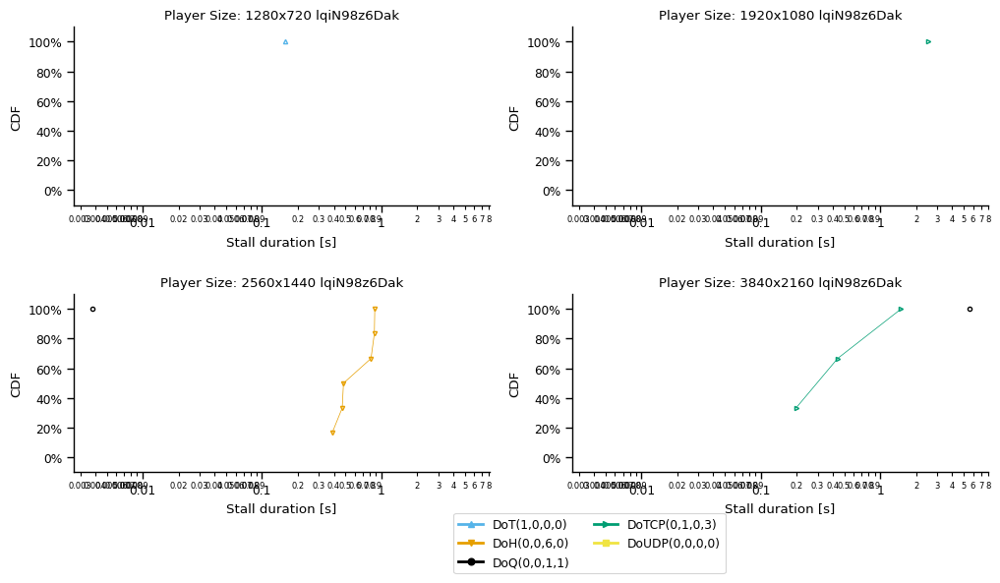

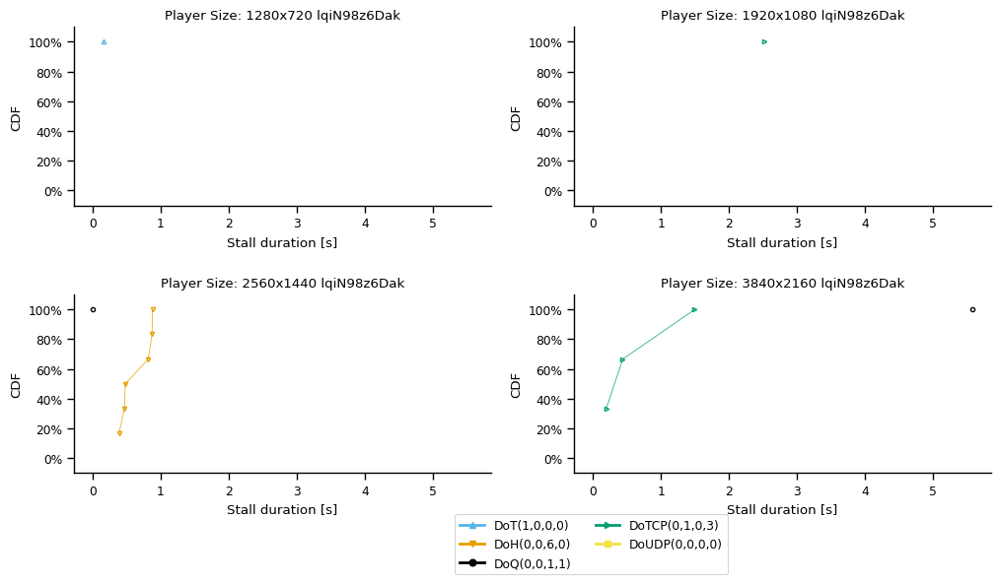

In [536]:
draw_cdf_grid(df_stall_times, 'player_dimensions', 'protocol', 'stall_time', [True,False], 'Stall duration [s]', 'Player Size:', 'stall-durations-by-player-size-and-proto', [0,0], draw_all=True)

In [ ]:
draw_cdf(df_stall_times, 'player_dimensions', 'protocol', 'stall_time', [True,False], 'Stall duration [s]', 'Player Size:', 'stall-durations-by-player-size-and-proto', [0,0])

Africa South


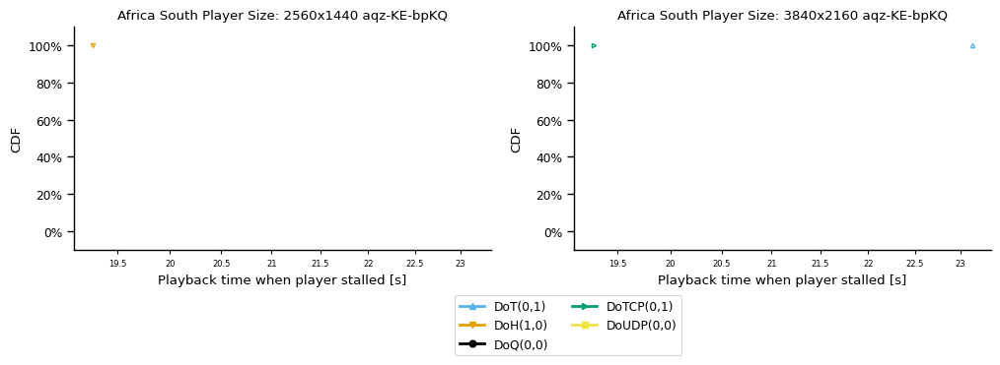

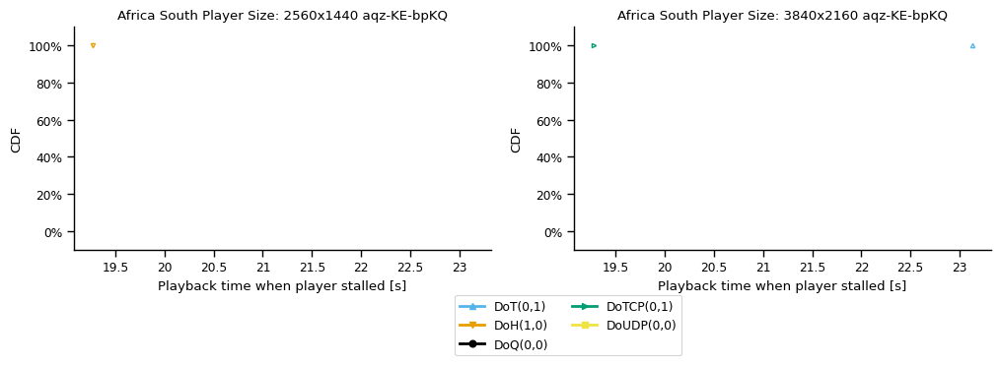

Asia Pacific Northeast


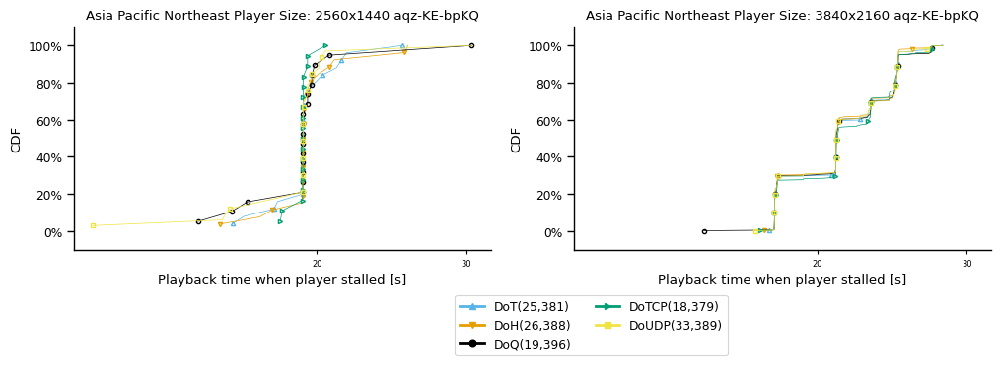

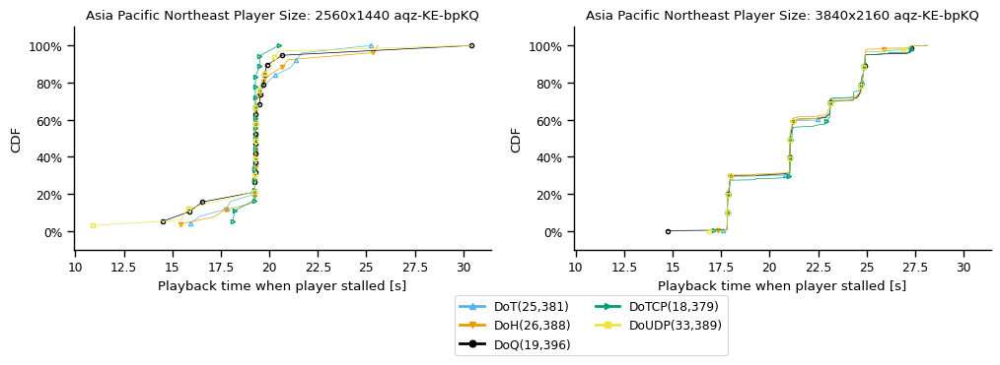

Asia Pacific Southeast


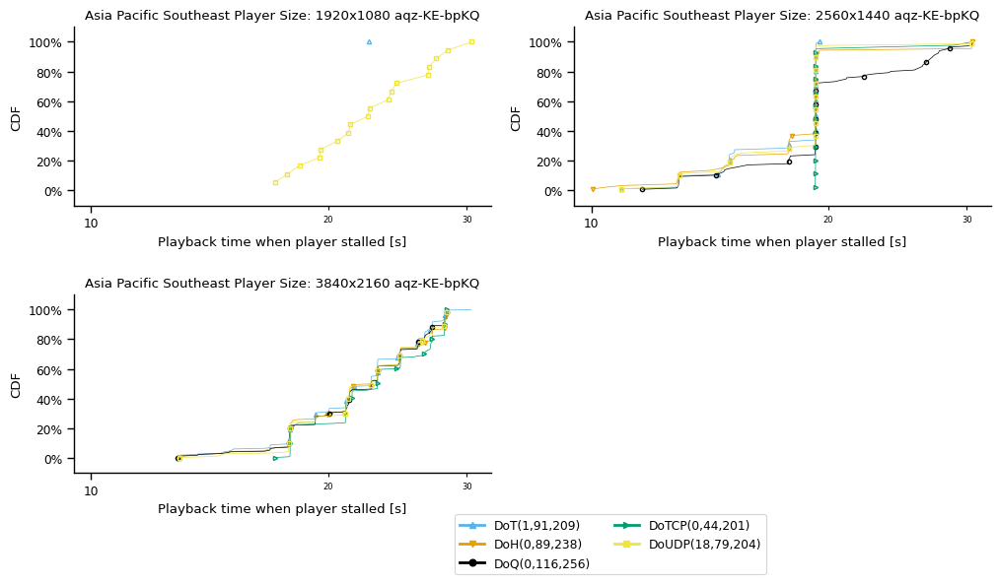

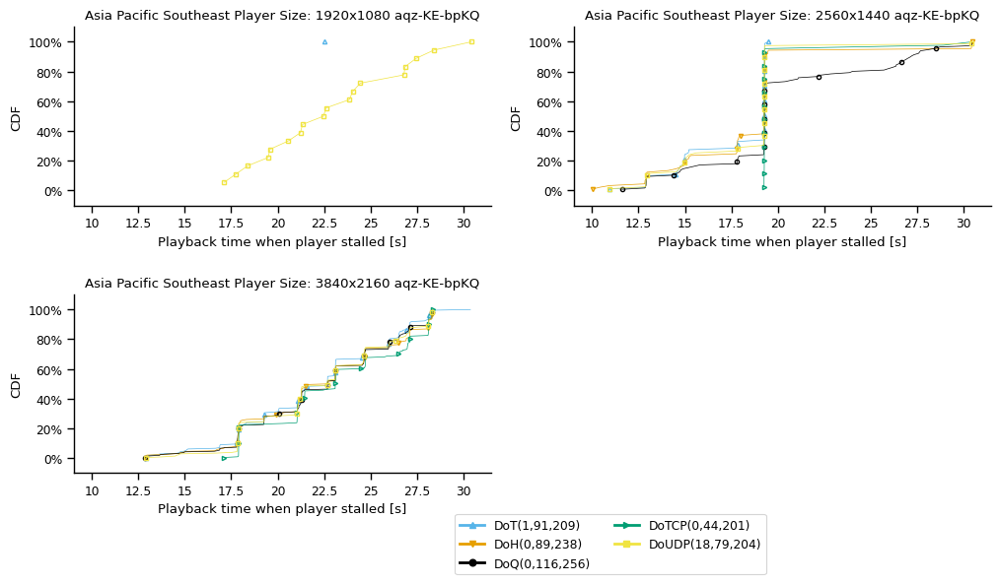

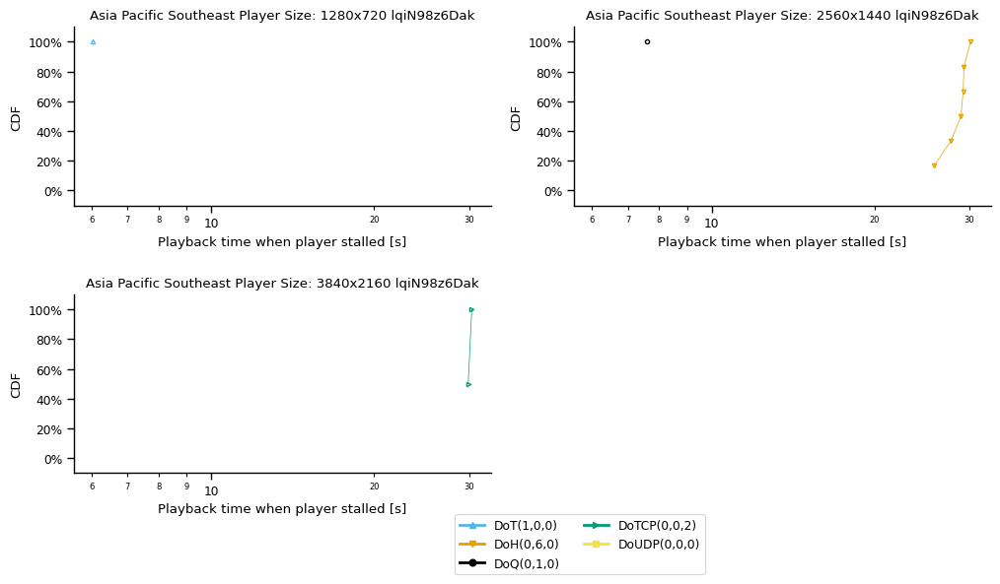

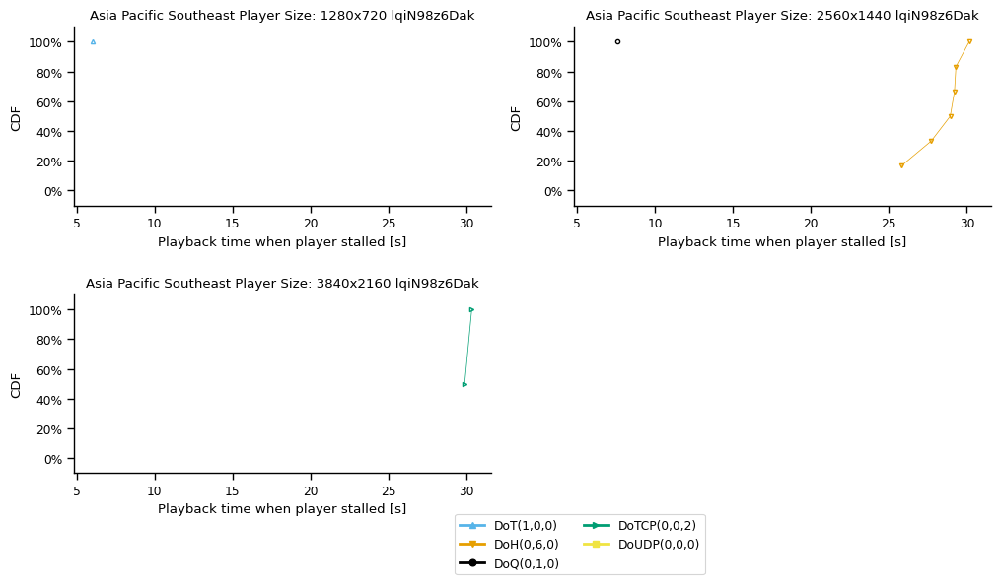

Europe Central


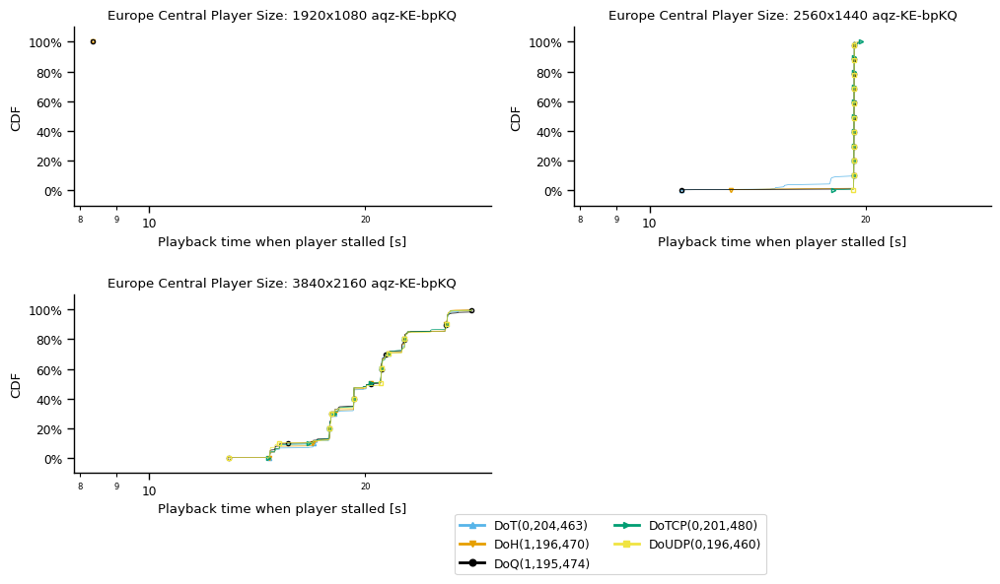

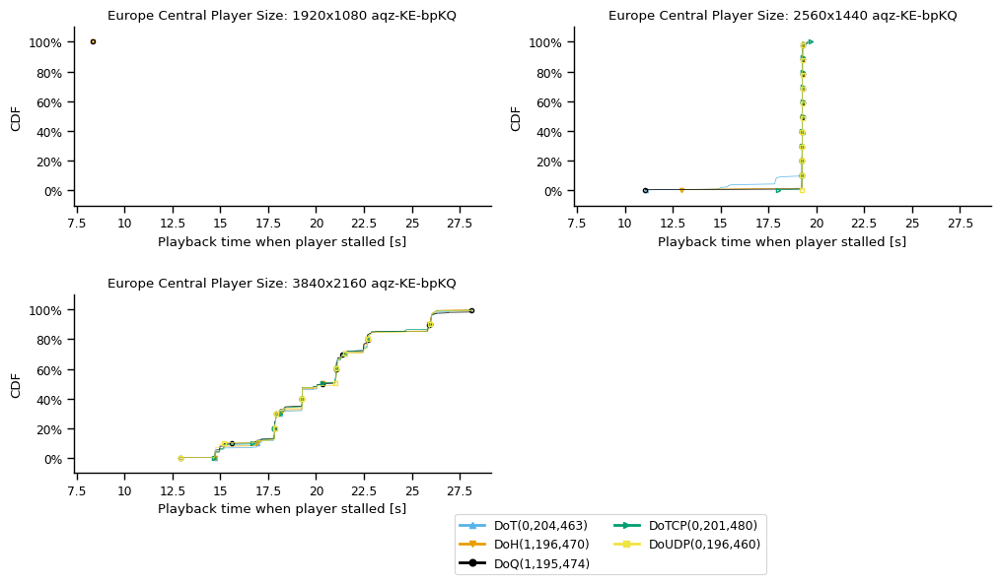

South America East


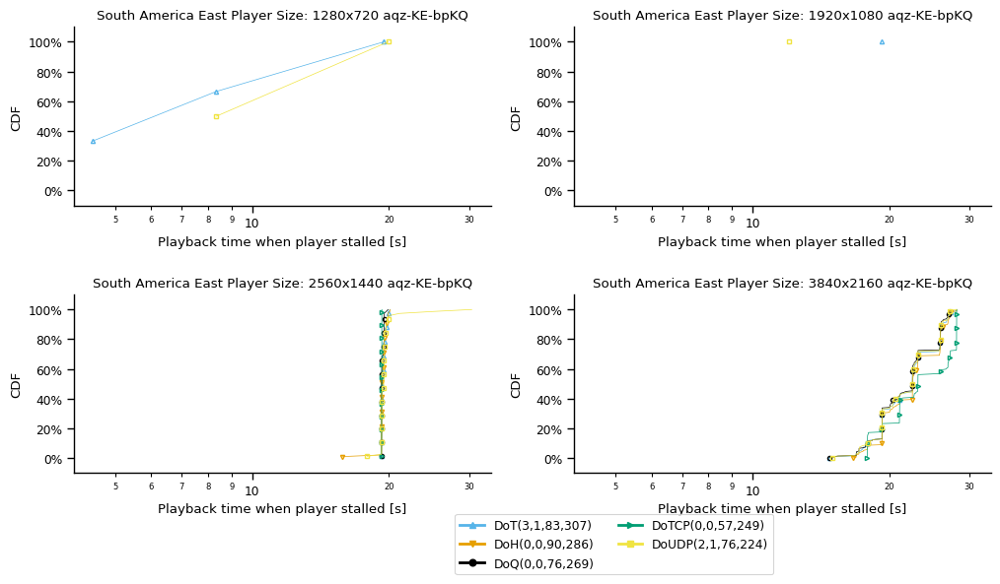

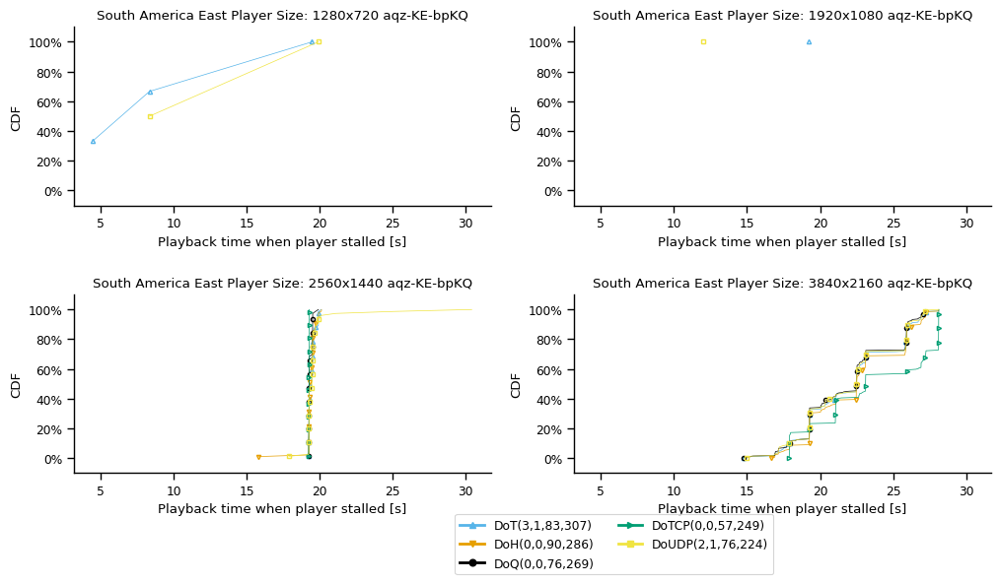

US East


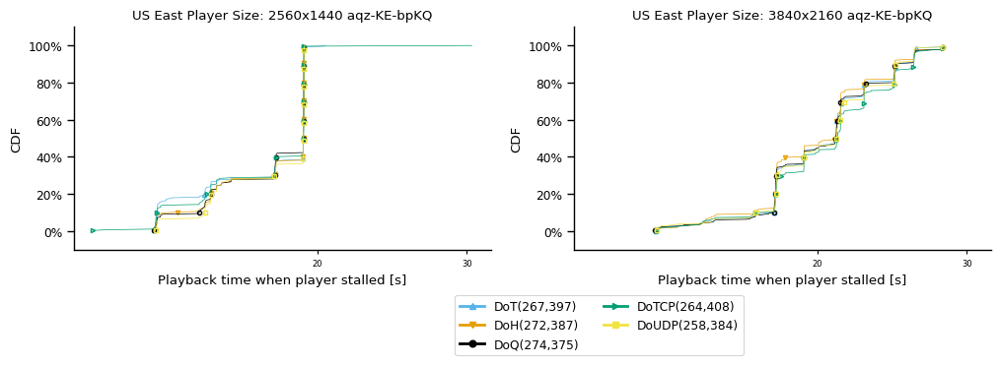

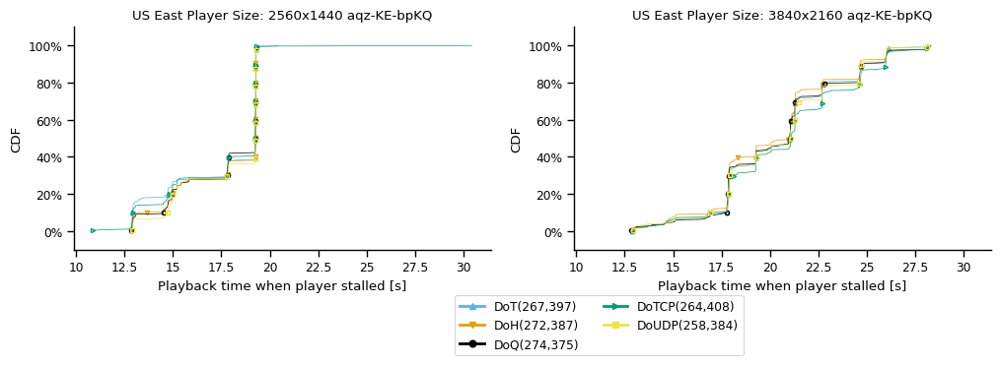

US West


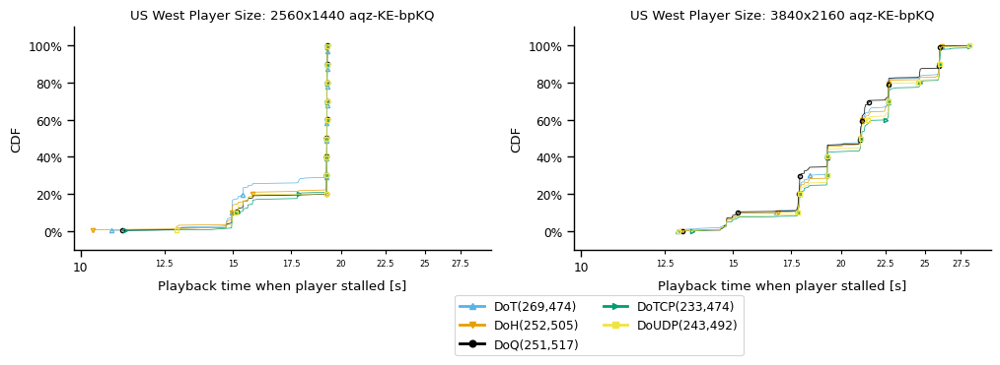

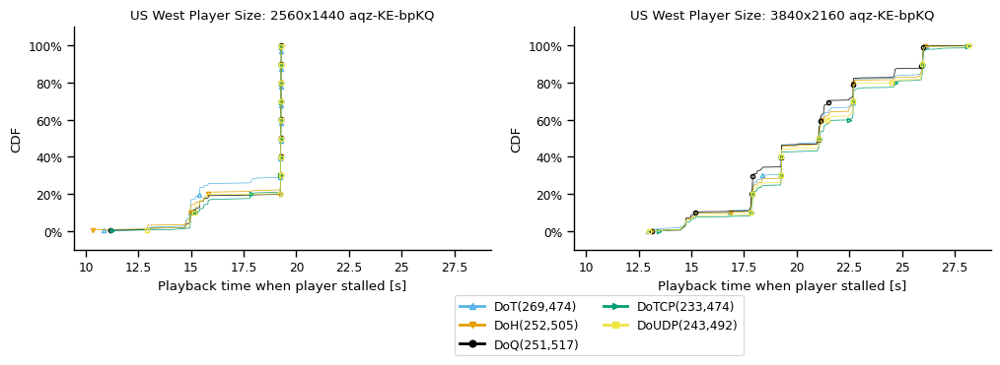

all vantage points


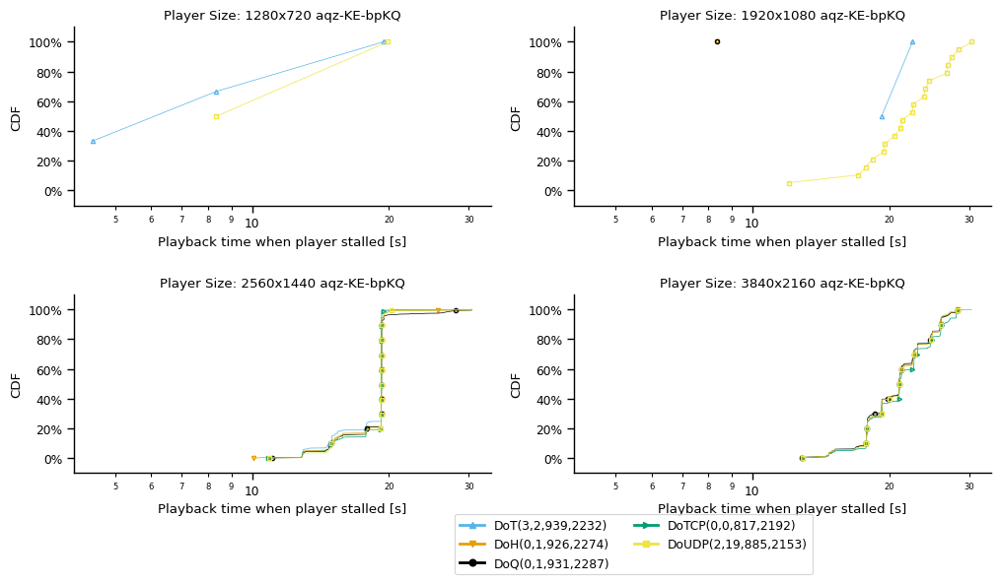

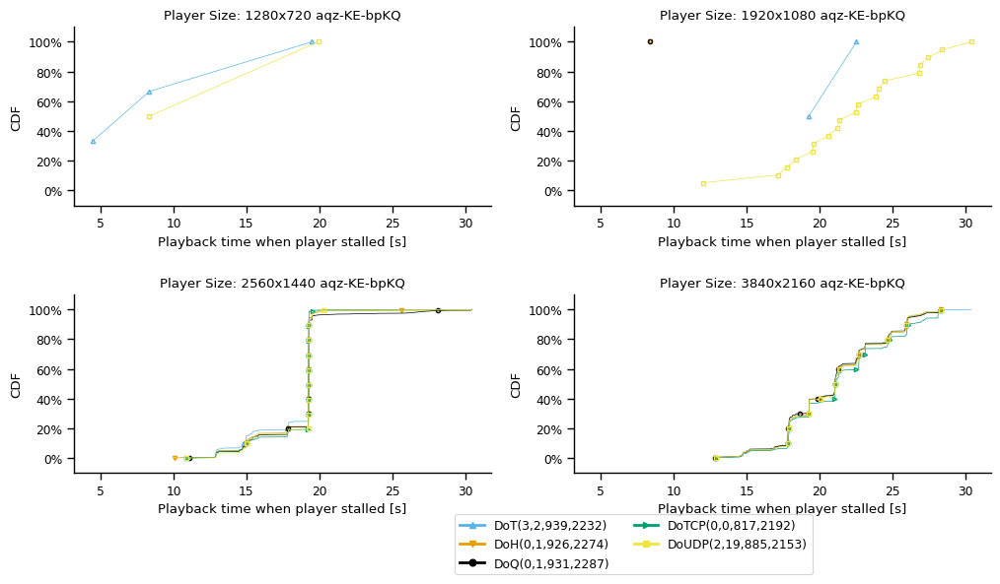

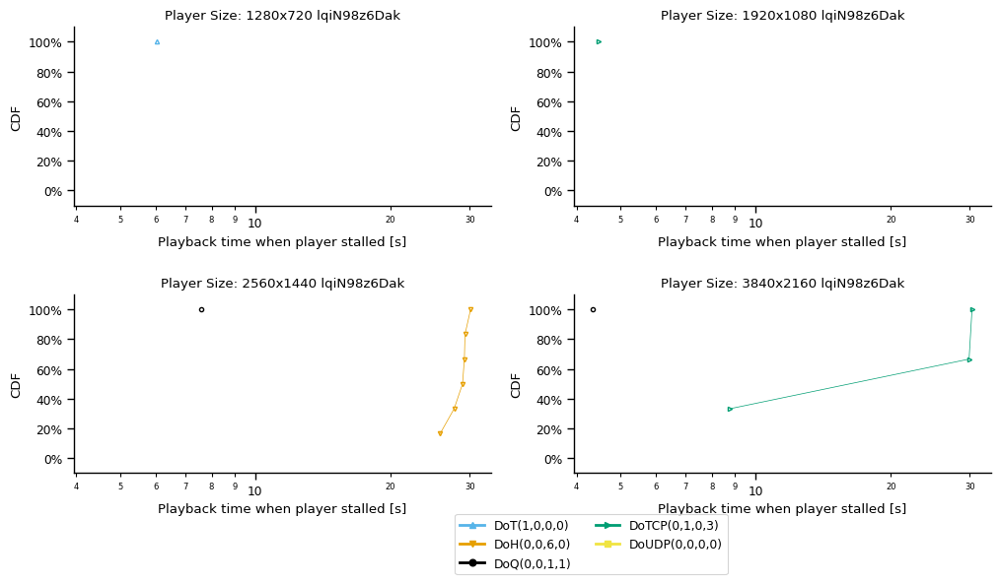

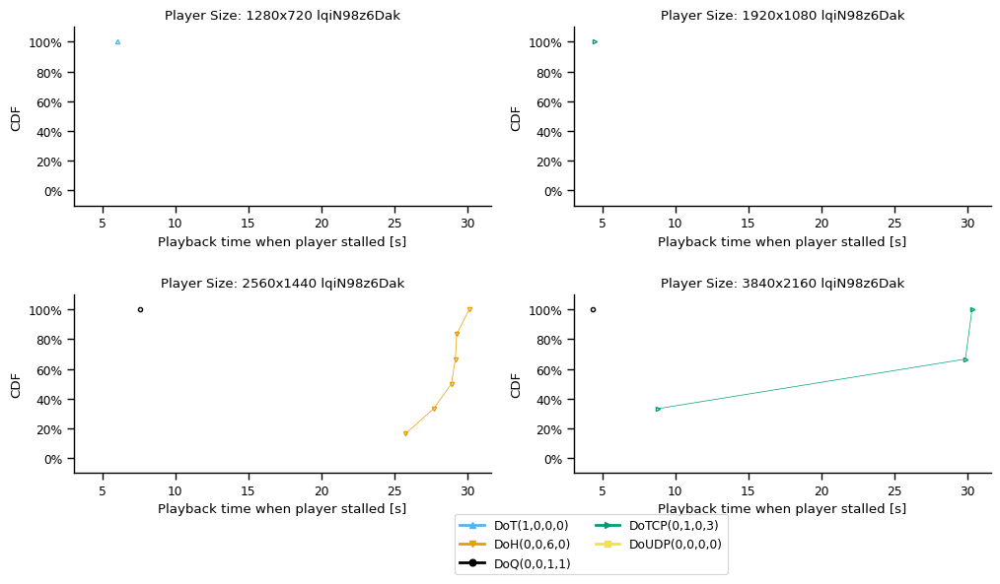

In [537]:
draw_cdf_grid(df_stall_times, 'player_dimensions', 'protocol', 'curr_play_time', [True,False], 'Playback time when player stalled [s]', 'Player Size:', 'buffer-events-with-restart-events-by-player-size-and-proto', [0,0], draw_all=True)

Africa South


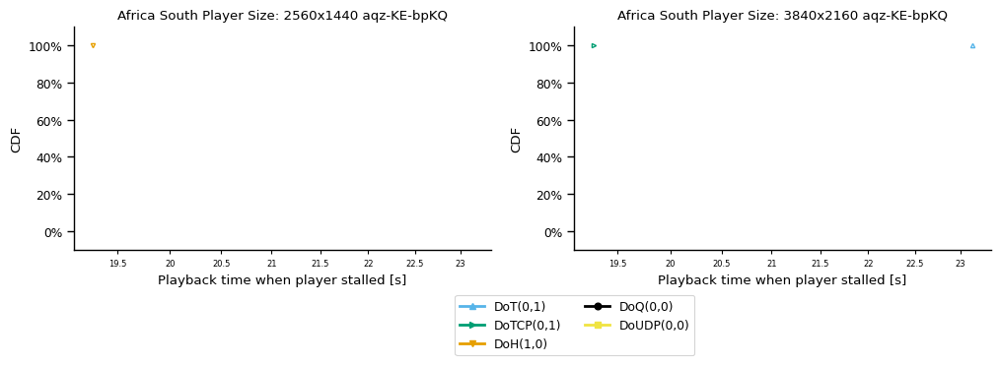

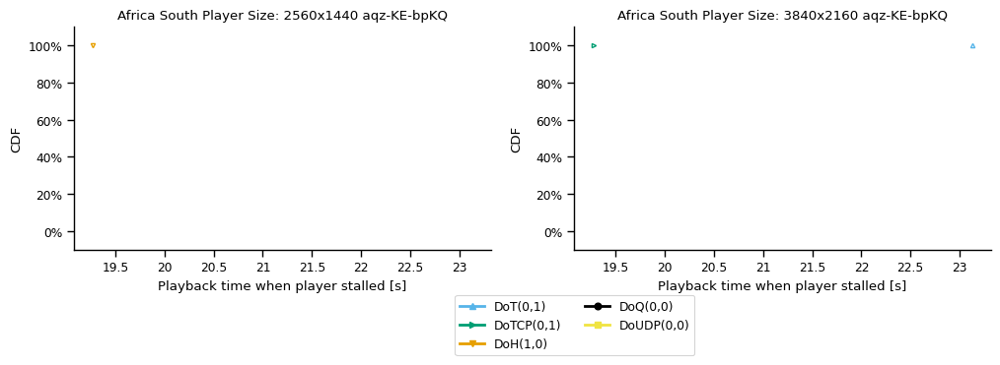

Asia Pacific Northeast


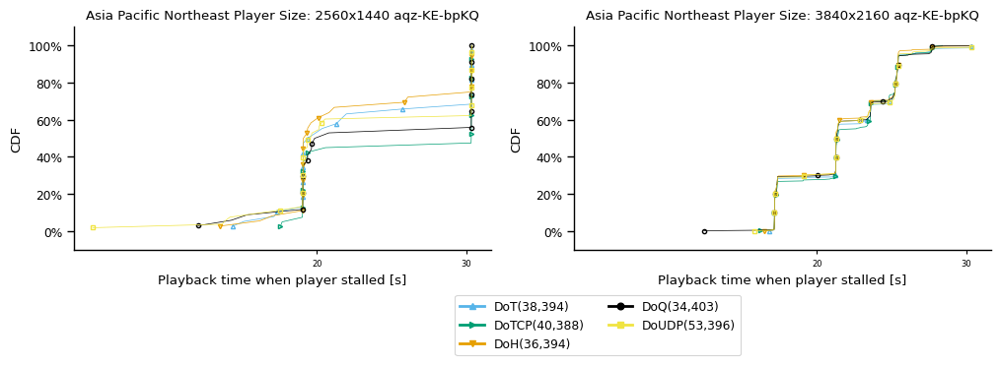

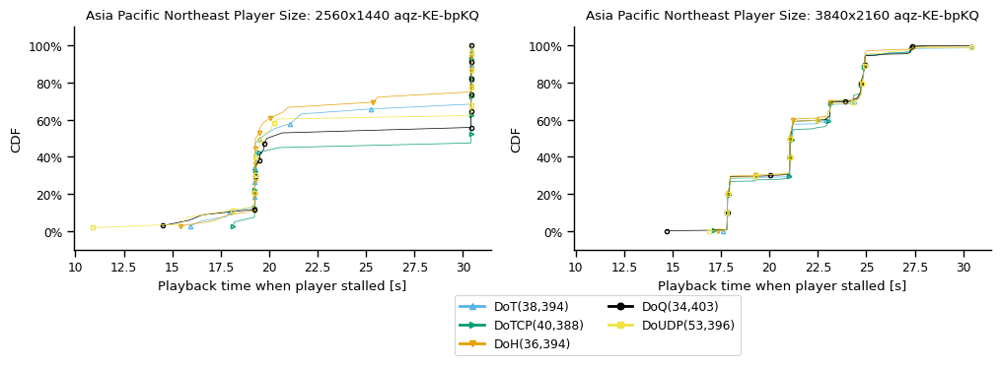

Asia Pacific Southeast


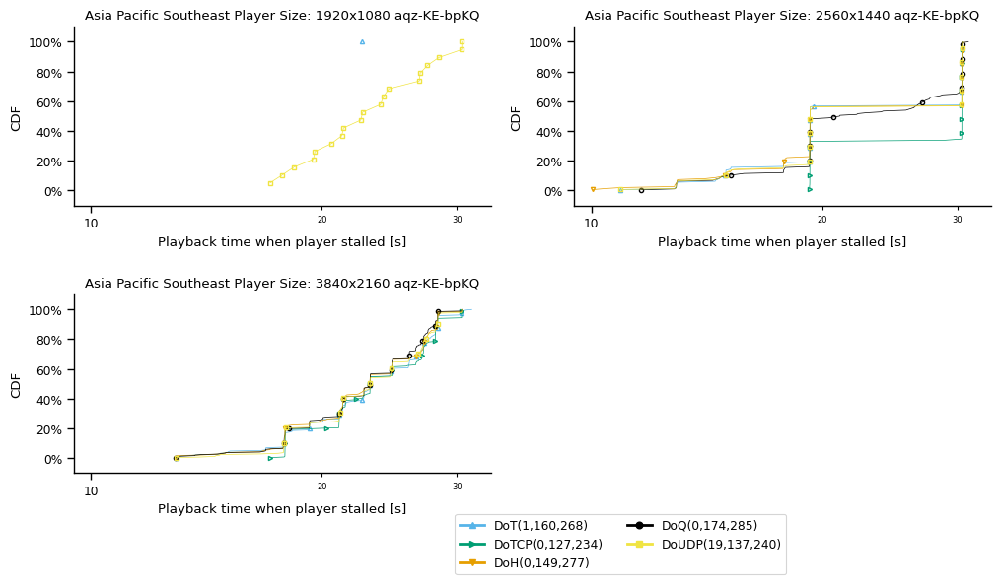

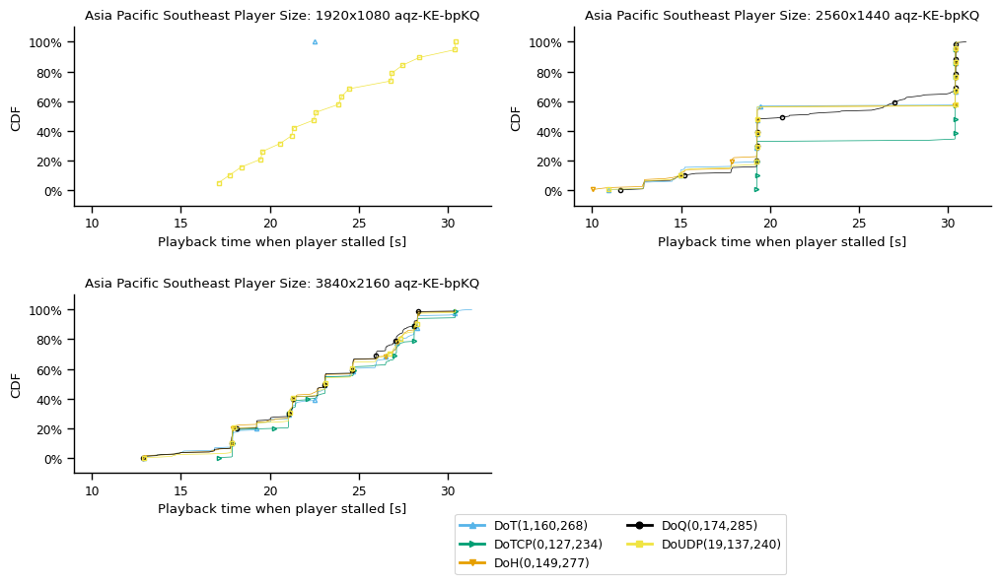

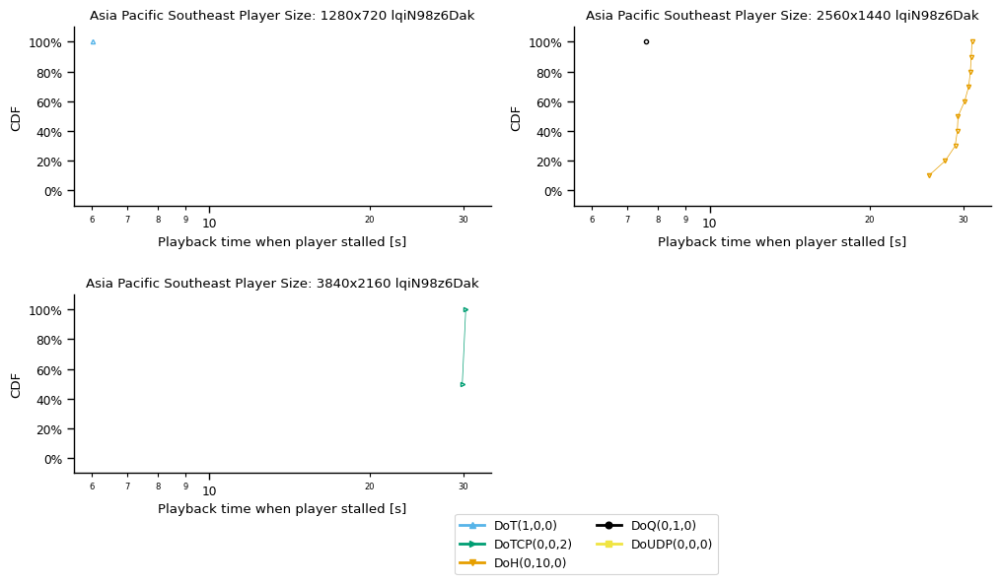

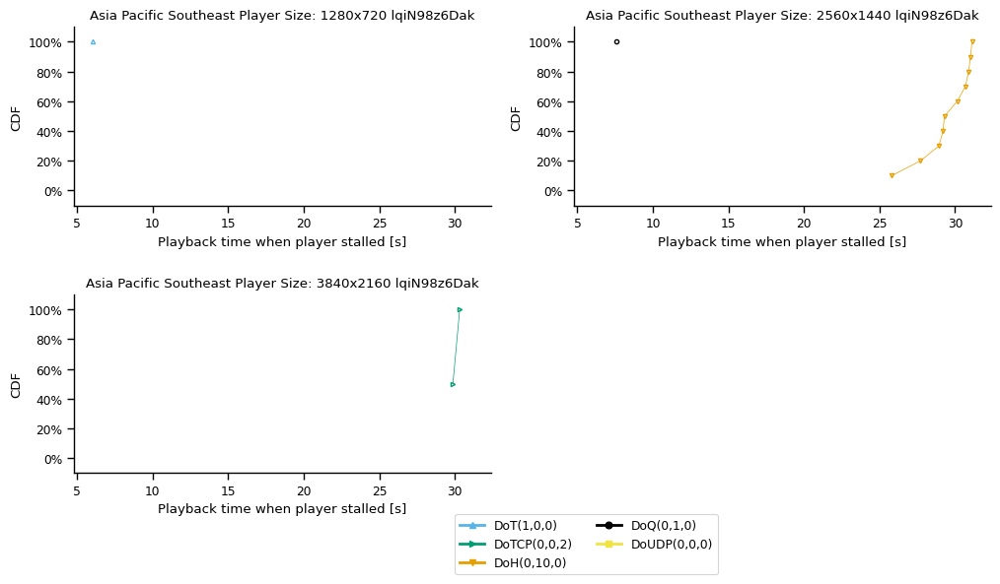

Europe Central


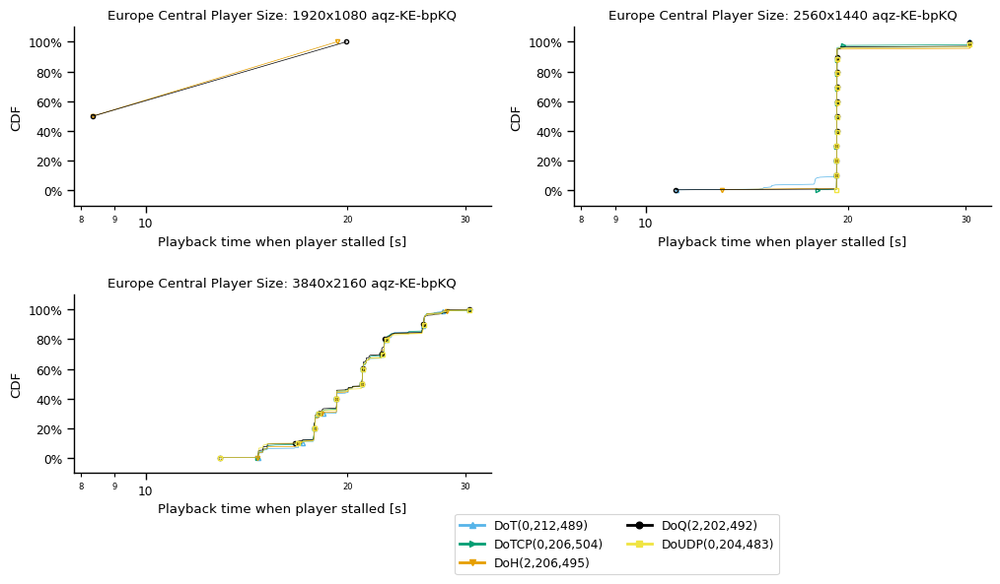

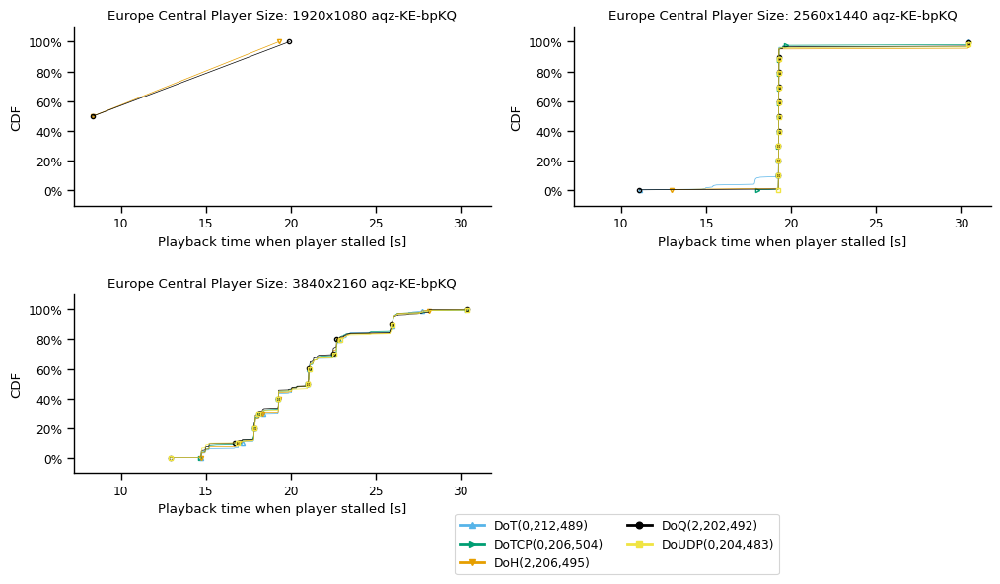

South America East


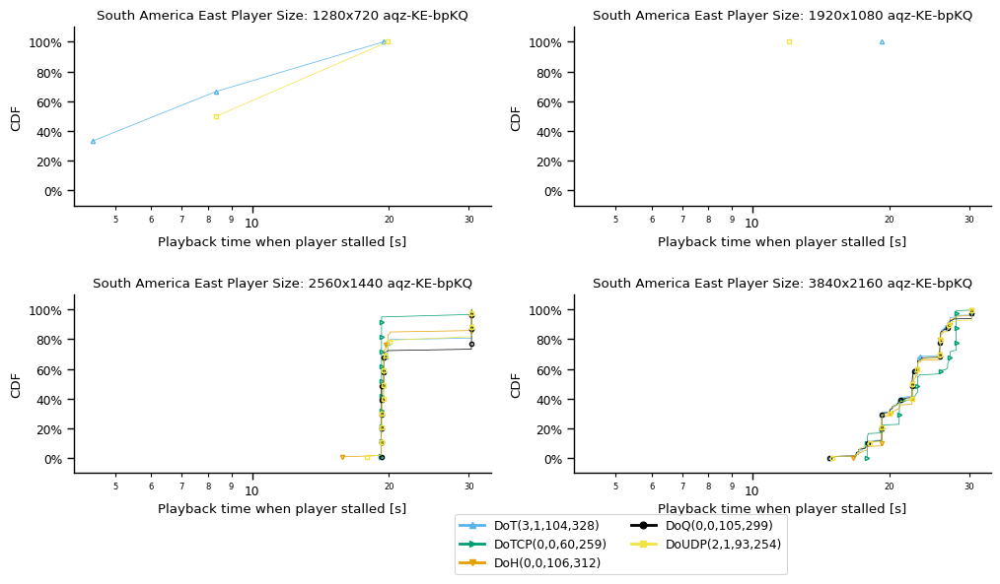

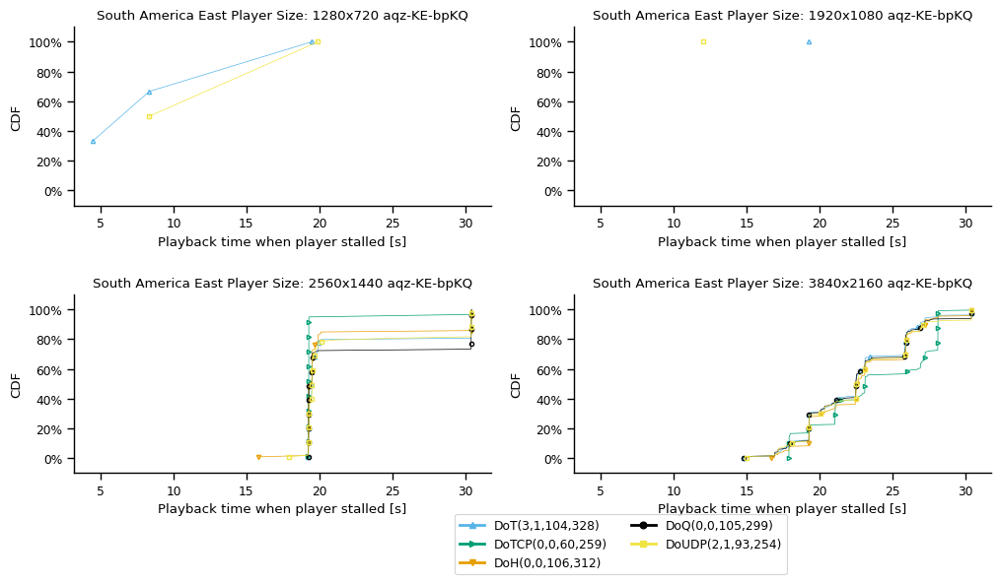

US East


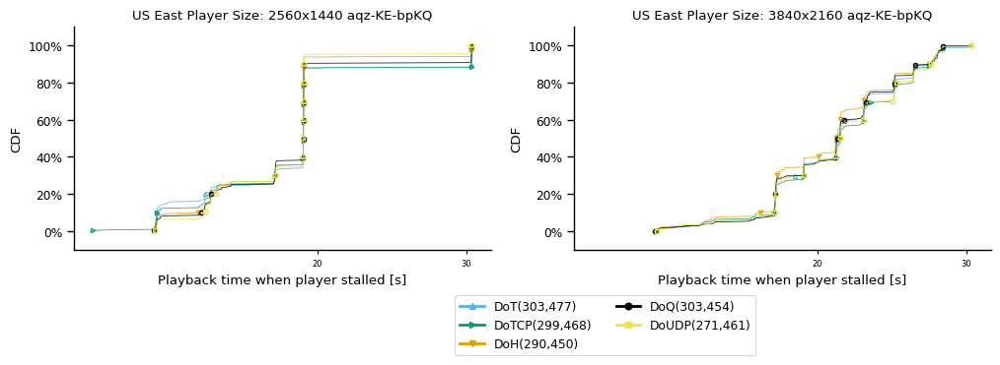

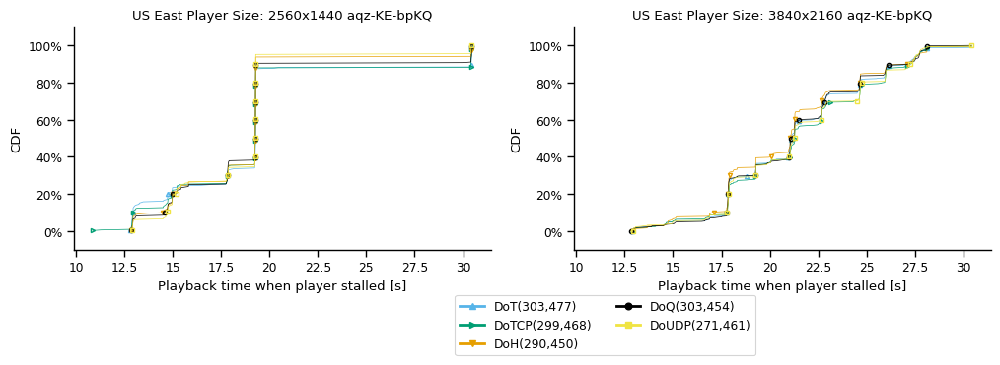

US West


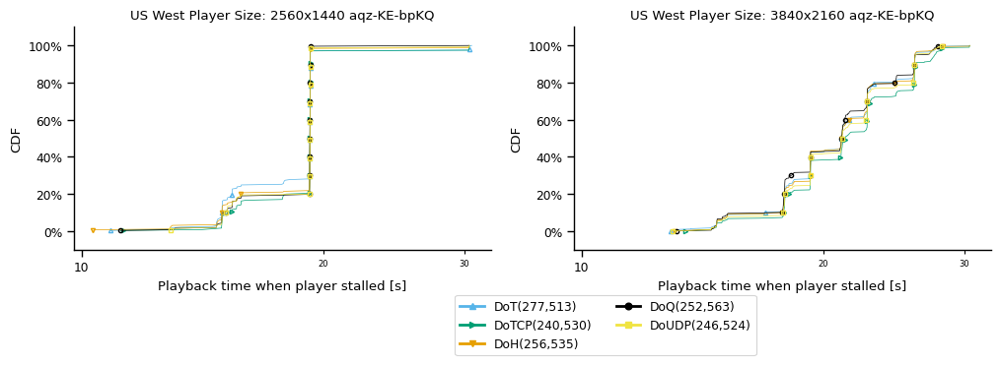

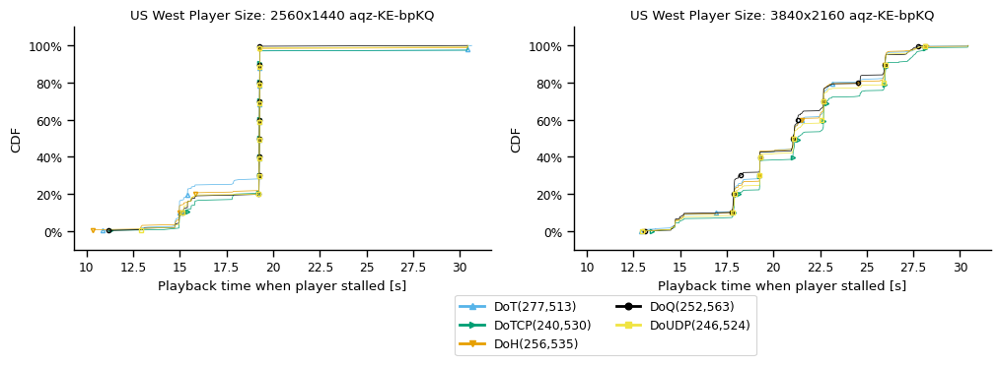

all vantage points


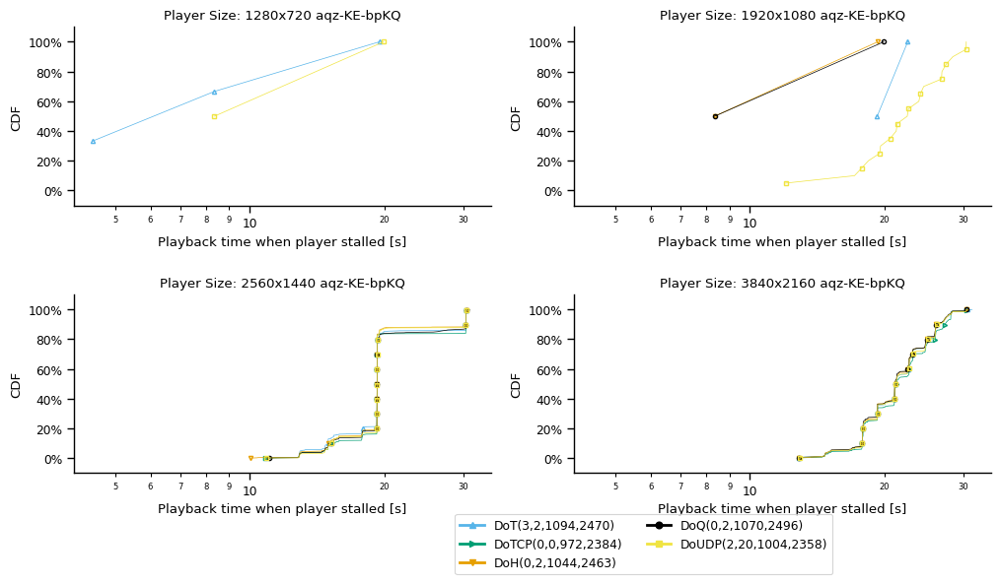

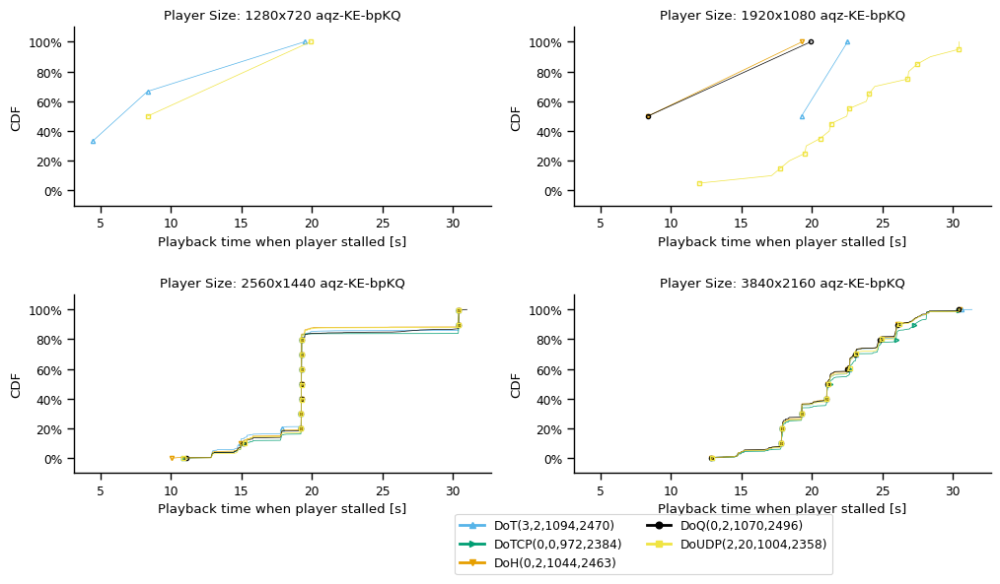

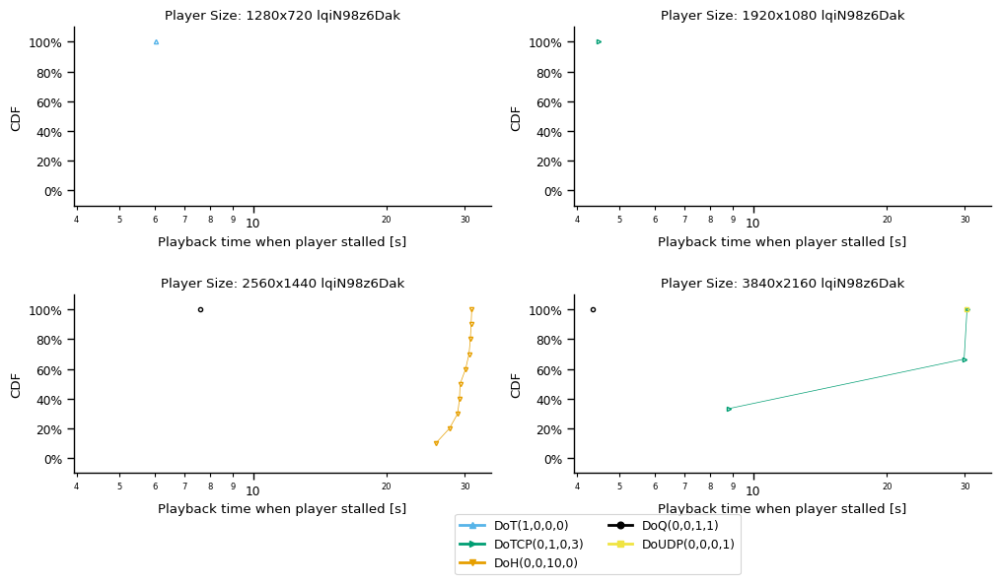

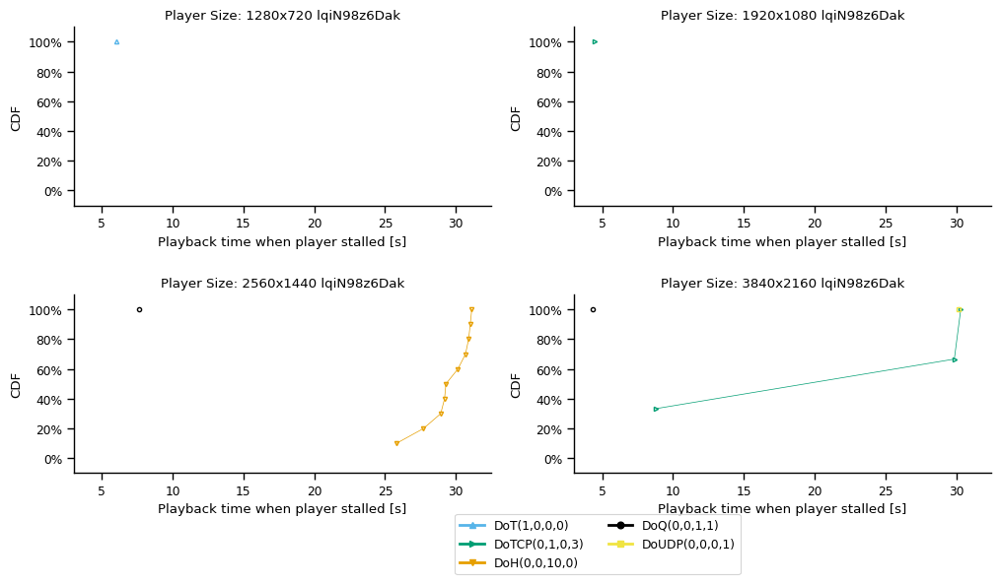

In [538]:
draw_cdf_grid(df_buffering_events_time, 'player_dimensions', 'protocol', 'curr_play_time', [True,False], 'Playback time when player stalled [s]', 'Player Size:', 'buffer-events-by-player-size-and-proto', [0,0], draw_all=True)

In [ ]:
draw_cdf(df_buffering_events_time, 'player_dimensions', 'protocol', 'curr_play_time', [True,False], 'Playback time when player stalled [s]', 'Player Size:', 'buffer-events-by-player-size-and-proto', [0,0])

In [539]:
df_start_time.groupby('domain').agg({'vantagePoint':'count'})

,vantagePoint
domain,
aqz-KE-bpKQ,25500
lqiN98z6Dak,28170


In [ ]:
draw_cdf_grid(df_start_time, 'player_dimensions', 'protocol', 'startup_delay', [True,False], 'Startup delay [s]', 'Player Size:', 'startup-delay-by-player-size-and-proto', [0,0])

In [ ]:
draw_cdf(df_start_time, 'player_dimensions', 'protocol', 'startup_delay', [True,False], 'Startup delay [s]', 'Player Size:', 'startup-delay-by-player-size-and-proto', [0.1,1])

Africa South


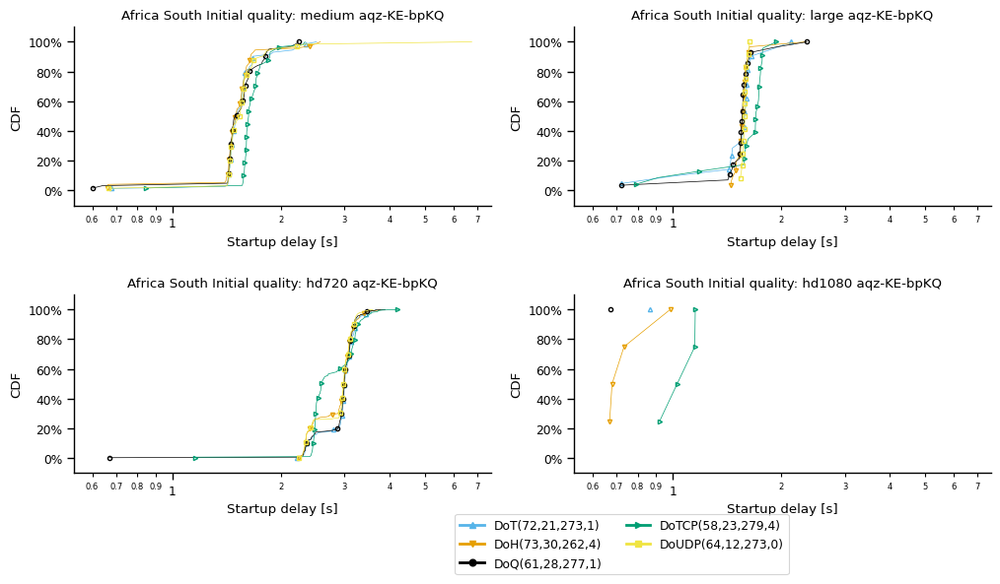

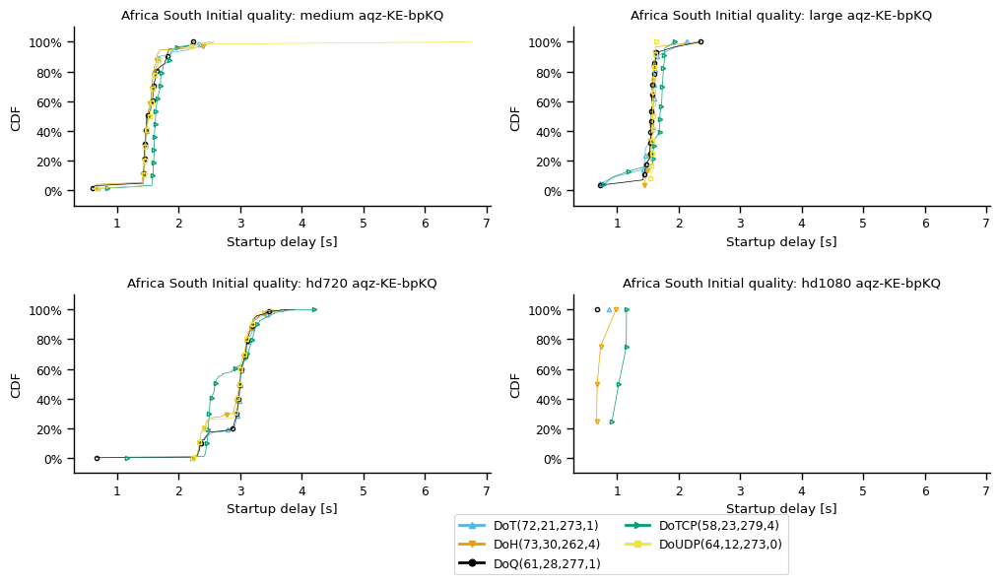

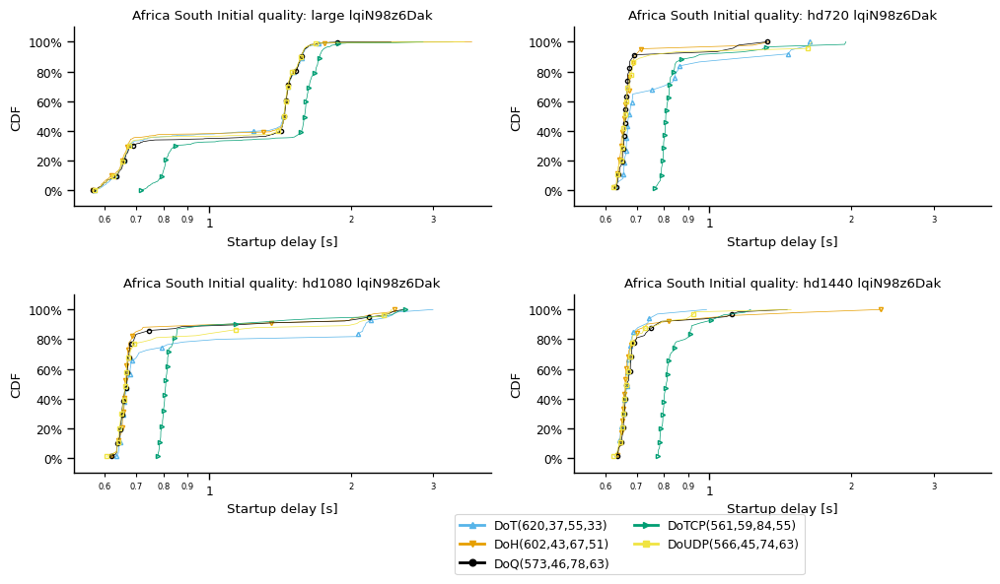

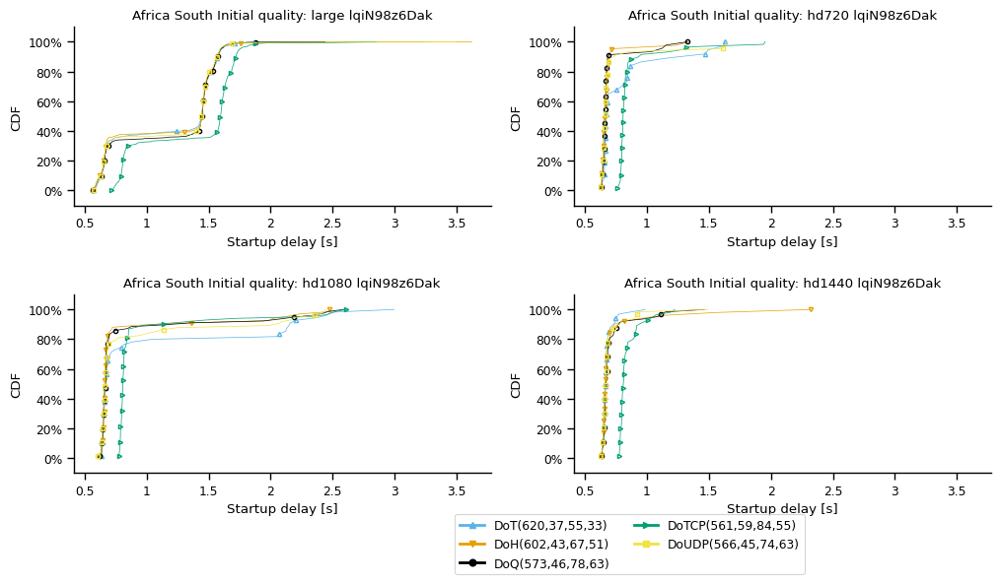

Asia Pacific Northeast


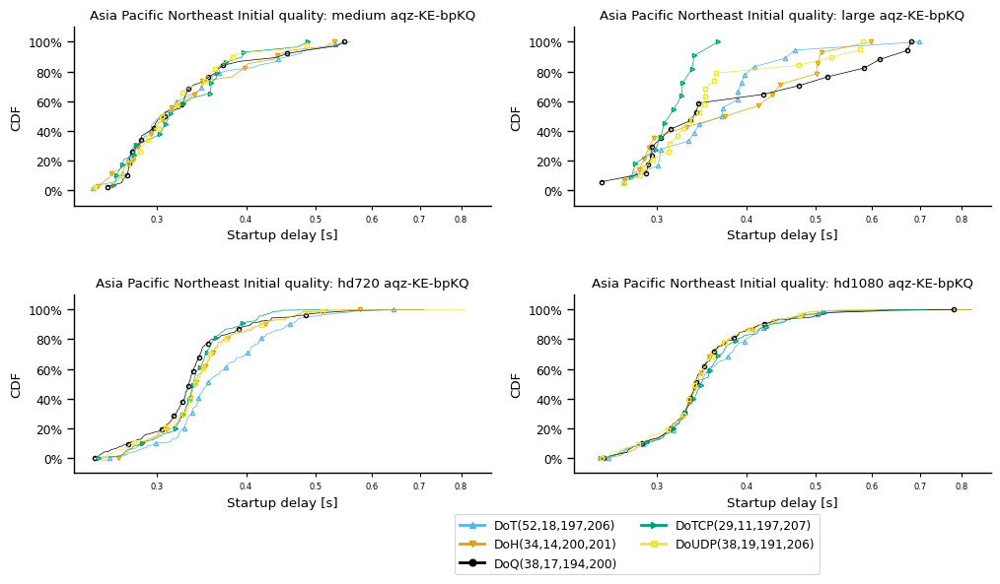

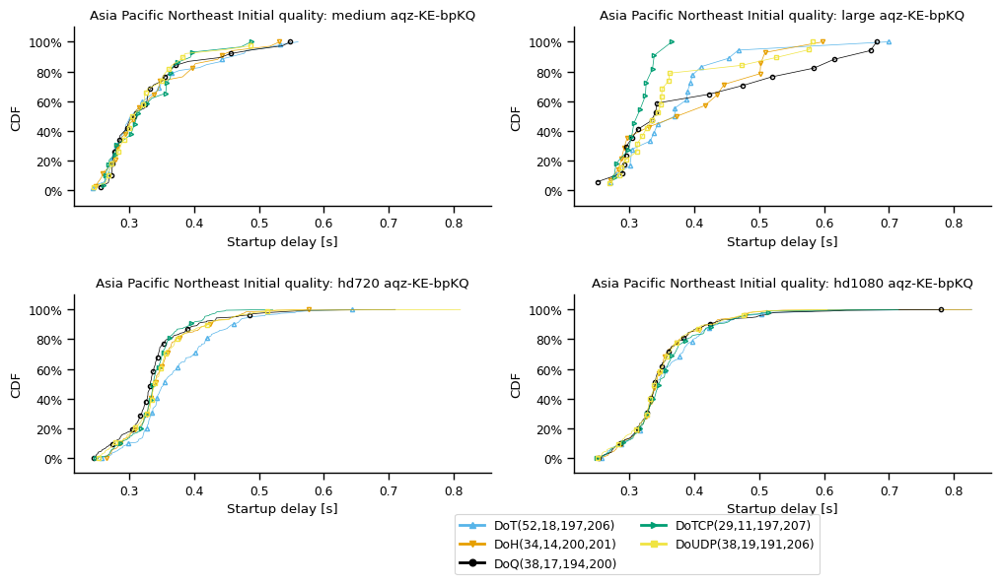

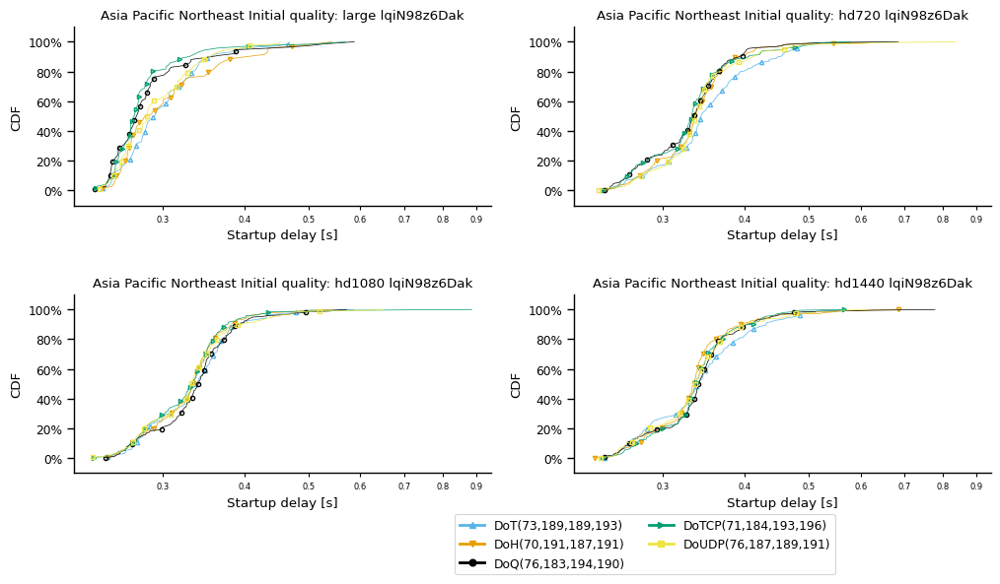

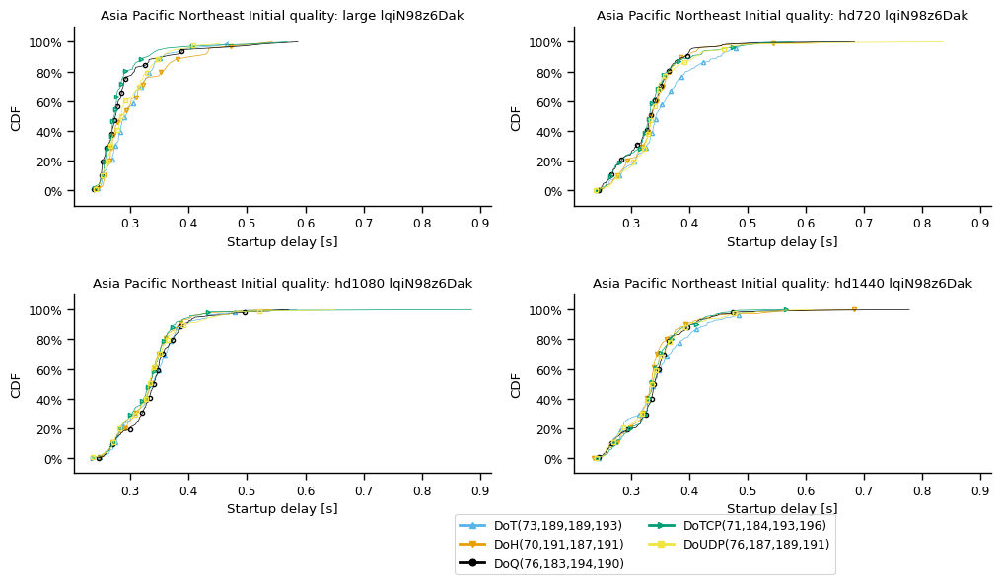

Asia Pacific Southeast


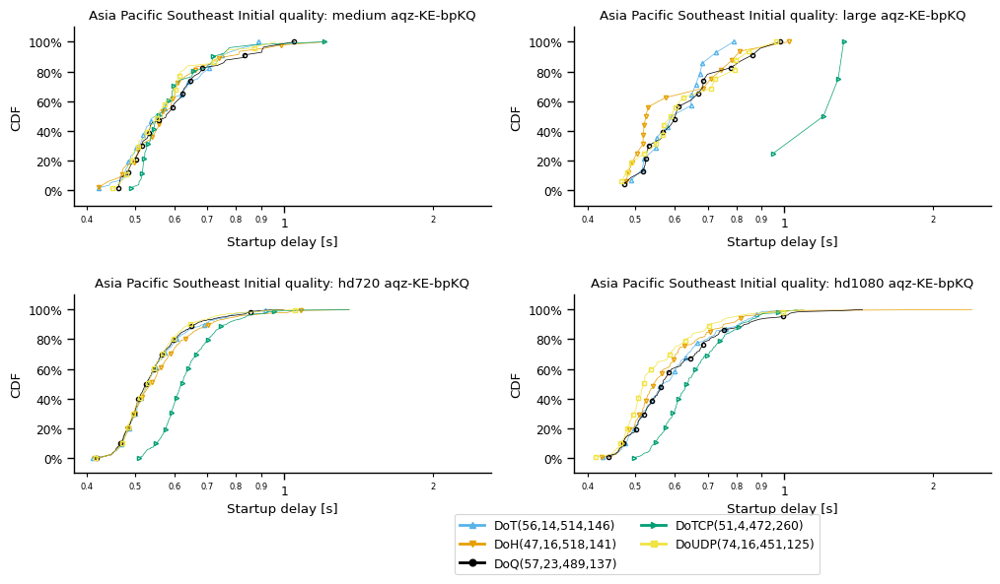

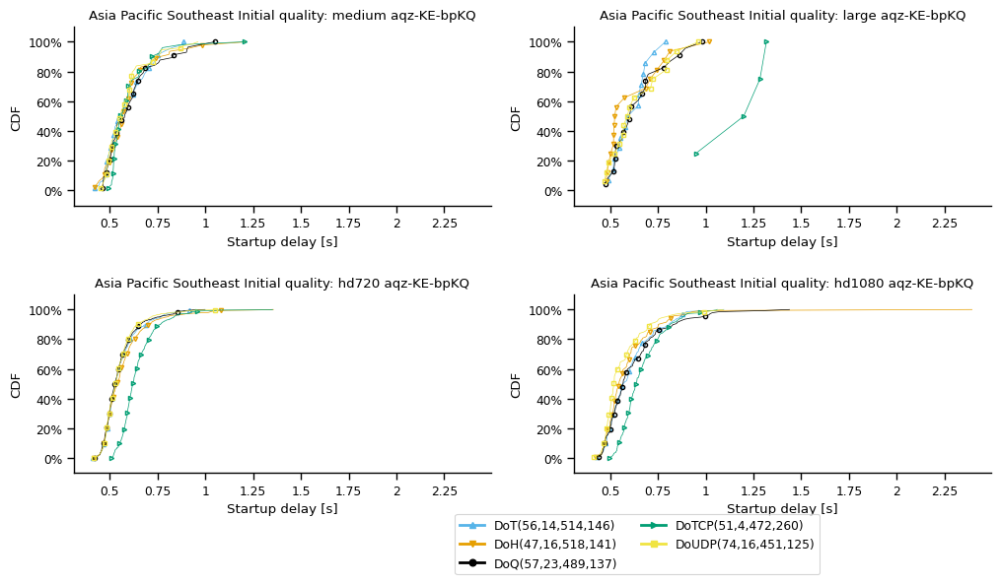

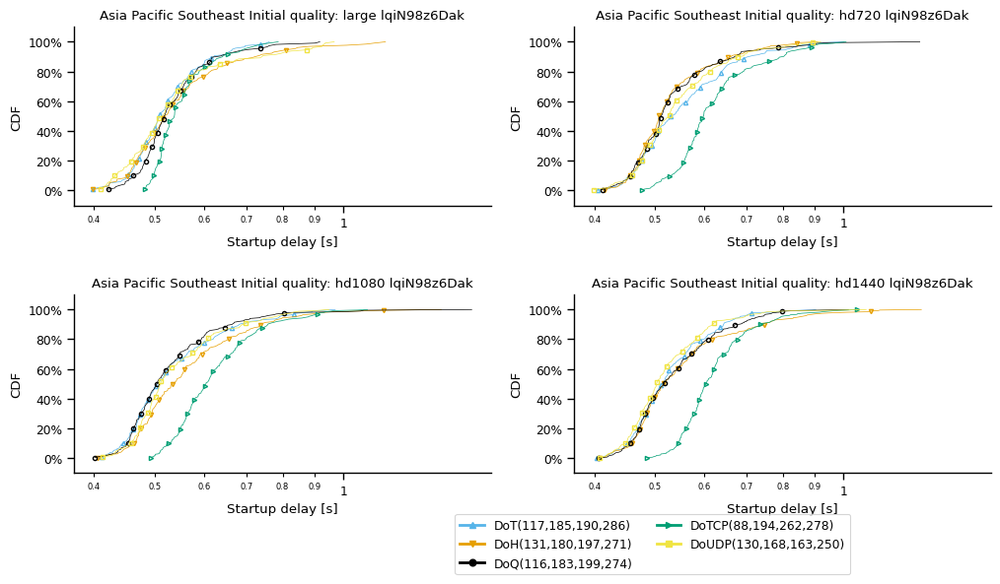

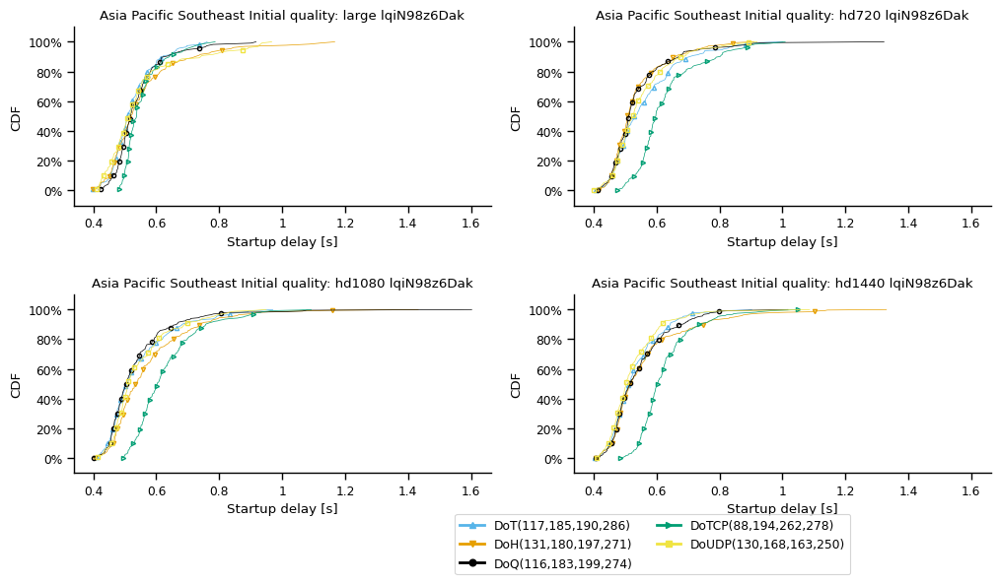

Europe Central


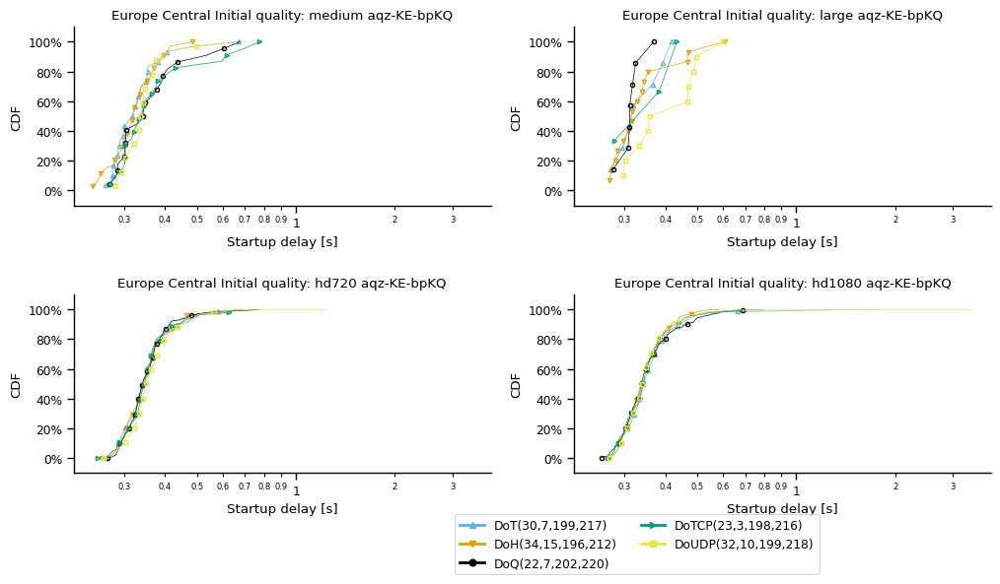

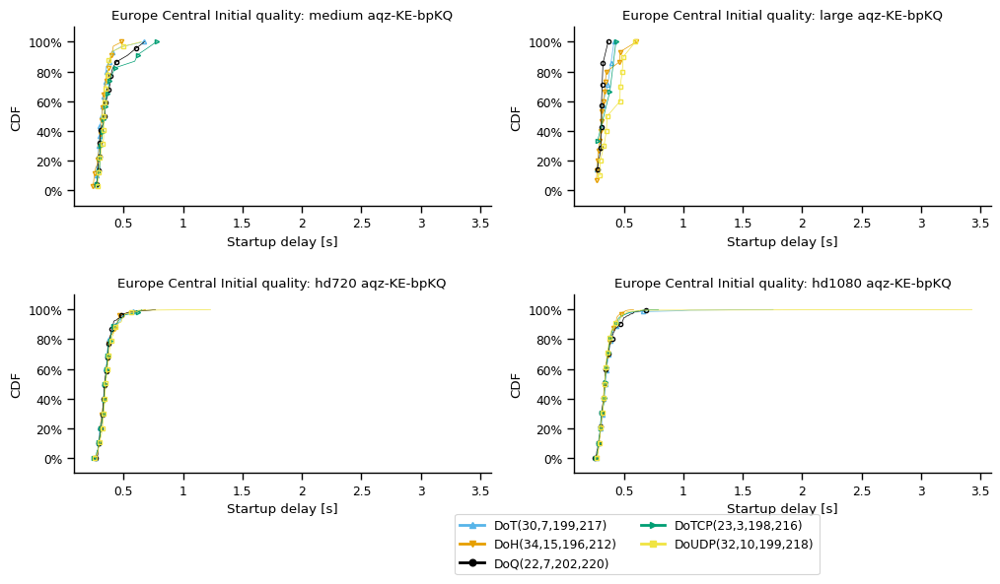

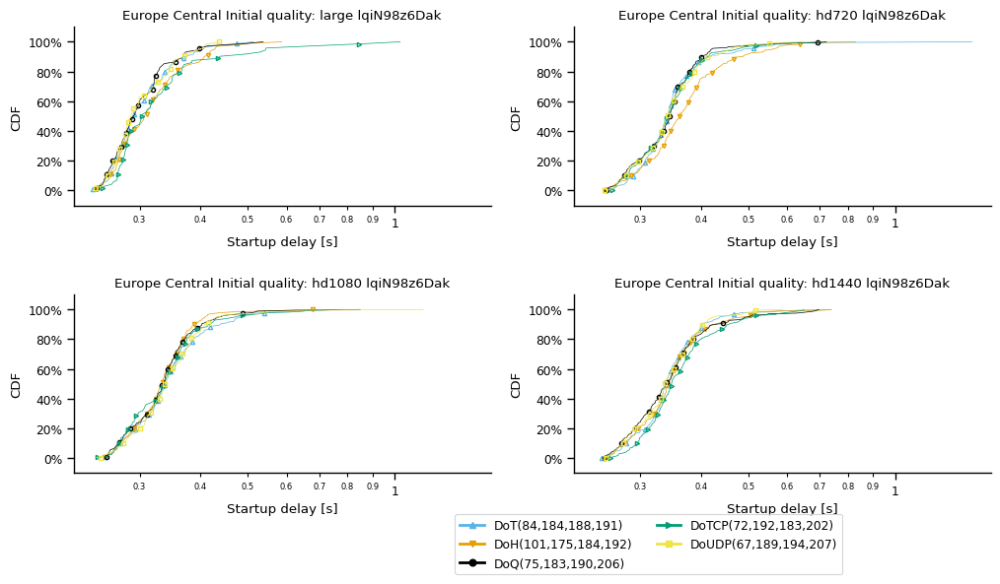

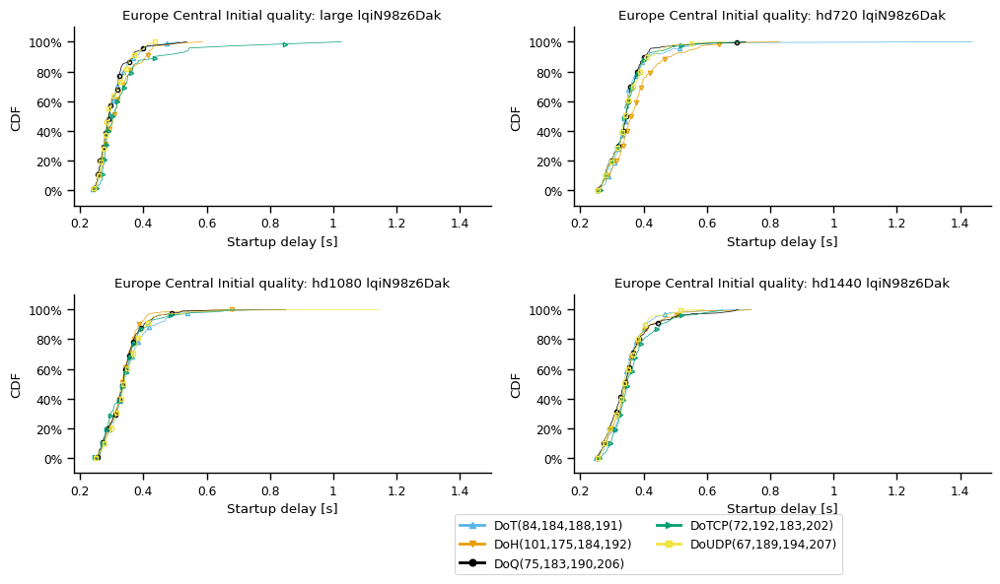

South America East


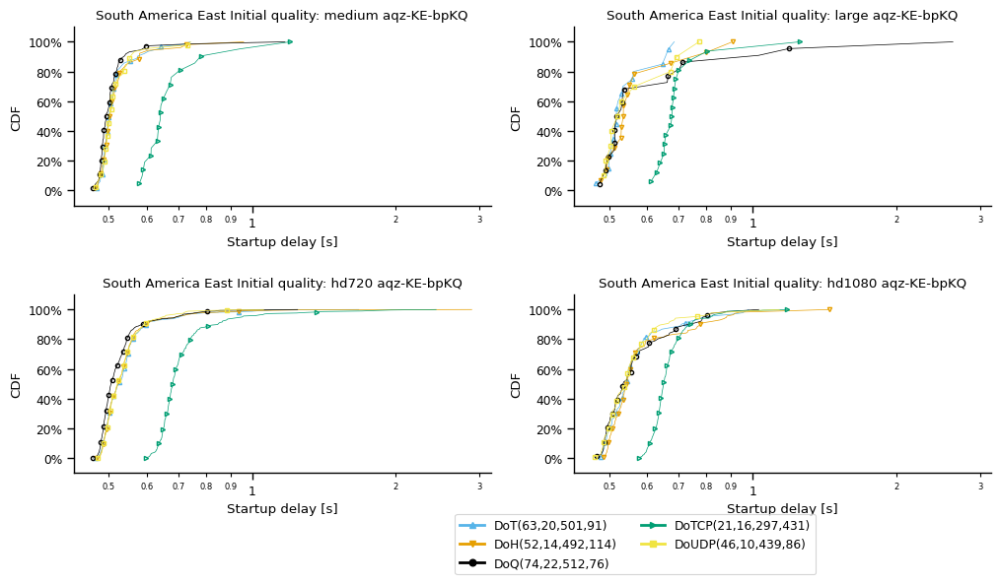

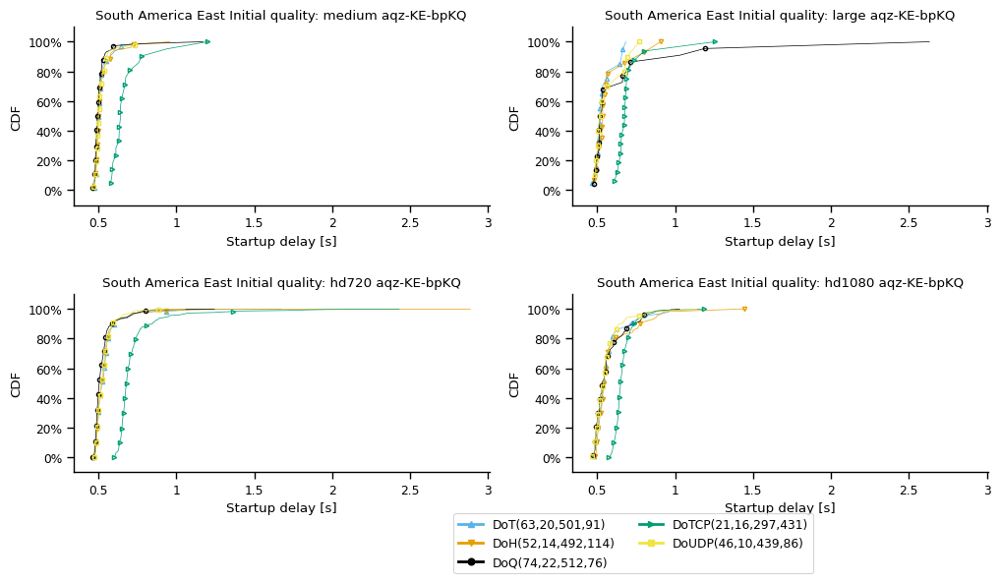

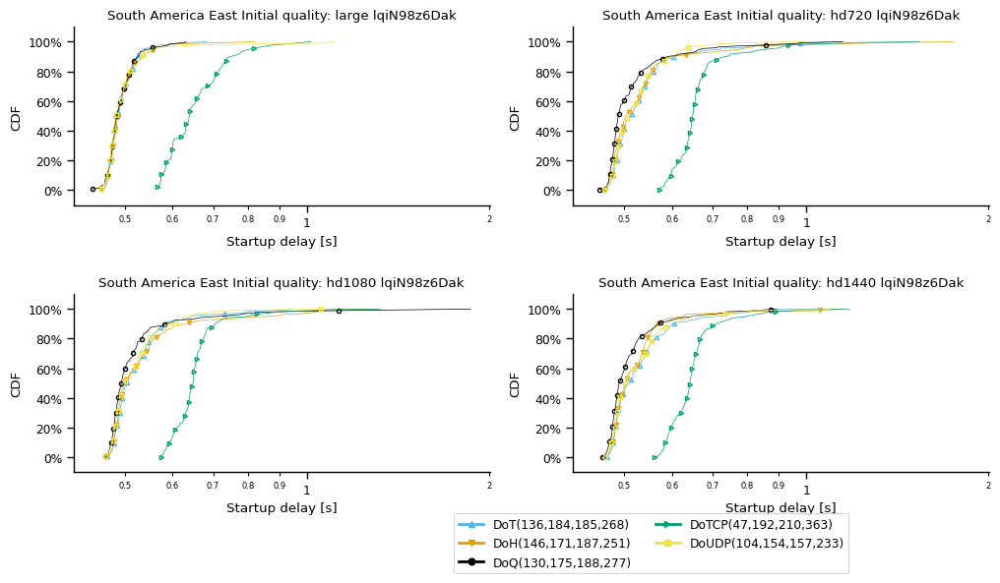

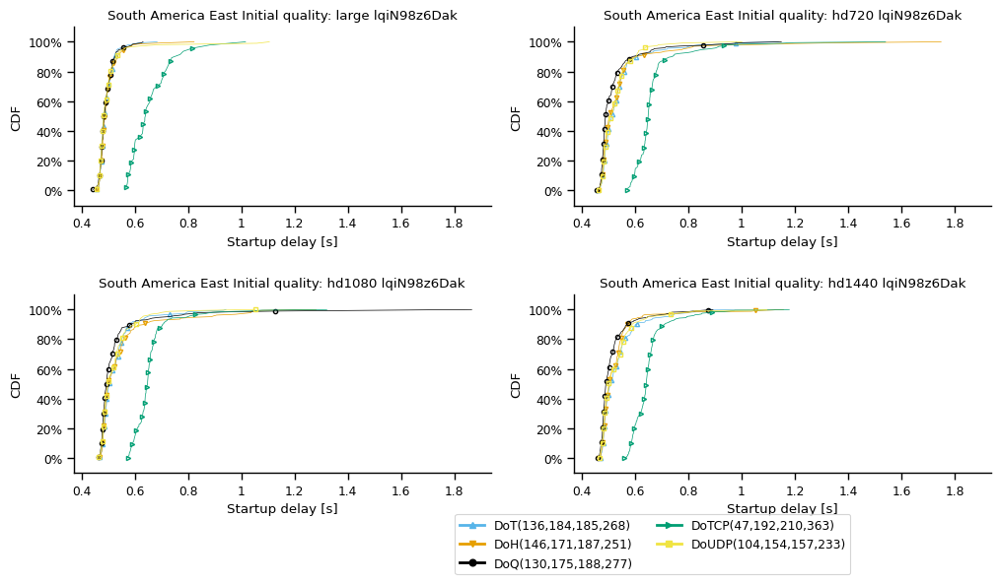

US East


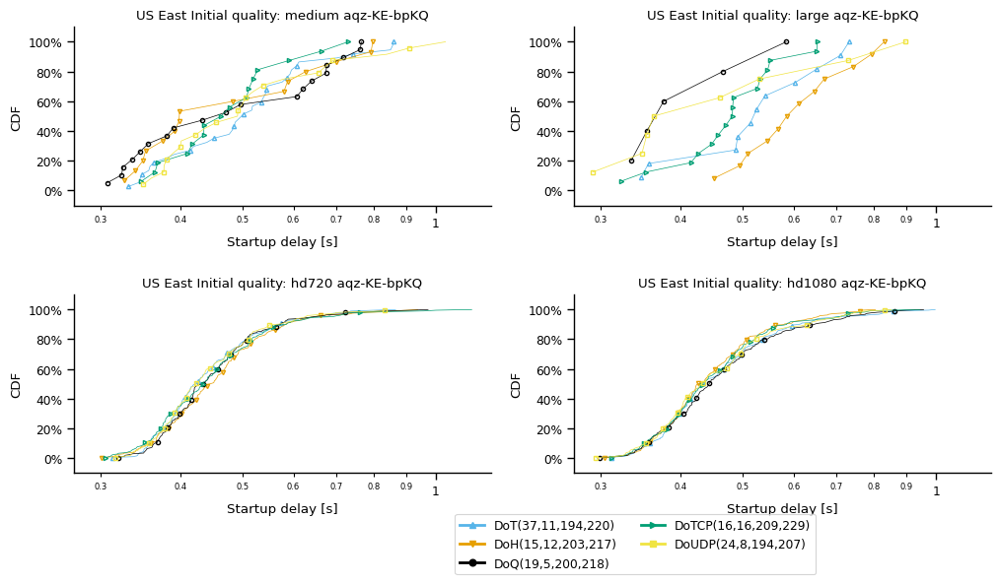

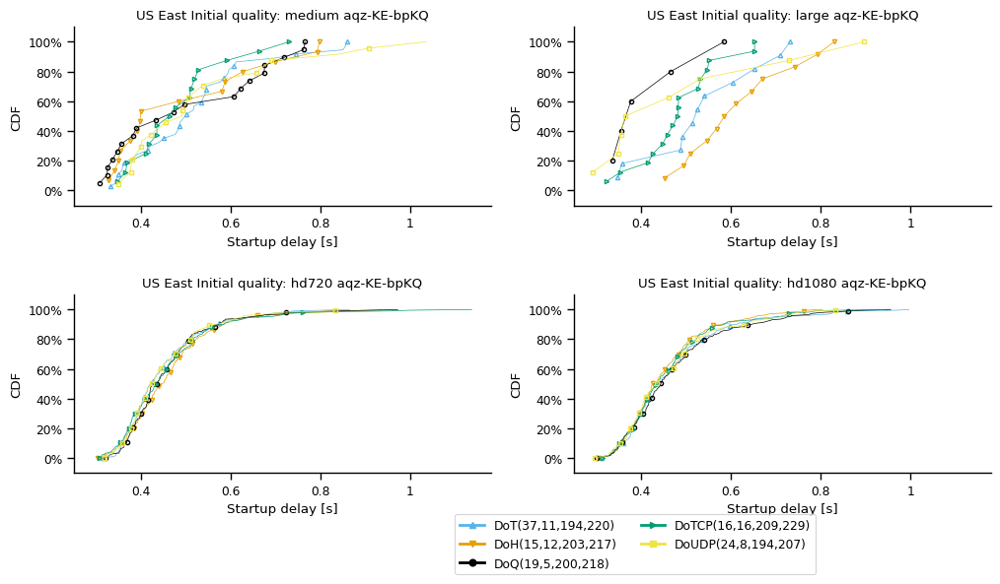

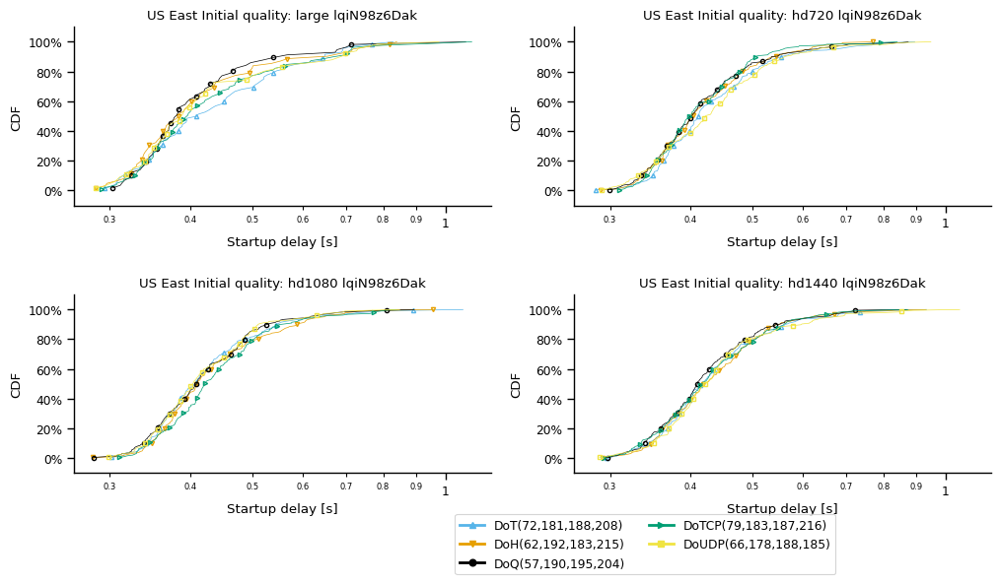

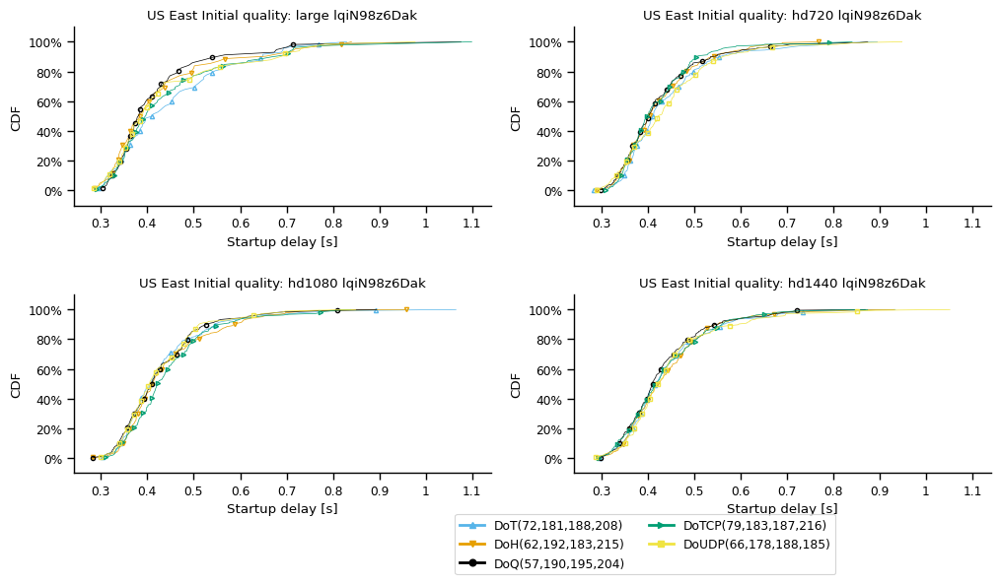

US West


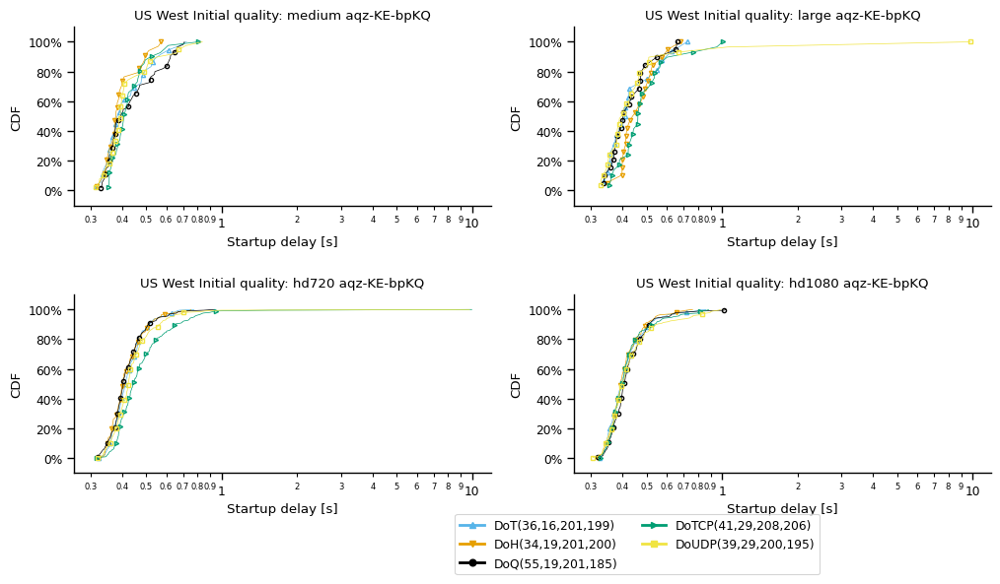

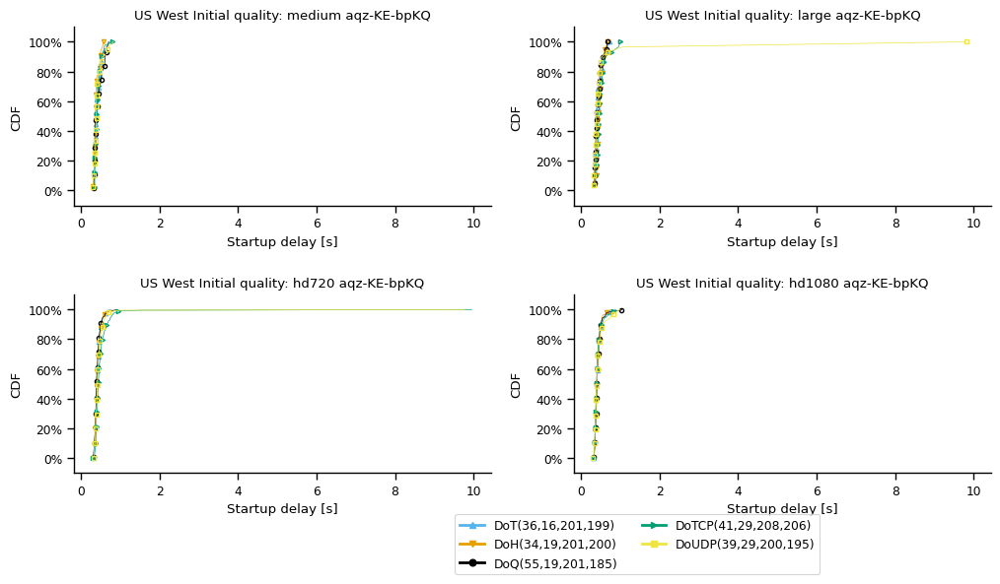

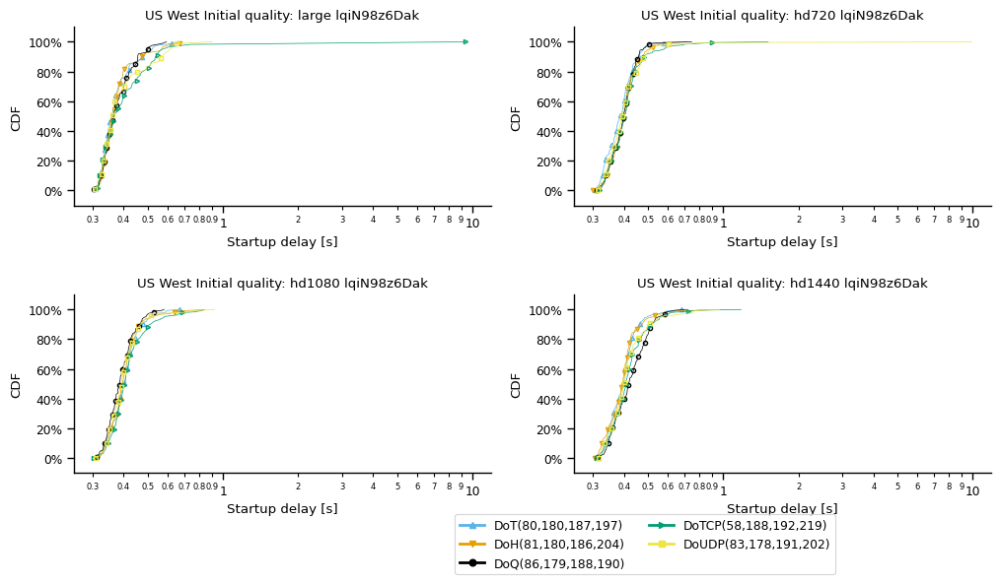

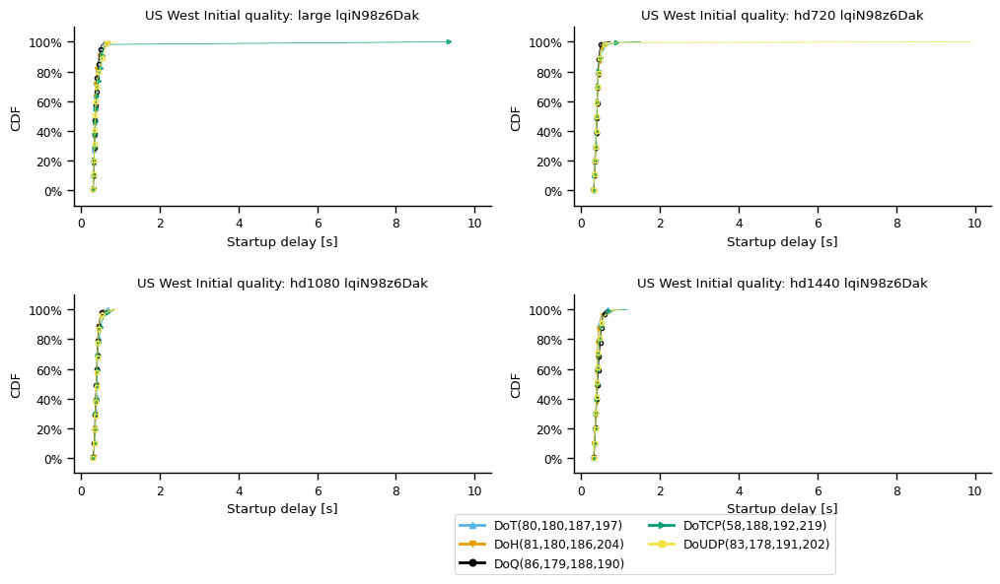

all vantage points


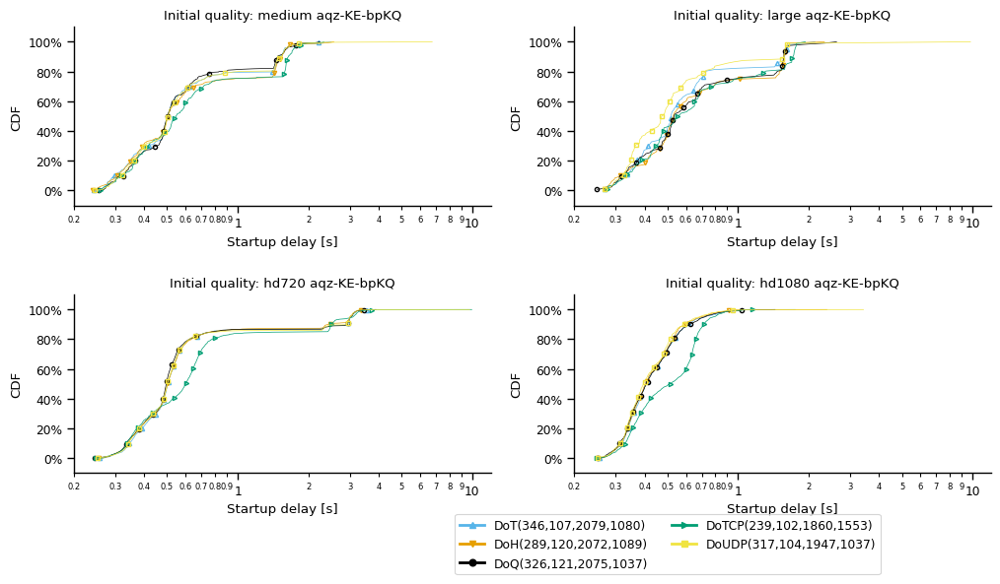

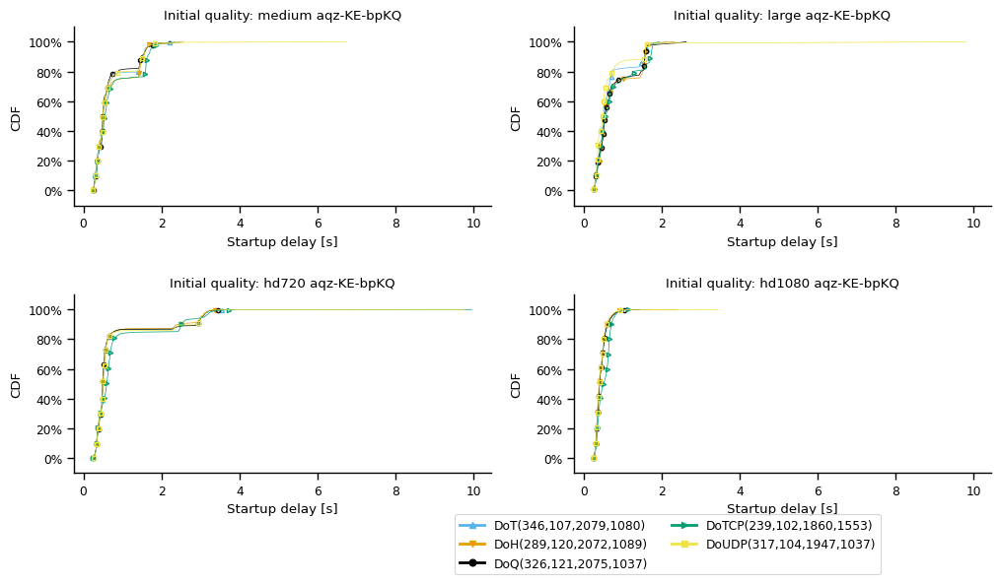

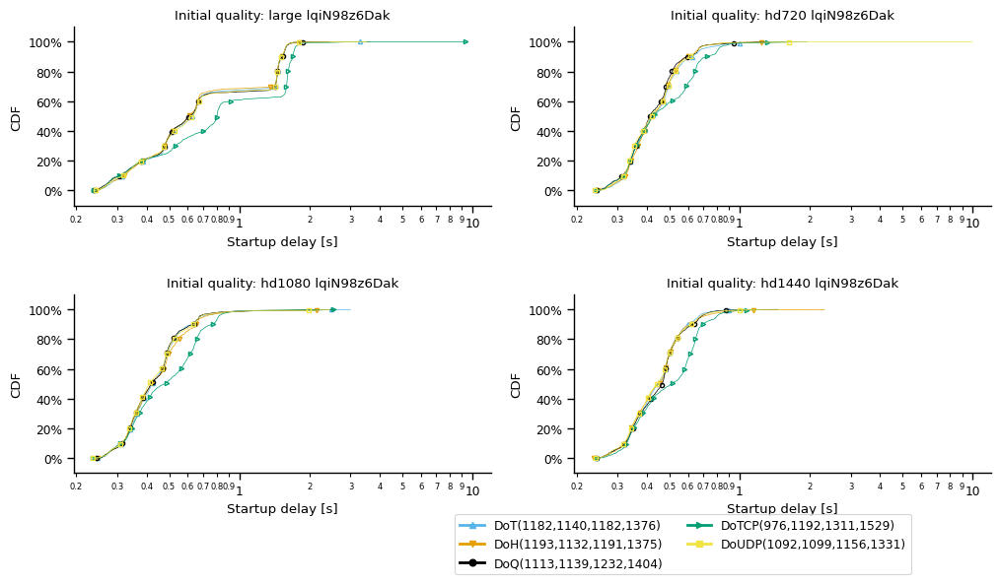

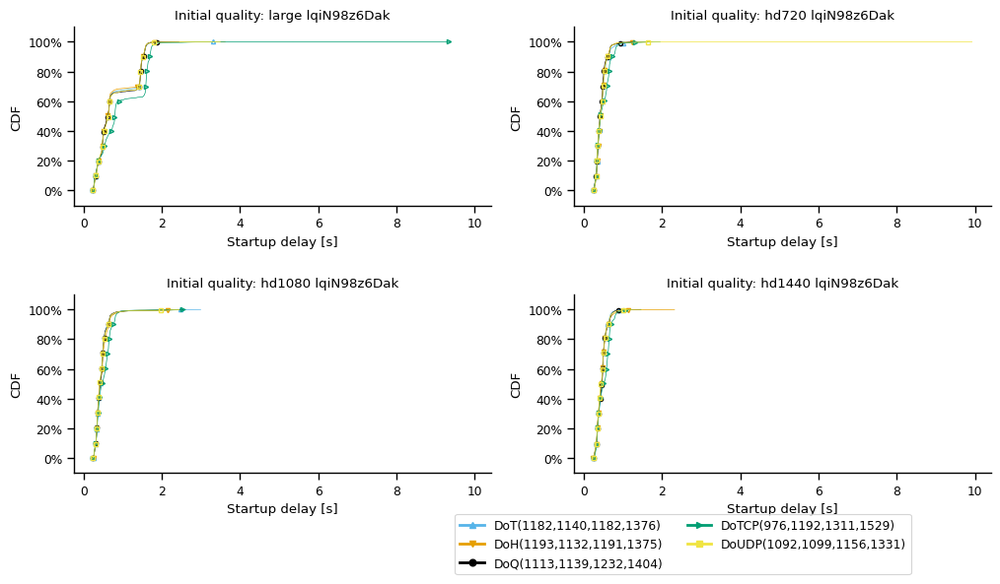

In [540]:
draw_cdf_grid(df_start_time, 'true_initial_quality', 'protocol', 'startup_delay', [True,False], 'Startup delay [s]', 'Initial quality:', 'startup-delay-by-initial-quality-and-proto', [0,0], draw_all=True)

In [ ]:
draw_cdf(df_start_time, 'true_initial_quality', 'protocol', 'startup_delay', [True,False], 'Startup delay [s]', 'Initial quality:', 'startup-delay-by-initial-quality-and-proto', [0.1,1])

In [541]:
df_player_quality_change_event_to_opt.groupby(['vantagePoint','optimal_res', 'domain']).agg({'msm_id':pd.Series.nunique})

msm_id
vantagePoint           optimal_res domain             
Africa South           1280x720    aqz-KE-bpKQ     459
                                   lqiN98z6Dak     983
                       1920x1080   aqz-KE-bpKQ     457
                                   lqiN98z6Dak     971
                       2560x1440   aqz-KE-bpKQ     458
                                   lqiN98z6Dak     907
                       3840x2160   aqz-KE-bpKQ     443
                                   lqiN98z6Dak     914
Asia Pacific Northeast 1280x720    aqz-KE-bpKQ    1027
                                   lqiN98z6Dak    1030
                       1920x1080   aqz-KE-bpKQ    1028
                                   lqiN98z6Dak    1028
                       2560x1440   aqz-KE-bpKQ    1027
                                   lqiN98z6Dak    1027
                       3840x2160   aqz-KE-bpKQ     821
                                   lqiN98z6Dak    1028
Asia Pacific Southeast 1280x720    aqz-KE-bpKQ    1009
                                   lqiN98z6Dak    1008
                       1920x1080   aqz-KE-bpKQ    1013
                                   lqiN98z6Dak    1006
                       2560x1440   aqz-KE-bpKQ    1002
                                   lqiN98z6Dak    1011
                       3840x2160   aqz-KE-bpKQ     963
                                   lqiN98z6Dak    1011
Europe Central         1280x720    aqz-KE-bpKQ    1025
                                   lqiN98z6Dak    1028
                       1920x1080   aqz-KE-bpKQ    1025
                                   lqiN98z6Dak    1028
                       2560x1440   aqz-KE-bpKQ    1022
                                   lqiN98z6Dak    1027
                       3840x2160   aqz-KE-bpKQ     937
                                   lqiN98z6Dak    1025
South America East     1280x720    aqz-KE-bpKQ     999
                                   lqiN98z6Dak     994
                       1920x1080   aqz-KE-bpKQ     998
                                   lqiN98z6Dak     988
                       2560x1440   aqz-KE-bpKQ     989
                                   lqiN98z6Dak     998
                       3840x2160   aqz-KE-bpKQ     973
                                   lqiN98z6Dak     989
US East                1280x720    aqz-KE-bpKQ    1017
                                   lqiN98z6Dak    1020
                       1920x1080   aqz-KE-bpKQ    1020
                                   lqiN98z6Dak    1013
                       2560x1440   aqz-KE-bpKQ    1019
                                   lqiN98z6Dak    1014
                       3840x2160   aqz-KE-bpKQ     772
                                   lqiN98z6Dak    1019
US West                1280x720    aqz-KE-bpKQ    1026
                                   lqiN98z6Dak    1027
                       1920x1080   aqz-KE-bpKQ    1029
                                   lqiN98z6Dak    1027
                       2560x1440   aqz-KE-bpKQ    1023
                                   lqiN98z6Dak    1023
                       3840x2160   aqz-KE-bpKQ     919
                                   lqiN98z6Dak    1026

Africa South


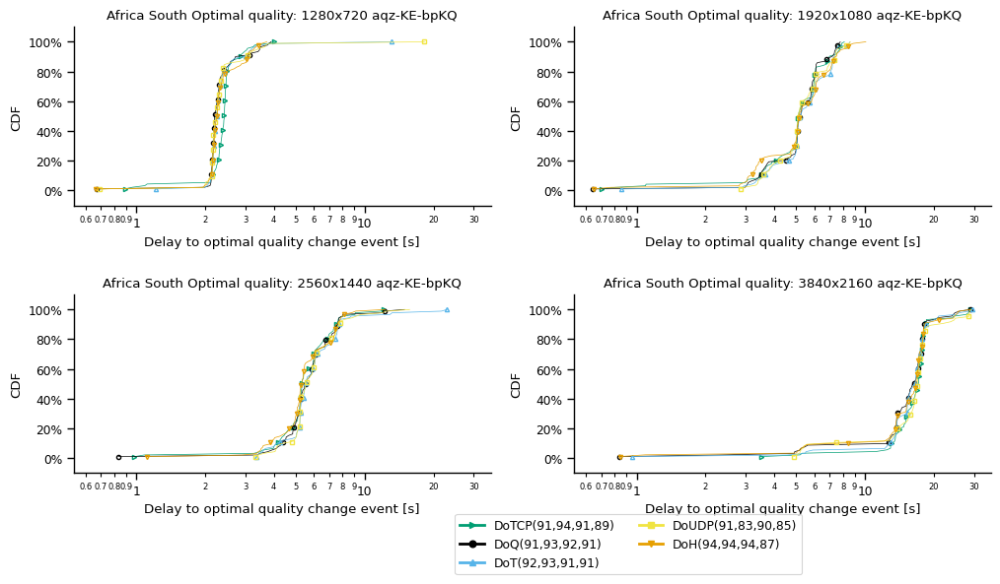

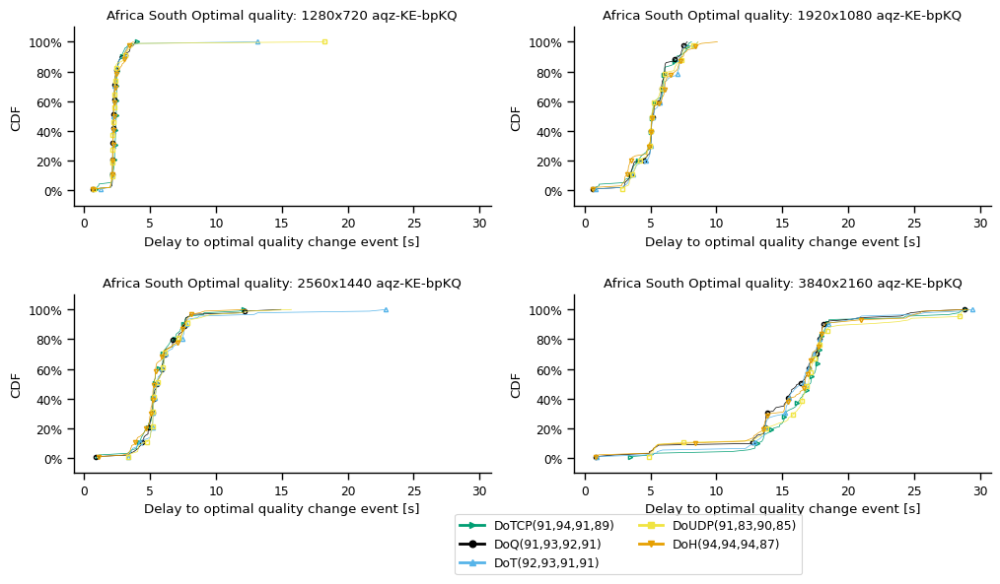

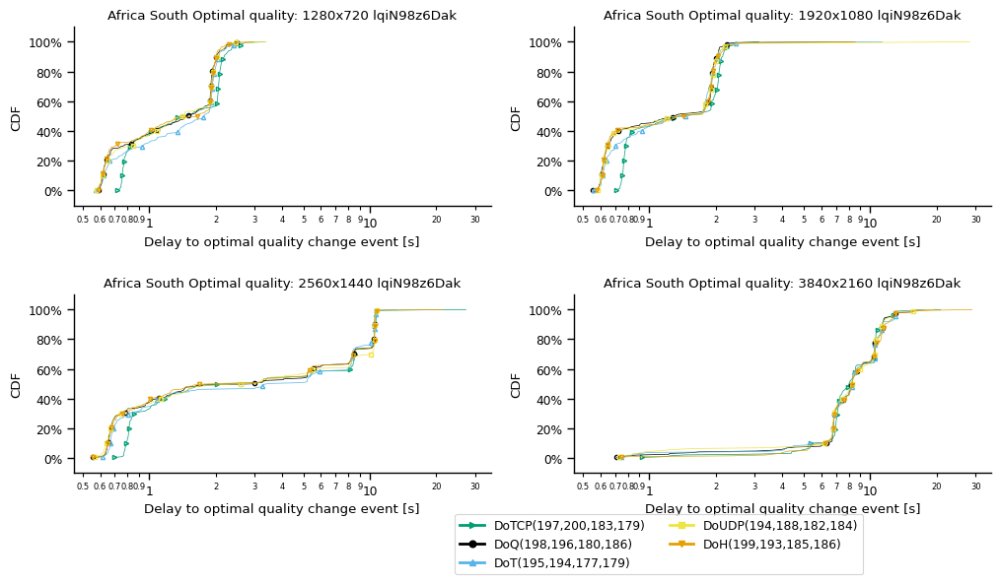

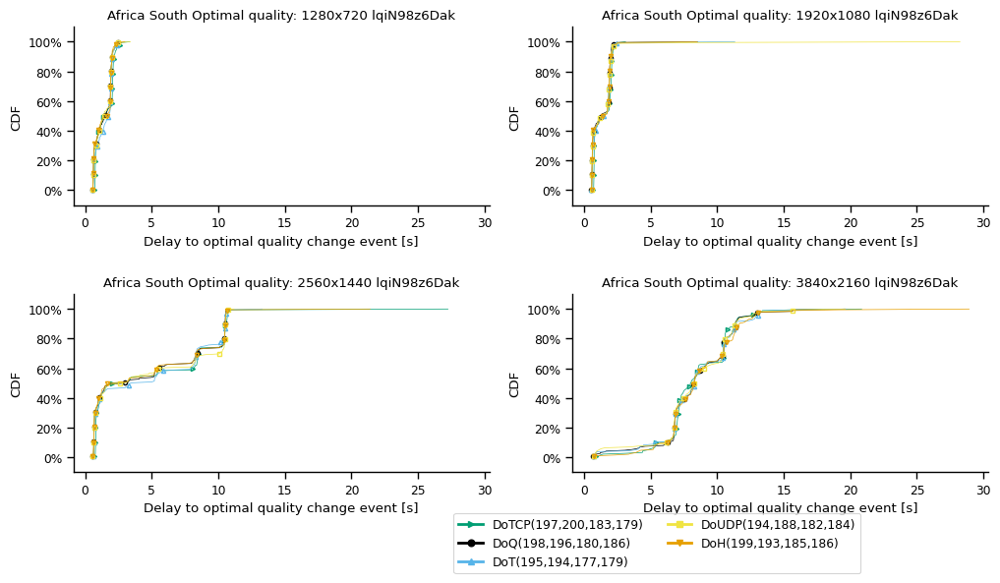

Asia Pacific Northeast


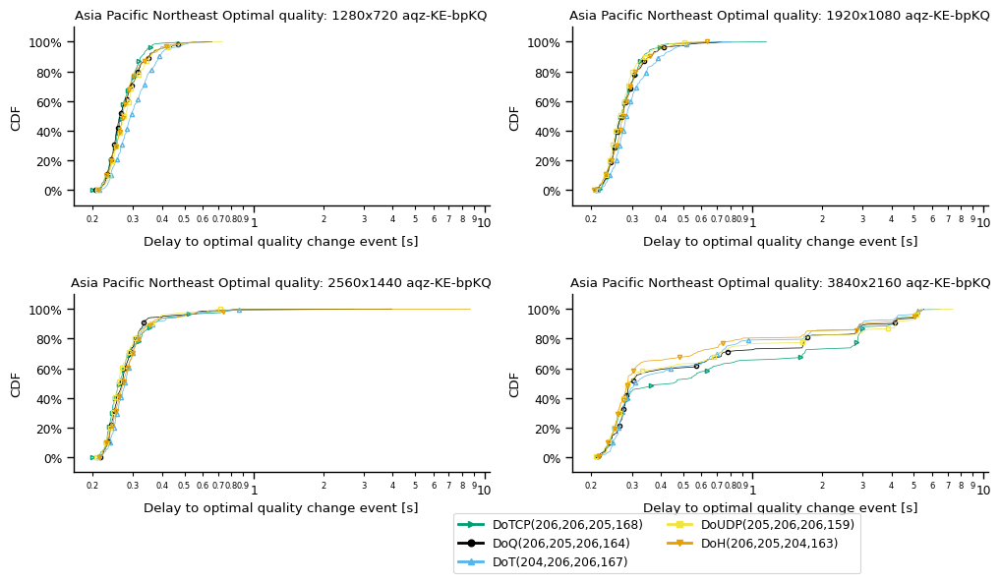

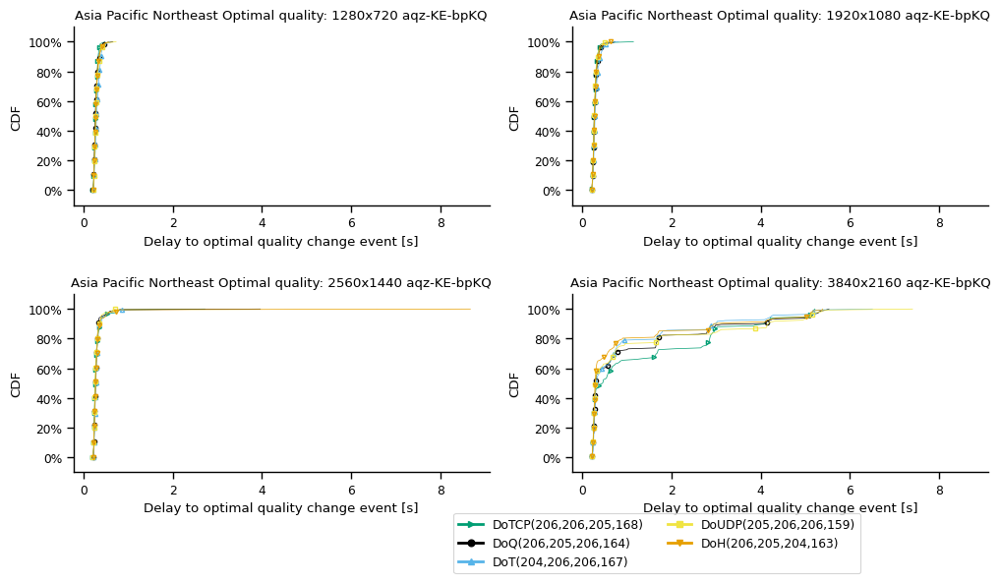

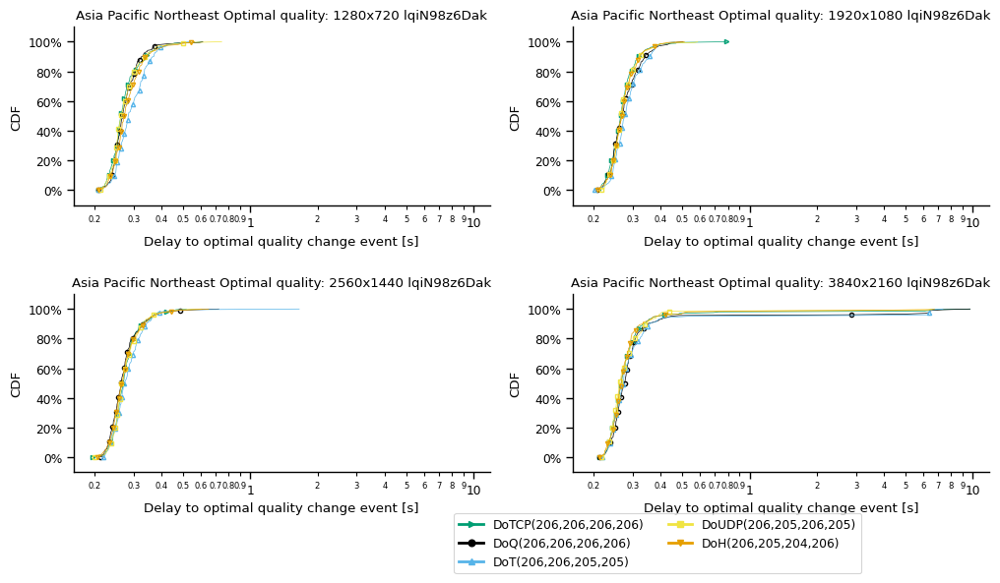

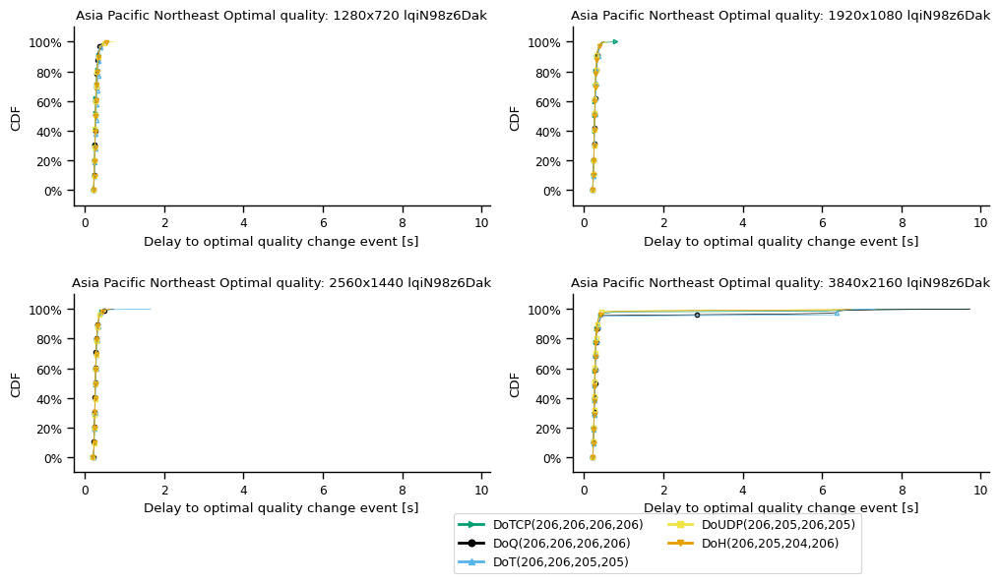

Asia Pacific Southeast


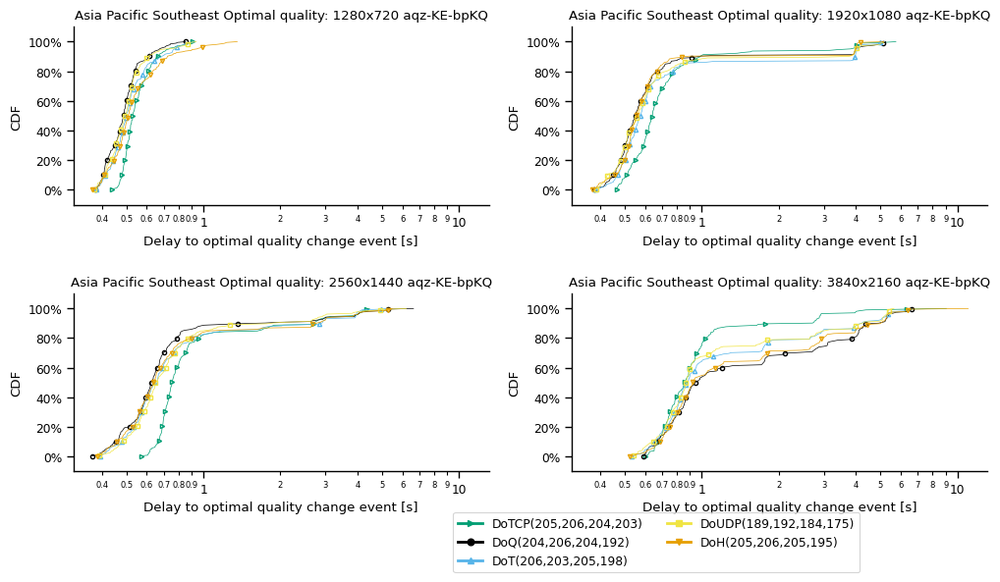

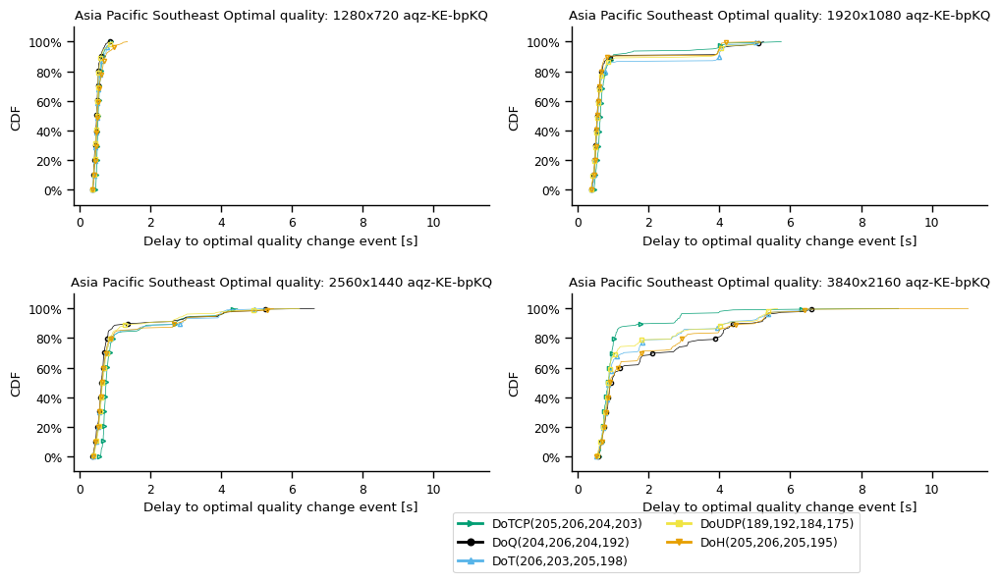

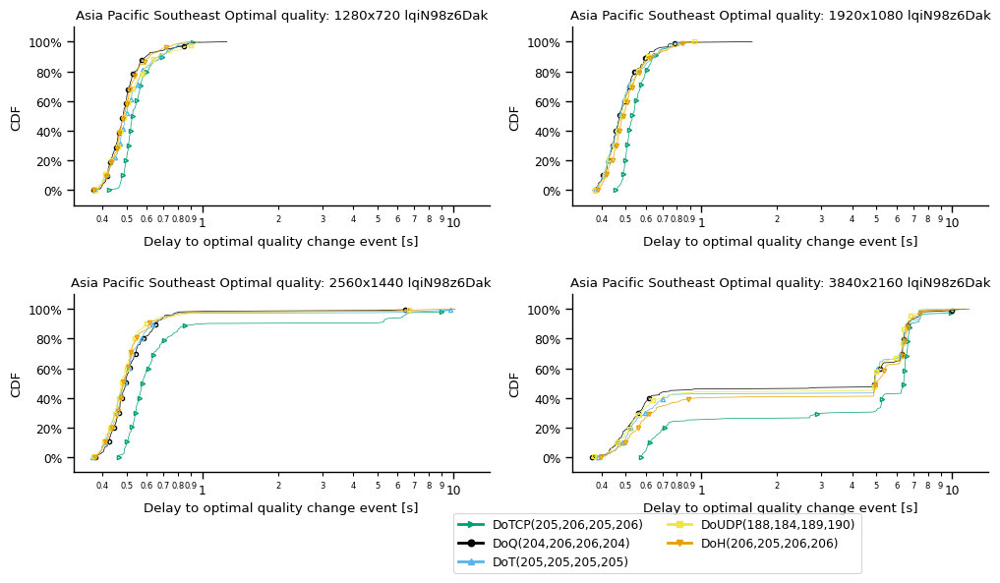

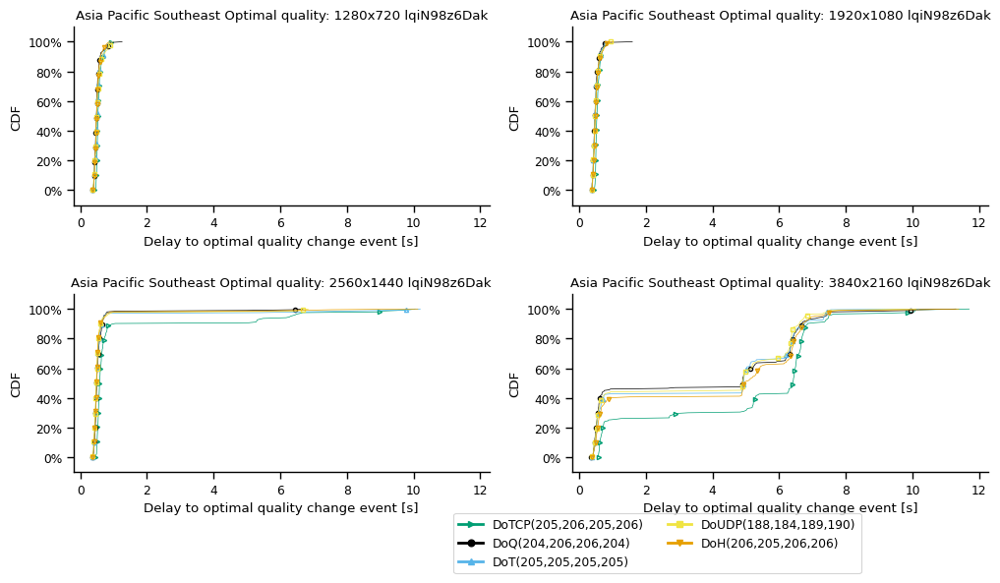

Europe Central


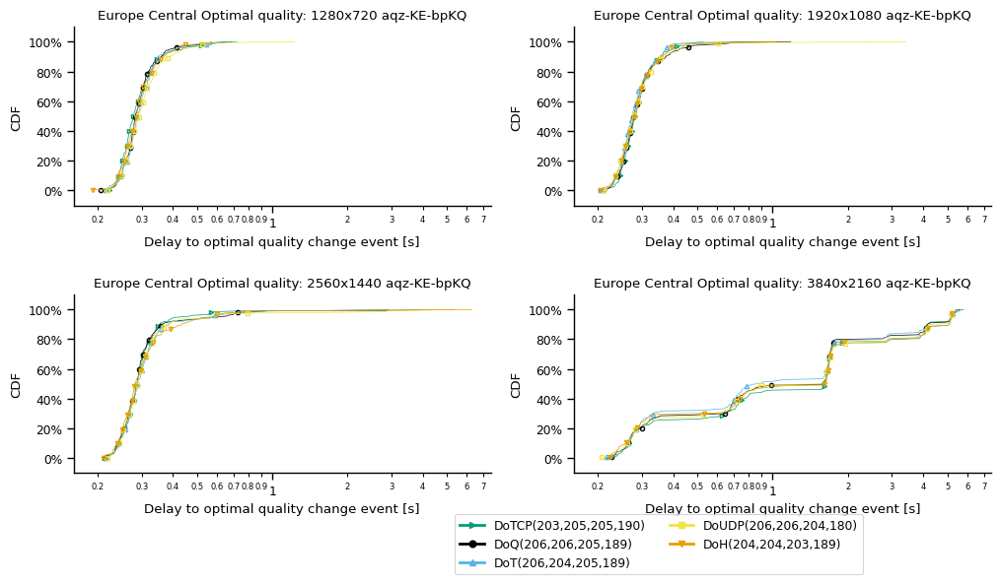

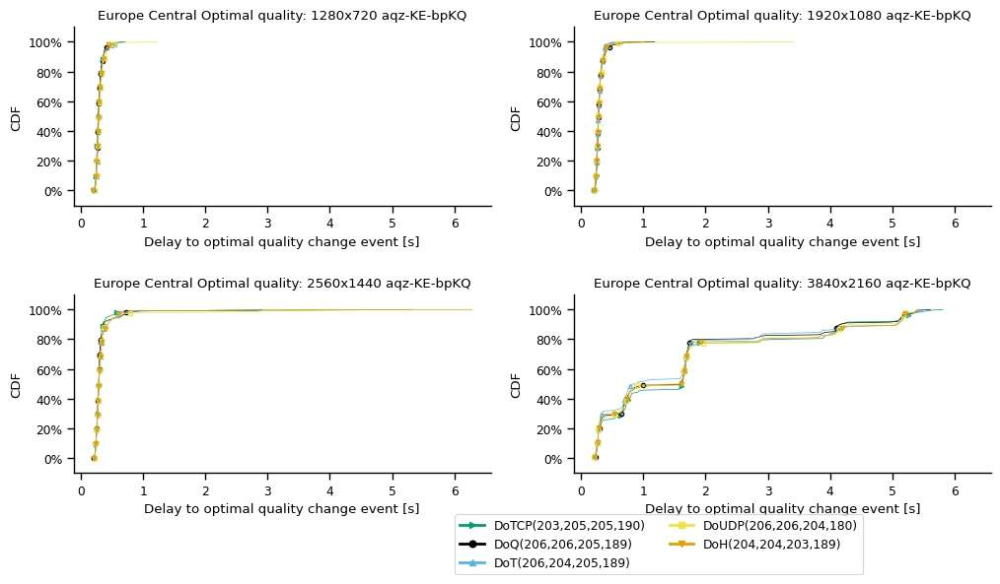

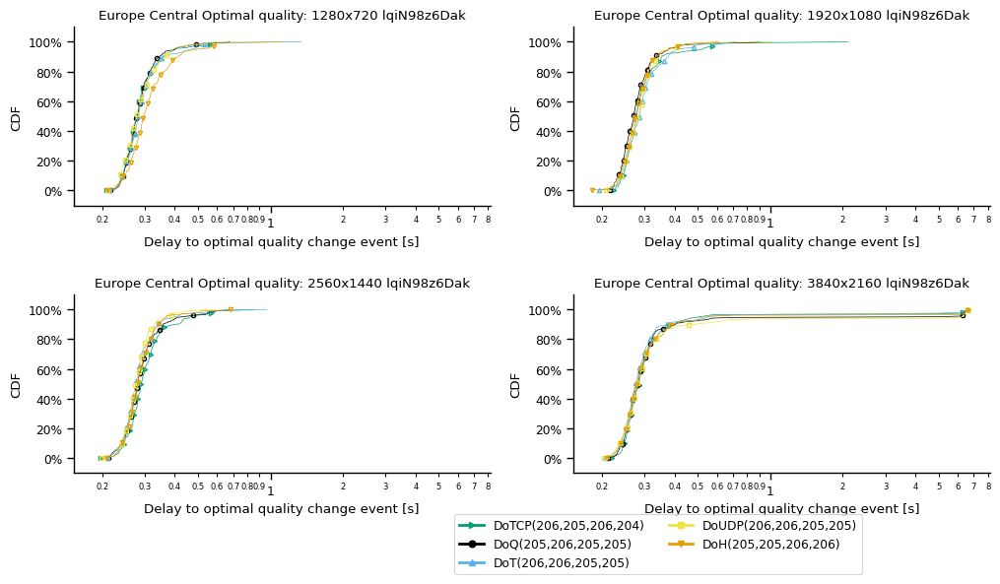

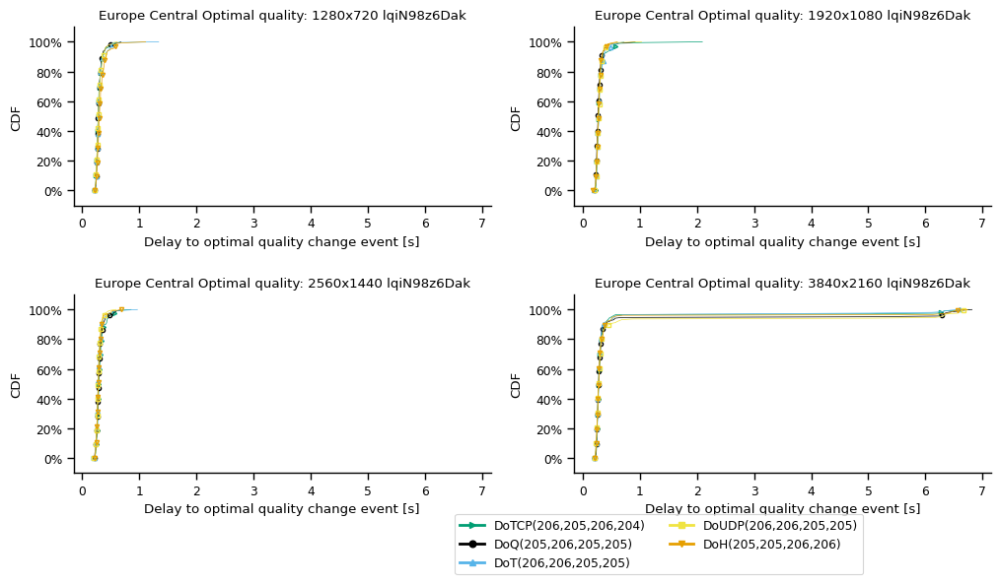

South America East


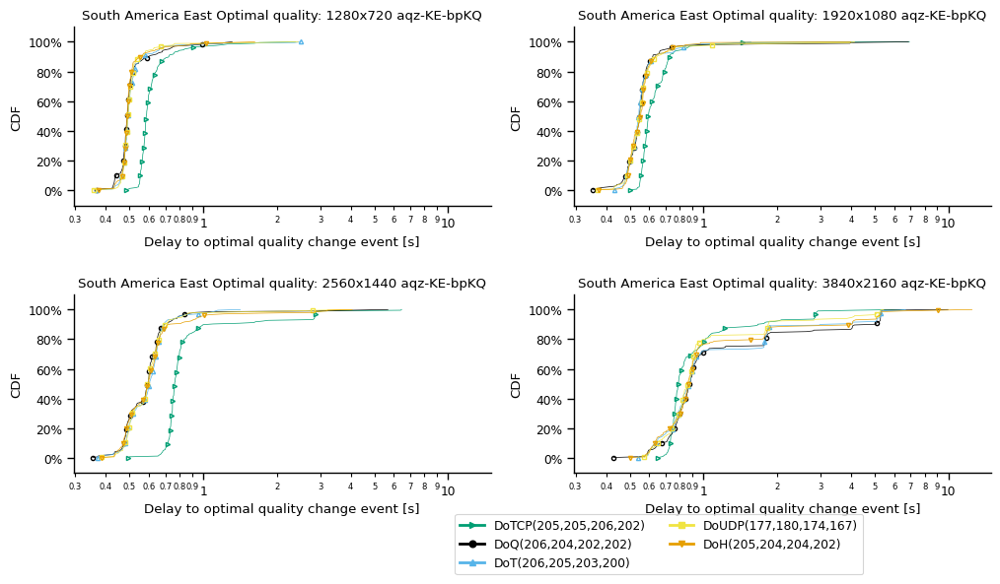

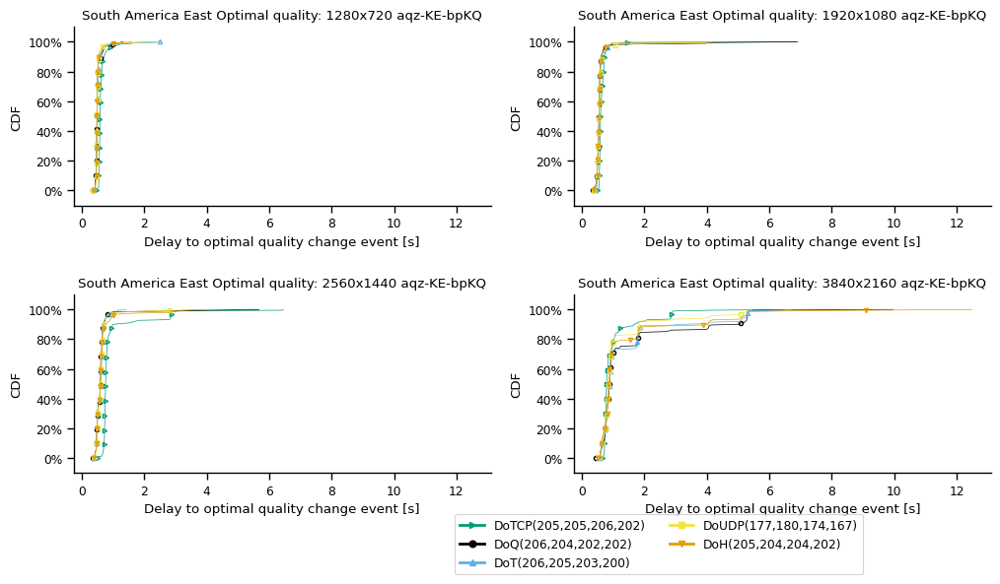

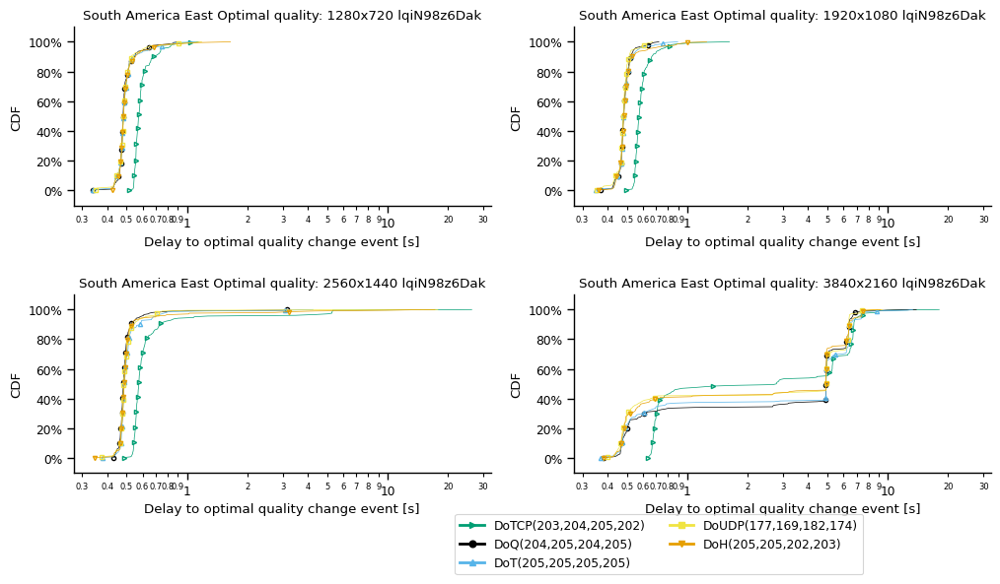

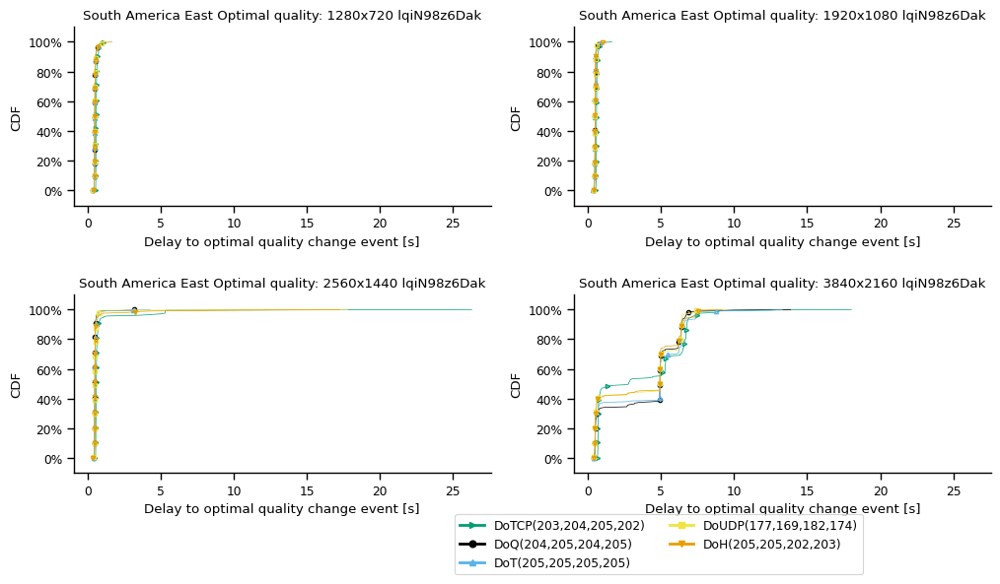

US East


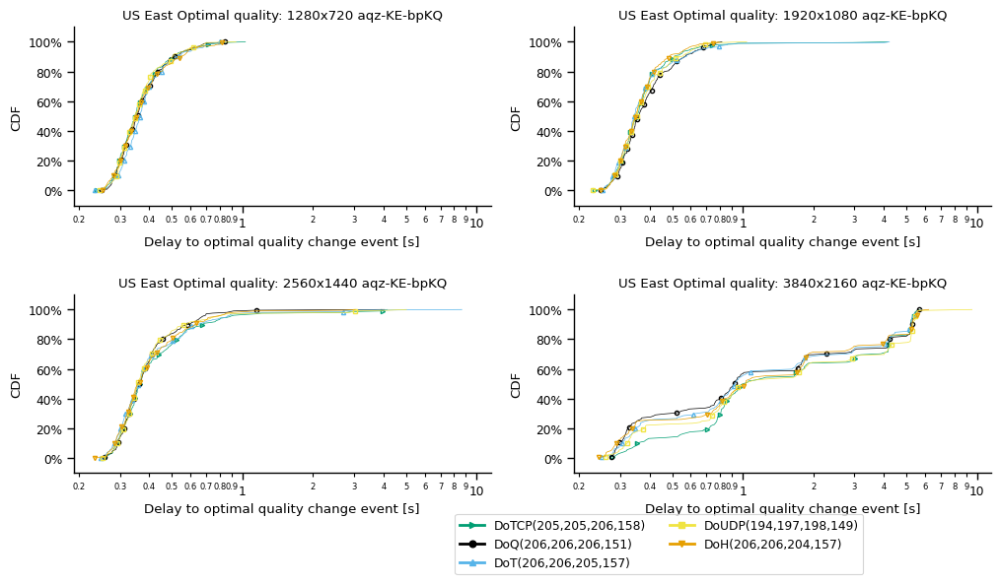

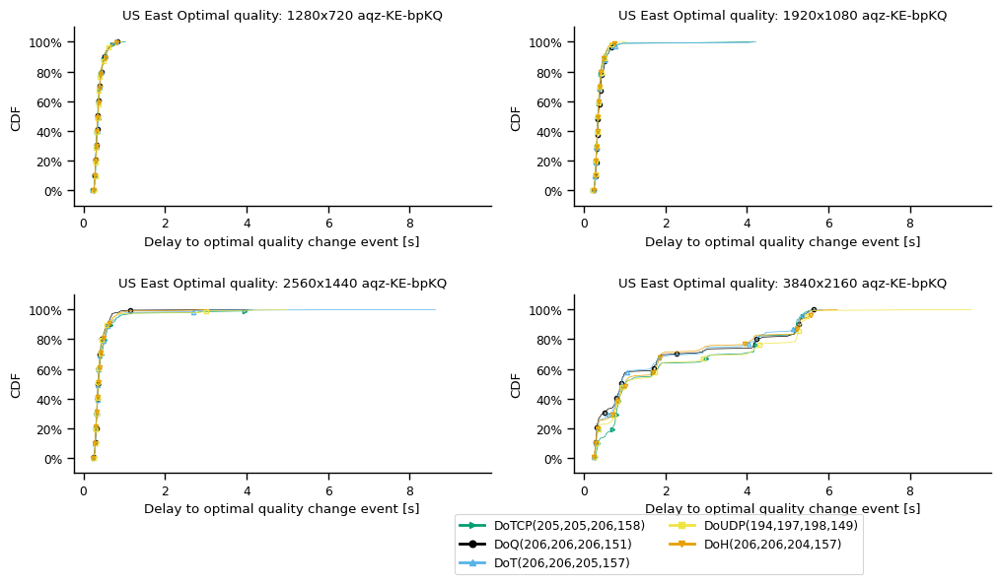

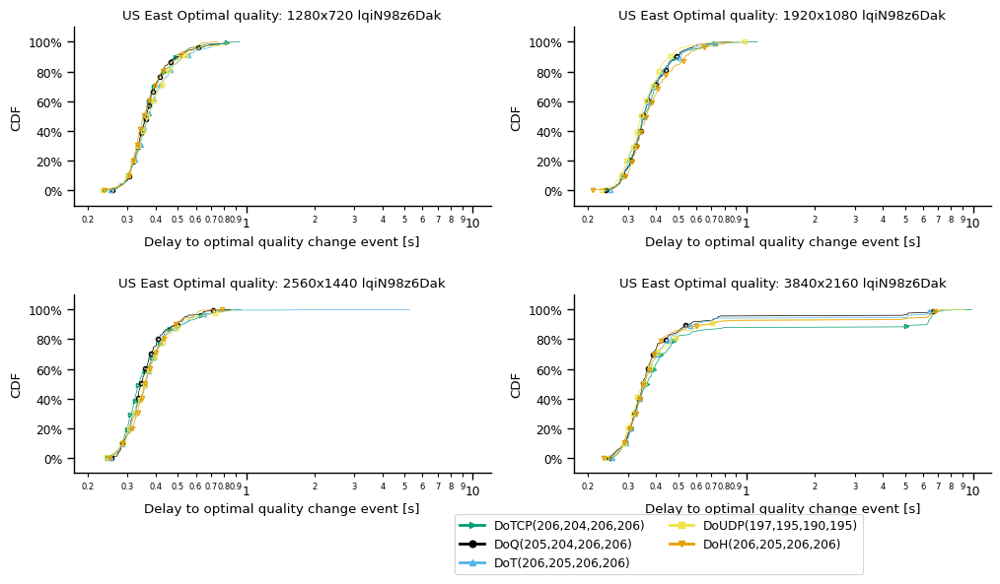

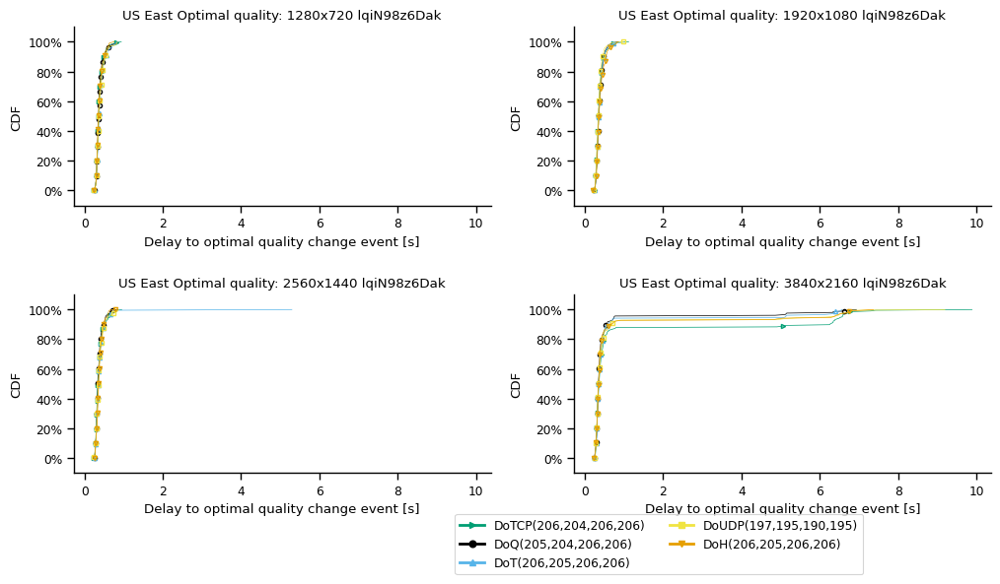

US West


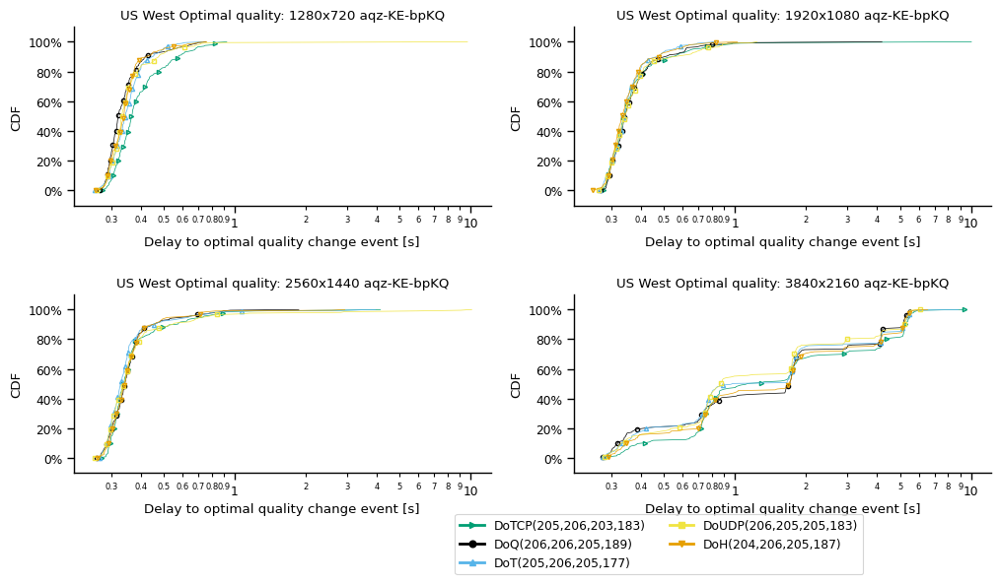

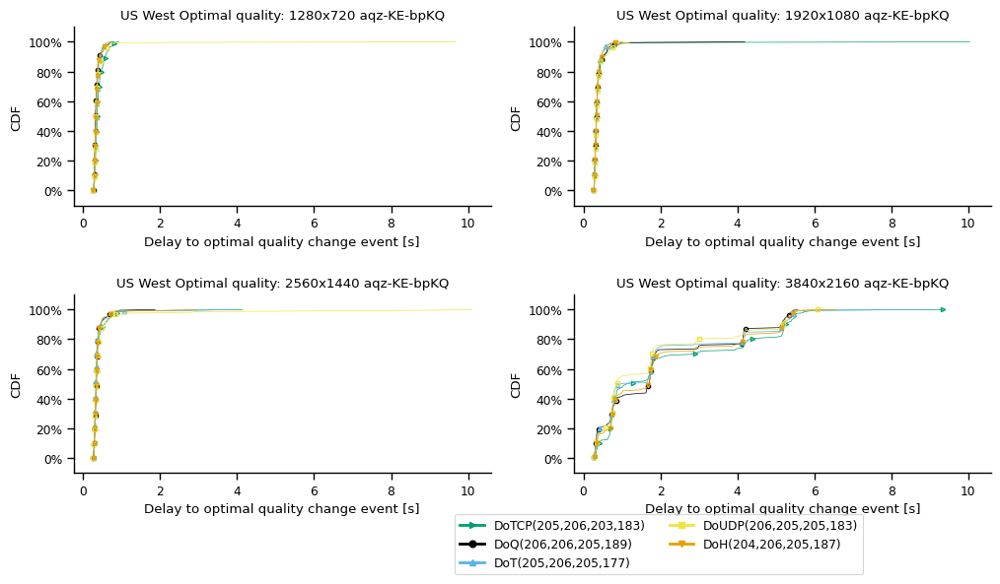

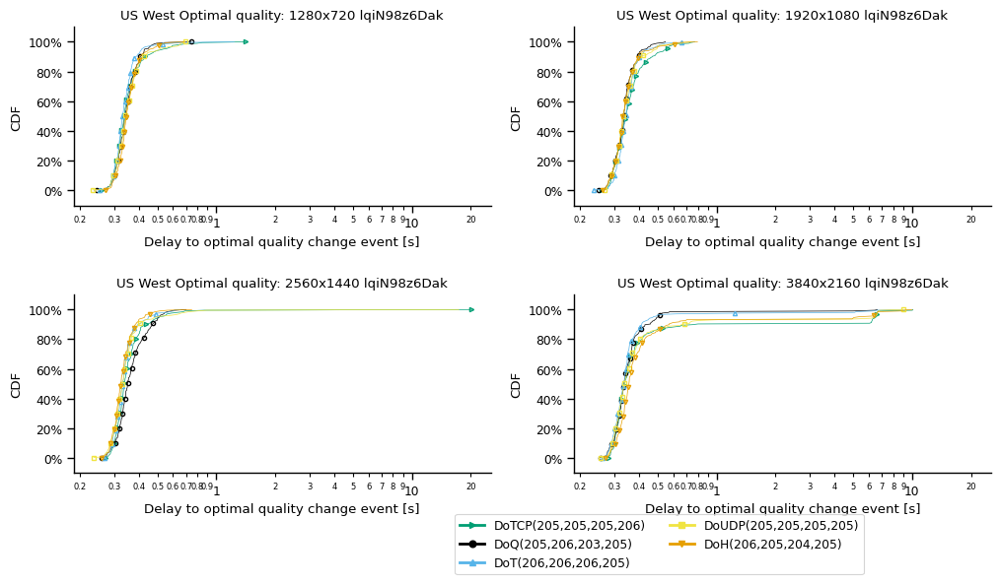

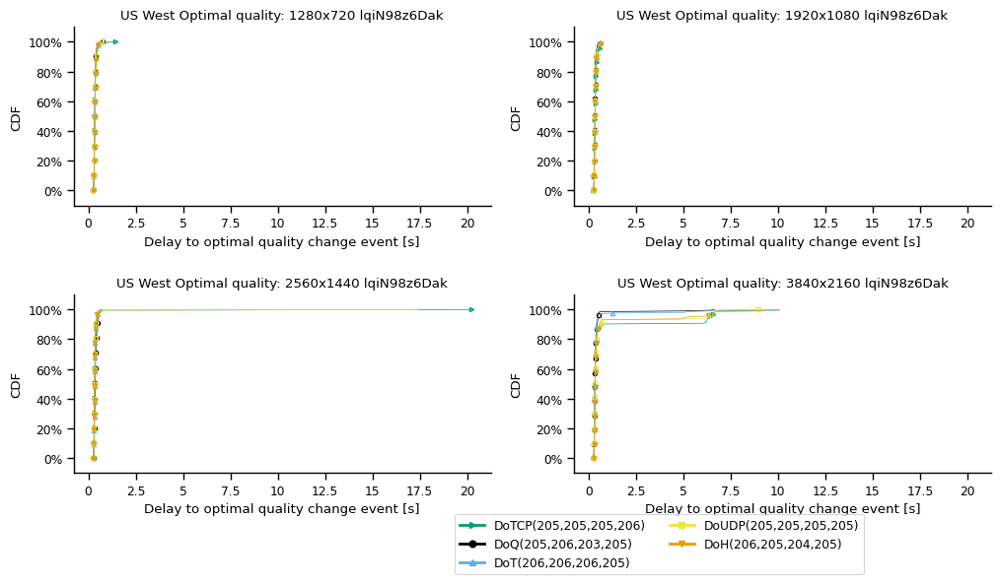

all vantage points


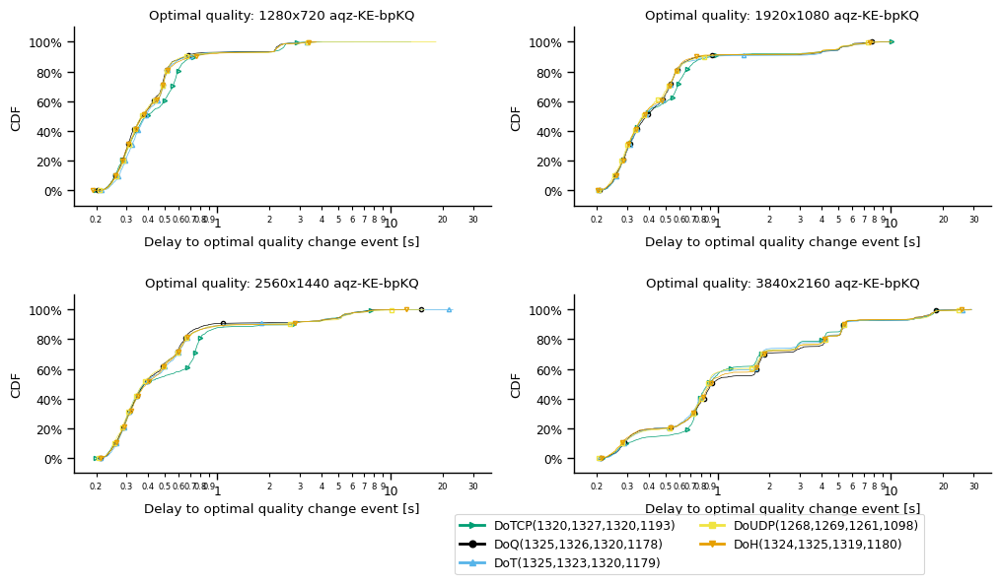

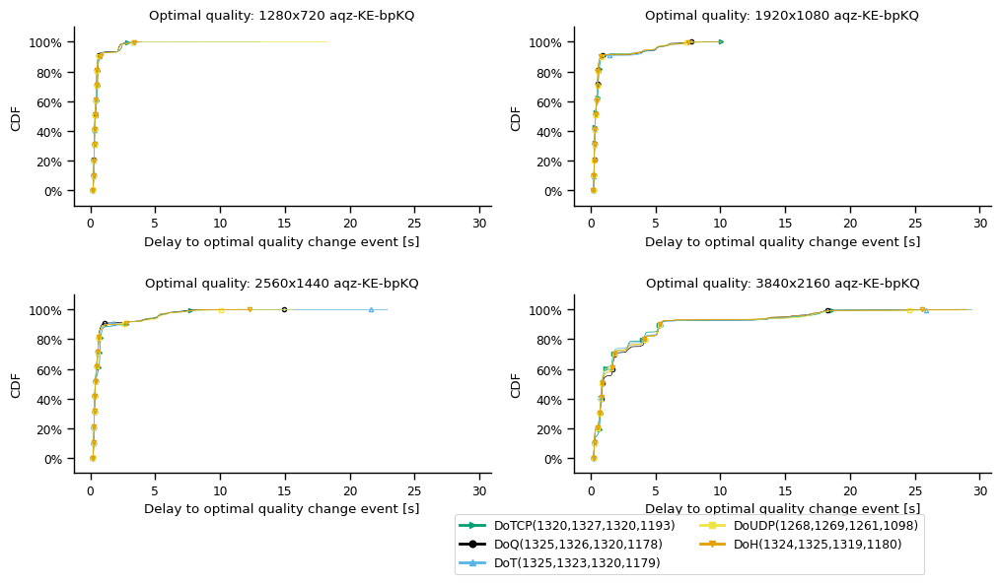

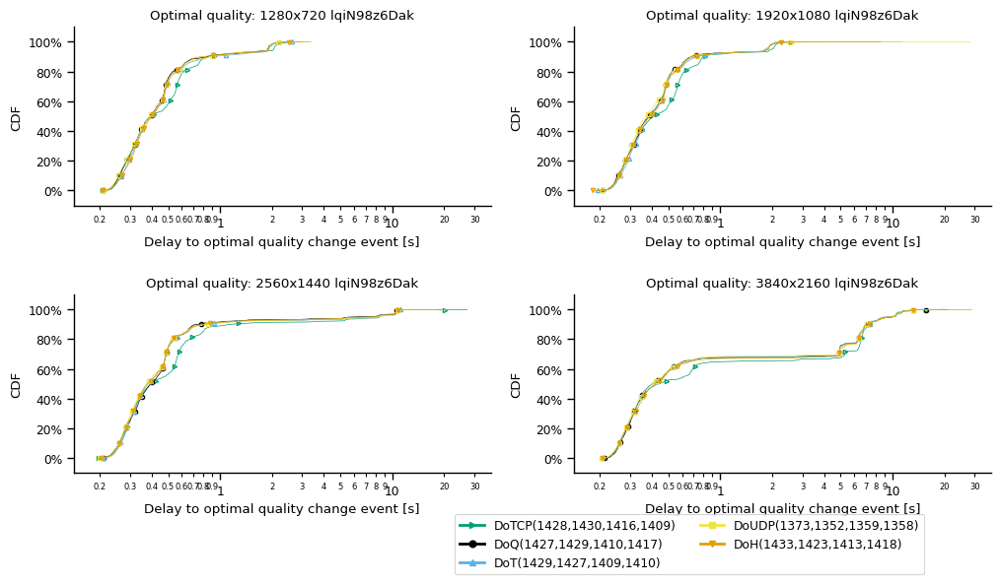

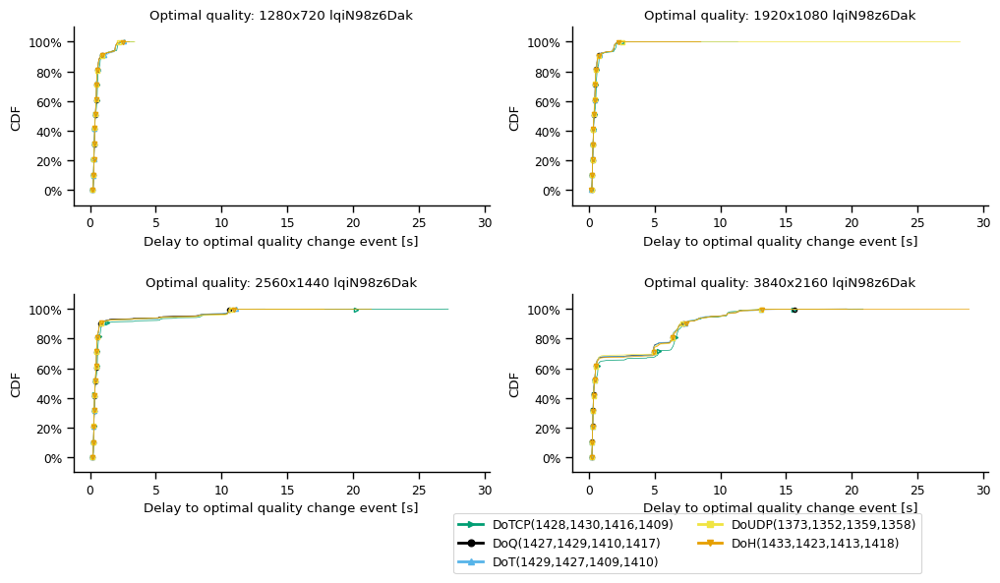

In [542]:
draw_cdf_grid(df_player_quality_change_event_to_opt, 'optimal_res', 'protocol', 'optimal_quality_delay', [True,False], 'Delay to optimal quality change event [s]', 'Optimal quality:', 'optimal-quality-delay-by-optimal-quality-and-proto', [0,0], draw_all=True)

In [ ]:
draw_cdf(df_player_quality_change_event_to_opt, 'optimal_res', 'protocol', 'optimal_quality_delay', [True,False], 'Delay to optimal quality change event [s]', 'Optimal quality:', 'optimal-quality-delay-by-optimal-quality-and-proto', [0,0])

In [543]:
def draw_boxplot_grid(df_, col_outer_groupby_, col_name_, col_metric_, log_list, xlabel, title, figname, xlim, ylabel, showmean=True, draw_all=False):
    proto_order=['DoQ', 'DoH', 'DoT', 'DoTCP', 'DoUDP']
    if col_name_ == 'protocol':
        y_order = proto_order
    else:
        y_order = sorted(df_[col_name_].unique().tolist())
    with plt.style.context('seaborn-whitegrid'):
        for vp in sorted(df_['vantagePoint'].unique().tolist()):
            print(vp)
            for video in sorted(df_['domain'].unique().tolist()):
                for log in log_list:
                    num_rows = math.ceil(df_[(df_['vantagePoint'] == vp) & (df_['domain'] == video)][col_outer_groupby_].nunique()/2)
                    if col_outer_groupby_ == 'true_initial_quality':
                        num_rows = 2
                    if df_[(df_['vantagePoint'] == vp) & (df_['domain'] == video)][col_outer_groupby_].nunique() > 1:
                        fig, axs = plt.subplots(num_rows, 2, sharex='all', figsize=(12,6*num_rows))#, sharey='all')
                        fig.subplots_adjust(hspace=.2, wspace=.3)
                        #turn off all axis before plotting, then only turn back on the ones we plot in
                        #https://stackoverflow.com/a/66799199
                        for ax in axs.flat:
                            ax.set_axis_off()
                        col_outer_groupby_values = df_[(df_['vantagePoint'] == vp) & (df_['domain'] == video)][col_outer_groupby_].sort_values().unique()
                        #if col_outer_groupby_ == 'true_initial_quality':
                        #    col_outer_groupby_values = ['hd720', 'hd1080', 'hd1440', 'hd2160']
                        for col_grp_, ax in zip(col_outer_groupby_values, axs.flat):
                        #for col_grp_ in df_[col_outer_groupby_].sort_values().unique():
                            ax.set_axis_on()
                            lnwidth = .5
                            mrksize = 3
                            df_tmp = df_[(df_[col_outer_groupby_]==col_grp_)&(df_['vantagePoint'] == vp) & (df_['domain'] == video)]
                            #hue=
                            
                            boxplt = sns.boxplot(x=col_metric_, y=col_name_ , data=df_tmp, orient='h', linewidth=1, ax=ax, 
                            showfliers=False, order=y_order,
                            color='white',
                            meanline = True, showmeans = showmean, meanprops=dict(color='darkgoldenrod'), medianprops=dict(color='blue'))
                            #sw = sns.swarmplot(x=col_metric_, y=col_name_, data=df_tmp, color=".25", ax=ax, orient='h', size=1.5, order=y_order)
                            
                            if log:
                                ax.set_xscale('log')
                            
                            
                            ax.xaxis.set_major_formatter(ticker.StrMethodFormatter("{x:g}"))
                            ax.xaxis.set_minor_formatter(ticker.StrMethodFormatter("{x:g}"))
                            ax.tick_params(axis='x', which='minor', labelsize=6)
                            ax.xaxis.set_tick_params(labelbottom=True, which='both')


                            ax.set_title(vp+' '+title+ ' ' + col_grp_ + ' ' + video)

                            ax.set_xlabel(xlabel)

                            ax.set_ylabel(ylabel)
                            if xlim != [0,0]:
                                ax.set_xlim(xlim)

                            ax.yaxis.set_minor_locator(ticker.MultipleLocator(0.5))
                            ax.grid(b=True, which='both')


                        if log:
                            fig.savefig('figures/boxplot-'+figname+'-grid-'+video+vp+'-log.pdf', format='pdf', bbox_inches='tight')
                        else:
                            fig.savefig('figures/boxplot-'+figname+'-grid-'+video+vp+'.pdf', format='pdf', bbox_inches='tight')
                        plt.show()
        if draw_all:
            print('all vantage points')
            for video in sorted(df_['domain'].unique().tolist()):
                for log in log_list:
                    num_rows = math.ceil(df_[(df_['domain'] == video)][col_outer_groupby_].nunique()/2)
                    if col_outer_groupby_ == 'true_initial_quality':
                        num_rows = 2
                    if df_[(df_['domain'] == video)][col_outer_groupby_].nunique() > 1:
                        fig, axs = plt.subplots(num_rows, 2, sharex='all', figsize=(12,6*num_rows))#, sharey='all')
                        fig.subplots_adjust(hspace=.2, wspace=.3)
                        #turn off all axis before plotting, then only turn back on the ones we plot in
                        #https://stackoverflow.com/a/66799199
                        for ax in axs.flat:
                            ax.set_axis_off()
                        col_outer_groupby_values = df_[(df_['domain'] == video)][col_outer_groupby_].sort_values().unique()
                        #if col_outer_groupby_ == 'true_initial_quality':
                        #    col_outer_groupby_values = ['hd720', 'hd1080', 'hd1440', 'hd2160']
                        for col_grp_, ax in zip(col_outer_groupby_values, axs.flat):
                        #for col_grp_ in df_[col_outer_groupby_].sort_values().unique():
                            ax.set_axis_on()
                            lnwidth = .5
                            mrksize = 3
                            df_tmp = df_[(df_[col_outer_groupby_]==col_grp_)&(df_['domain'] == video)]
                            #hue=
                            
                            boxplt = sns.boxplot(x=col_metric_, y=col_name_ , data=df_tmp, orient='h', linewidth=1, ax=ax, 
                            showfliers=False, order=y_order,
                            color='white',
                            meanline = True, showmeans = showmean, meanprops=dict(color='darkgoldenrod'), medianprops=dict(color='blue'))
                            #sw = sns.swarmplot(x=col_metric_, y=col_name_, data=df_tmp, color=".25", ax=ax, orient='h', size=1.5, order=y_order)
                            
                            if log:
                                ax.set_xscale('log')
                            
                            
                            ax.xaxis.set_major_formatter(ticker.StrMethodFormatter("{x:g}"))
                            ax.xaxis.set_minor_formatter(ticker.StrMethodFormatter("{x:g}"))
                            ax.tick_params(axis='x', which='minor', labelsize=6)
                            ax.xaxis.set_tick_params(labelbottom=True, which='both')


                            ax.set_title(title+ ' ' + col_grp_ + ' ' + video)

                            ax.set_xlabel(xlabel)

                            ax.set_ylabel(ylabel)
                            if xlim != [0,0]:
                                ax.set_xlim(xlim)

                            ax.yaxis.set_minor_locator(ticker.MultipleLocator(0.5))
                            ax.grid(b=True, which='both')


                        if log:
                            fig.savefig('figures/boxplot-'+figname+'-grid-'+video+'-all-vps-log.pdf', format='pdf', bbox_inches='tight')
                        else:
                            fig.savefig('figures/boxplot-'+figname+'-grid-'+video+'-all-vps.pdf', format='pdf', bbox_inches='tight')
                        plt.show()

In [544]:
def draw_boxplot(df_, col_outer_groupby_, col_name_, col_metric_, log_list, xlabel, title, figname, xlim, ylabel, showmean=True, draw_all=False):
    proto_order=['DoQ', 'DoH', 'DoT', 'DoTCP', 'DoUDP']
    if col_name_ == 'protocol':
        y_order = proto_order
    else:
        y_order = sorted(df_[col_name_].unique().tolist())
    with plt.style.context('seaborn-whitegrid'):
        for vp in sorted(df_['vantagePoint'].unique().tolist()):
            print(vp)
            for video in sorted(df_['domain'].unique().tolist()):
                for log in log_list:
                    for col_grp_ in df_[col_outer_groupby_].sort_values().unique():
                        lnwidth = .5
                        mrksize = 3
                        df_tmp = df_[(df_[col_outer_groupby_]==col_grp_)&(df_['vantagePoint'] == vp) & (df_['domain'] == video)]
                        fig, ax = plt.subplots(figsize=(6,8))
                        #hue=
                        boxplt = sns.boxplot(x=col_metric_, y=col_name_ , data=df_tmp, orient='h', linewidth=1, ax=ax, 
                        showfliers=False, order=y_order,
                        color='white',
                        meanline = True, showmeans = showmean, meanprops=dict(color='darkgoldenrod'), medianprops=dict(color='blue'))
                        #sw = sns.swarmplot(x=col_metric_, y=col_name_, data=df_tmp, color=".25", ax=ax, orient='h', size=1.5, order=y_order)
                        
                        if log:
                            ax.set_xscale('log')
                        
                        
                        ax.xaxis.set_major_formatter(ticker.StrMethodFormatter("{x:g}"))
                        #ax.xaxis.set_minor_formatter(ticker.StrMethodFormatter("{x:g}"))


                        ax.set_title(vp+' '+title+ ' ' + col_grp_ + ' ' + video)

                        ax.set_xlabel(xlabel)

                        ax.set_ylabel(ylabel)
                        if xlim != [0,0]:
                            ax.set_xlim(xlim)

                        ax.yaxis.set_minor_locator(ticker.MultipleLocator(0.5))
                        ax.grid(b=True, which='both')


                        if log:
                            fig.savefig('figures/boxplot-'+figname+col_grp_+video+vp+'-log.pdf', format='pdf', bbox_inches='tight')
                        else:
                            fig.savefig('figures/boxplot-'+figname+col_grp_+video+vp+'.pdf', format='pdf', bbox_inches='tight')
                        #plt.show()
        if draw_all:
            print('all vantage points')
            for video in sorted(df_['domain'].unique().tolist()):
                for log in log_list:
                    for col_grp_ in df_[col_outer_groupby_].sort_values().unique():
                        lnwidth = .5
                        mrksize = 3
                        df_tmp = df_[(df_[col_outer_groupby_]==col_grp_)&(df_['domain'] == video)]
                        fig, ax = plt.subplots(figsize=(6,8))
                        #hue=
                        boxplt = sns.boxplot(x=col_metric_, y=col_name_ , data=df_tmp, orient='h', linewidth=1, ax=ax, 
                        showfliers=False, order=y_order,
                        color='white',
                        meanline = True, showmeans = showmean, meanprops=dict(color='darkgoldenrod'), medianprops=dict(color='blue'))
                        #sw = sns.swarmplot(x=col_metric_, y=col_name_, data=df_tmp, color=".25", ax=ax, orient='h', size=1.5, order=y_order)
                        
                        if log:
                            ax.set_xscale('log')
                        
                        
                        ax.xaxis.set_major_formatter(ticker.StrMethodFormatter("{x:g}"))
                        #ax.xaxis.set_minor_formatter(ticker.StrMethodFormatter("{x:g}"))


                        ax.set_title(title+ ' ' + col_grp_ + ' ' + video)

                        ax.set_xlabel(xlabel)

                        ax.set_ylabel(ylabel)
                        if xlim != [0,0]:
                            ax.set_xlim(xlim)

                        ax.yaxis.set_minor_locator(ticker.MultipleLocator(0.5))
                        ax.grid(b=True, which='both')


                        if log:
                            fig.savefig('figures/boxplot-'+figname+col_grp_+video+'-all-vps-log.pdf', format='pdf', bbox_inches='tight')
                        else:
                            fig.savefig('figures/boxplot-'+figname+col_grp_+video+'-all-vps.pdf', format='pdf', bbox_inches='tight')
                        #plt.show()

Africa South


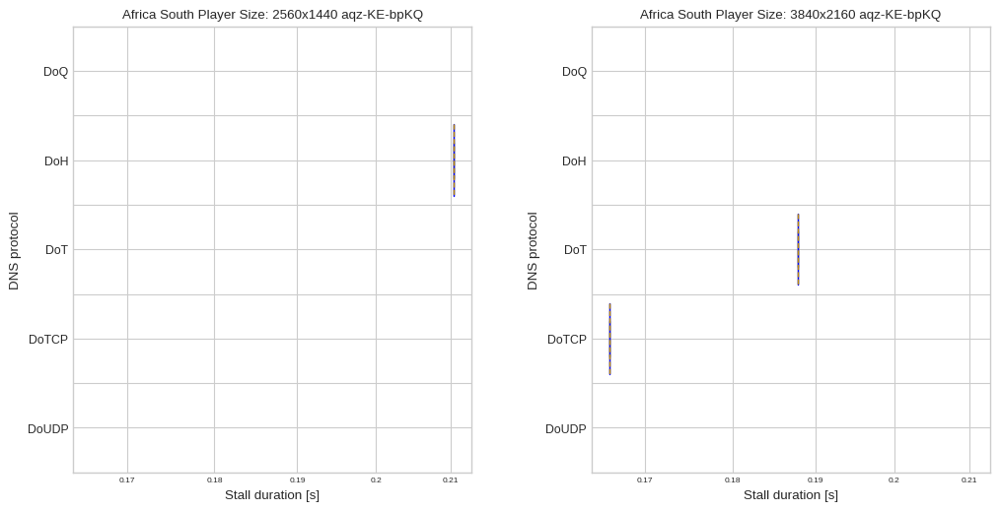

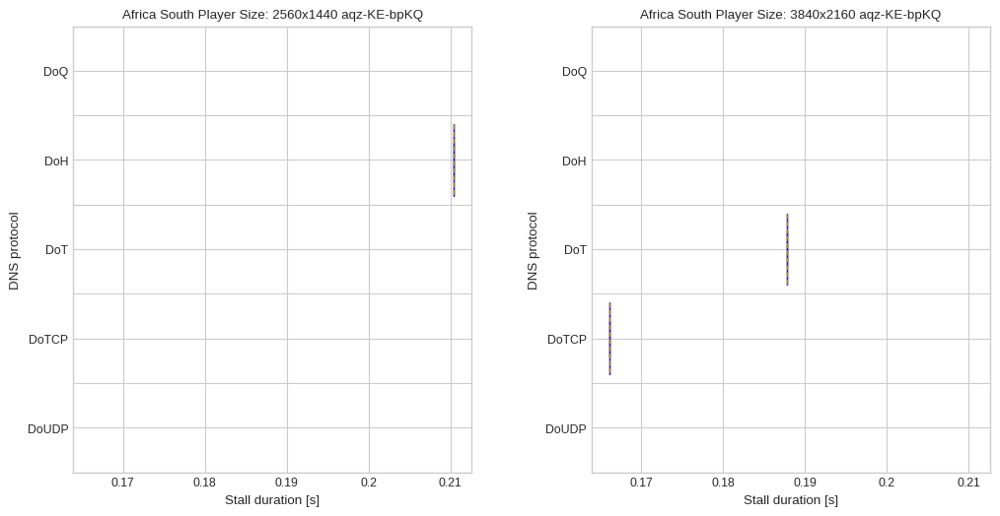

Asia Pacific Northeast


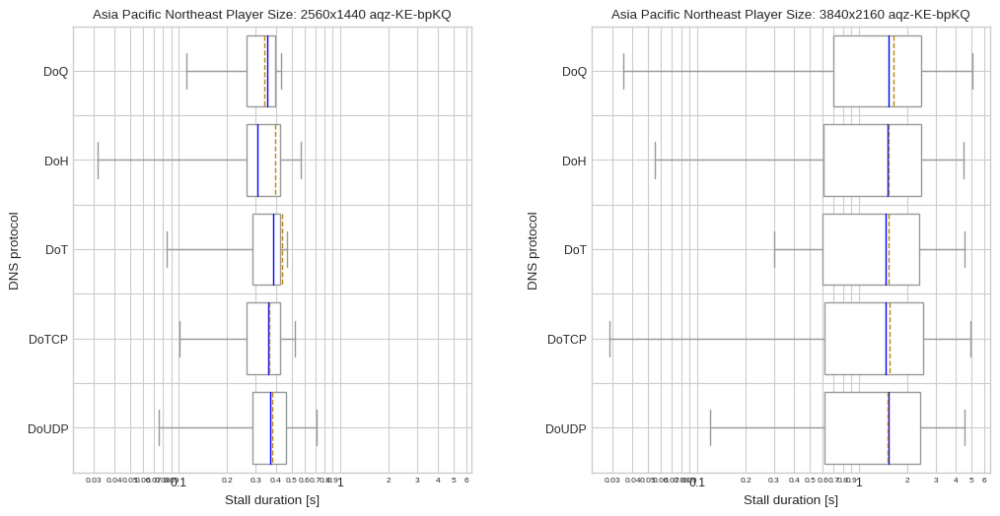

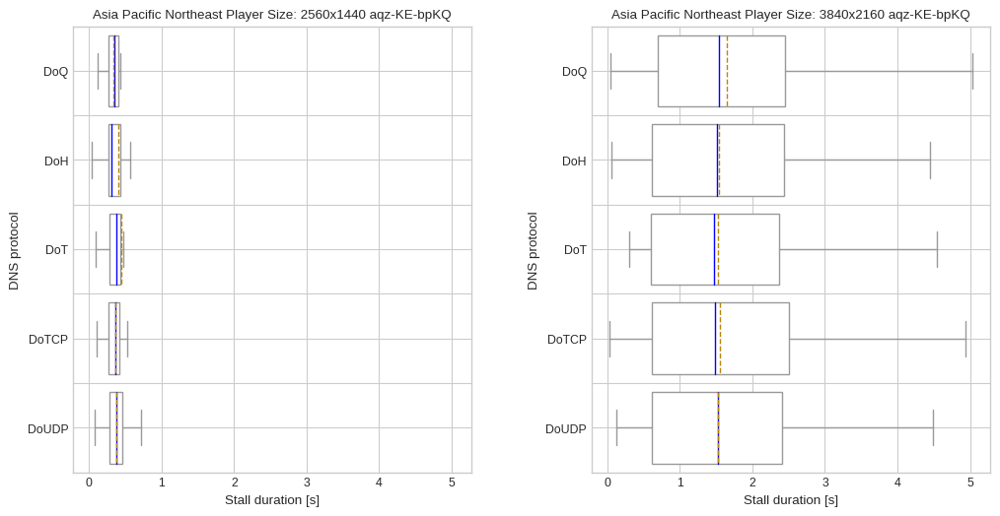

Asia Pacific Southeast


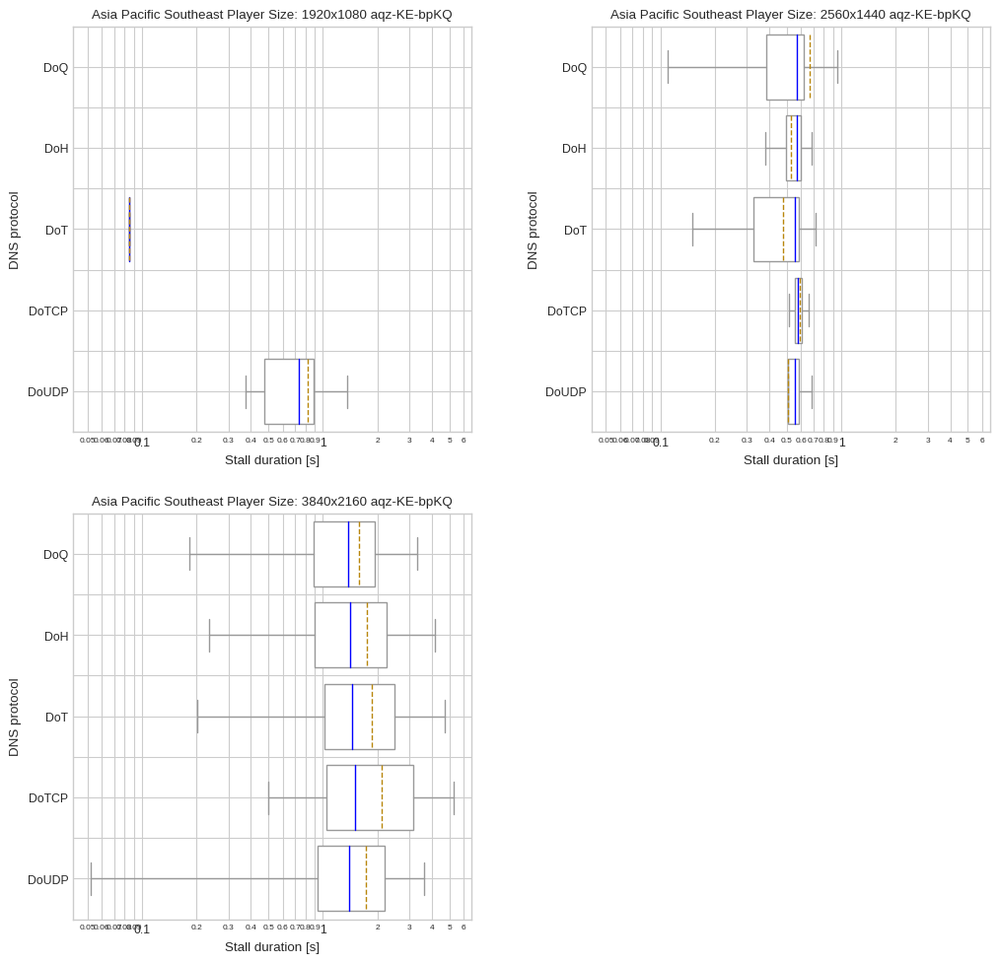

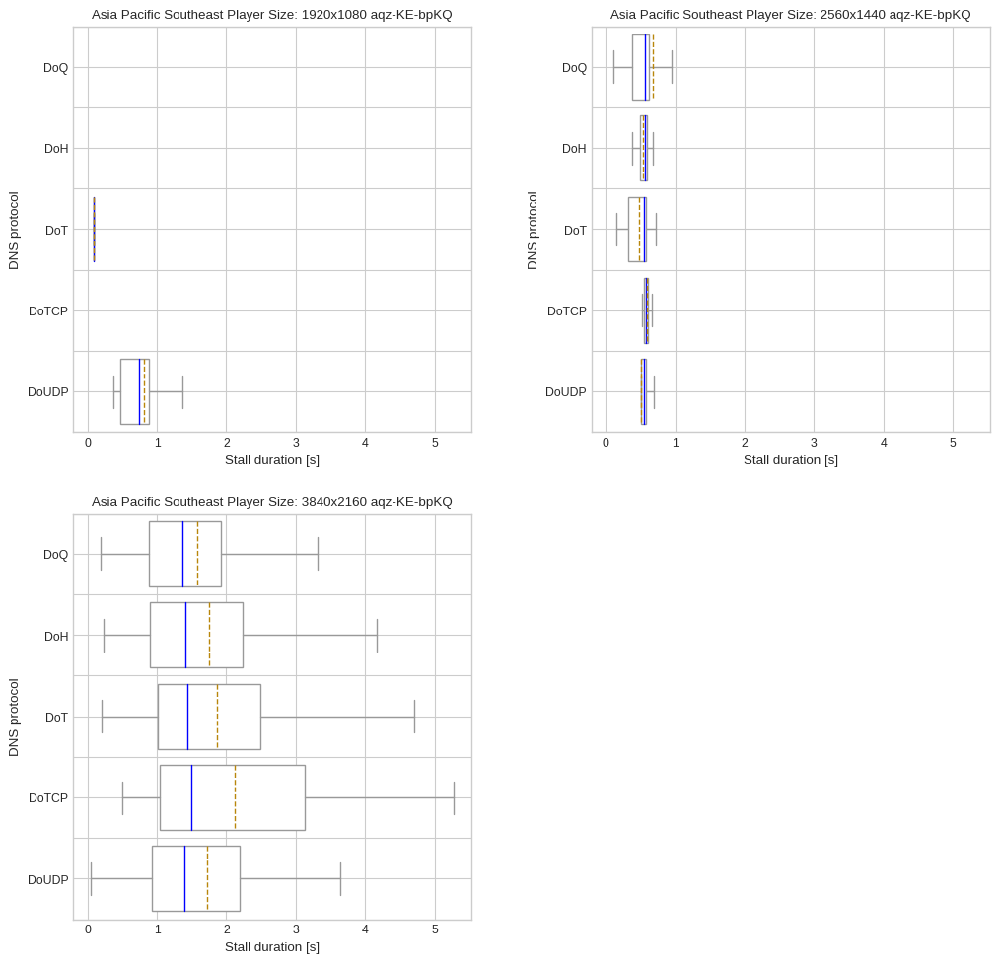

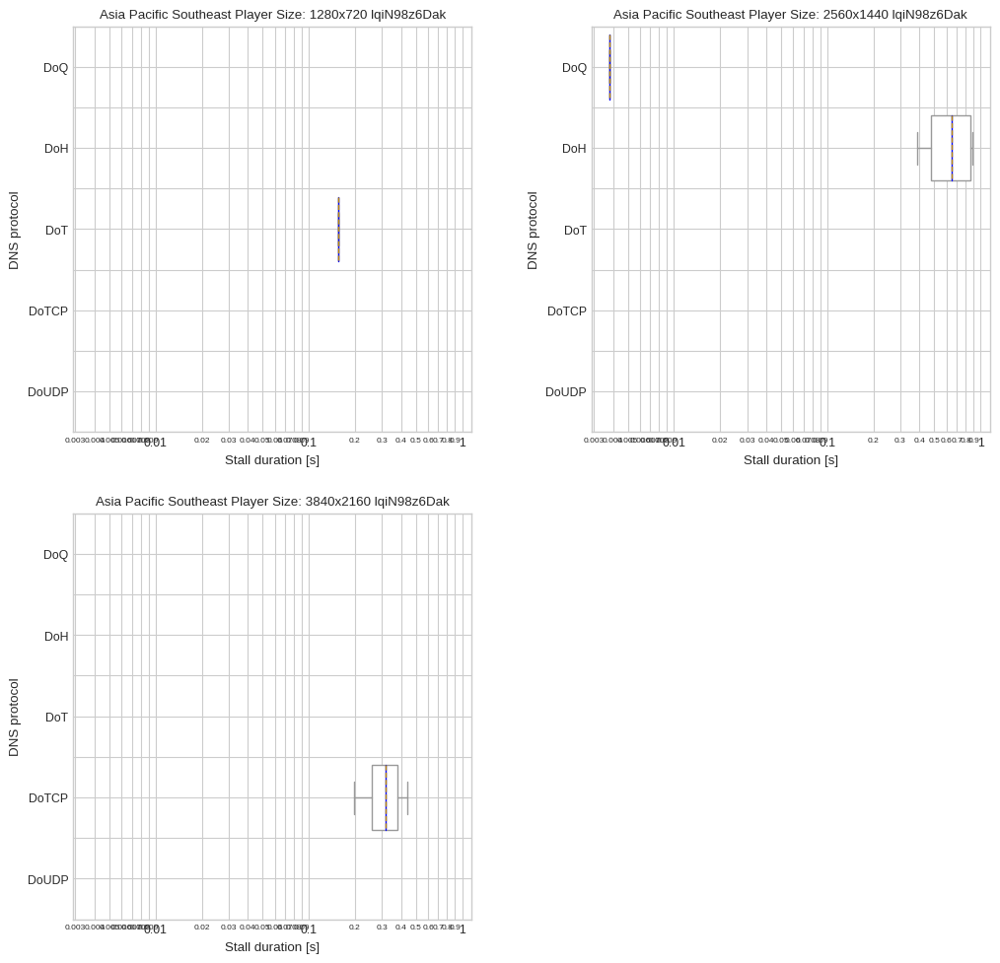

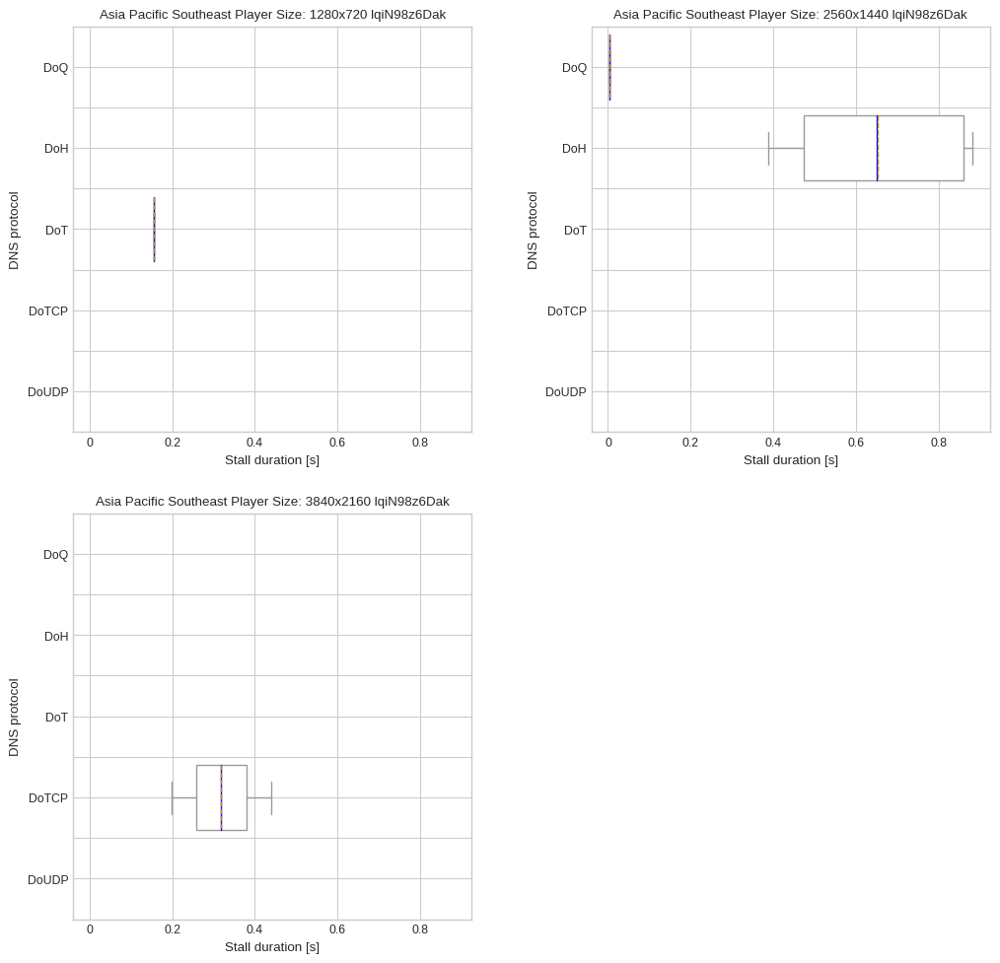

Europe Central


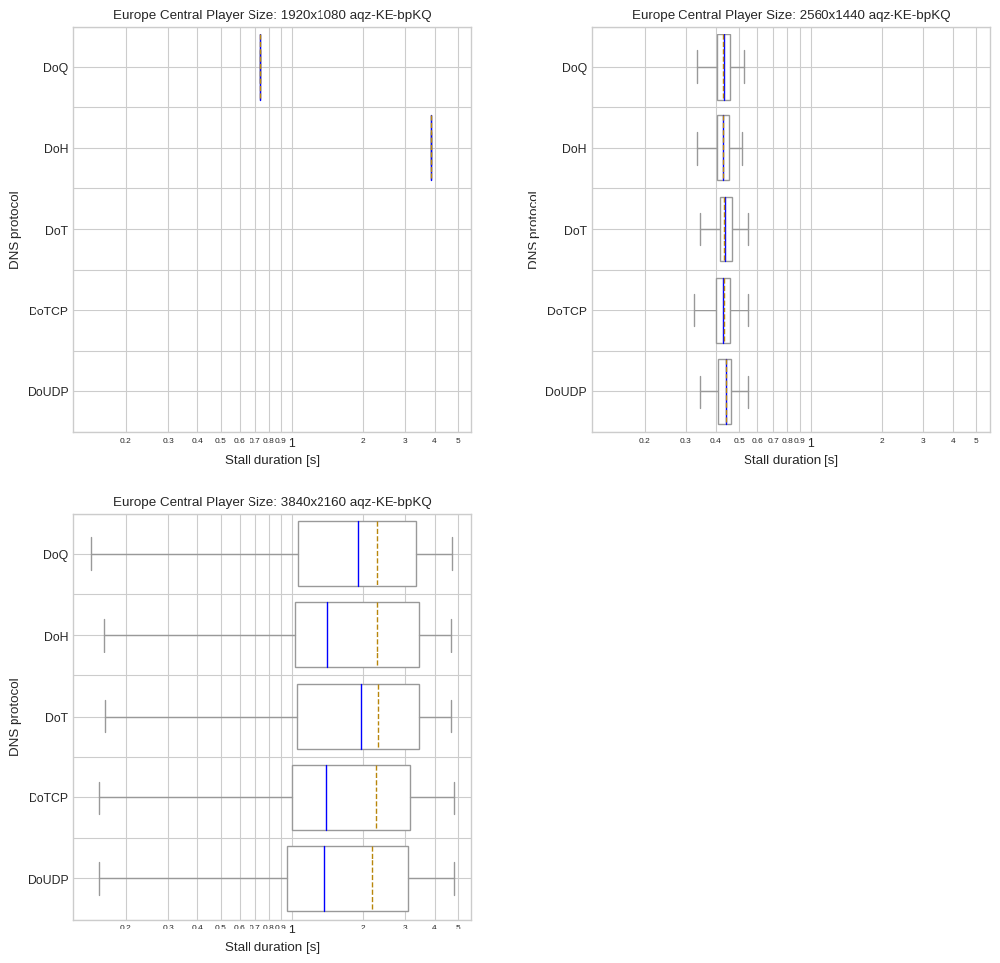

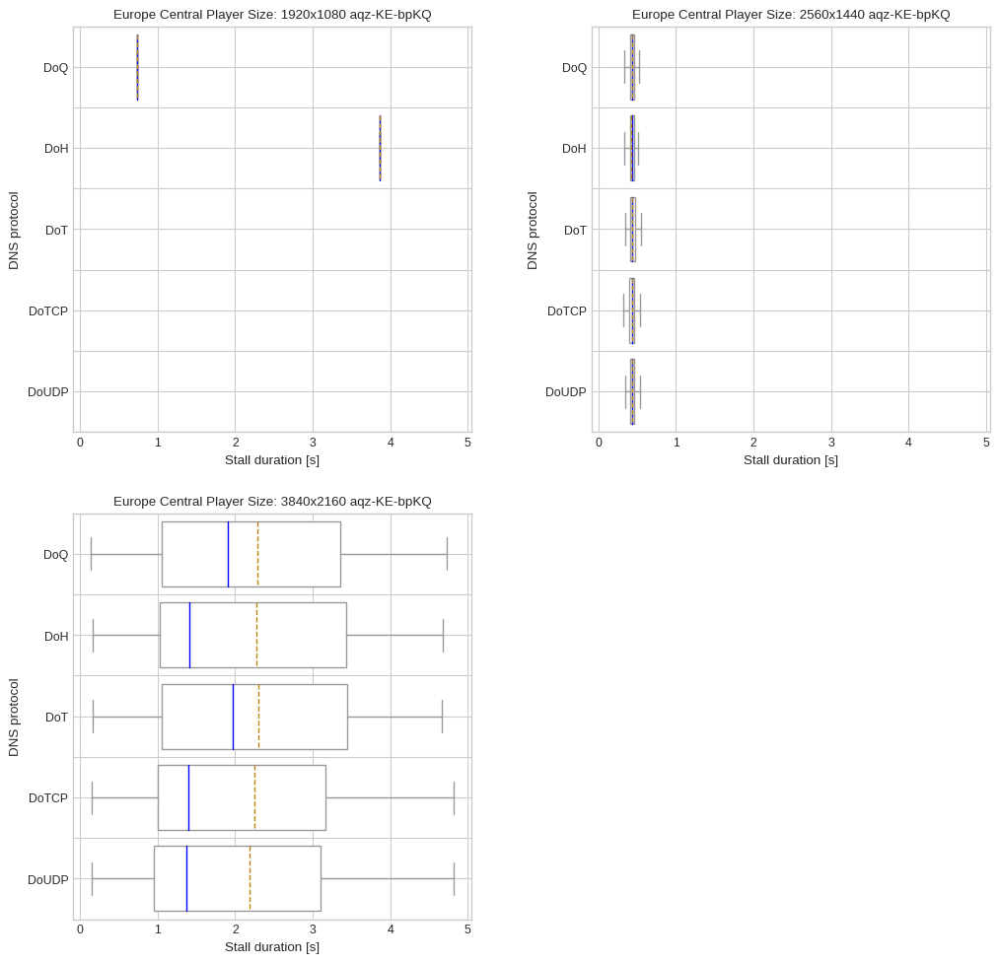

South America East


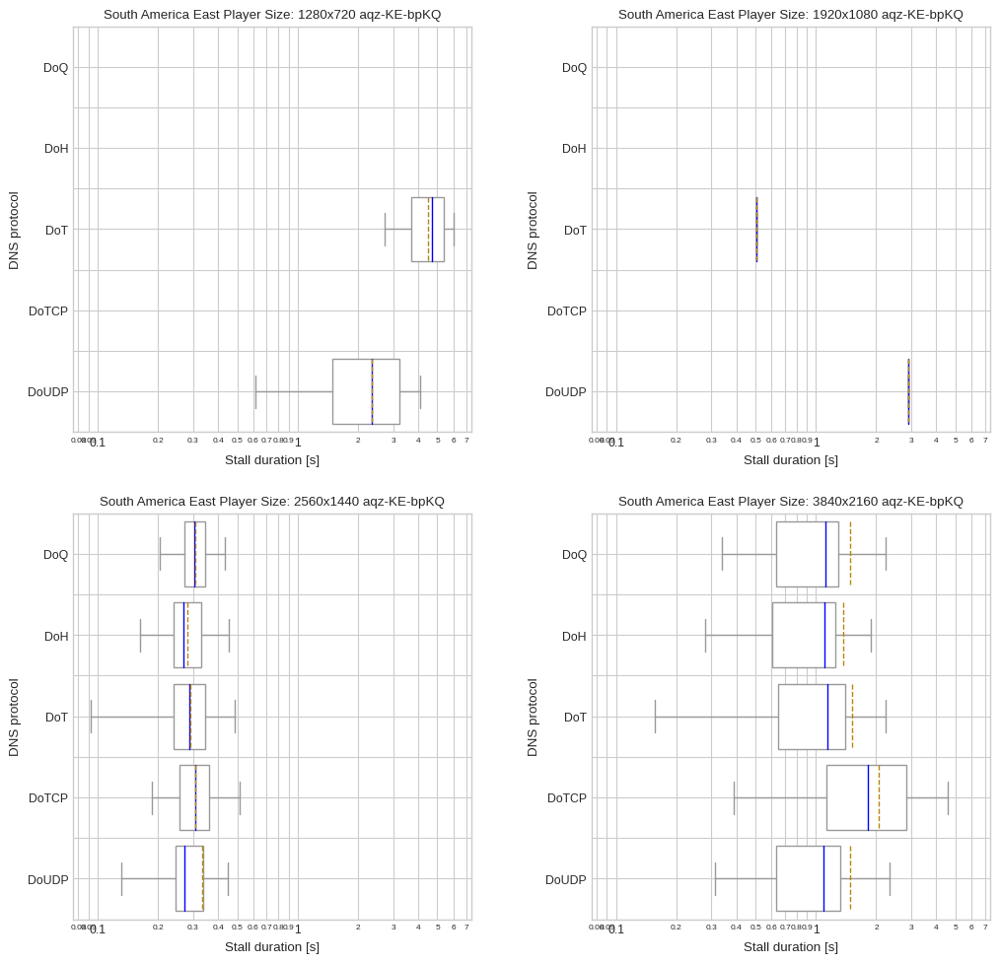

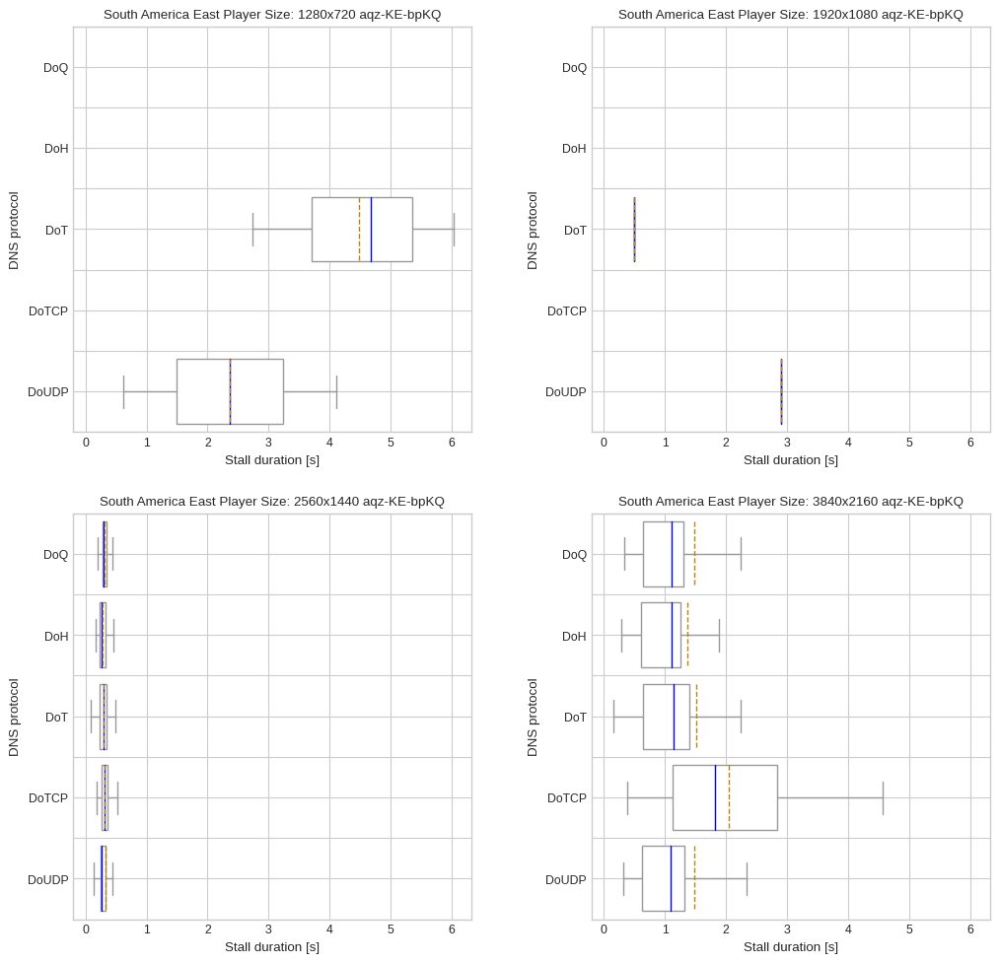

US East


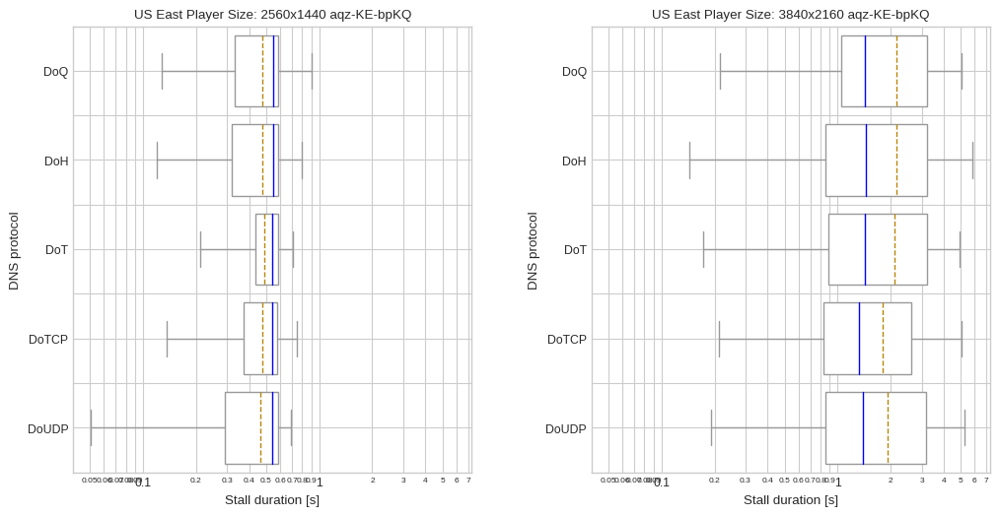

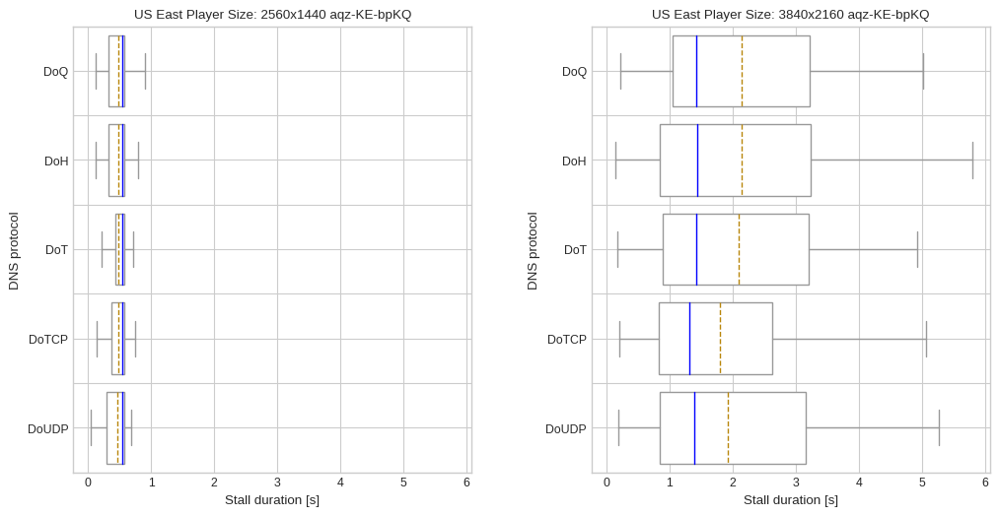

US West


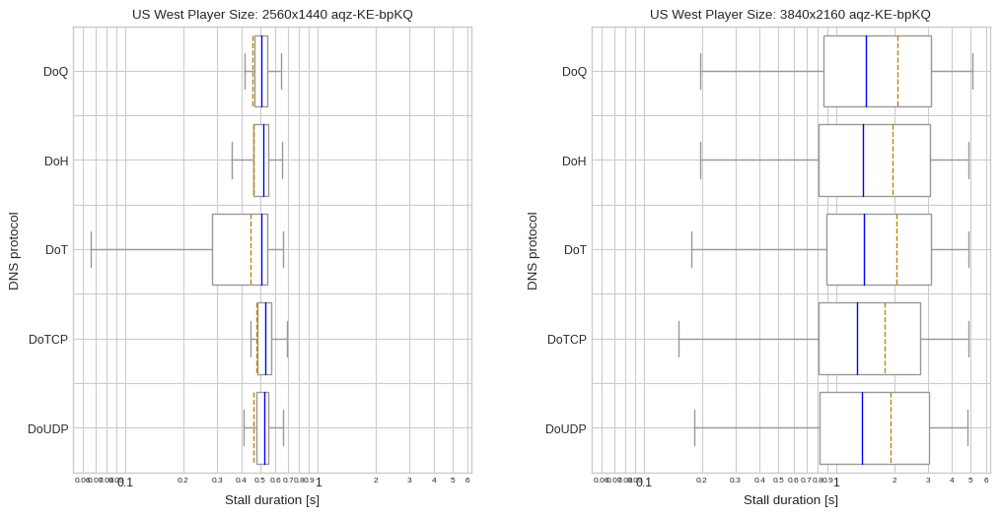

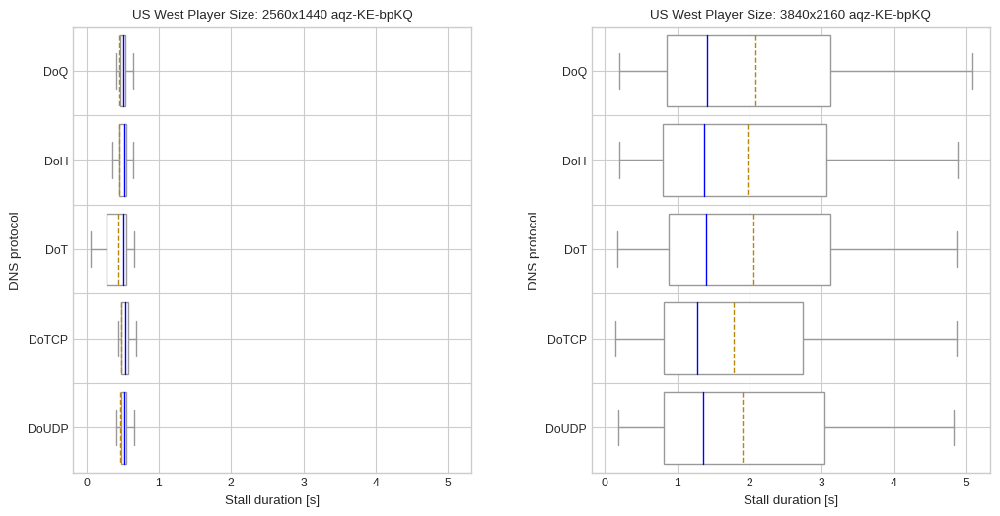

all vantage points


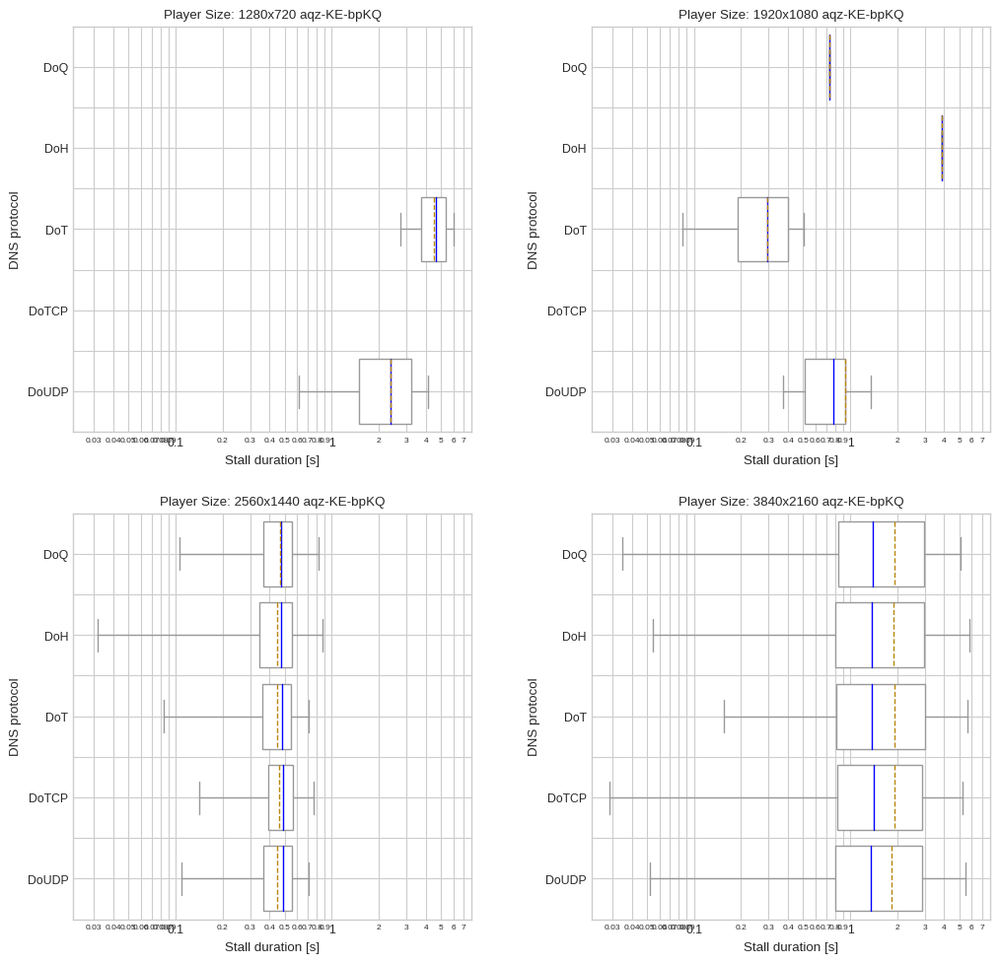

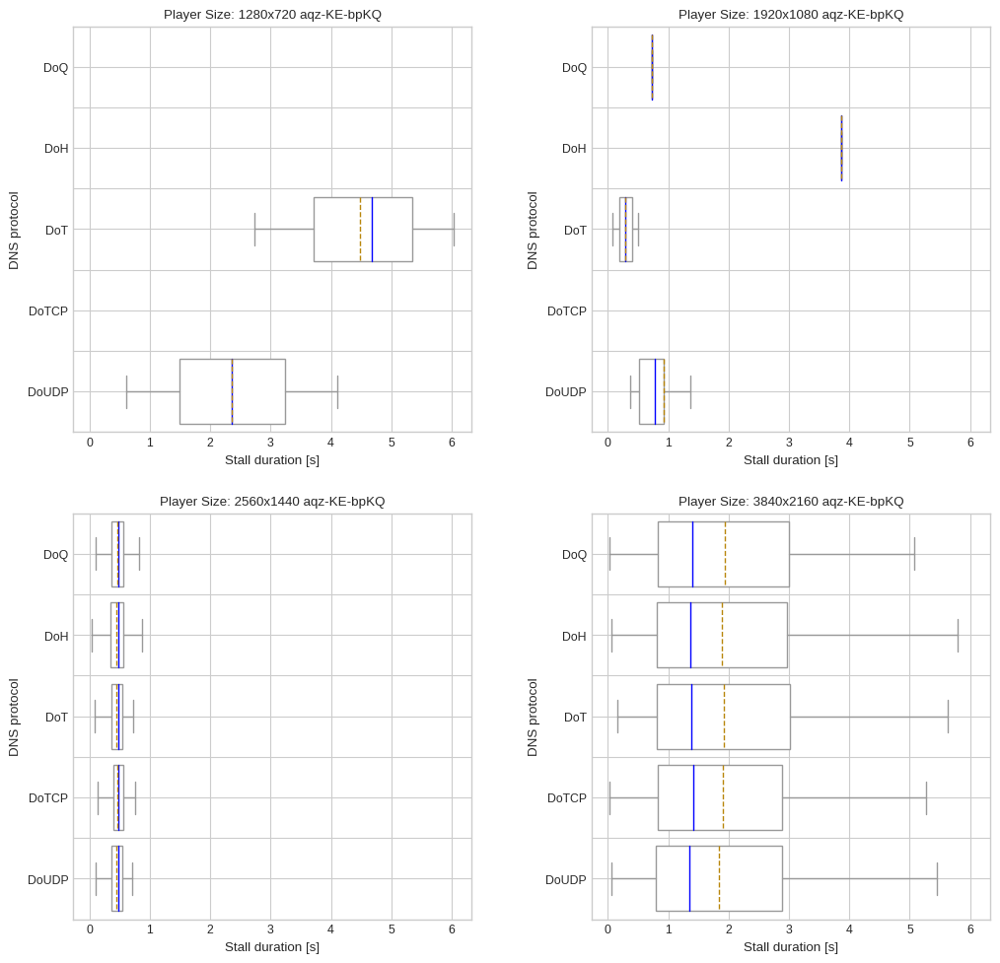

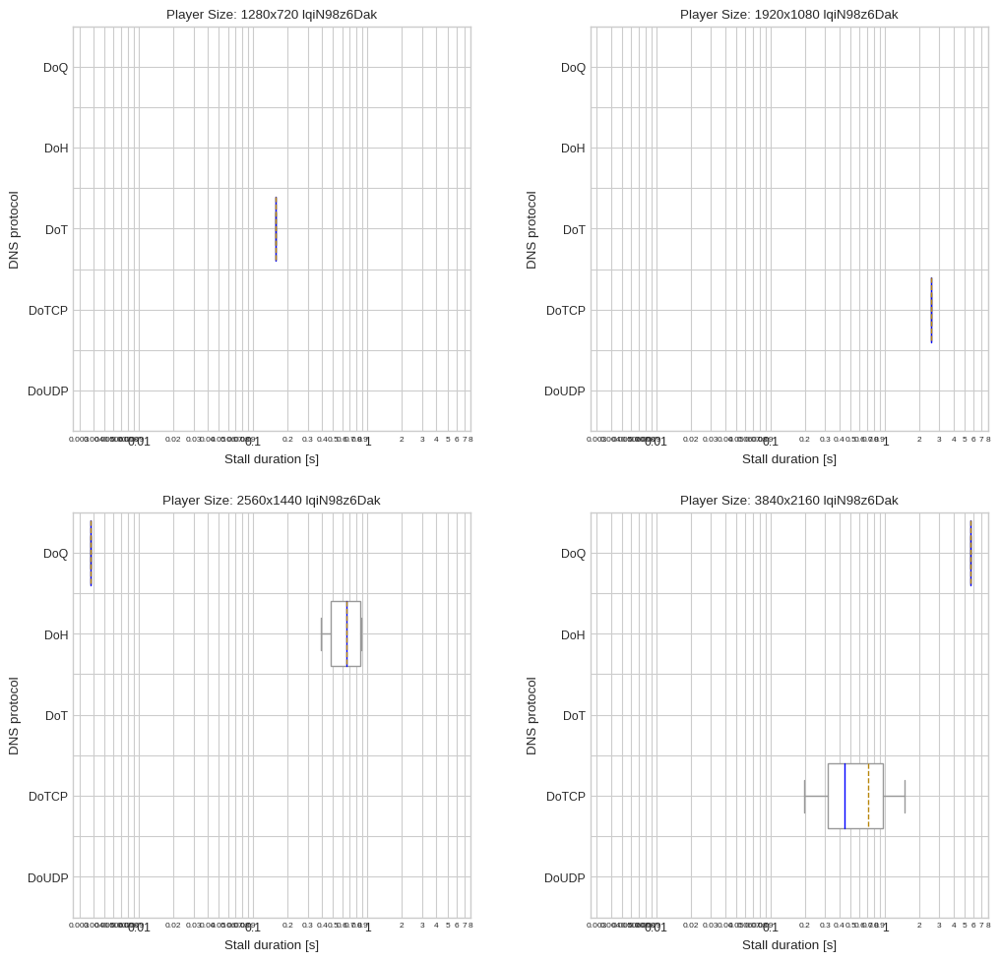

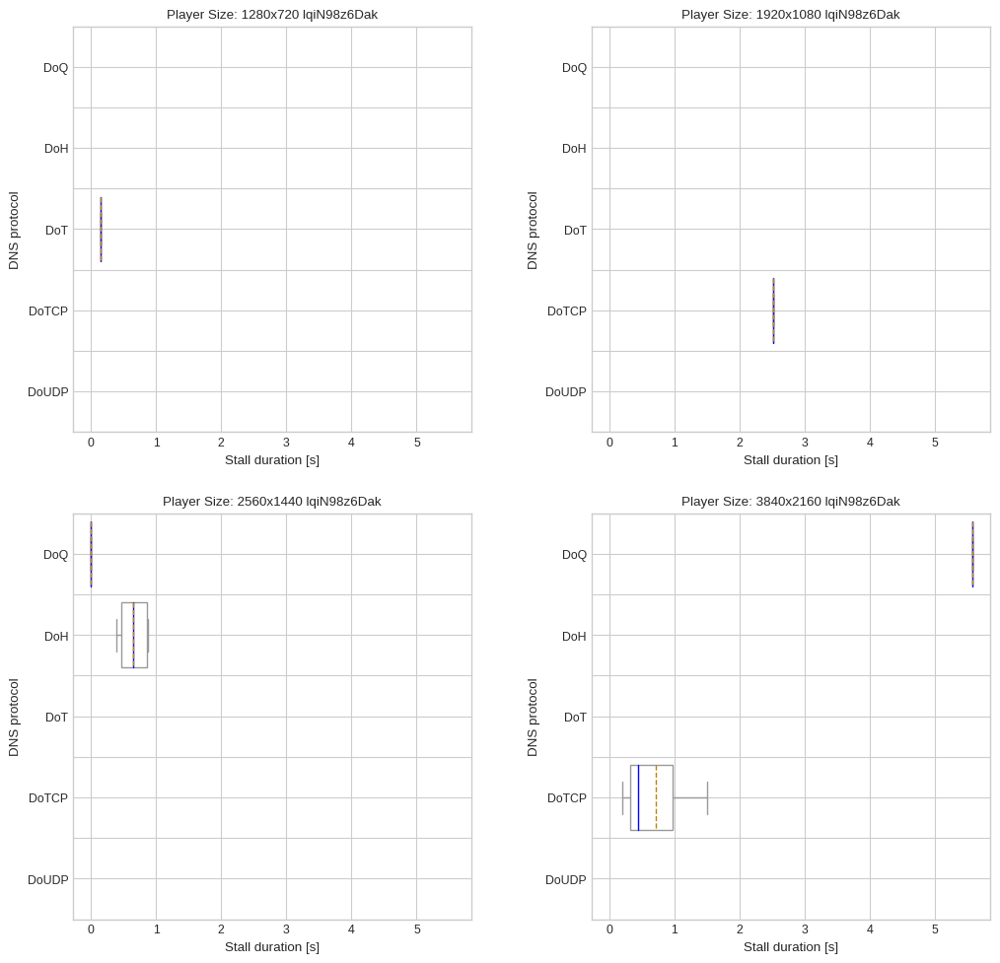

In [545]:
draw_boxplot_grid(df_stall_times, 'player_dimensions', 'protocol', 'stall_time', [True,False], 'Stall duration [s]', 'Player Size:', 'stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", draw_all=True)

In [ ]:
draw_boxplot(df_stall_times, 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration [s]', 'Player Size:', 'stall-durations-by-player-size-and-proto', [0,0], "DNS protocol")

Africa South


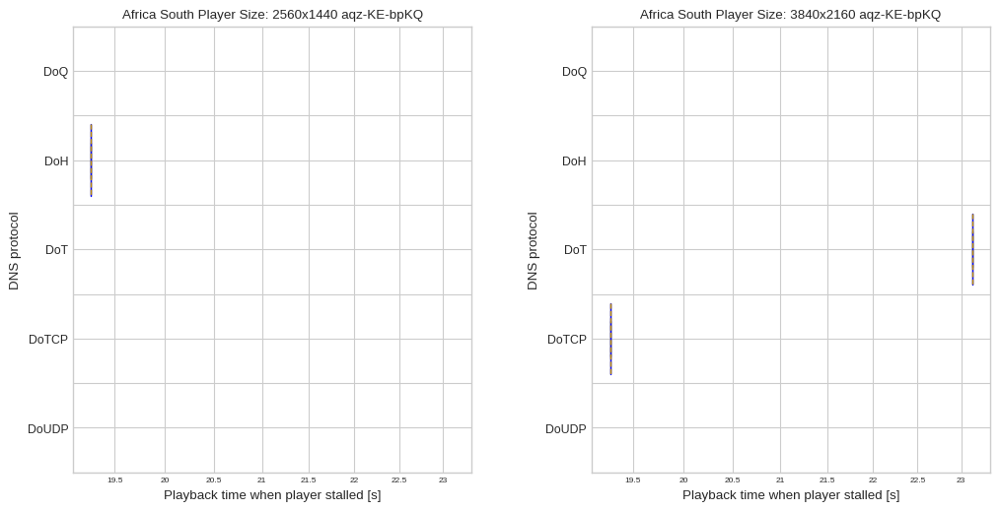

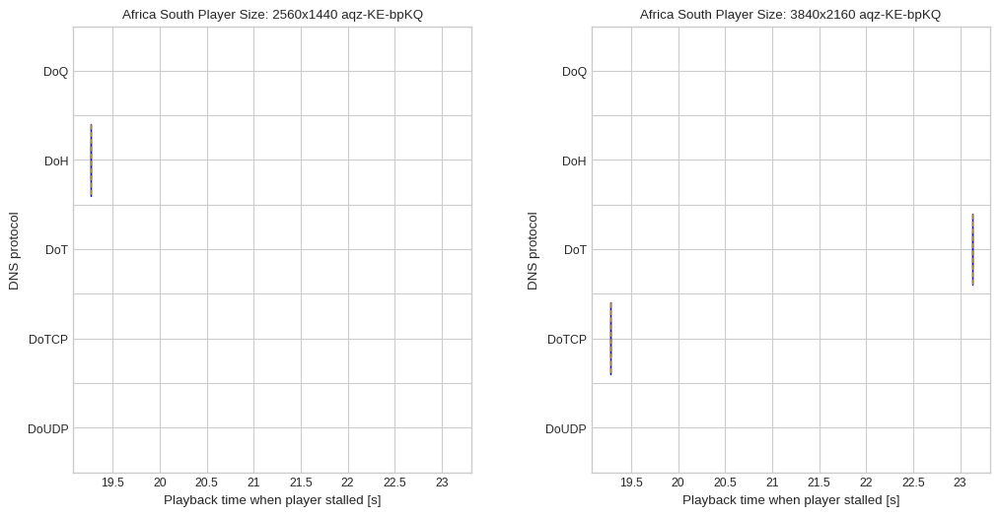

Asia Pacific Northeast


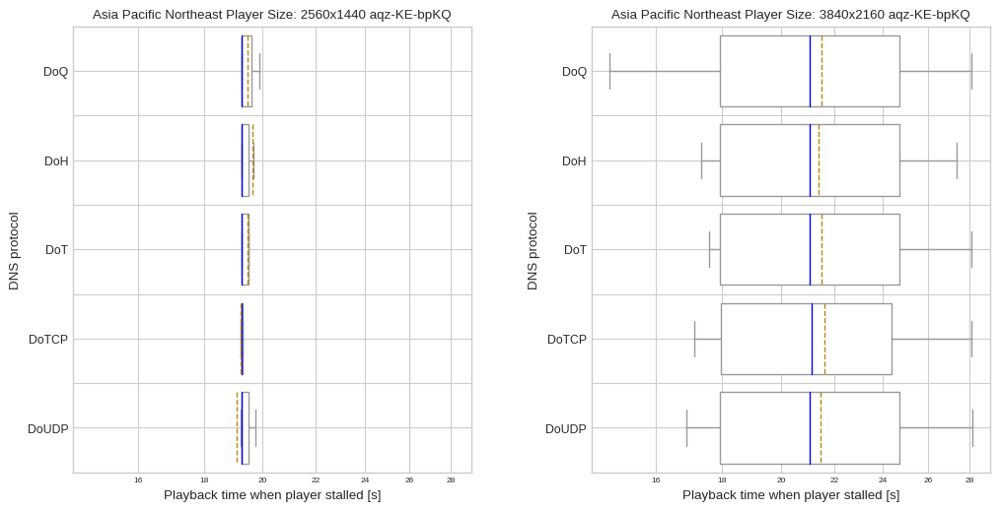

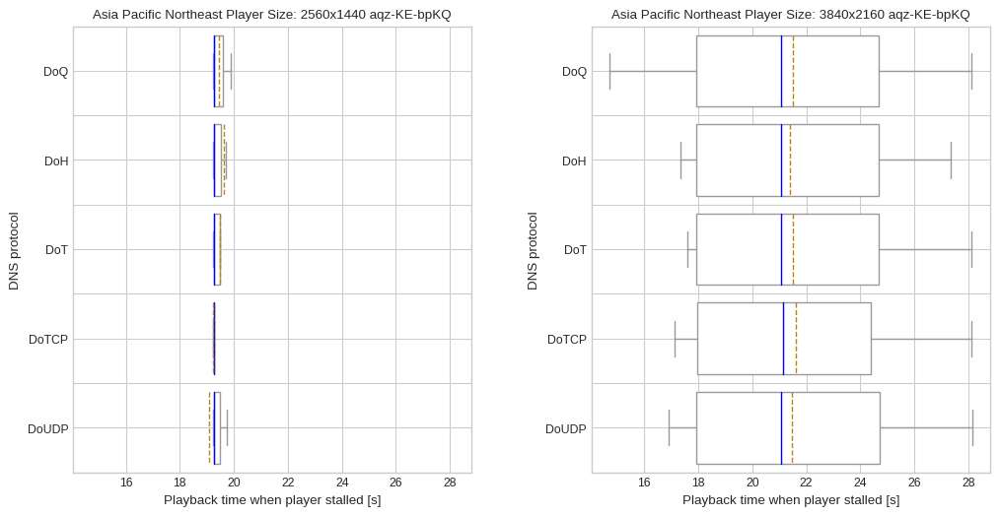

Asia Pacific Southeast


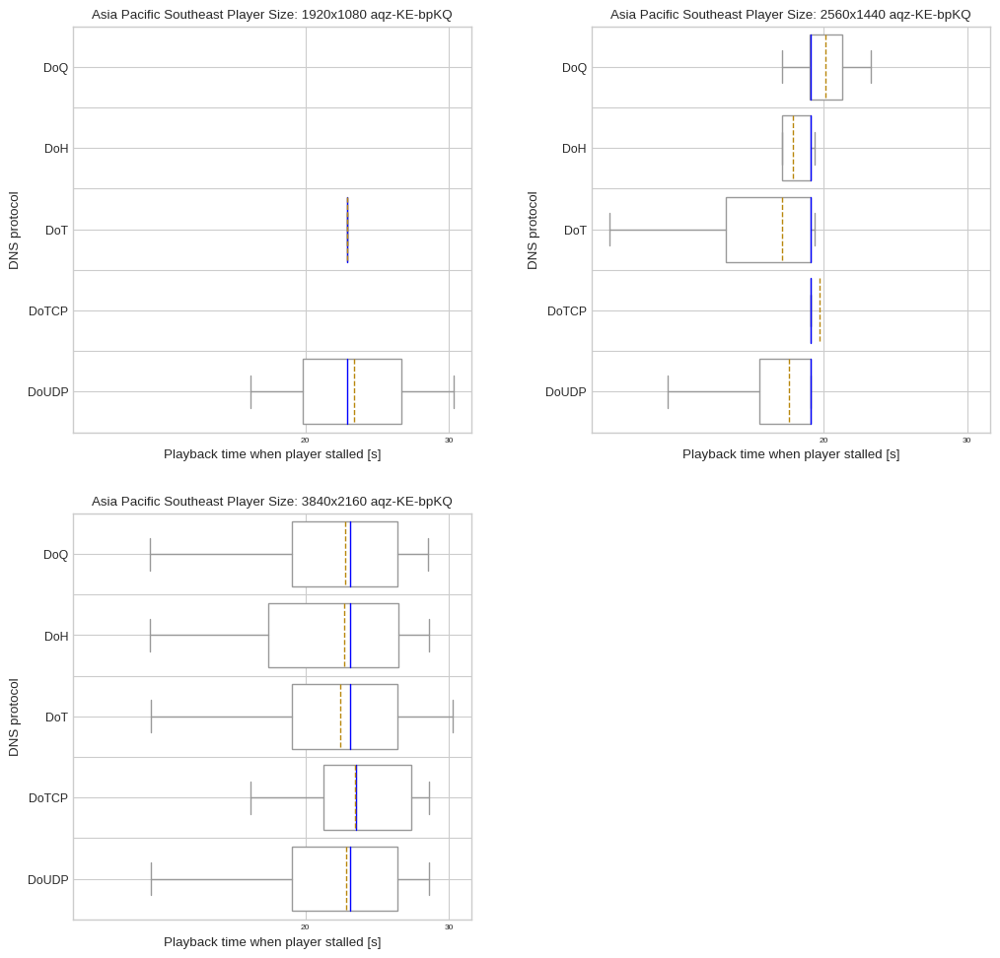

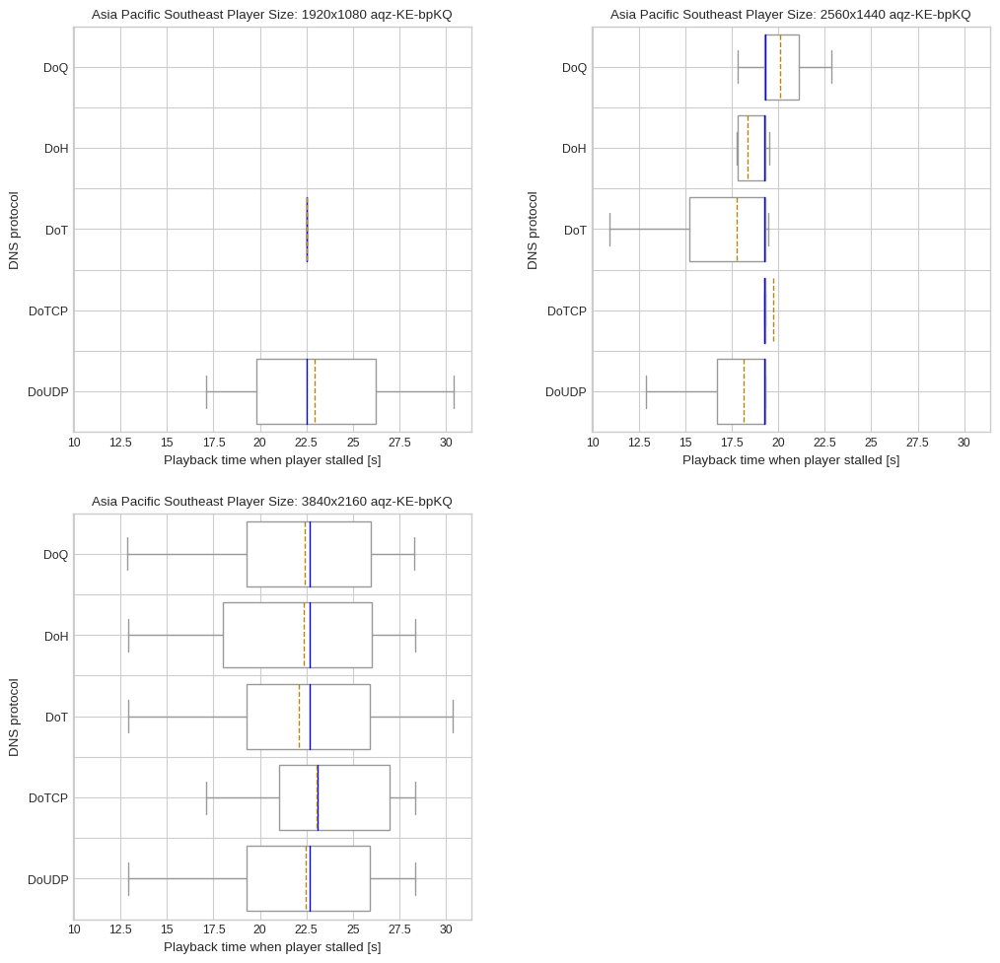

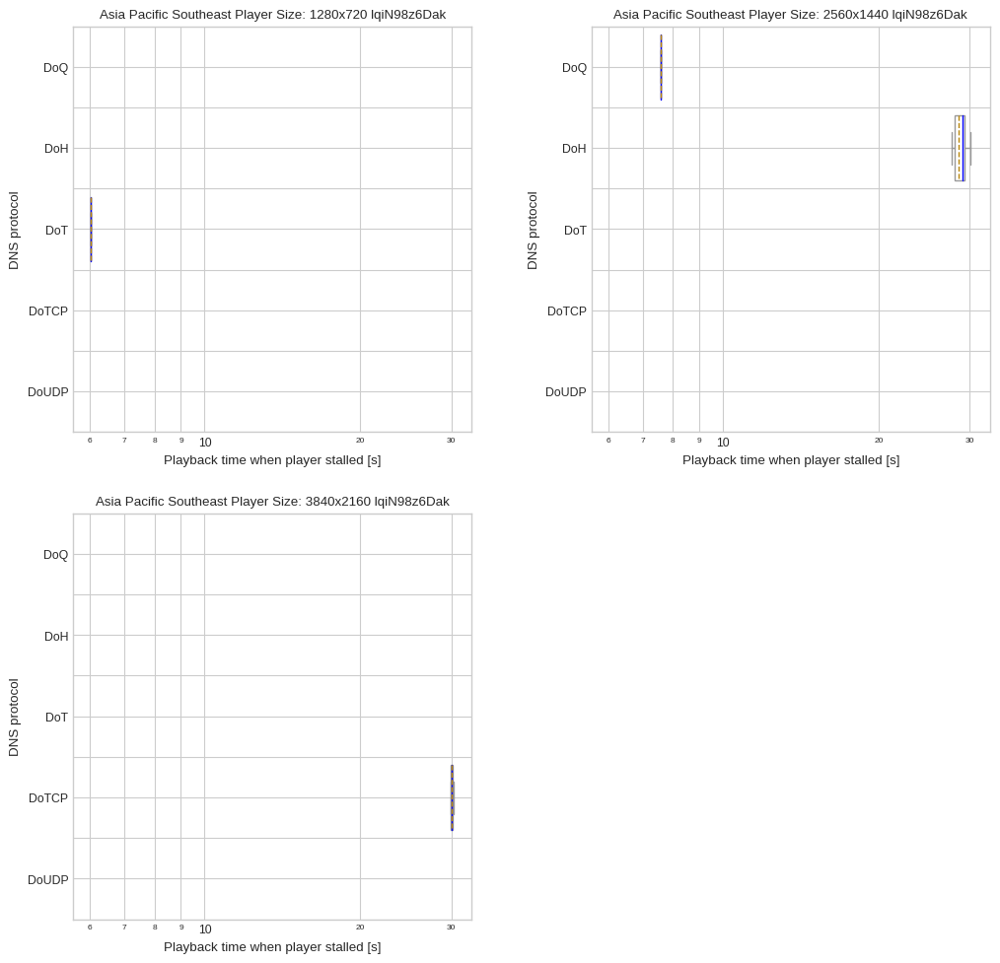

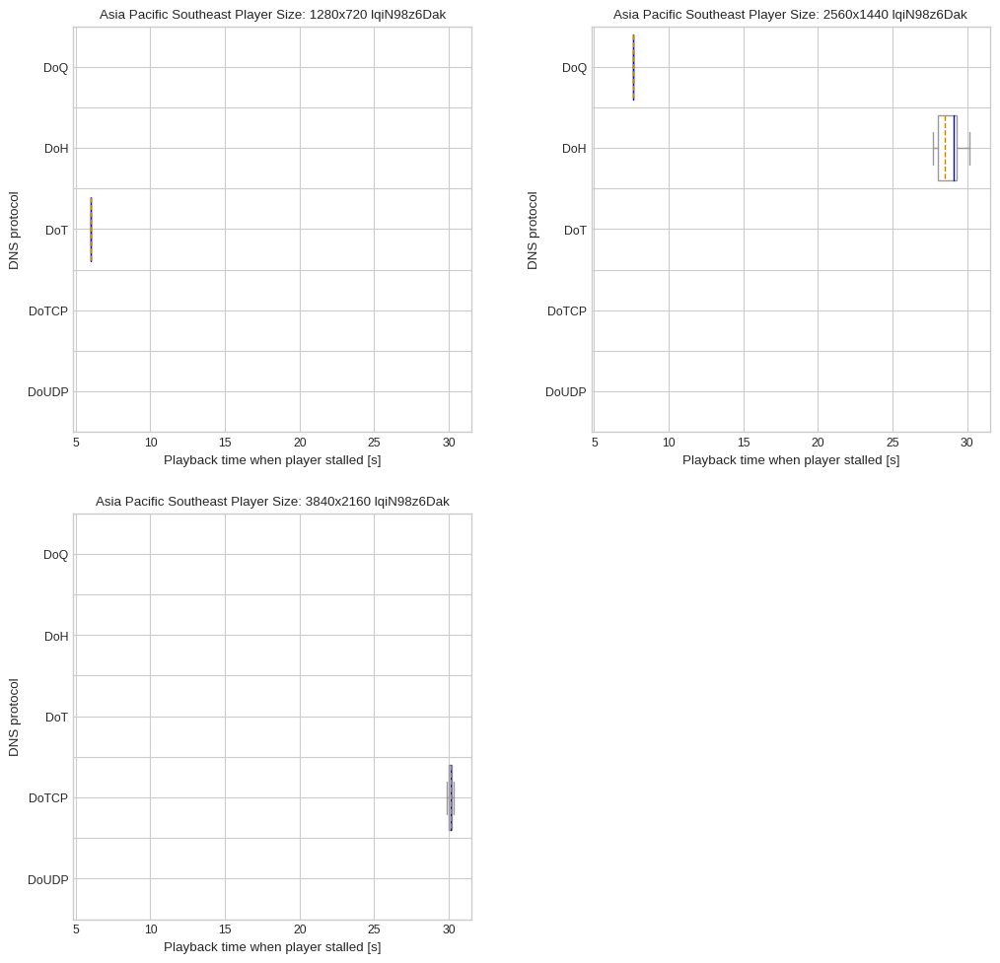

Europe Central


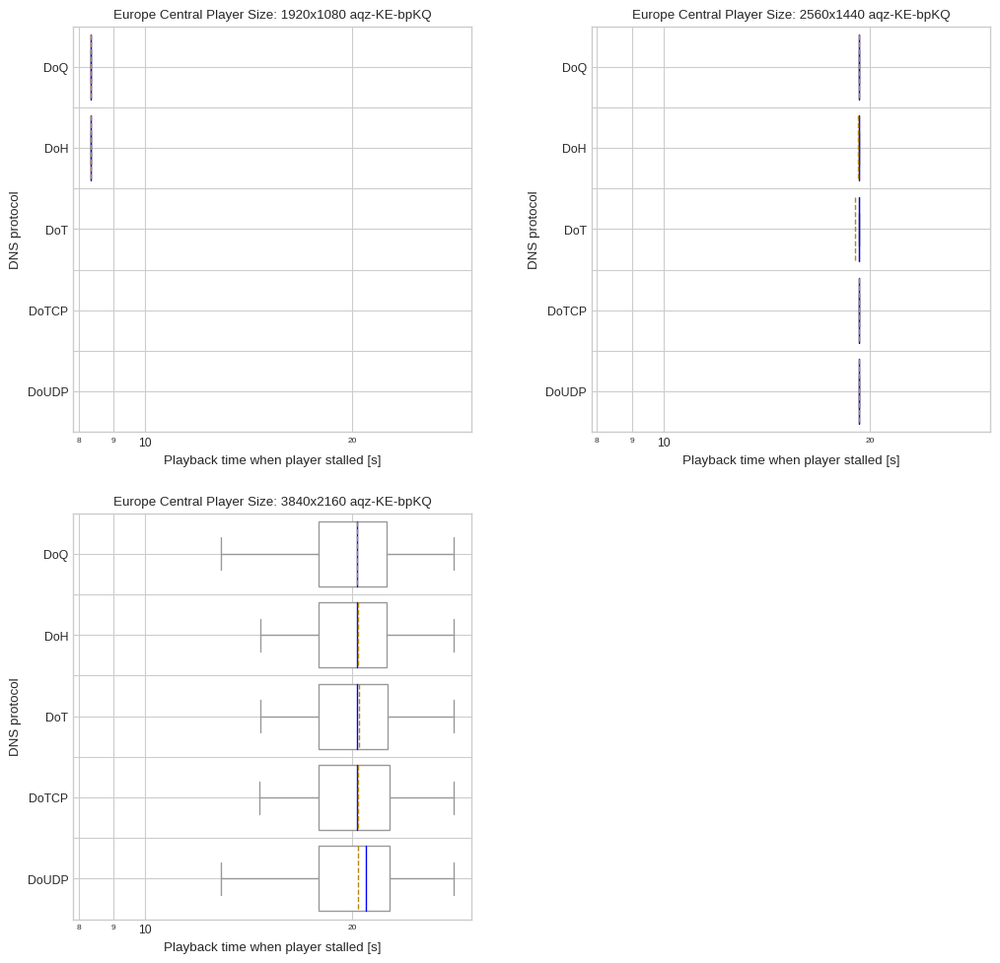

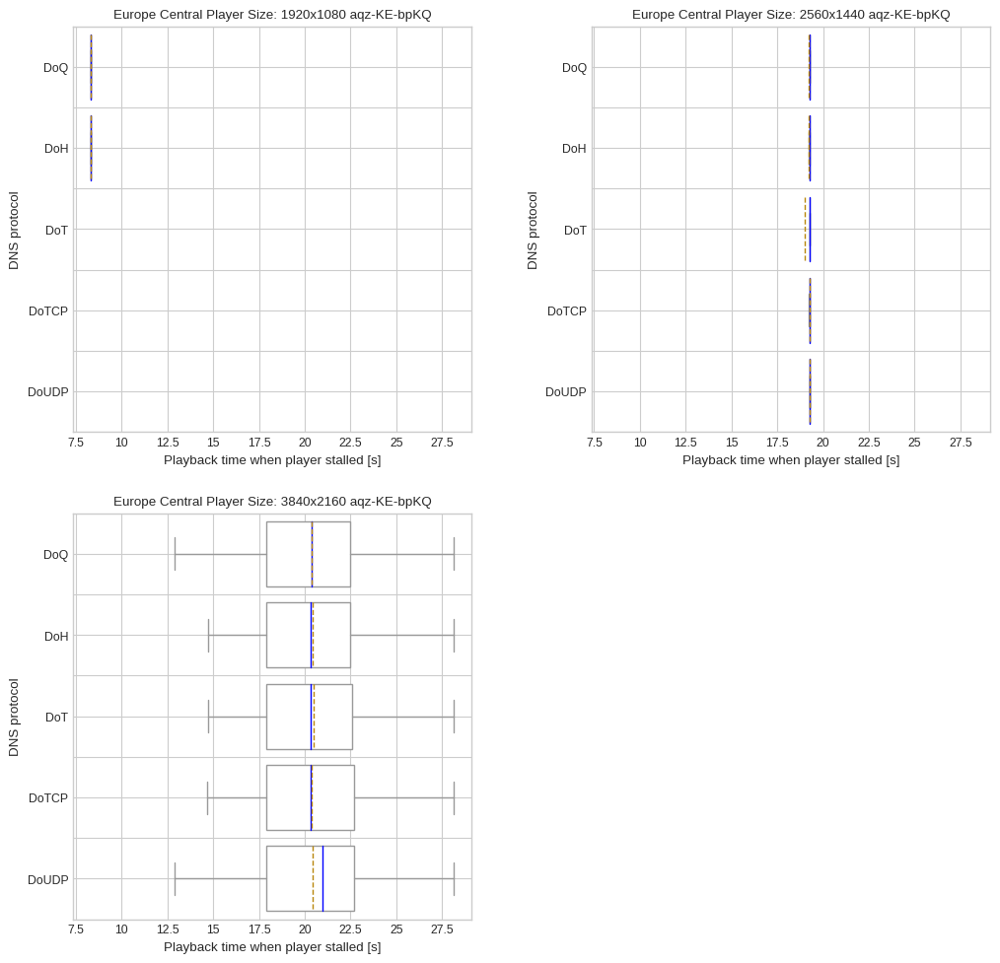

South America East


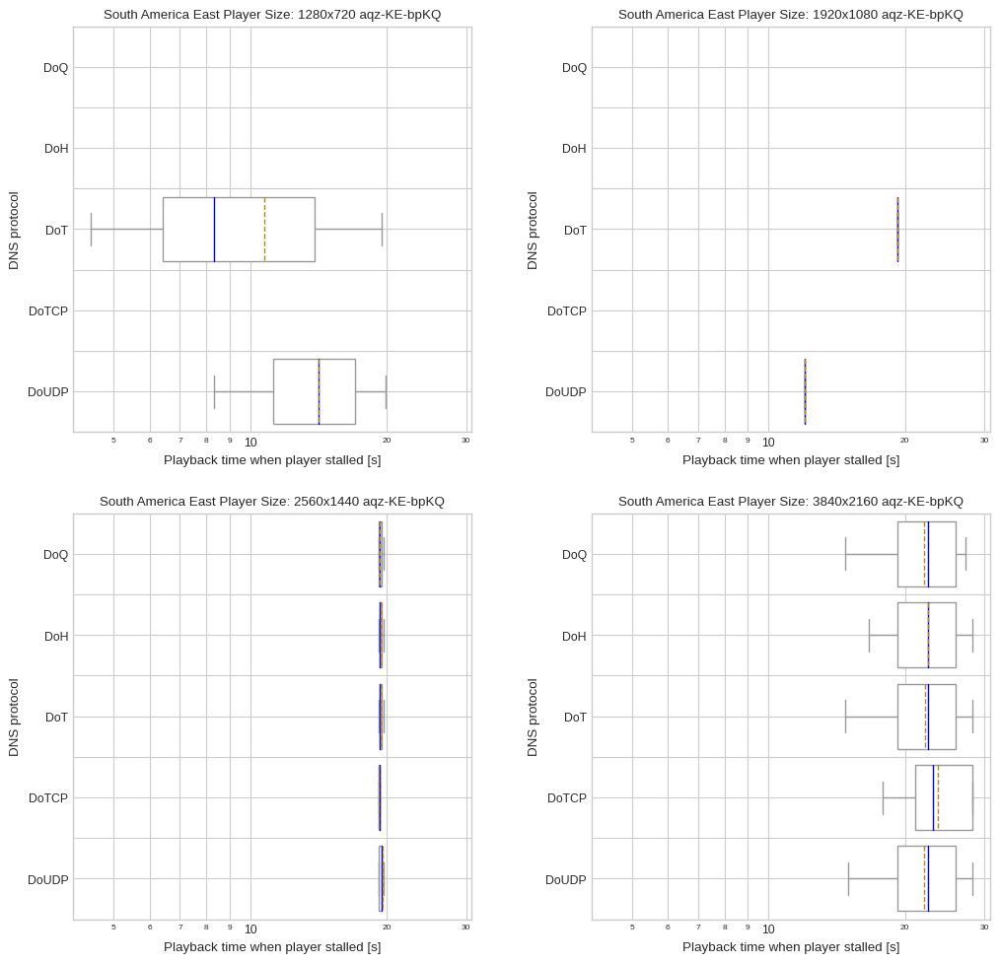

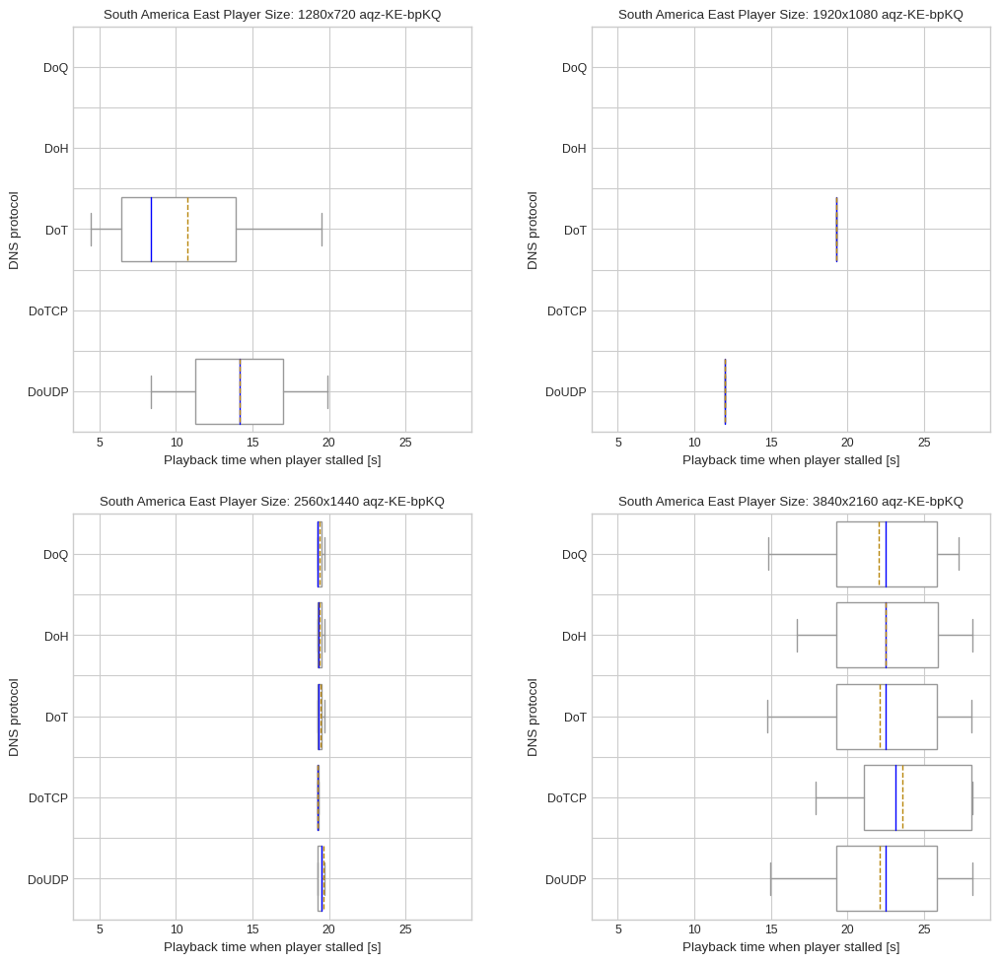

US East


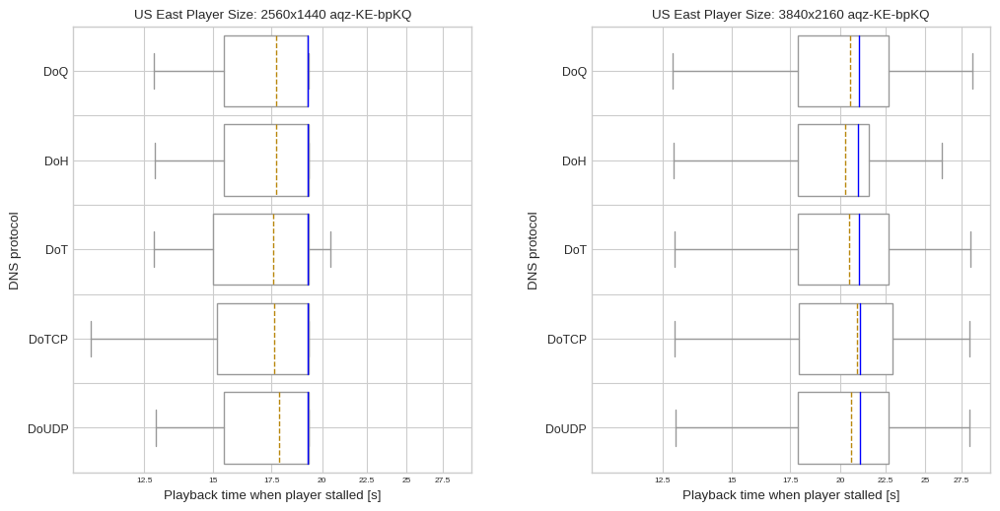

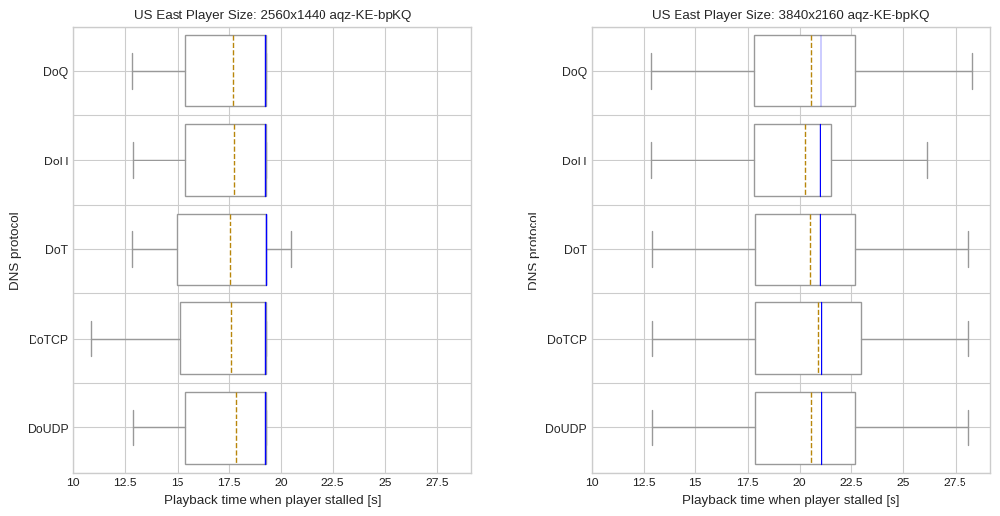

US West


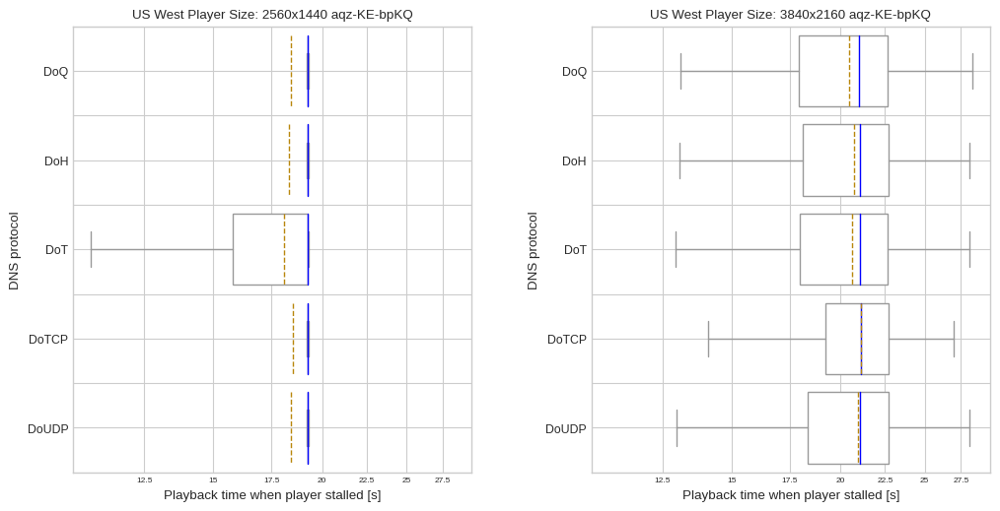

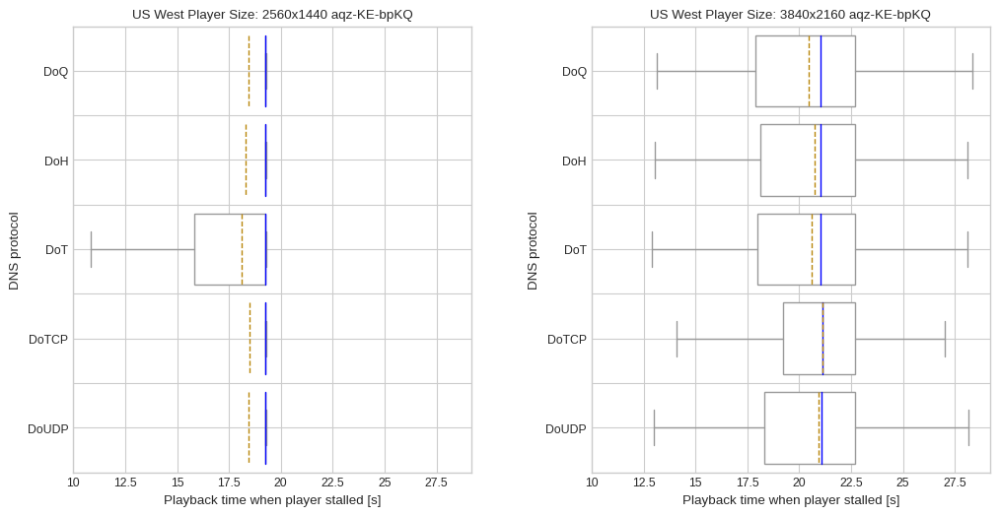

all vantage points


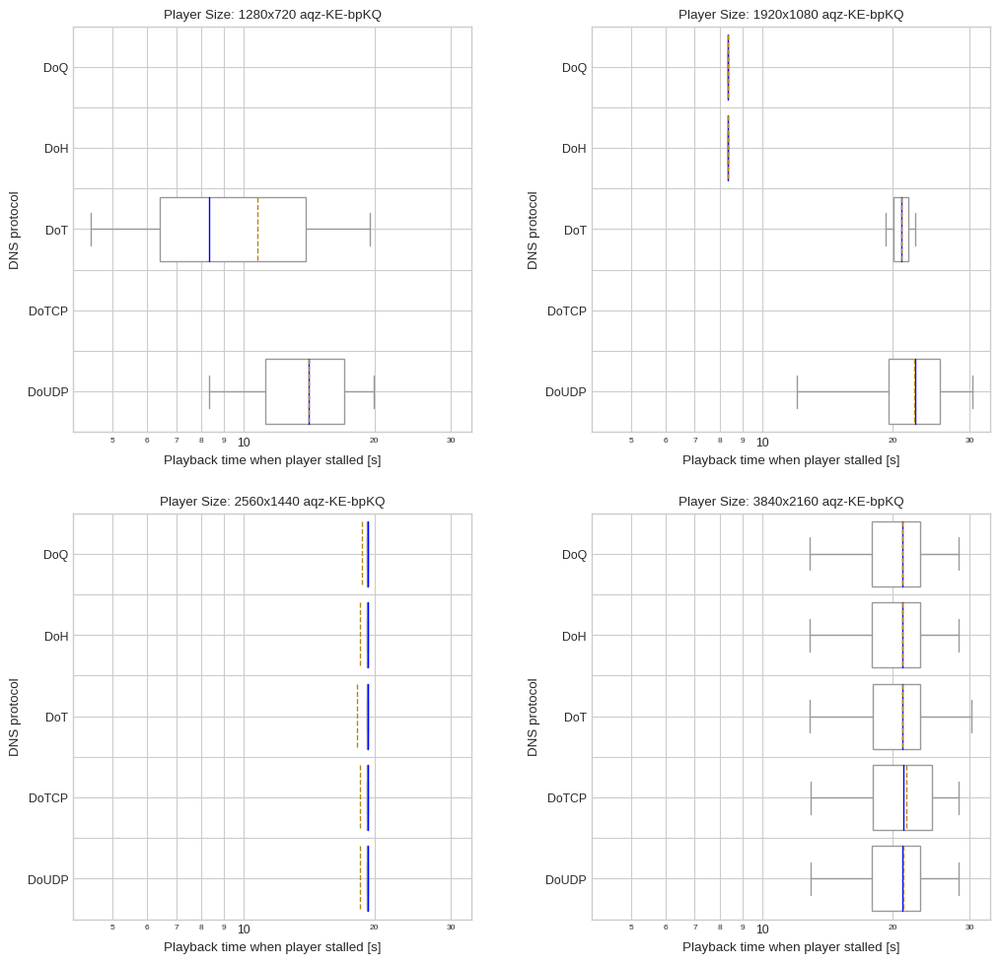

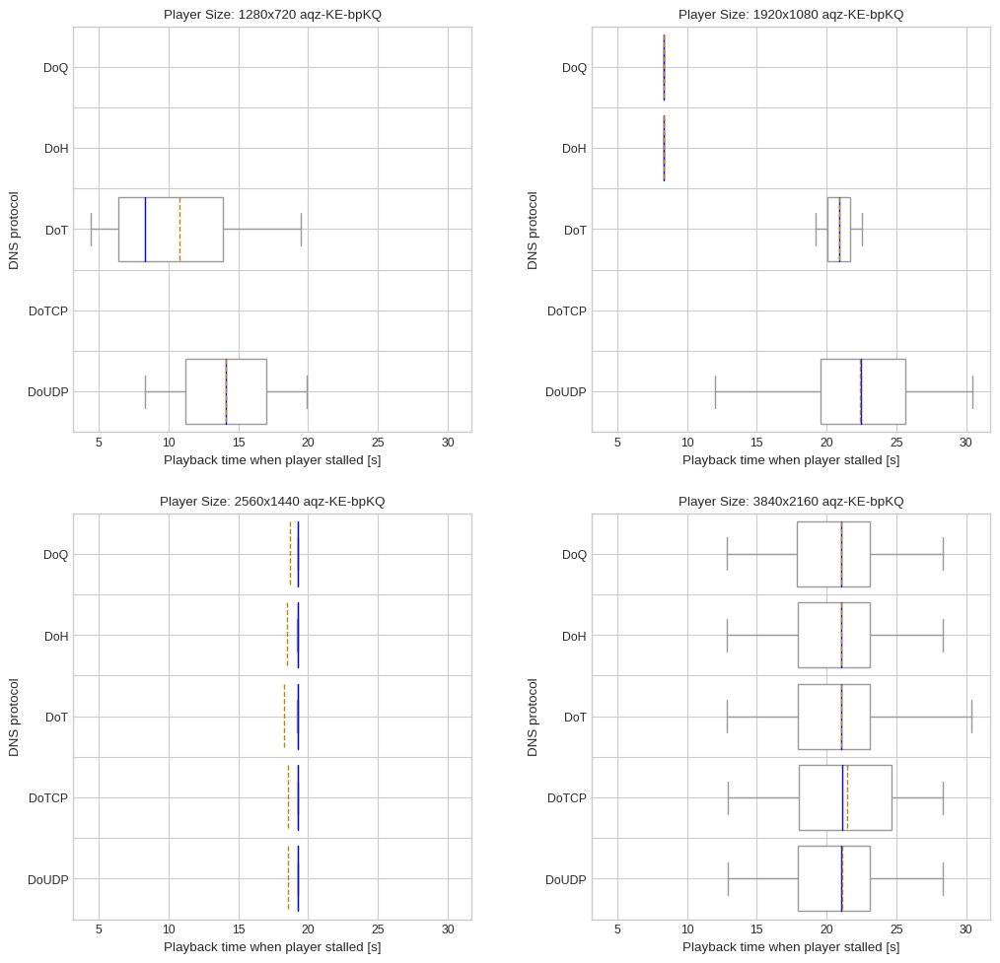

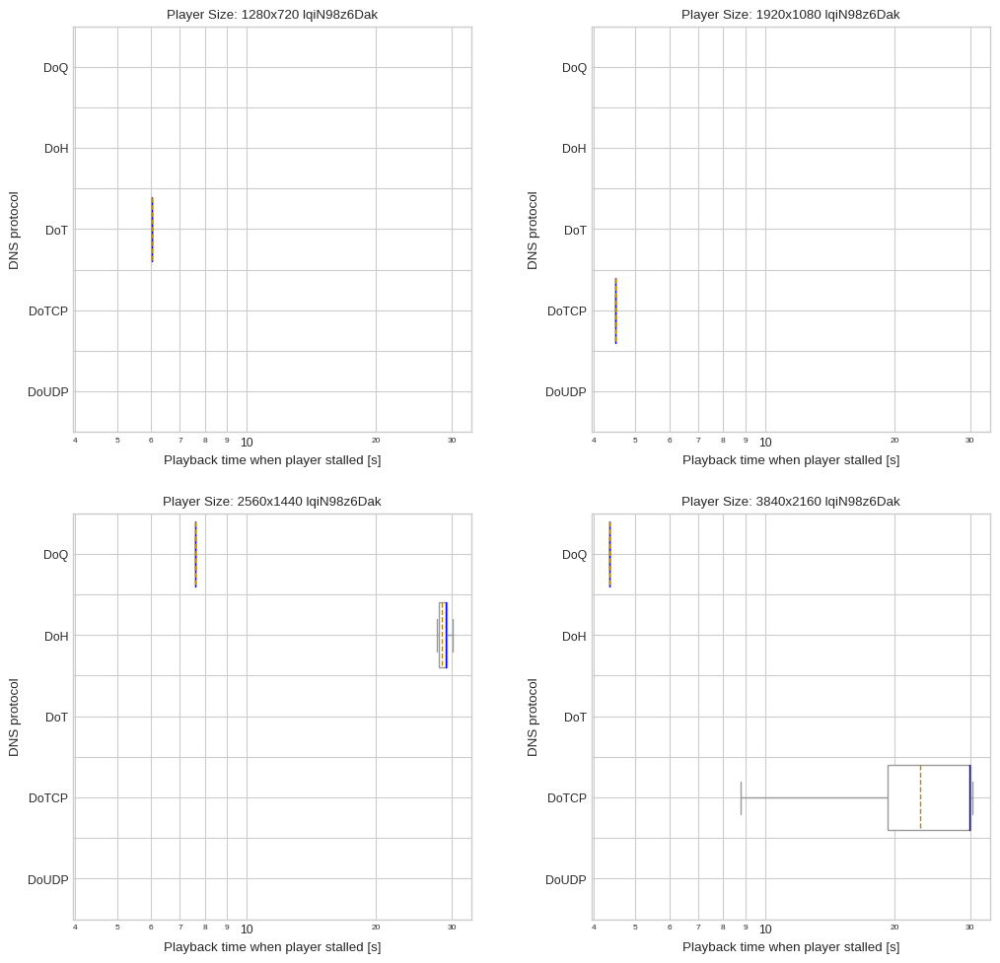

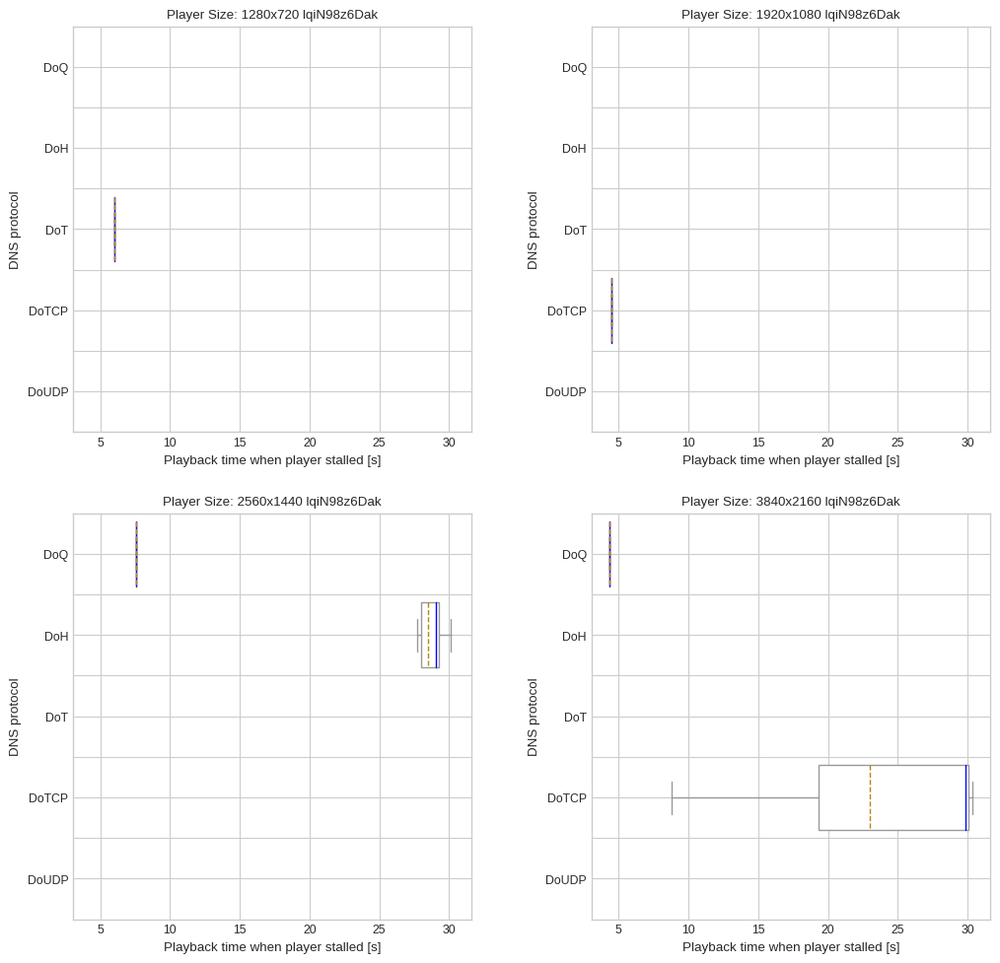

In [546]:
draw_boxplot_grid(df_stall_times, 'player_dimensions', 'protocol', 'curr_play_time', [True, False], 'Playback time when player stalled [s]', 'Player Size:', 'buffer-events-with-restart-events-by-player-size-and-proto', [0,0], "DNS protocol", draw_all=True)

Africa South


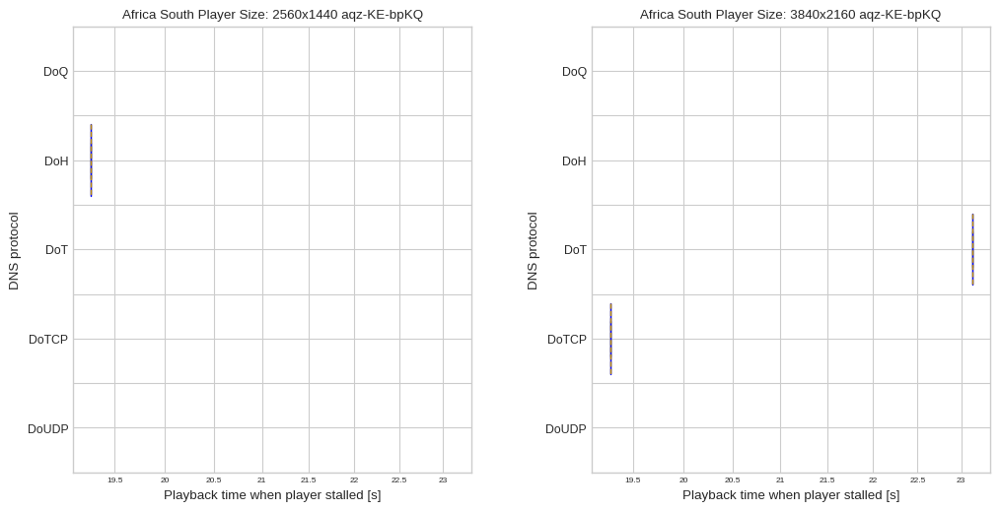

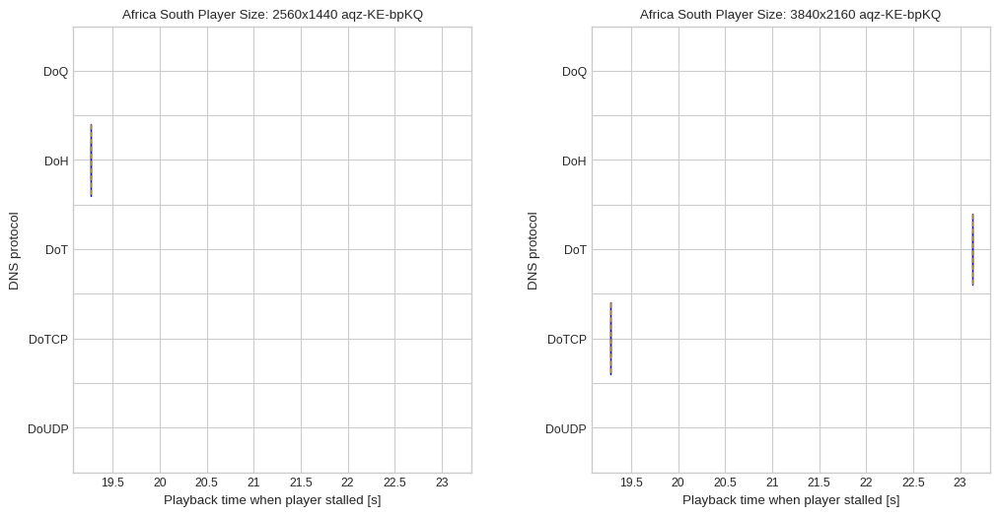

Asia Pacific Northeast


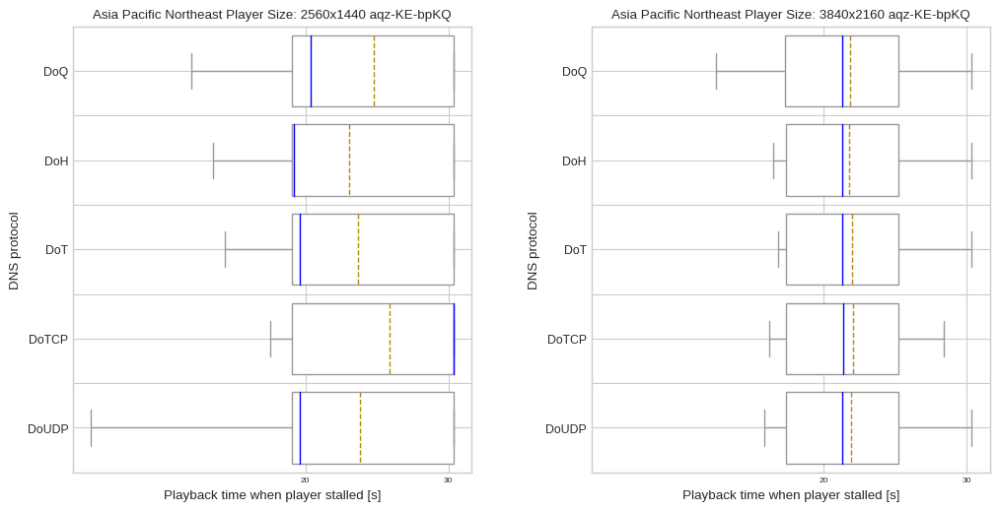

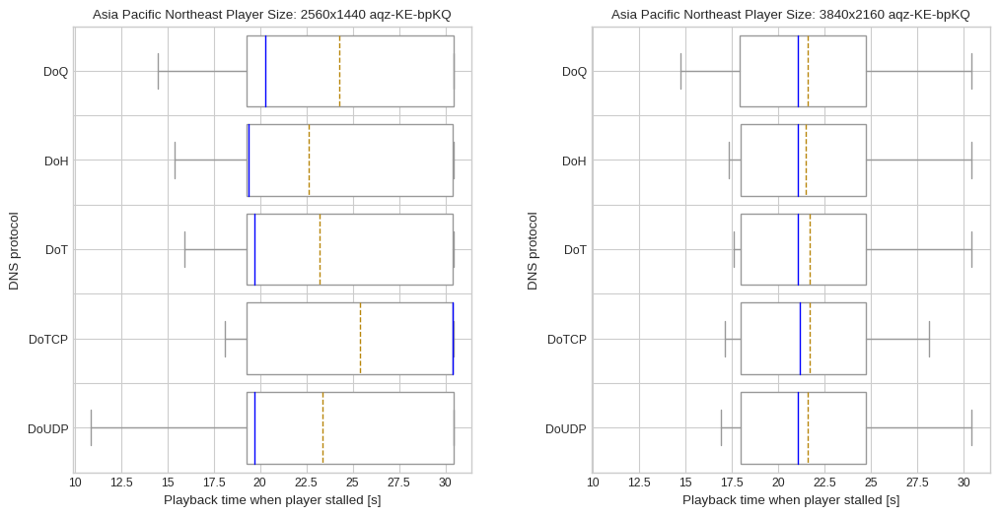

Asia Pacific Southeast


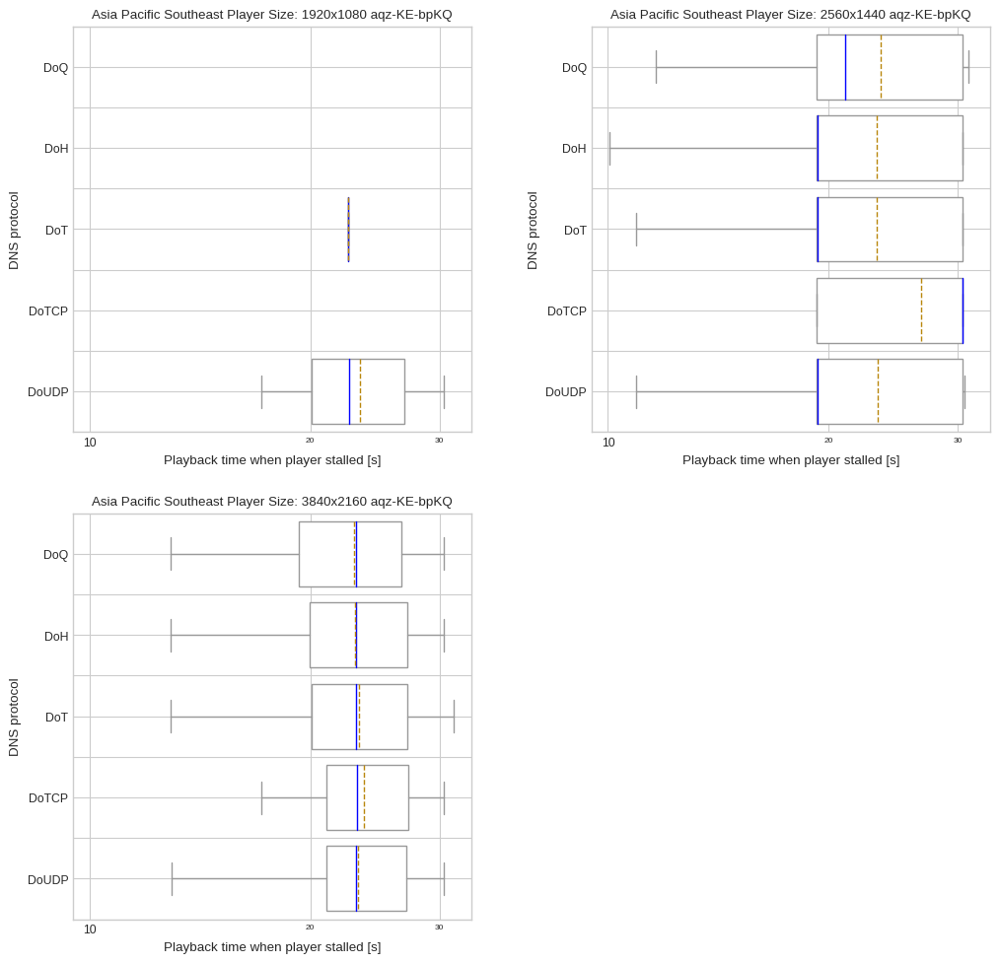

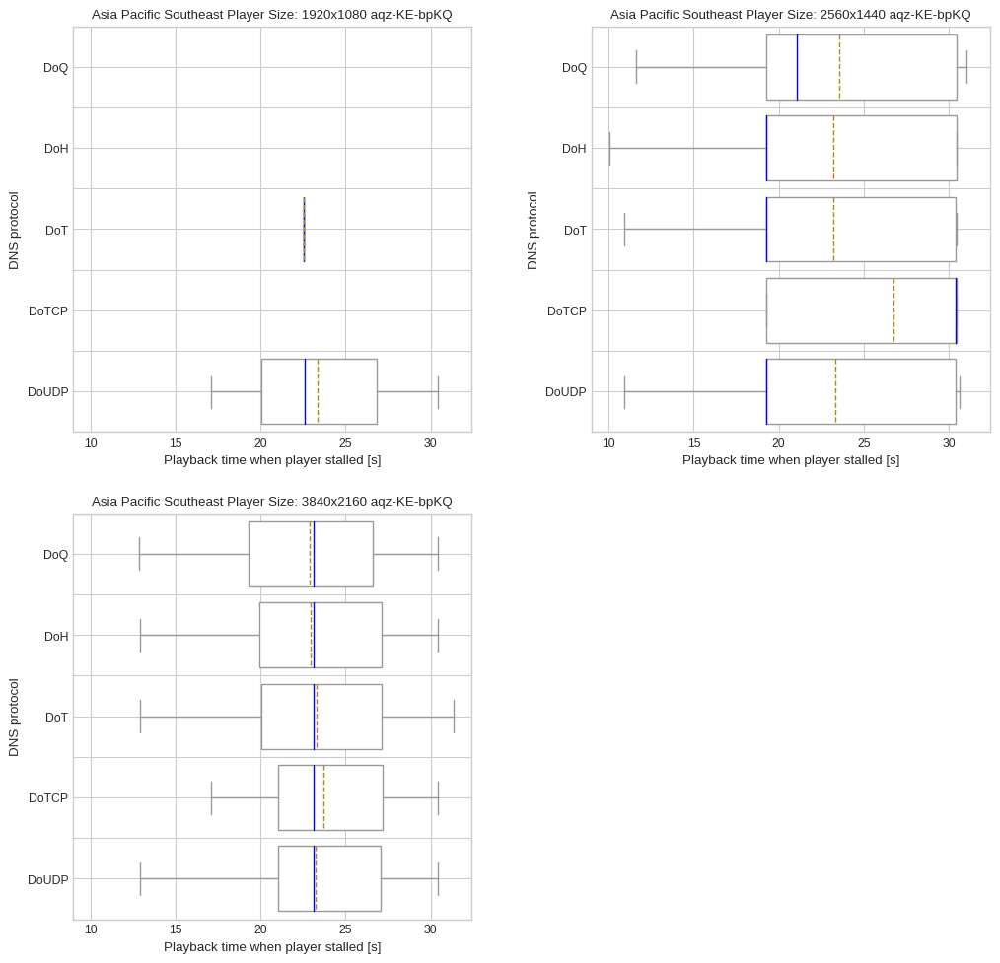

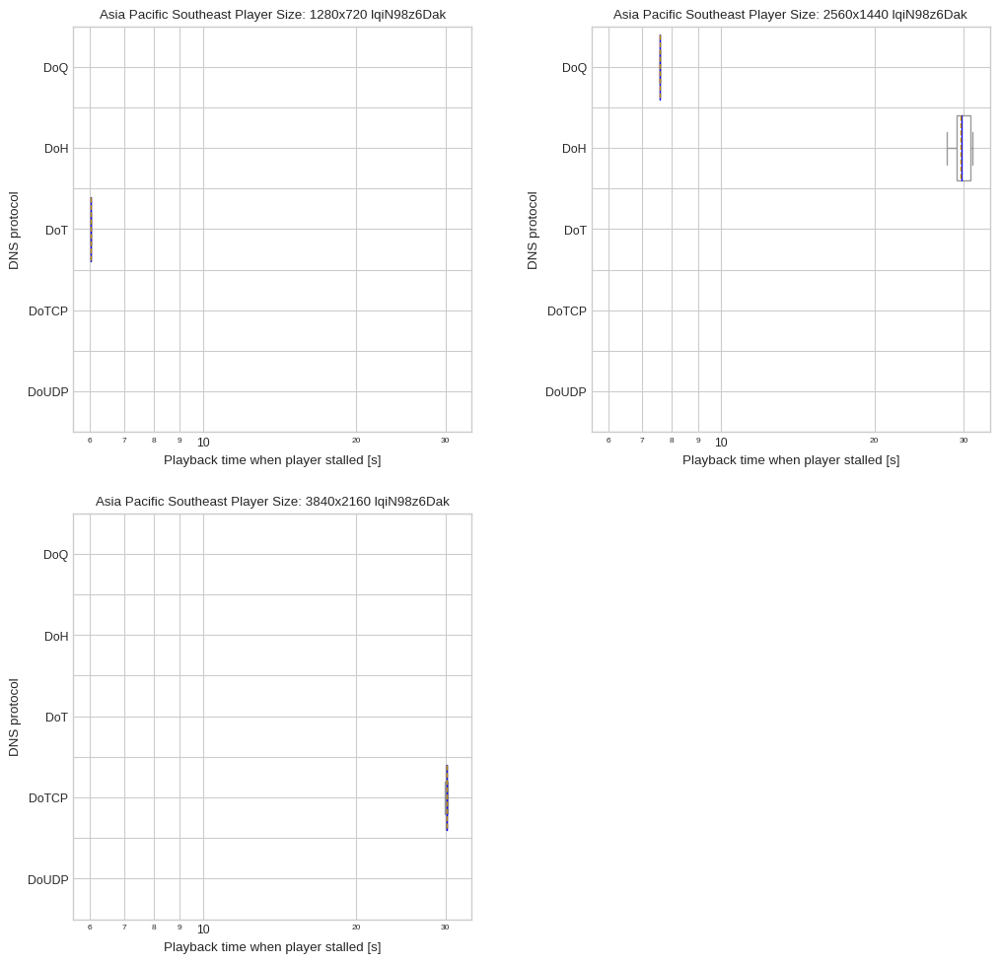

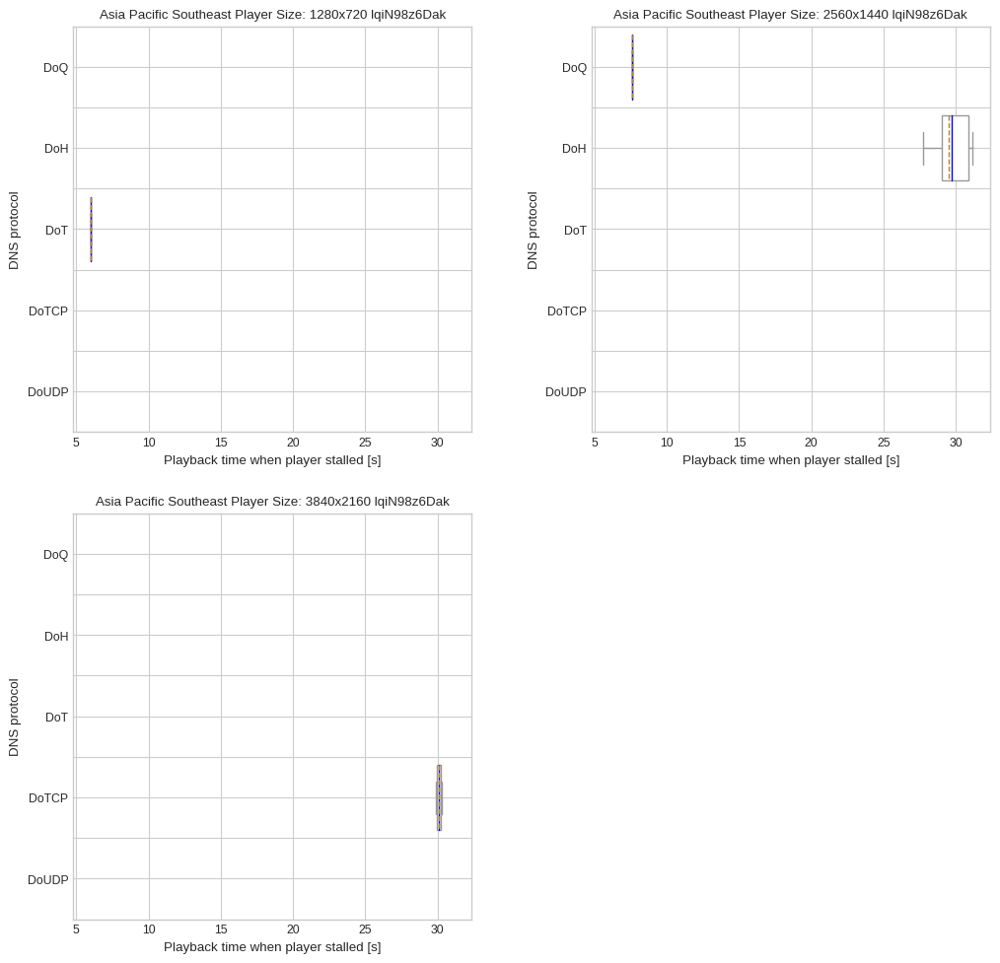

Europe Central


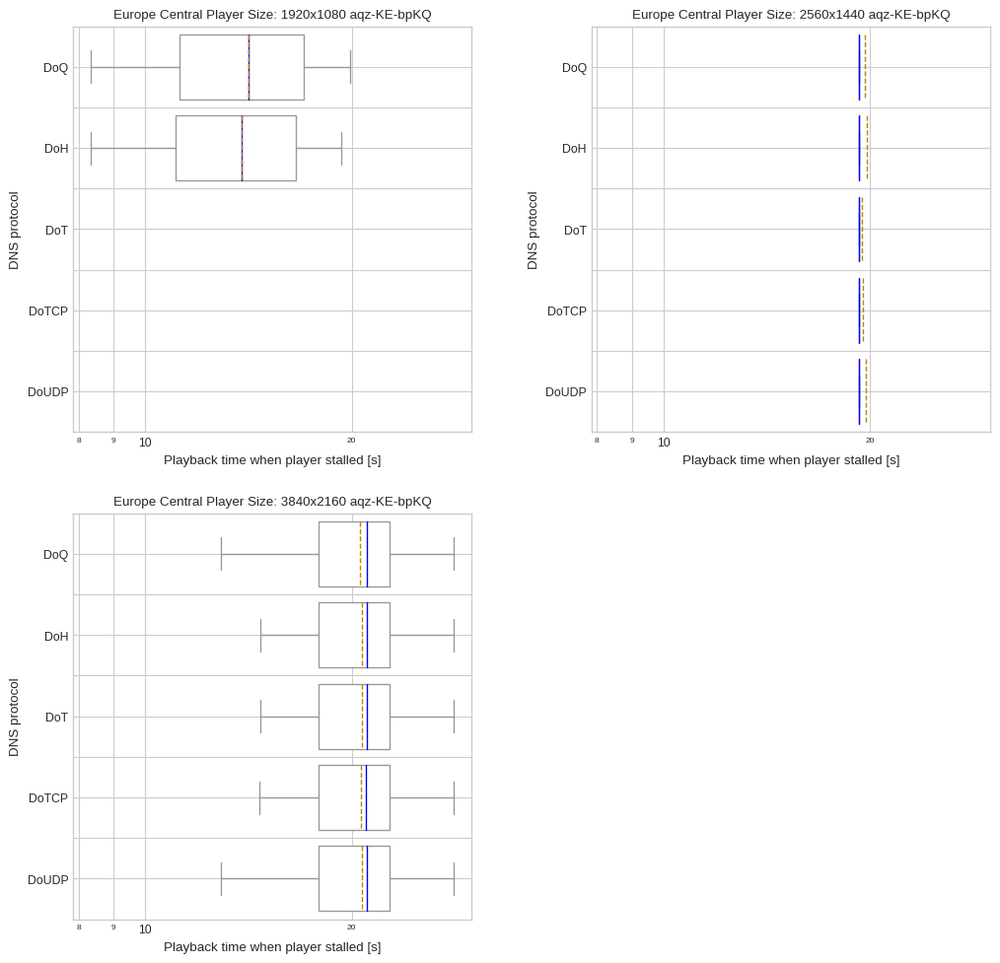

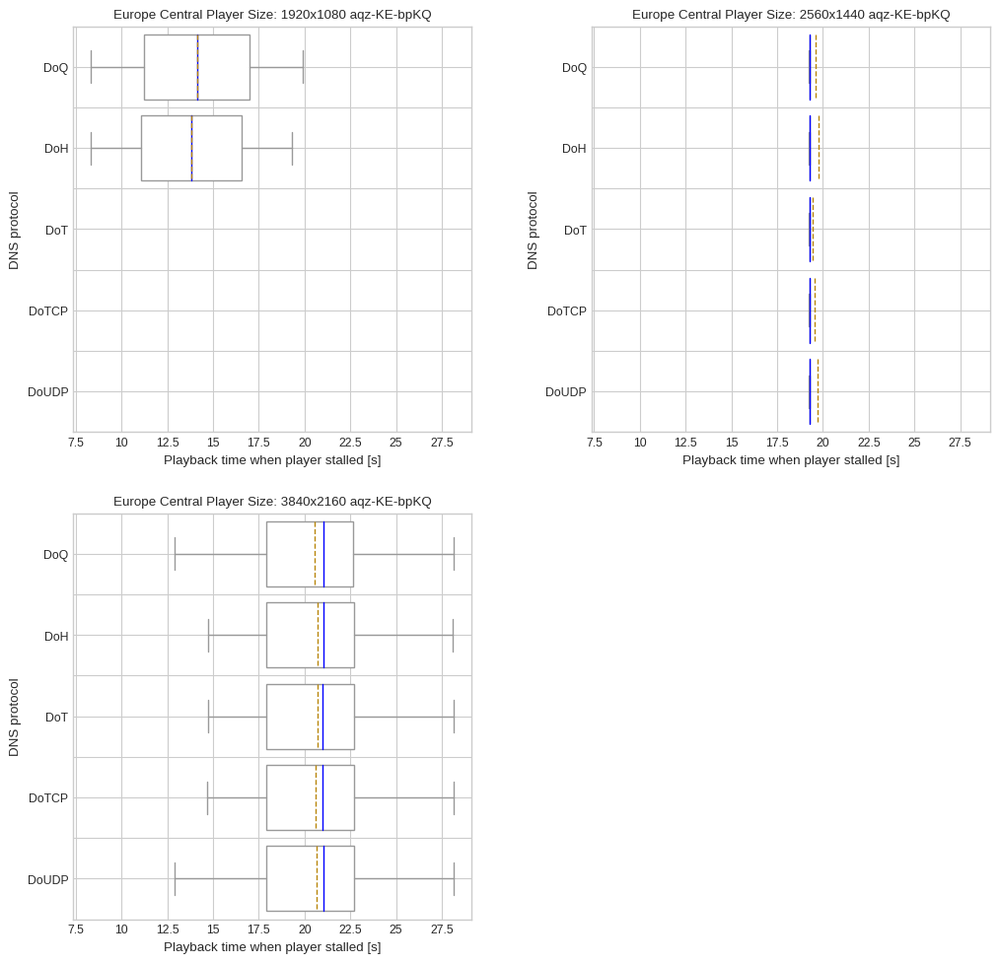

South America East


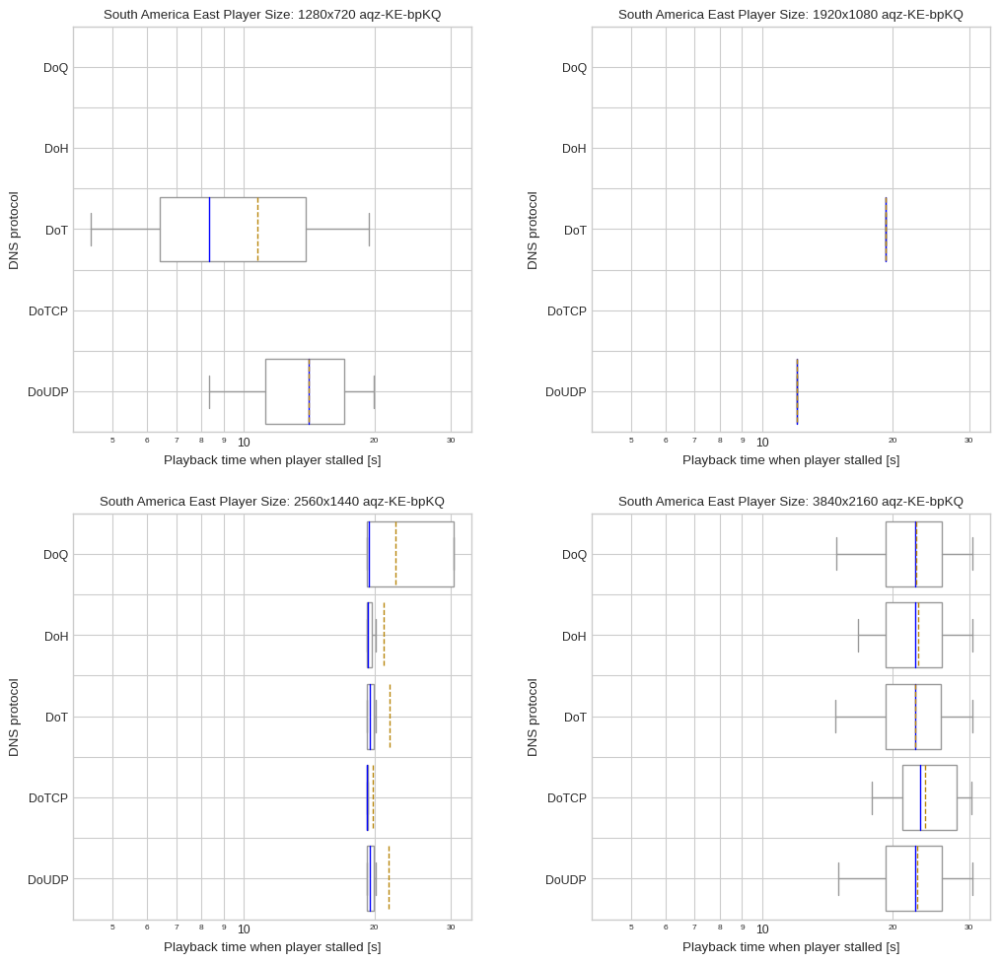

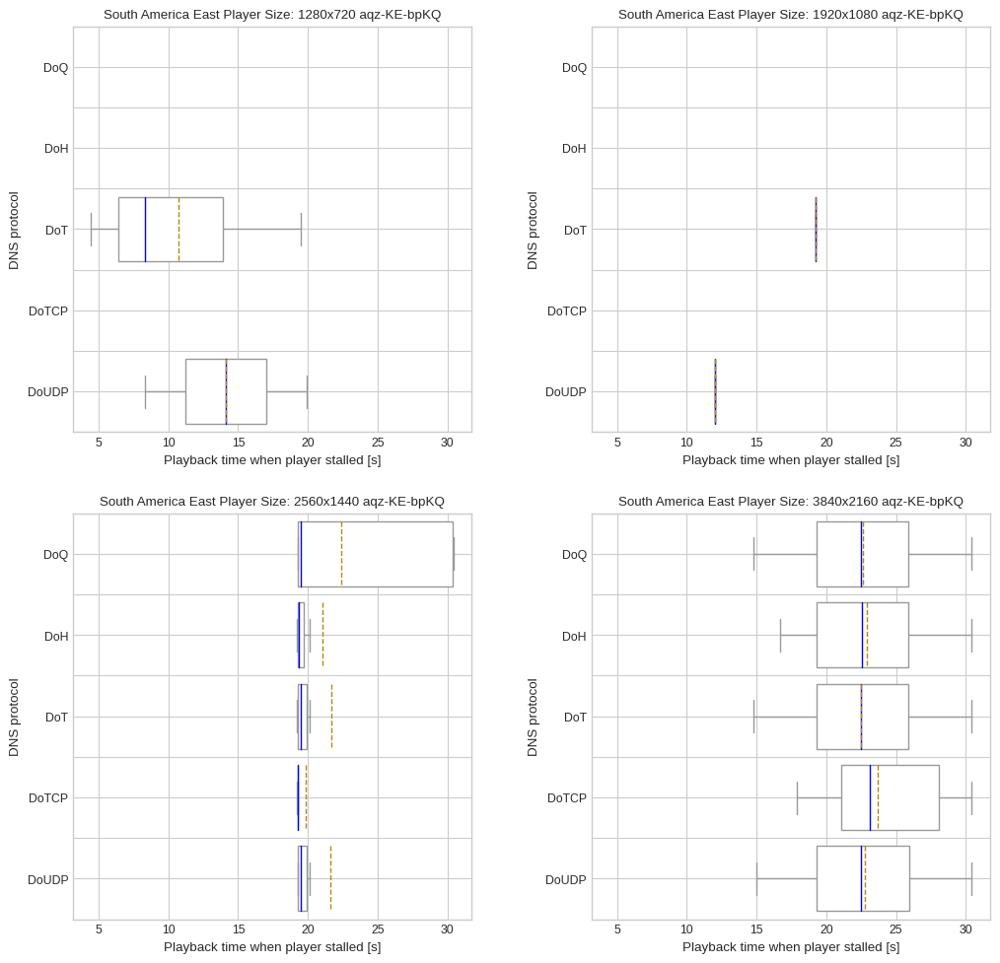

US East


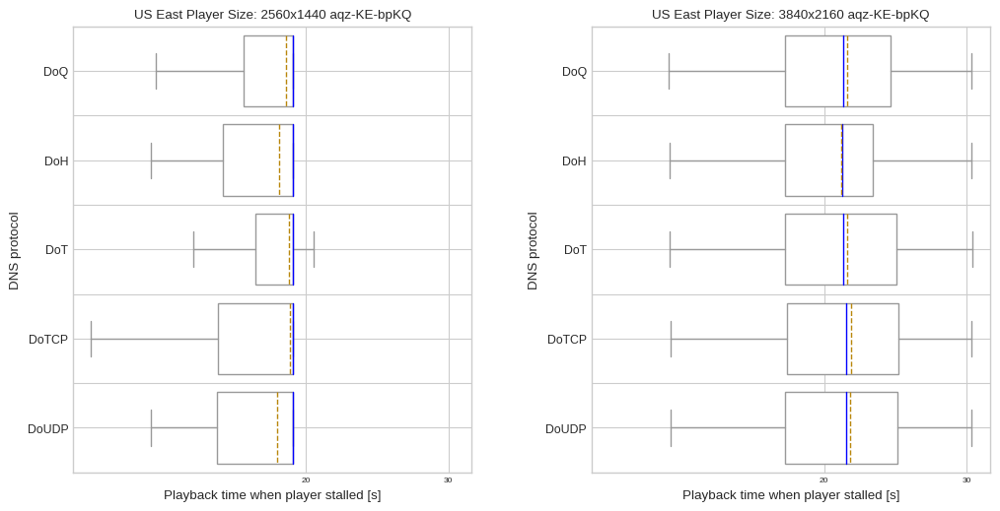

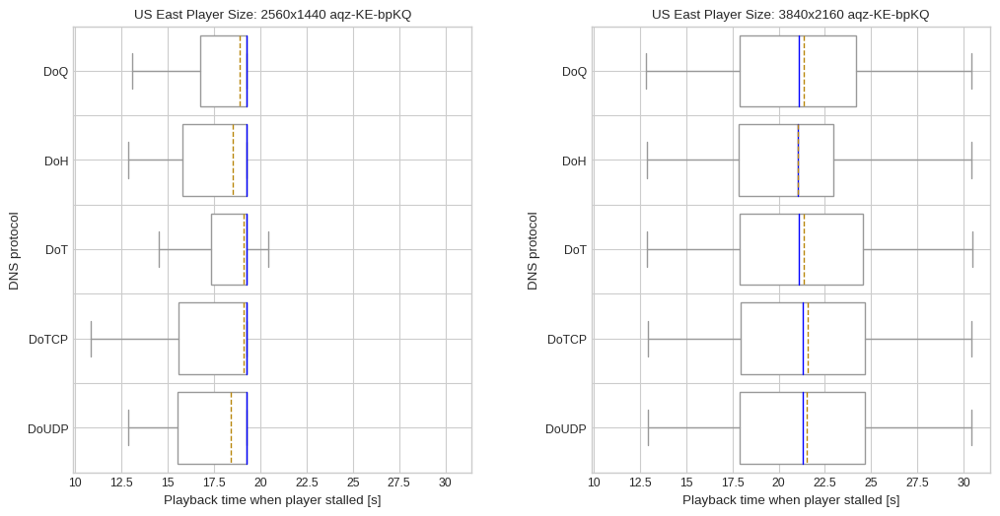

US West


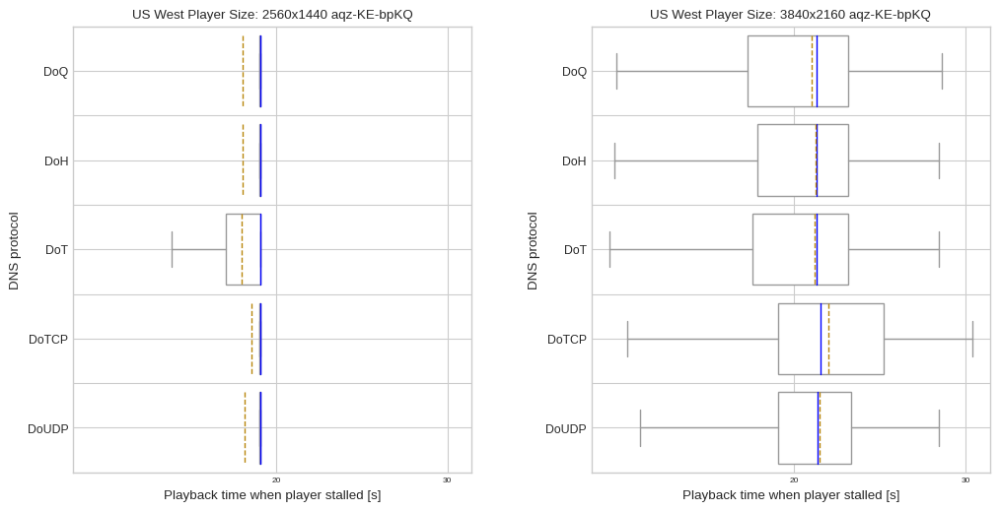

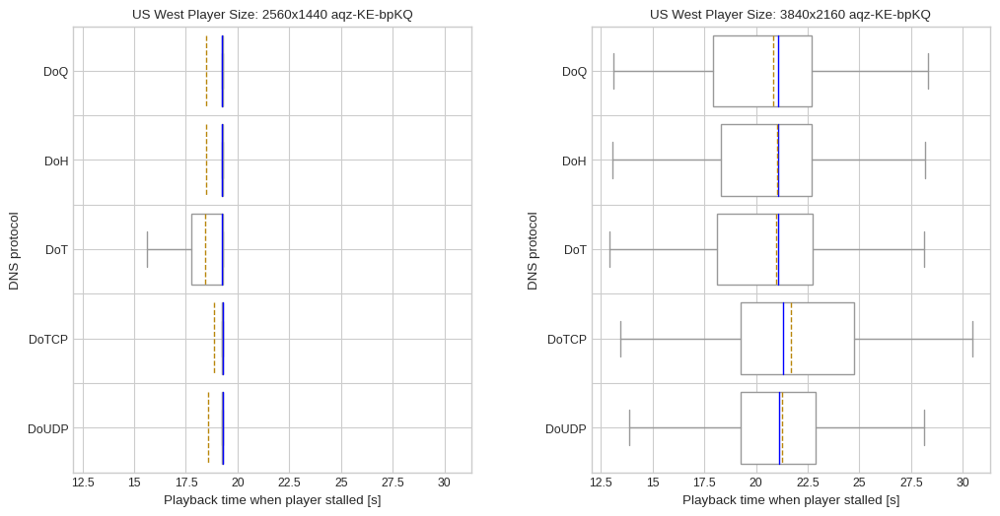

all vantage points


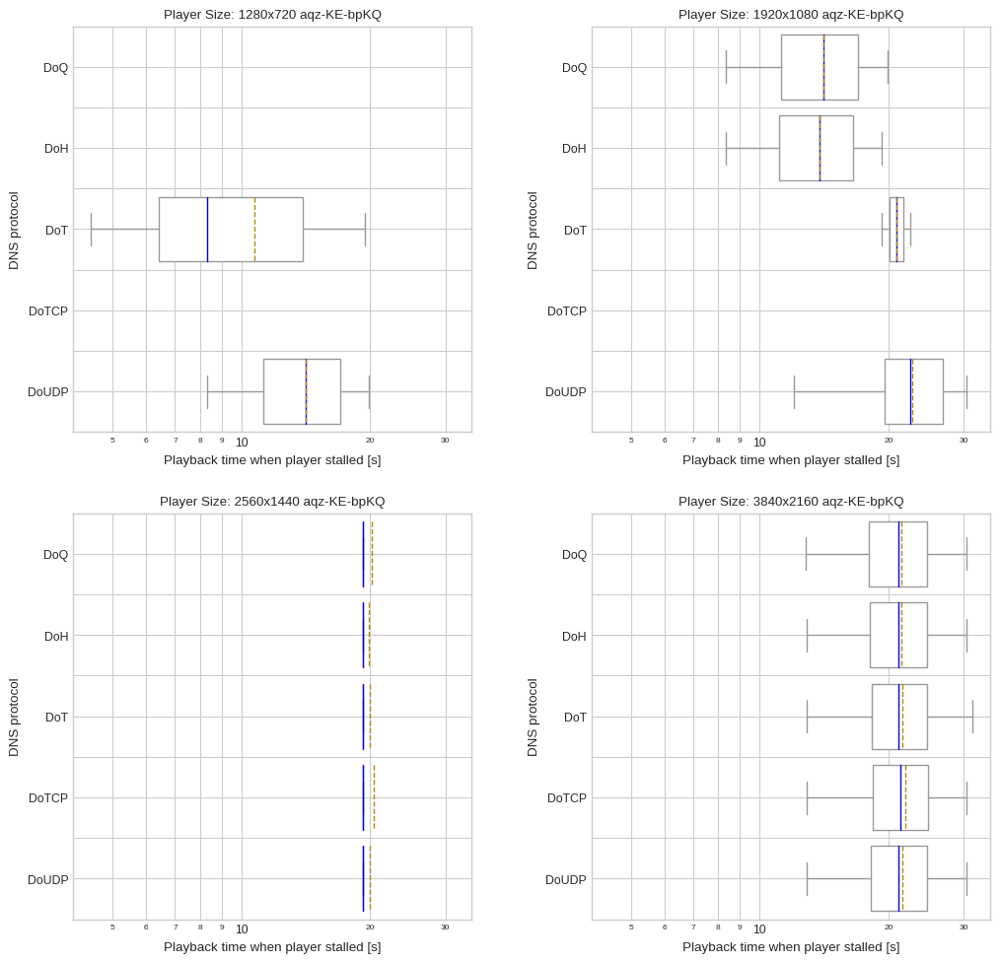

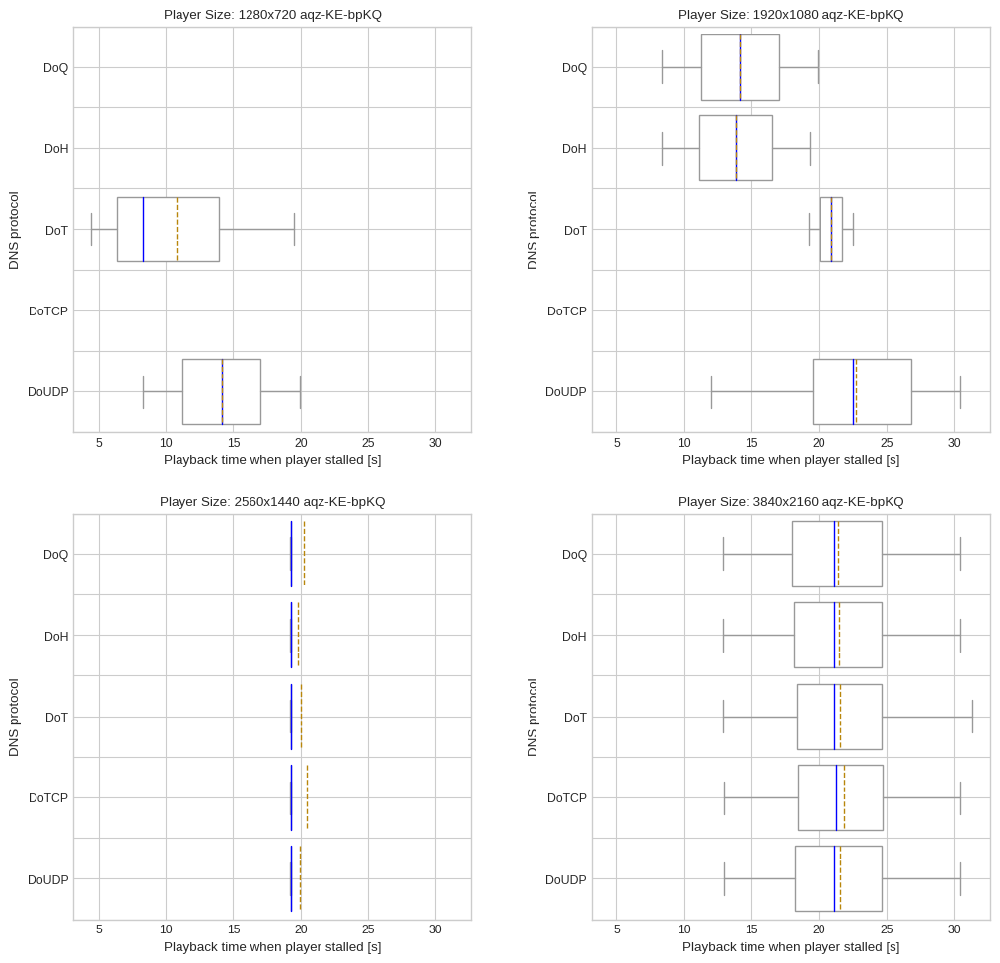

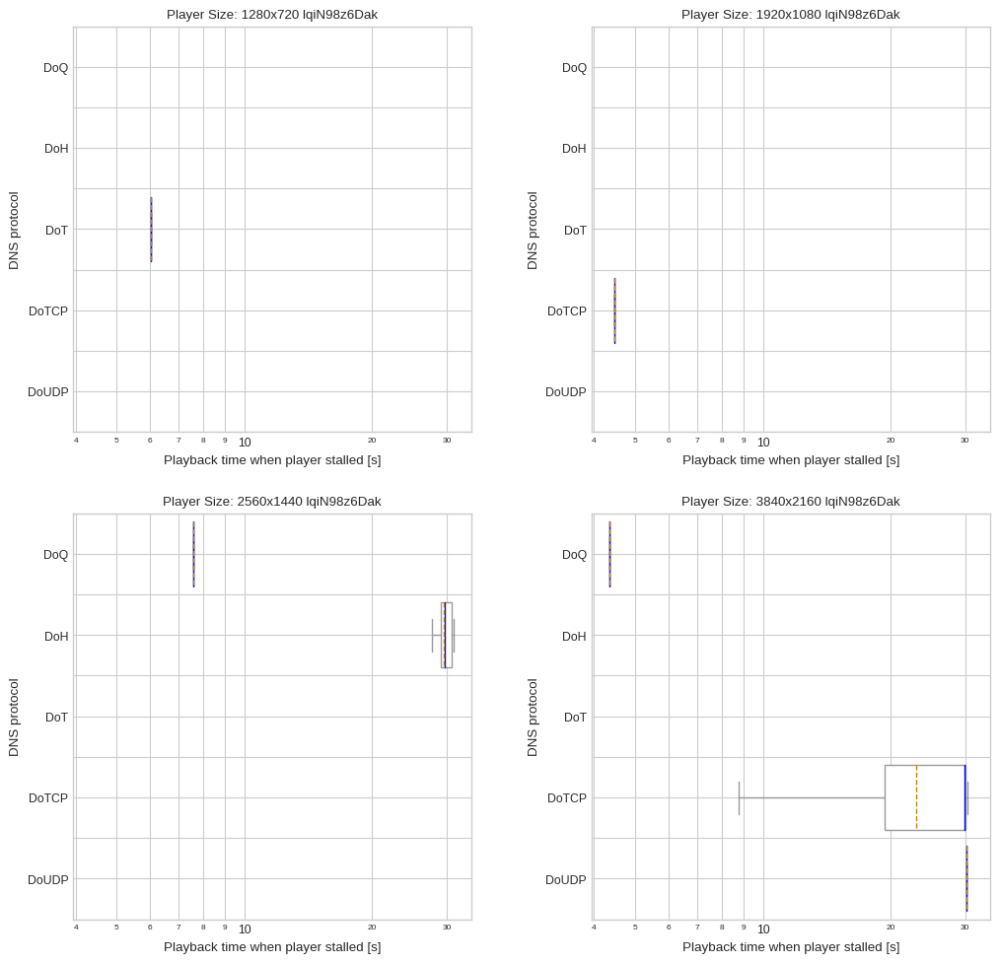

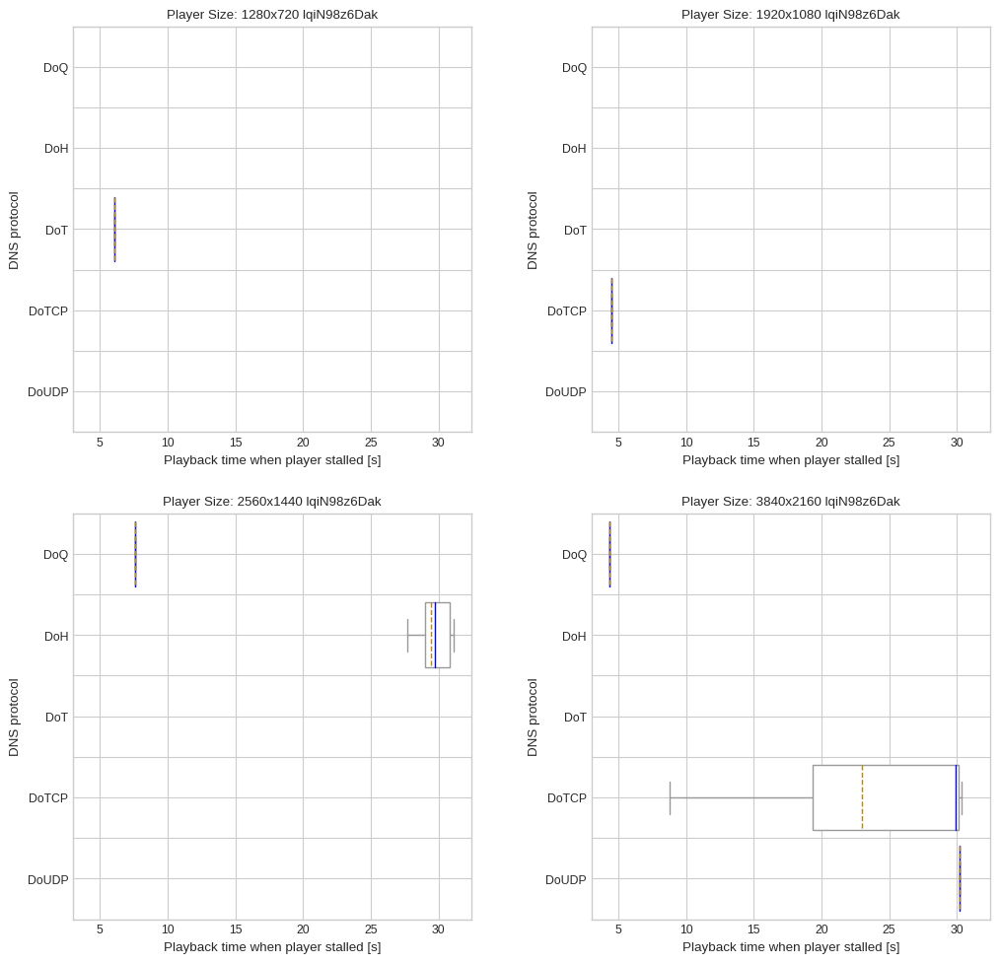

In [547]:
draw_boxplot_grid(df_buffering_events_time, 'player_dimensions', 'protocol', 'curr_play_time', [True, False], 'Playback time when player stalled [s]', 'Player Size:', 'buffer-events-by-player-size-and-proto', [0,0], "DNS protocol", draw_all=True)

In [ ]:
draw_boxplot(df_buffering_events_time, 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player stalled [s]', 'Player Size:', 'buffer-events-by-player-size-and-proto', [0,0], "DNS protocol")

In [ ]:
draw_boxplot_grid(df_start_time, 'player_dimensions', 'protocol', 'startup_delay', [True, False], 'Startup delay [s]', 'Player Size:', 'startup-delay-by-player-size-and-proto', [0,0], "DNS protocol")

In [ ]:
draw_boxplot(df_start_time, 'player_dimensions', 'protocol', 'startup_delay', [False], 'Startup delay [s]', 'Player Size:', 'startup-delay-by-player-size-and-proto', [0,0], "DNS protocol")

Africa South


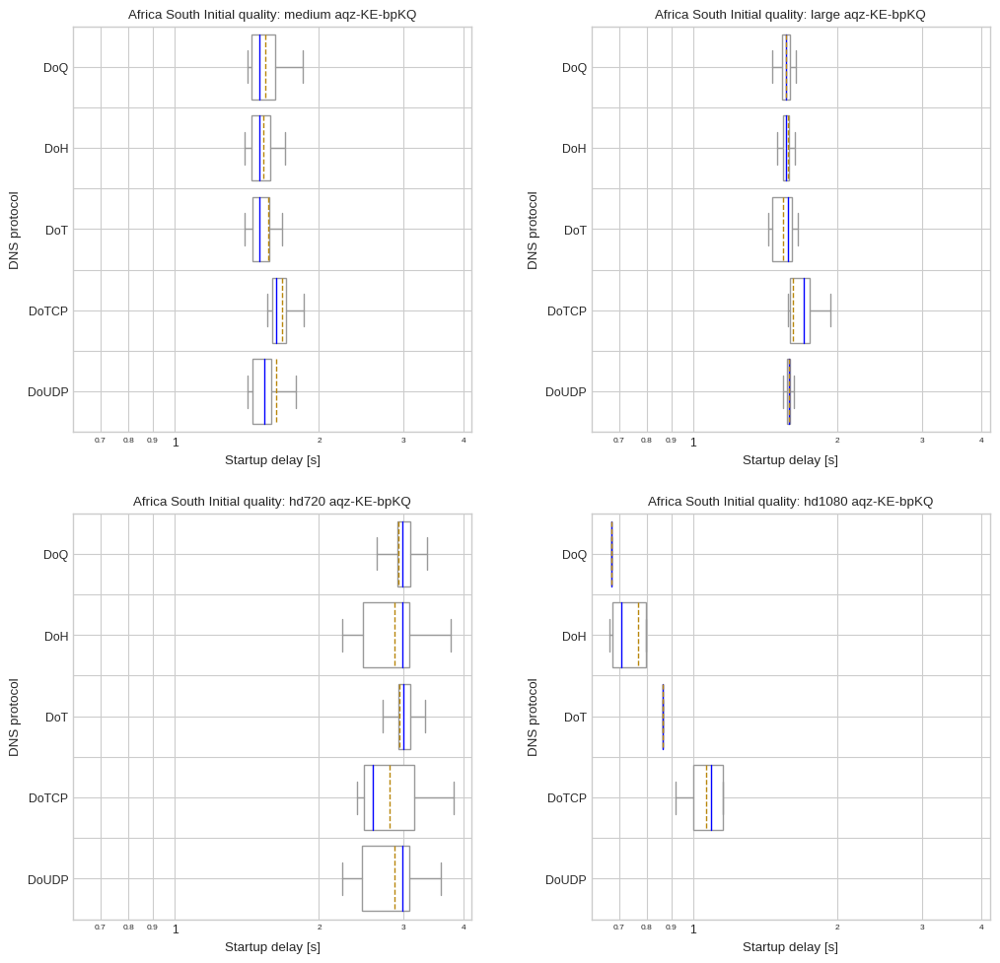

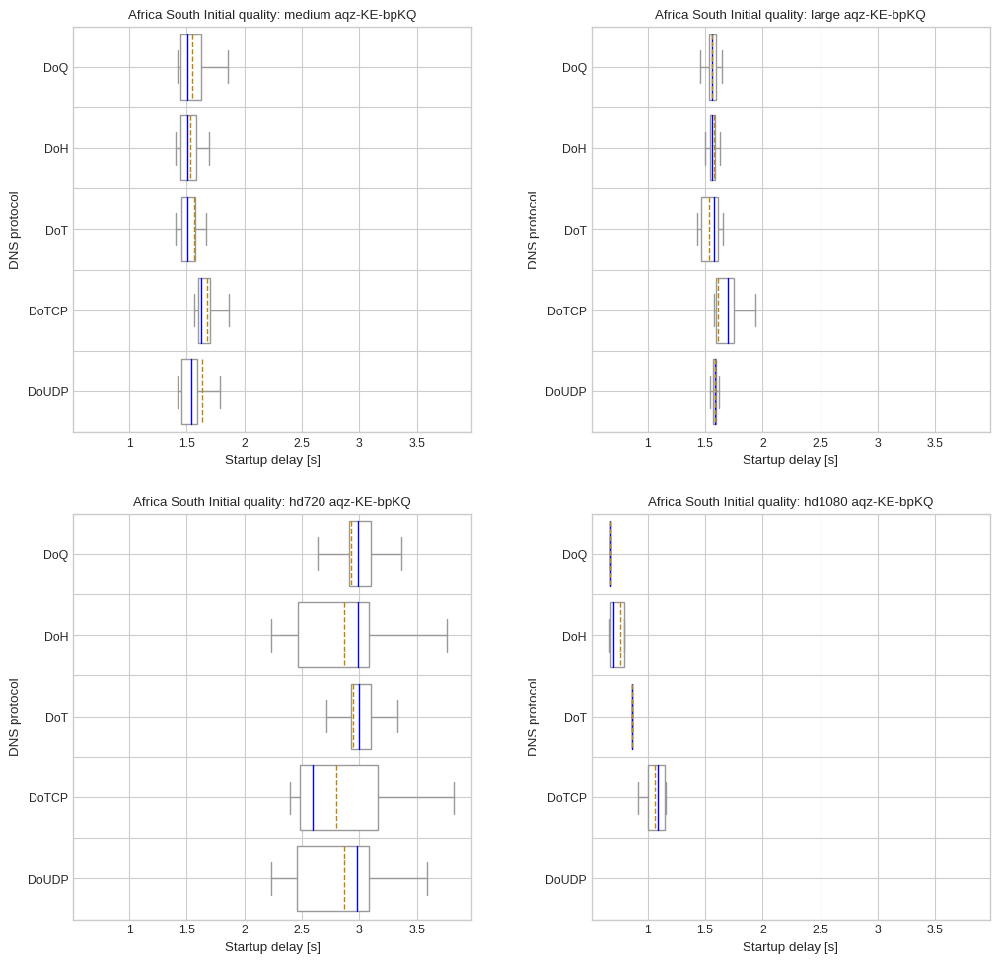

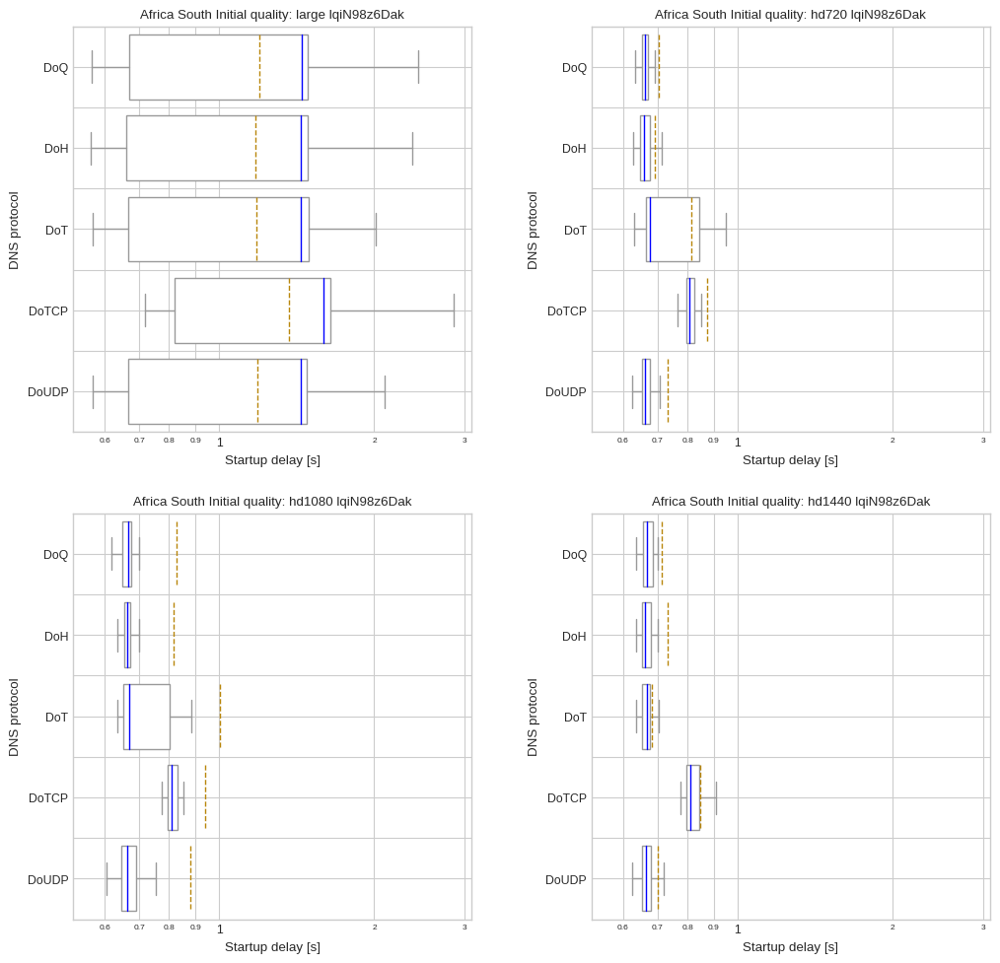

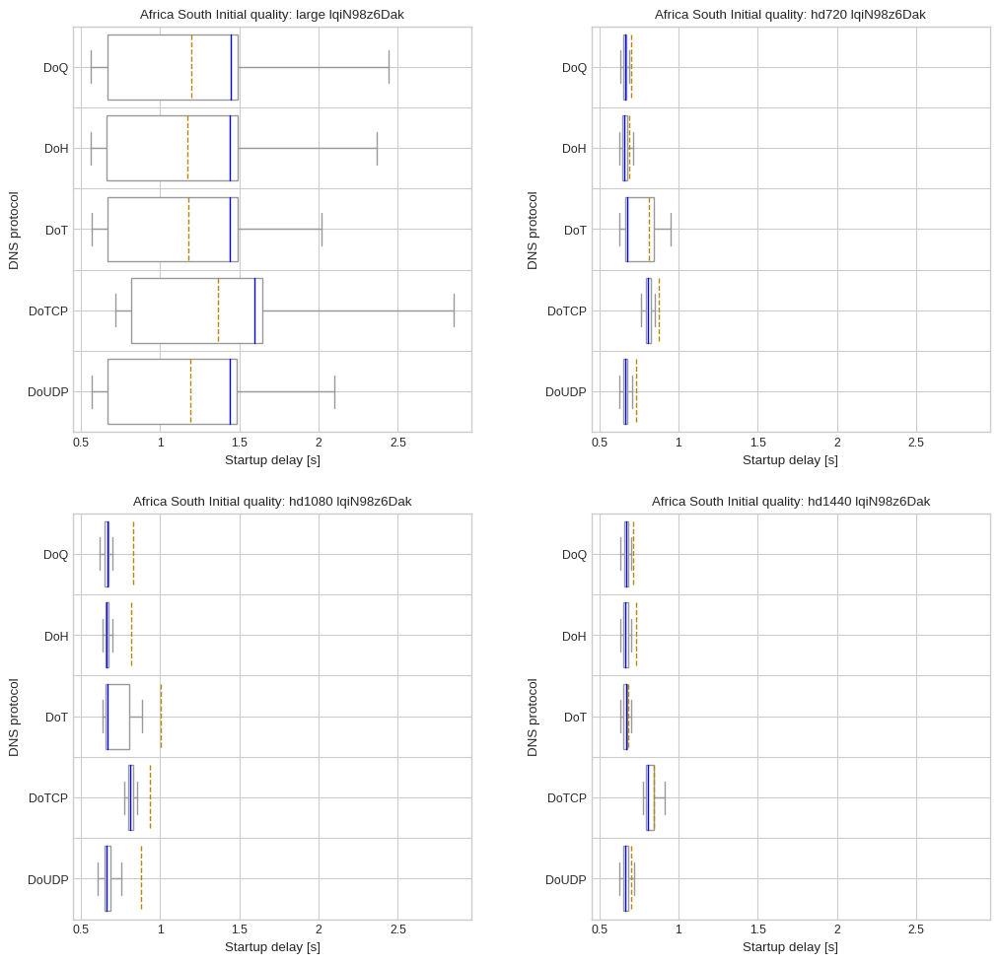

Asia Pacific Northeast


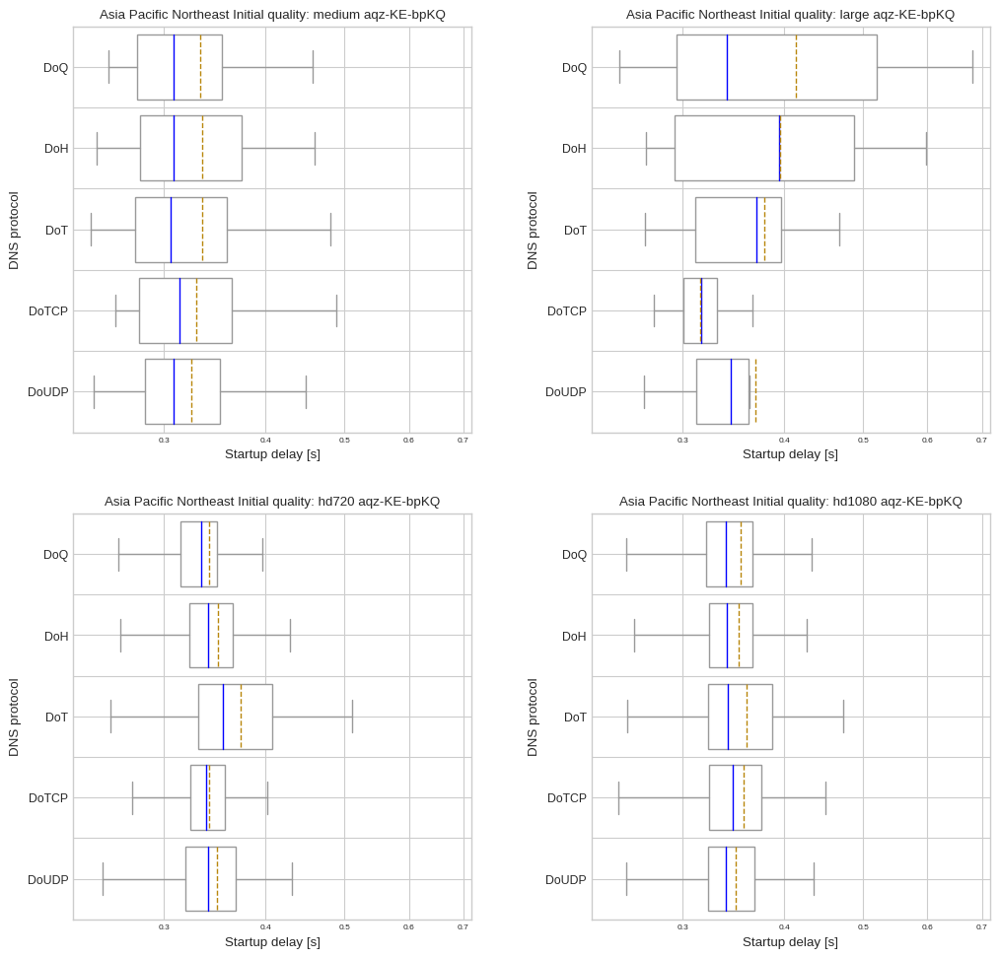

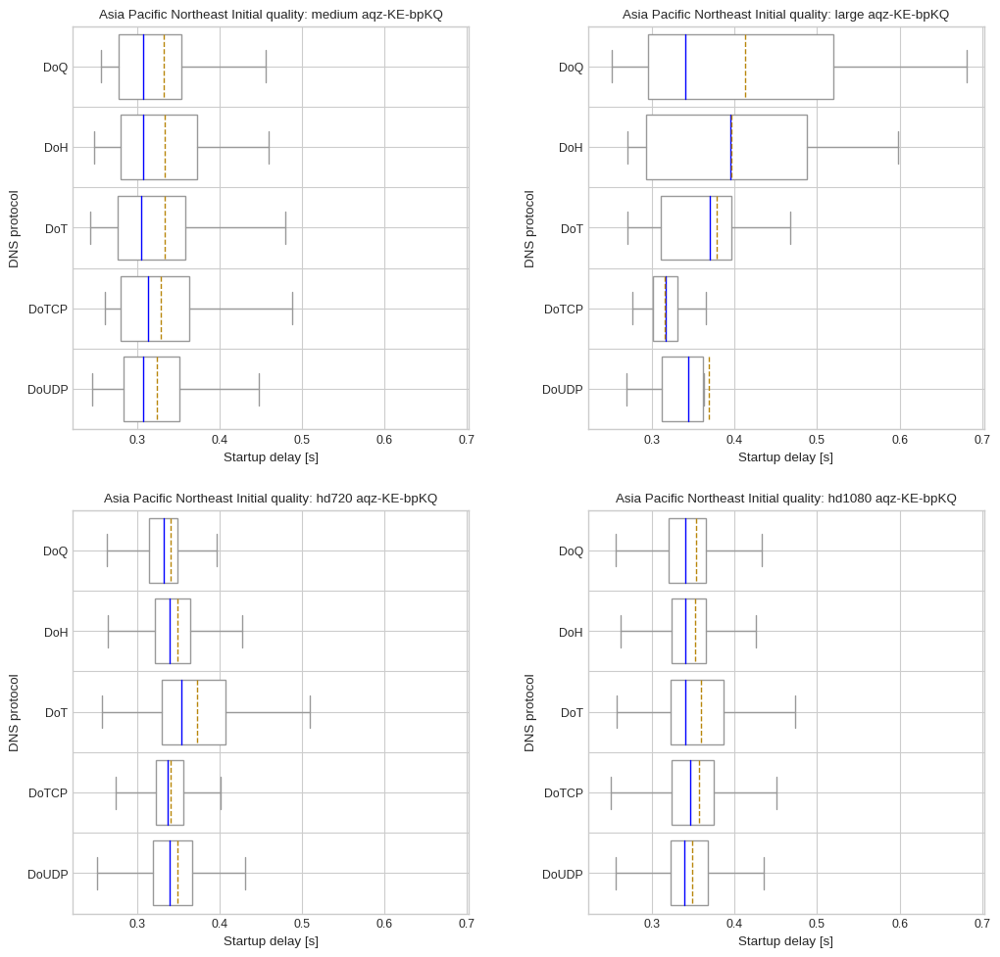

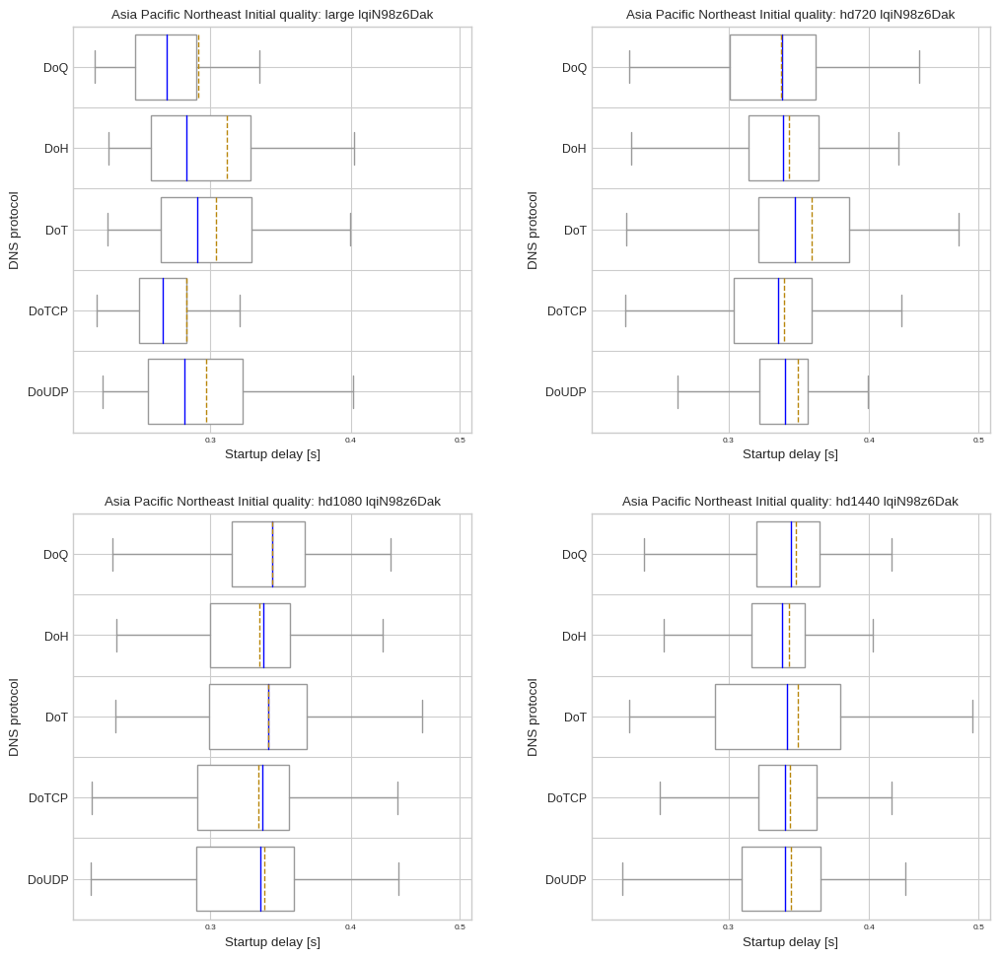

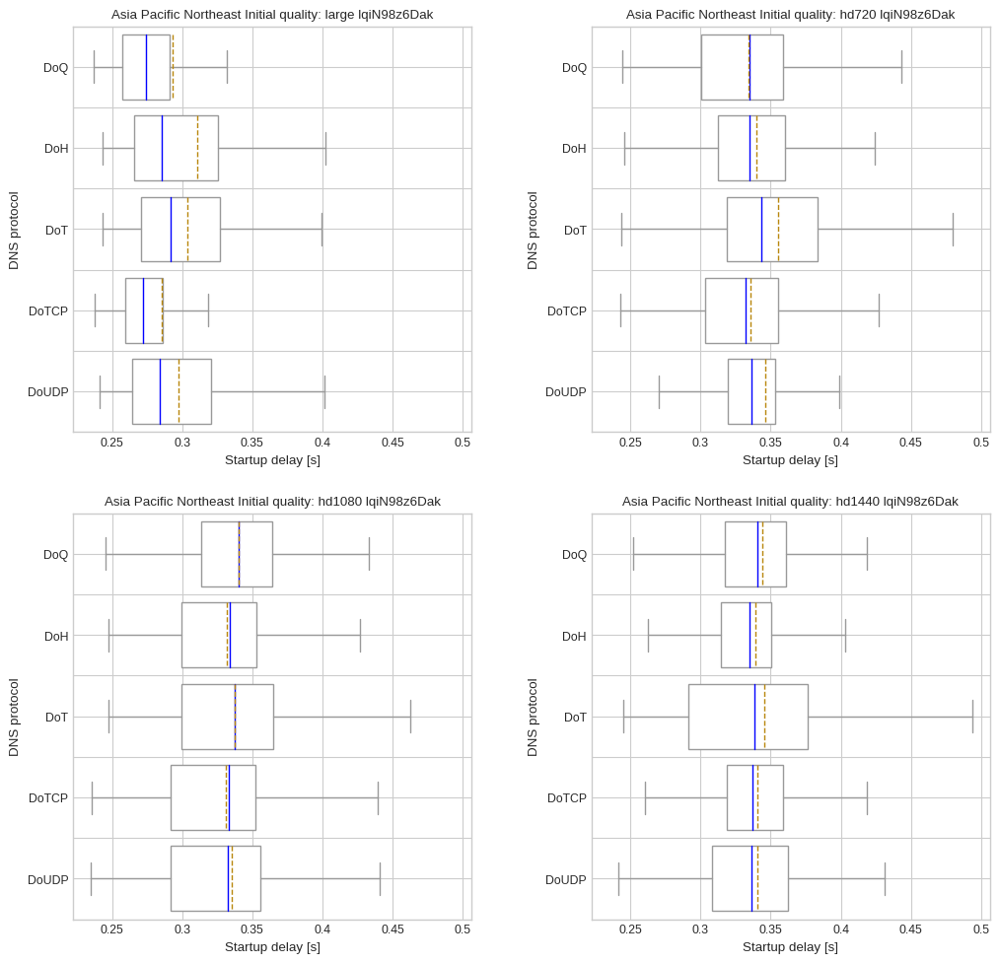

Asia Pacific Southeast


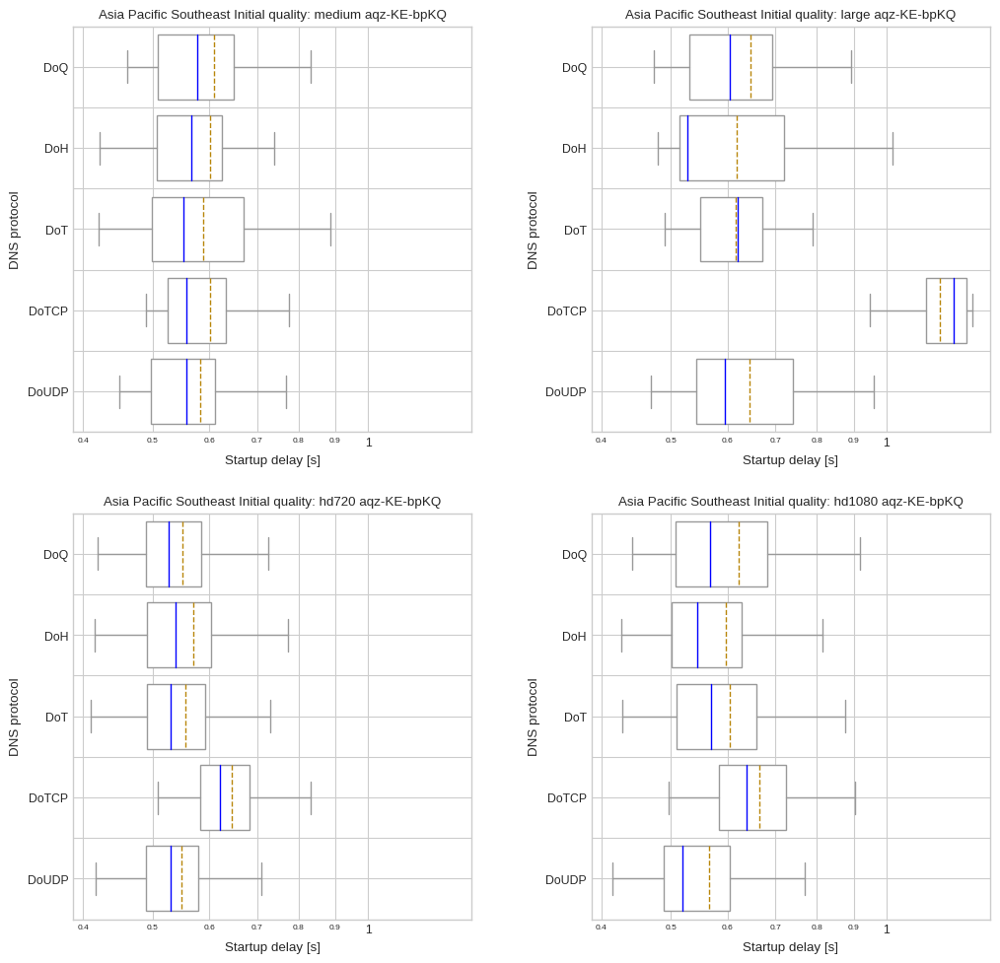

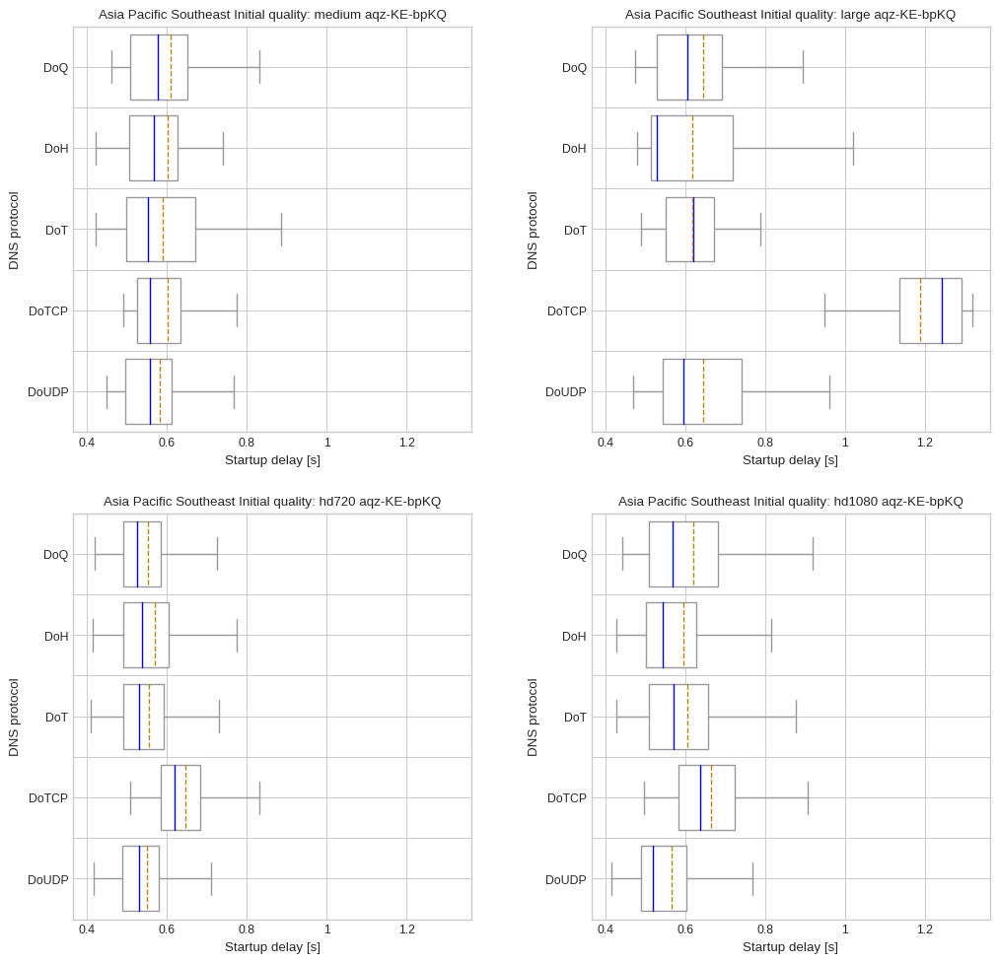

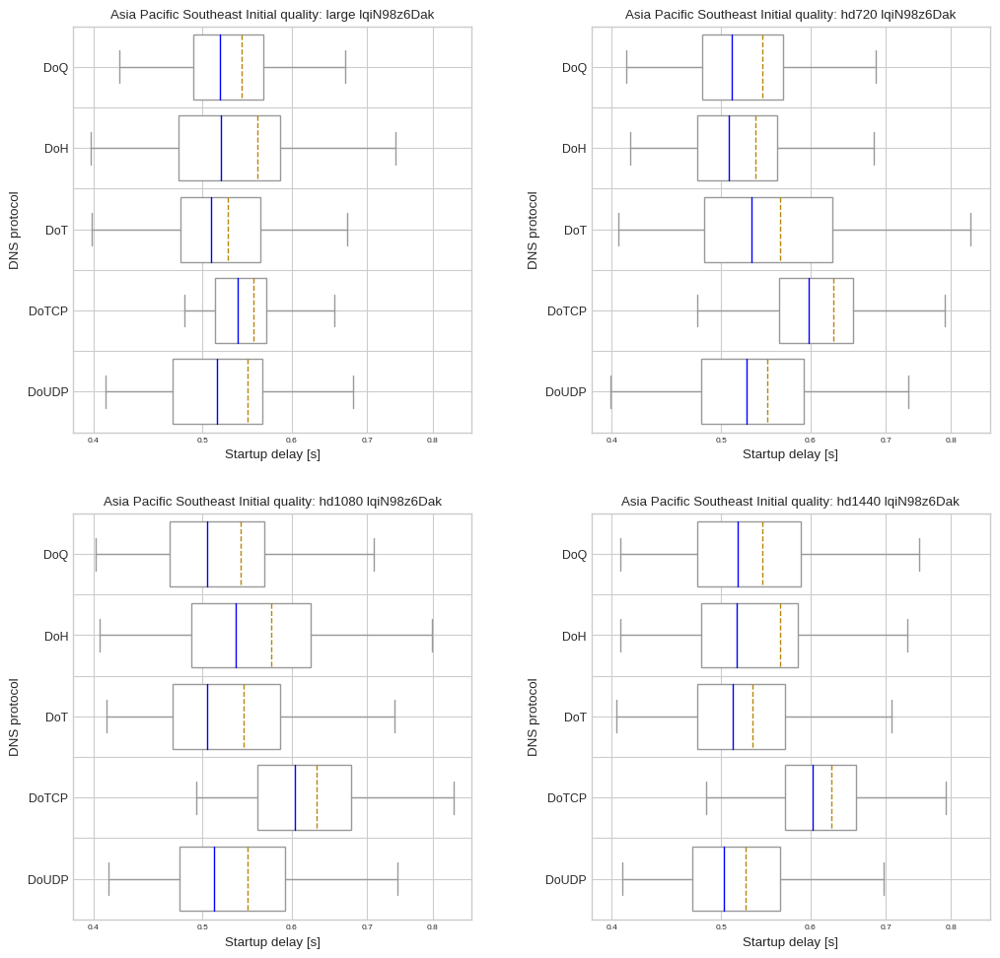

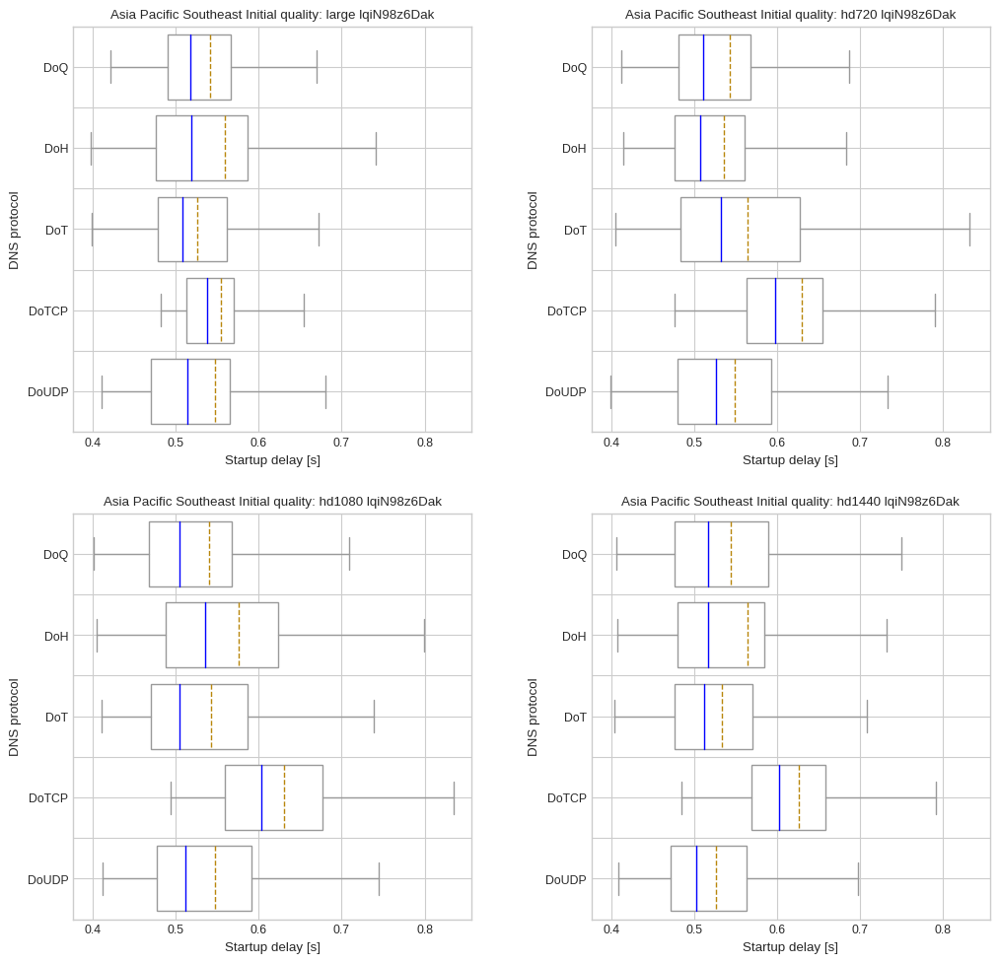

Europe Central


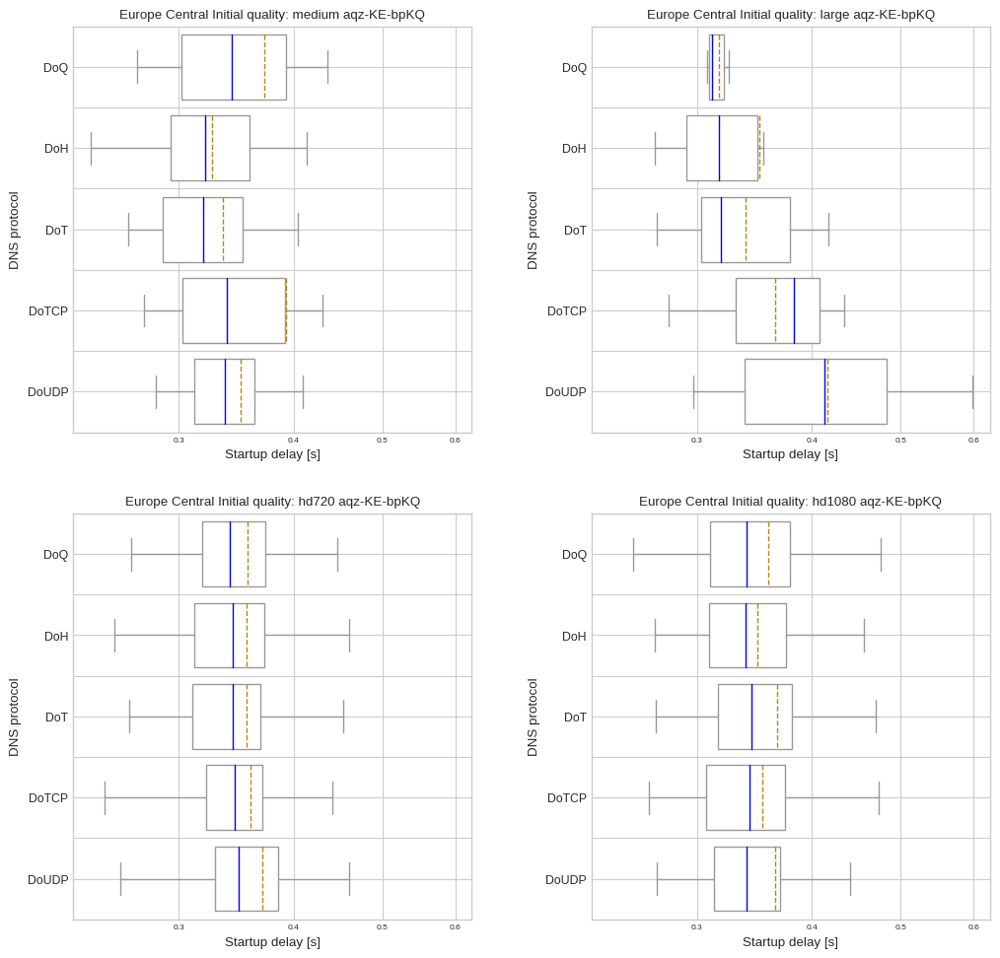

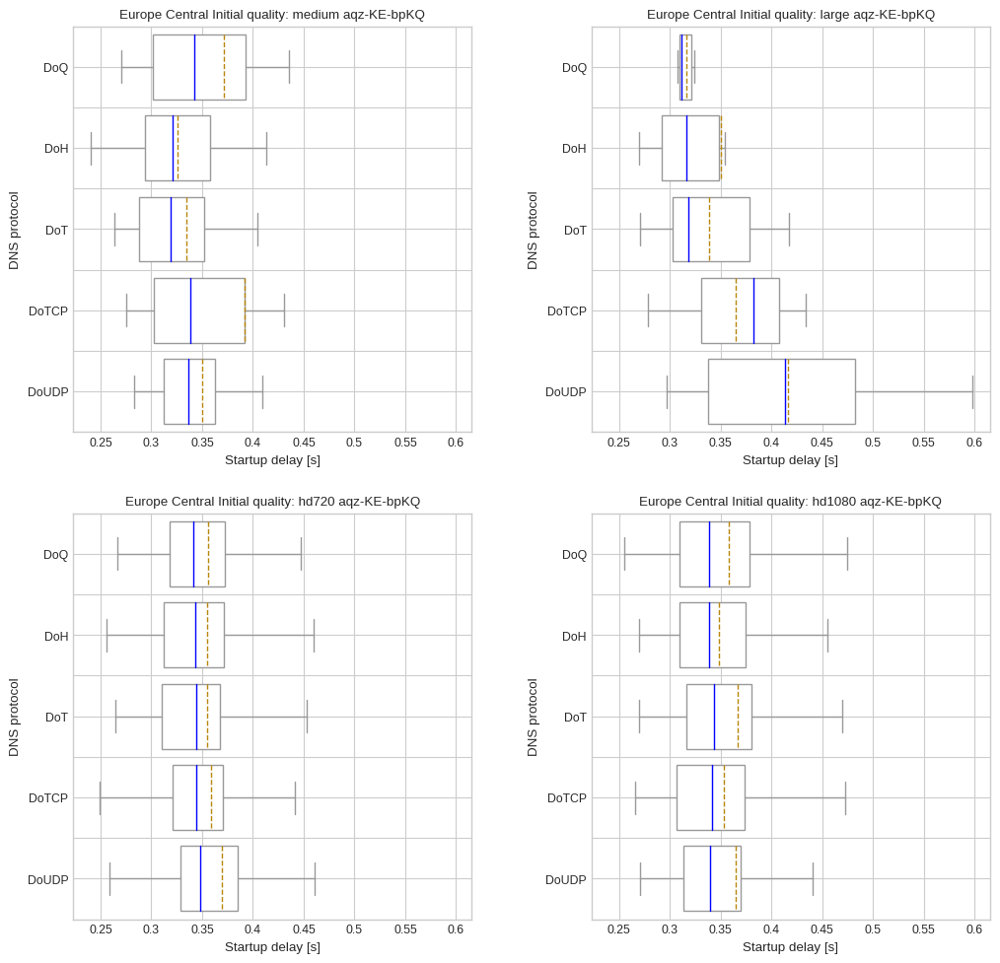

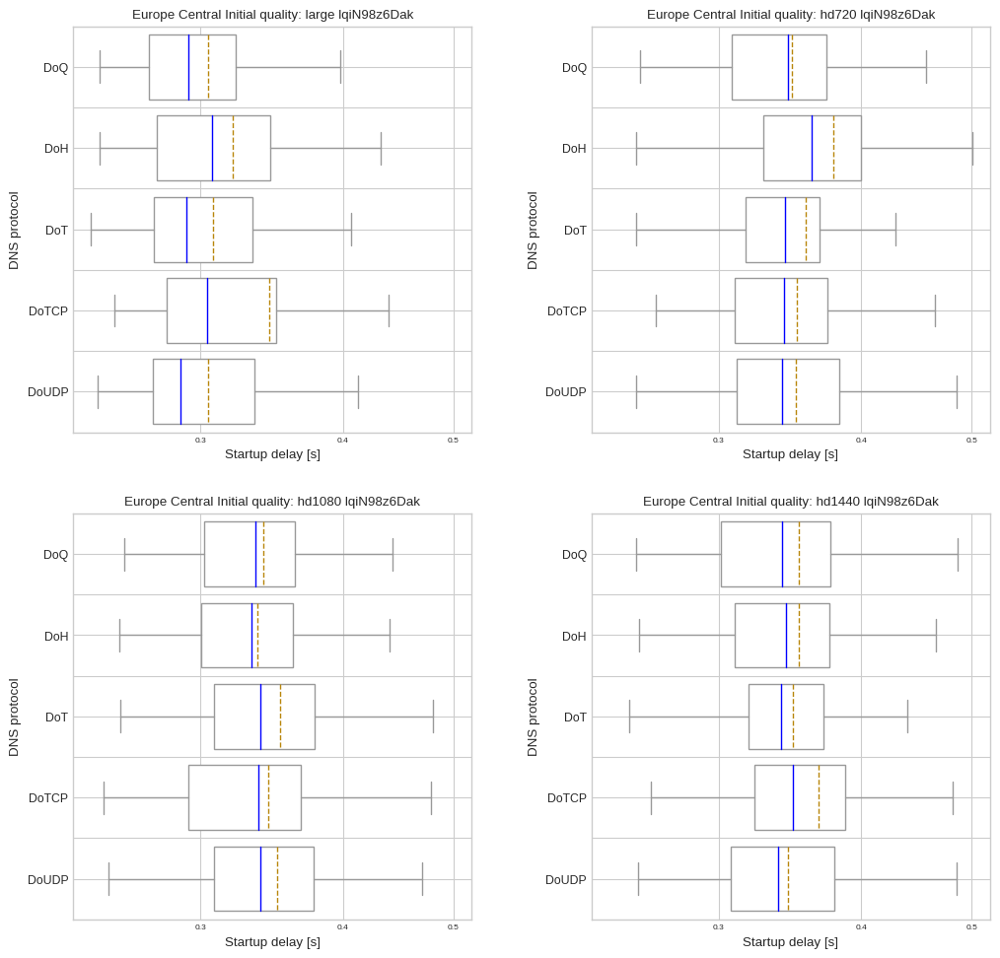

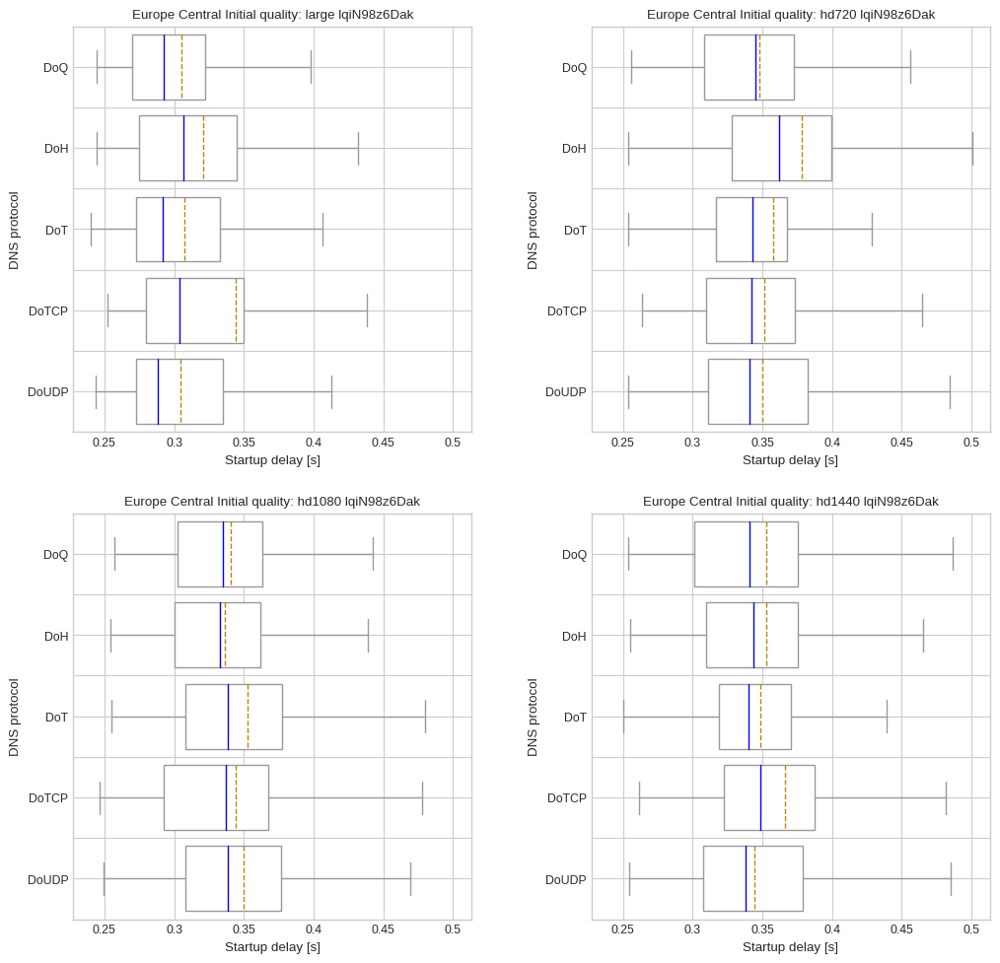

South America East


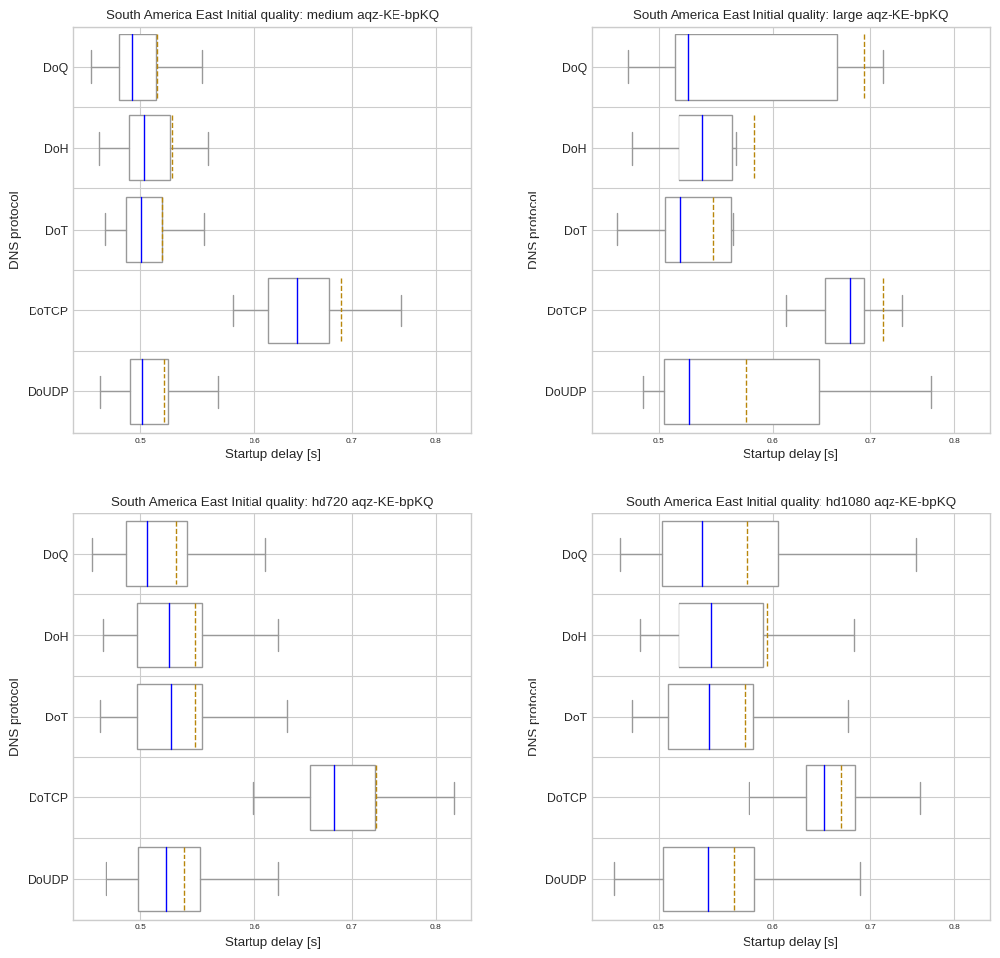

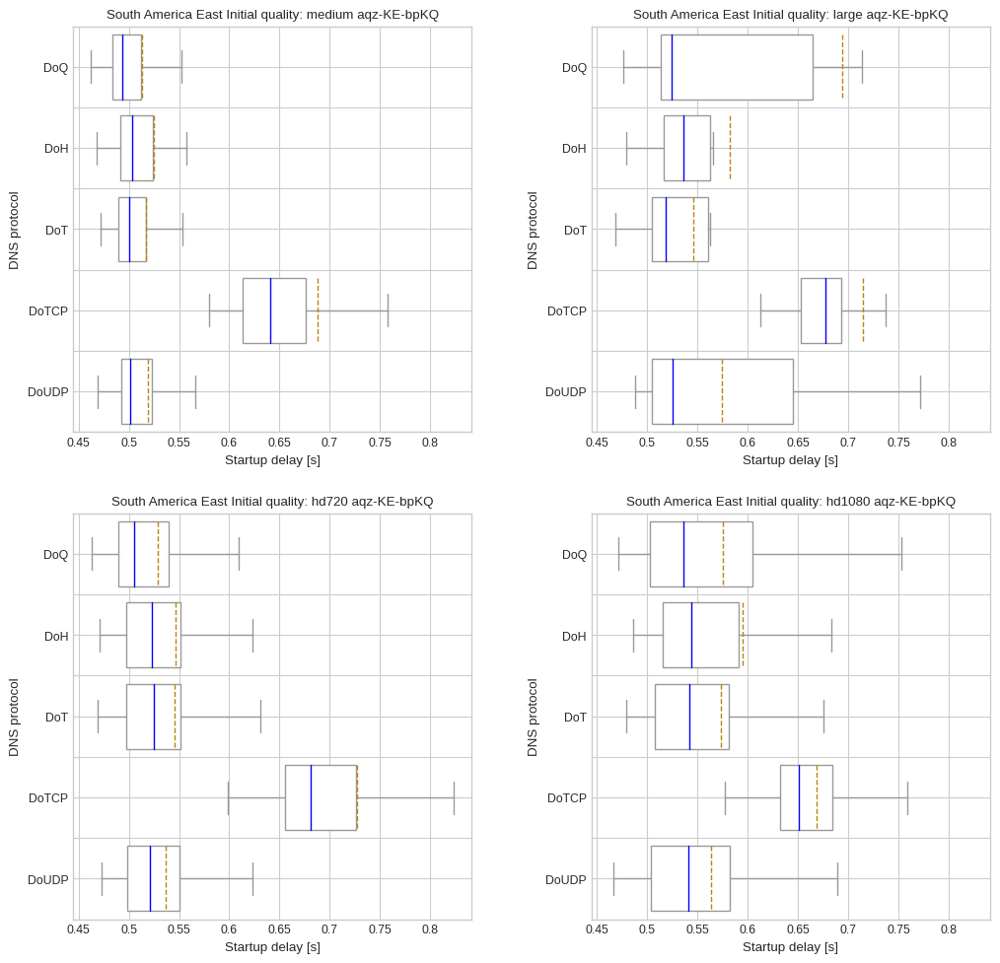

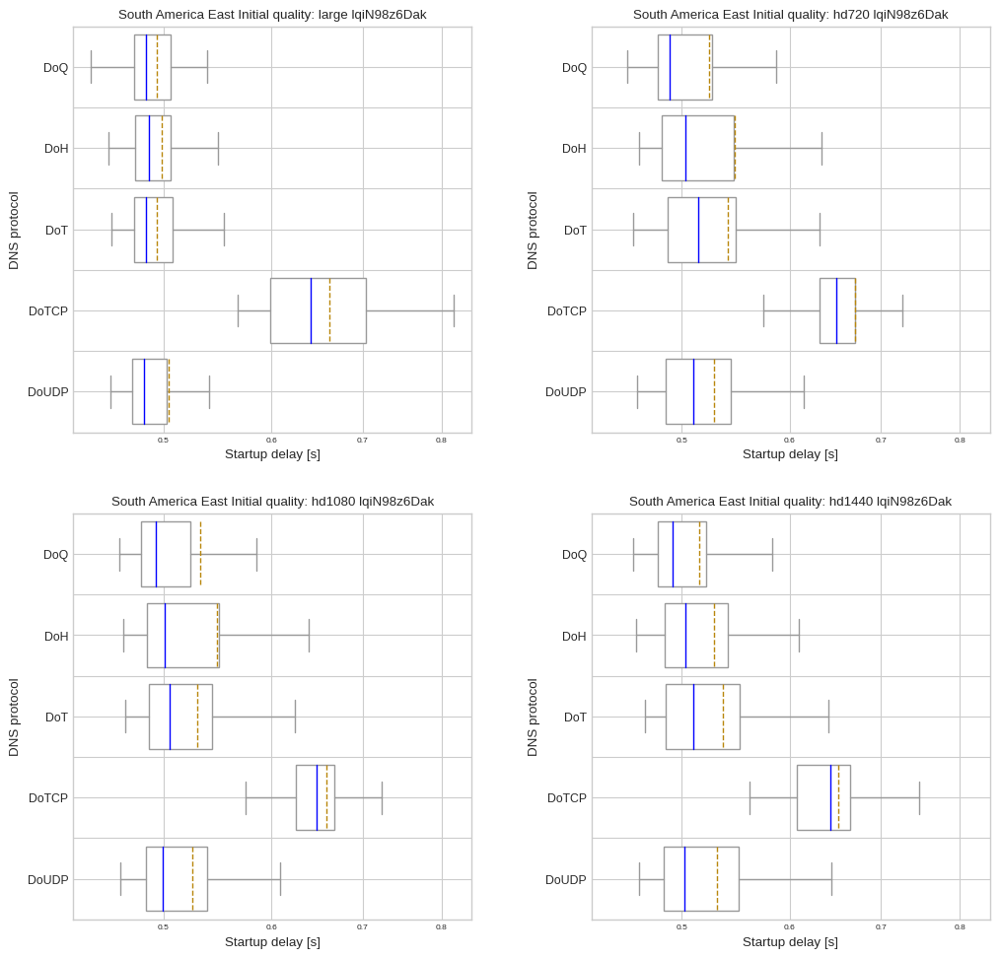

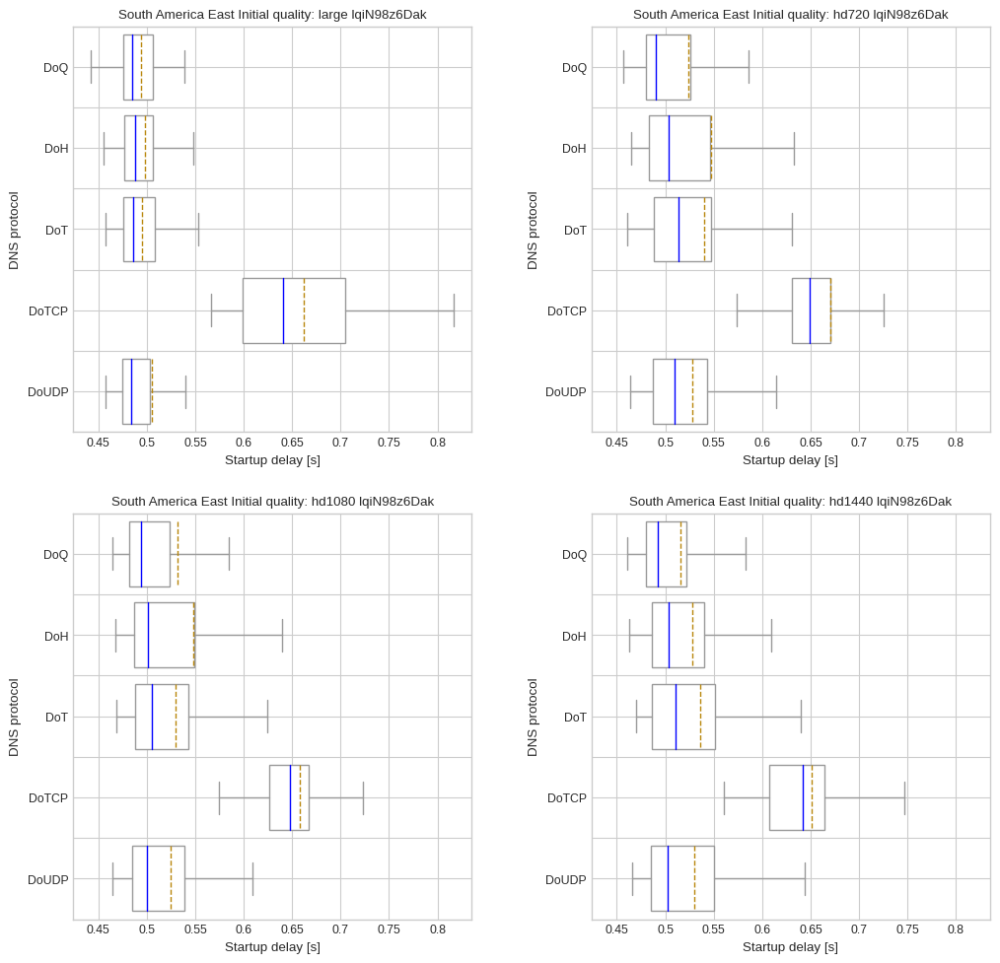

US East


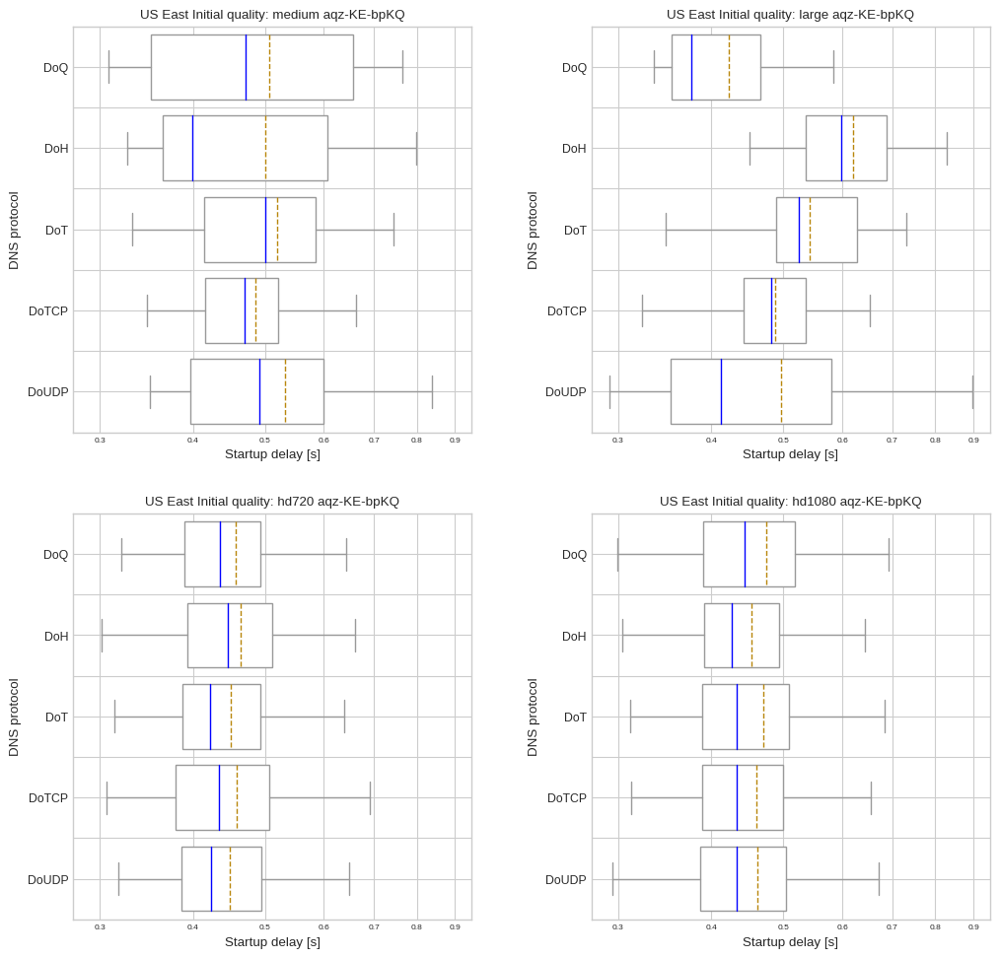

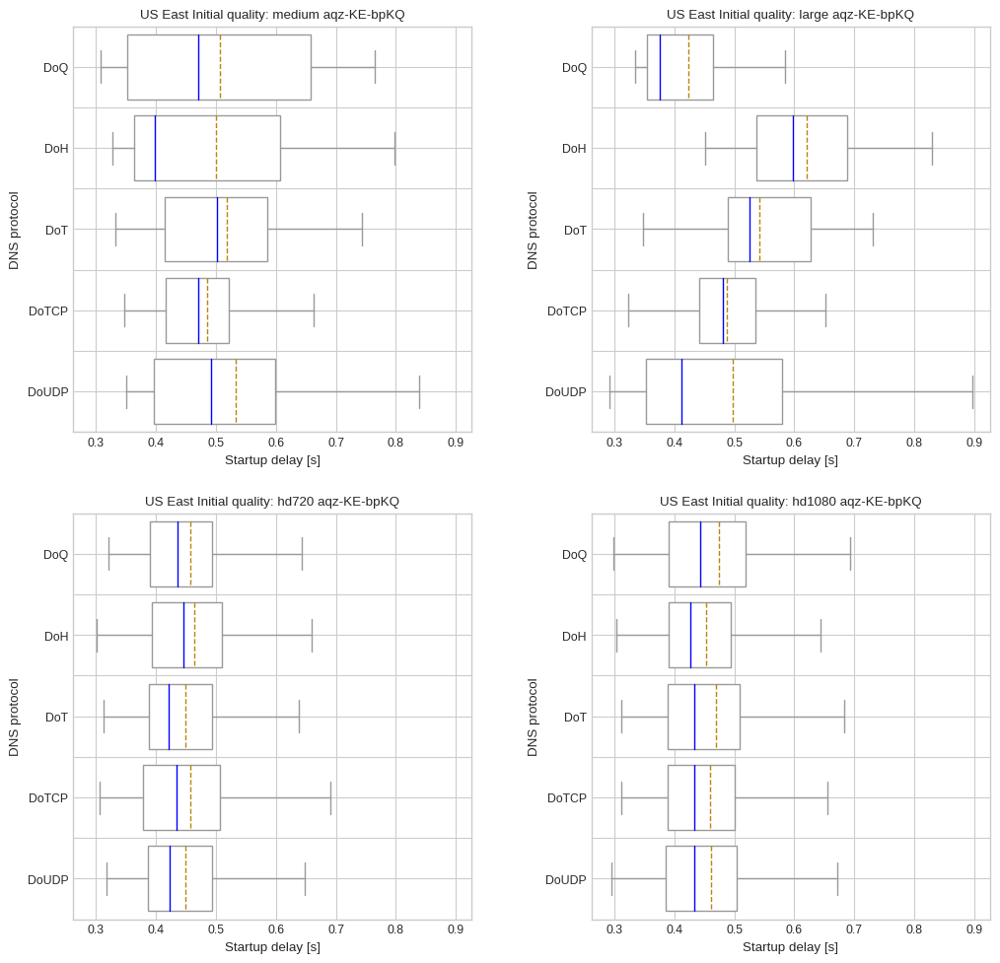

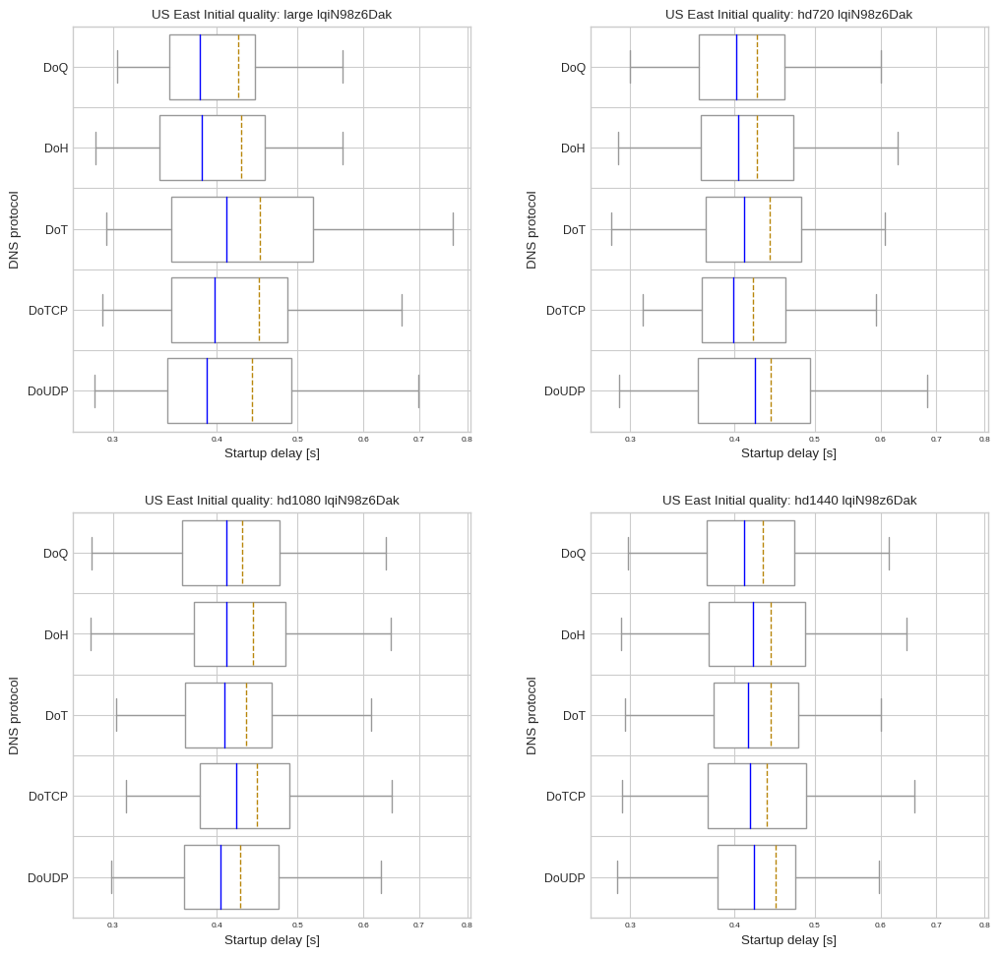

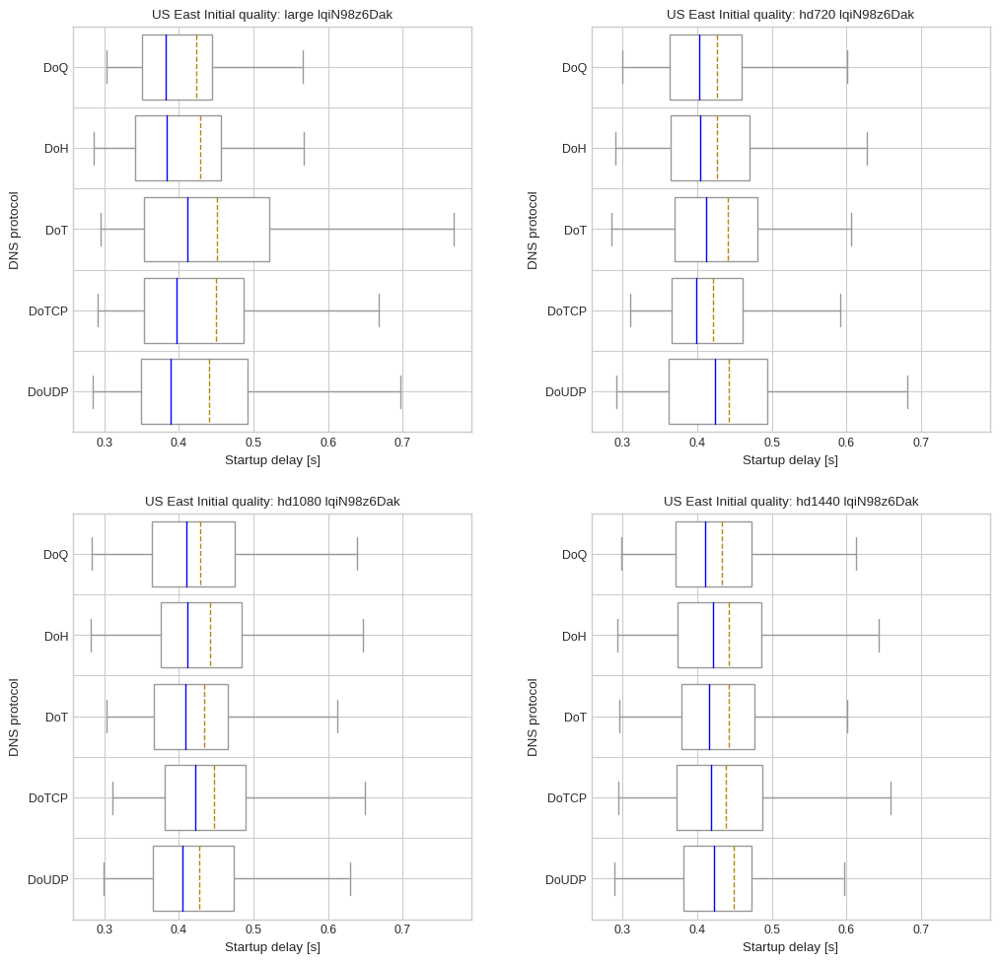

US West


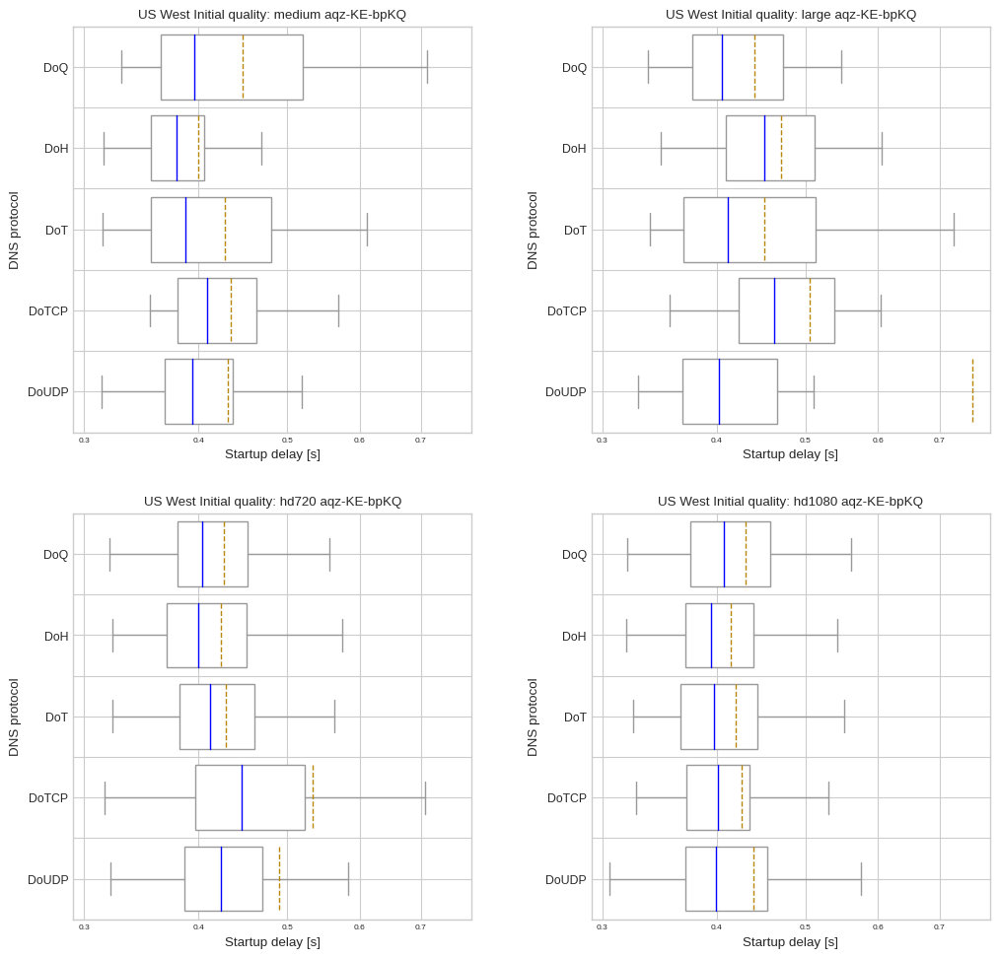

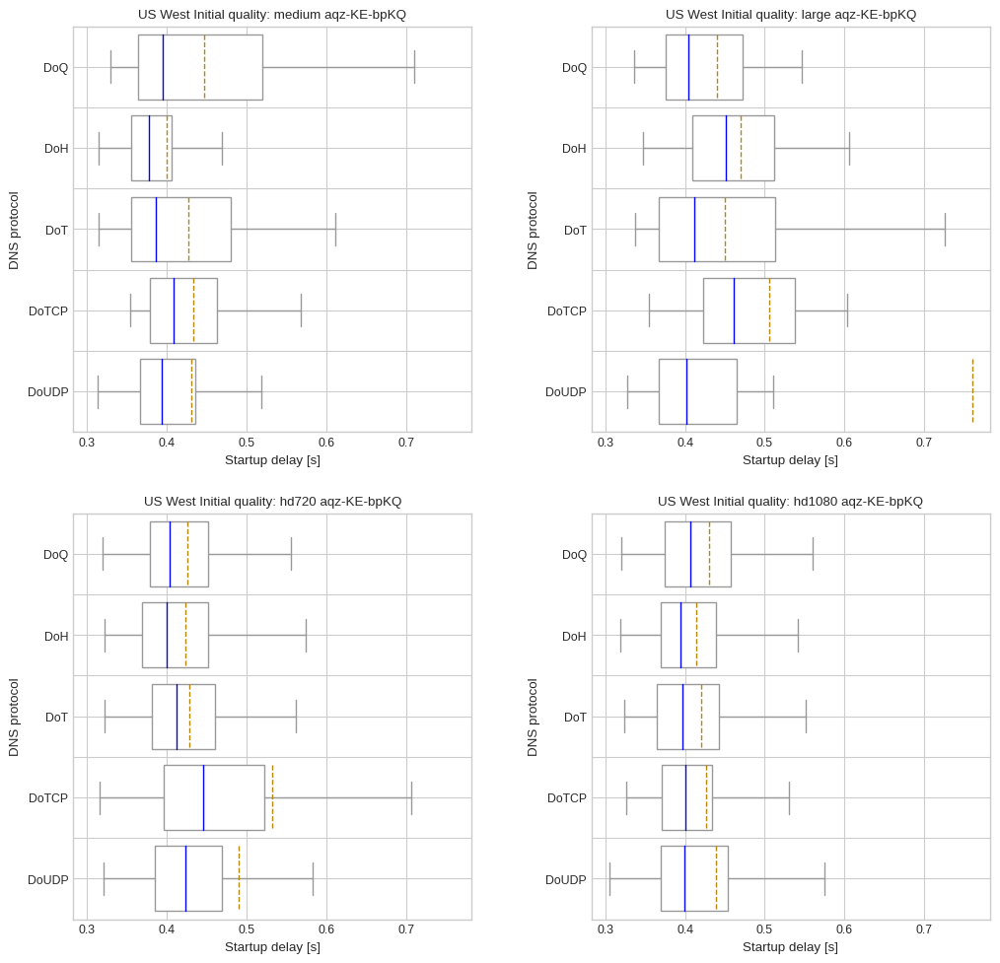

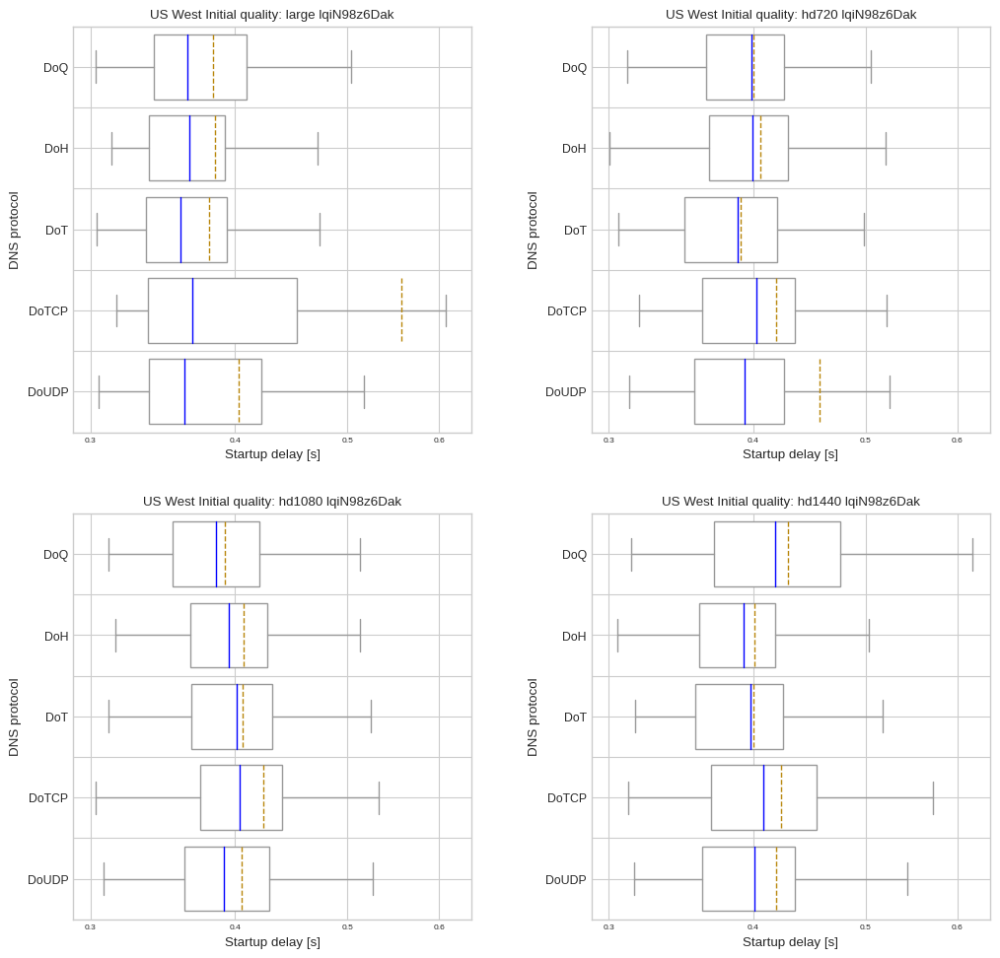

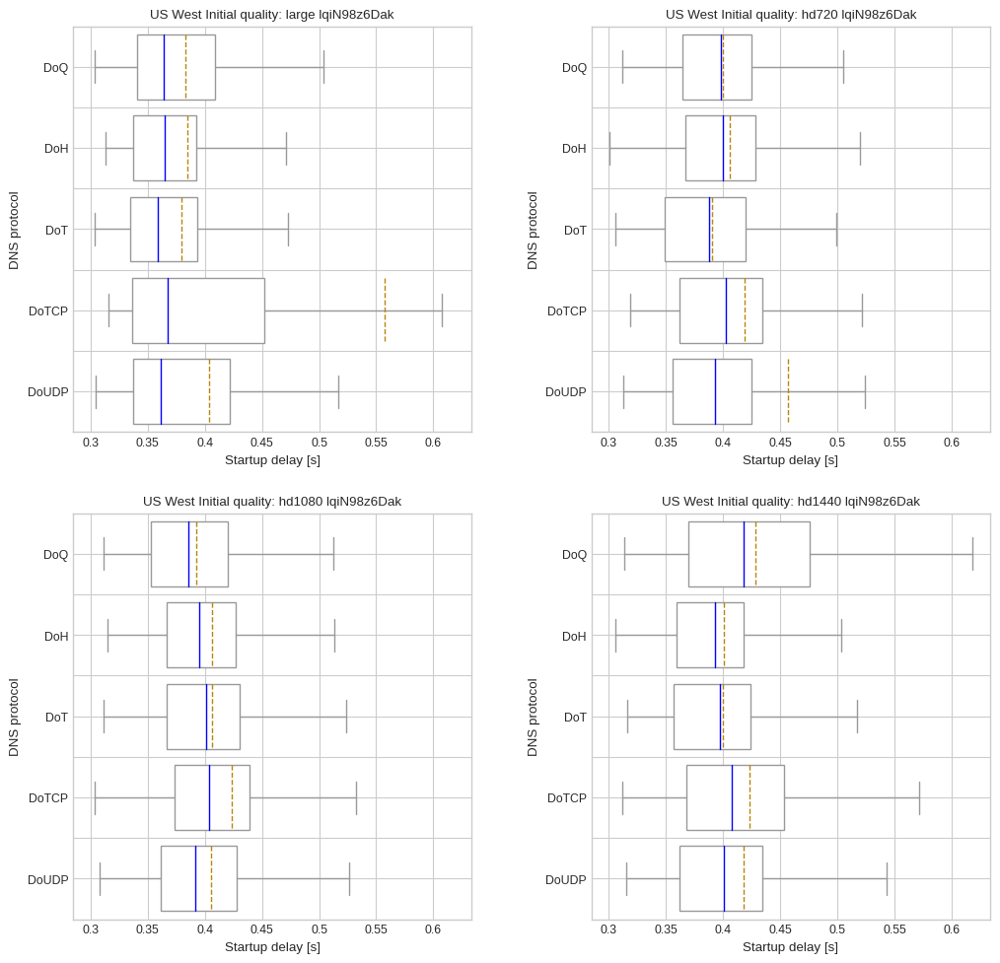

all vantage points


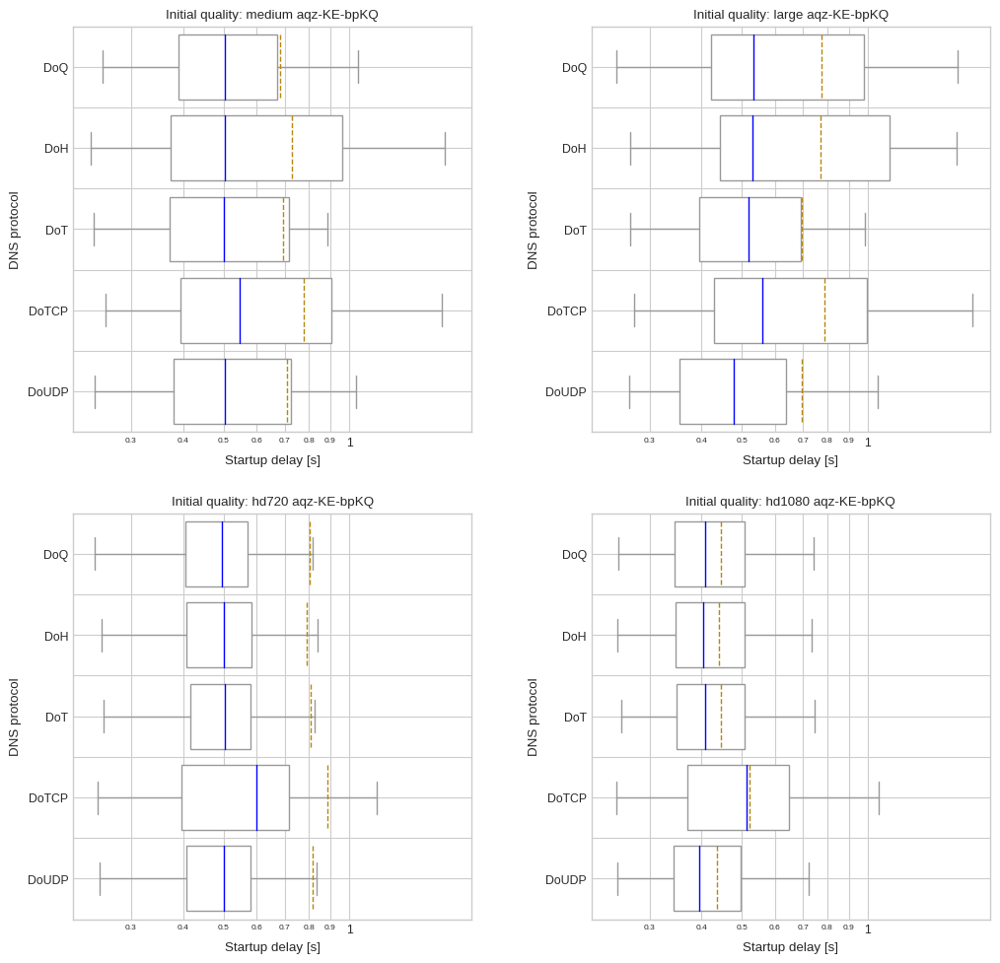

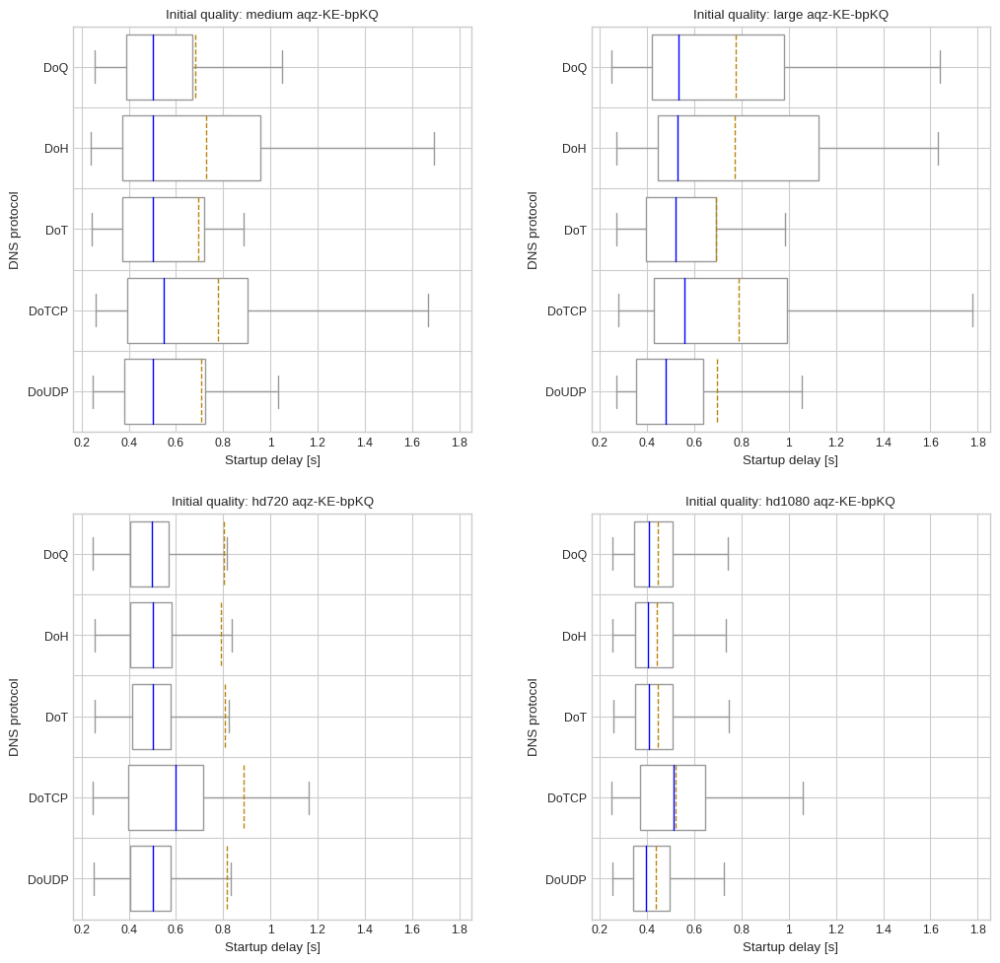

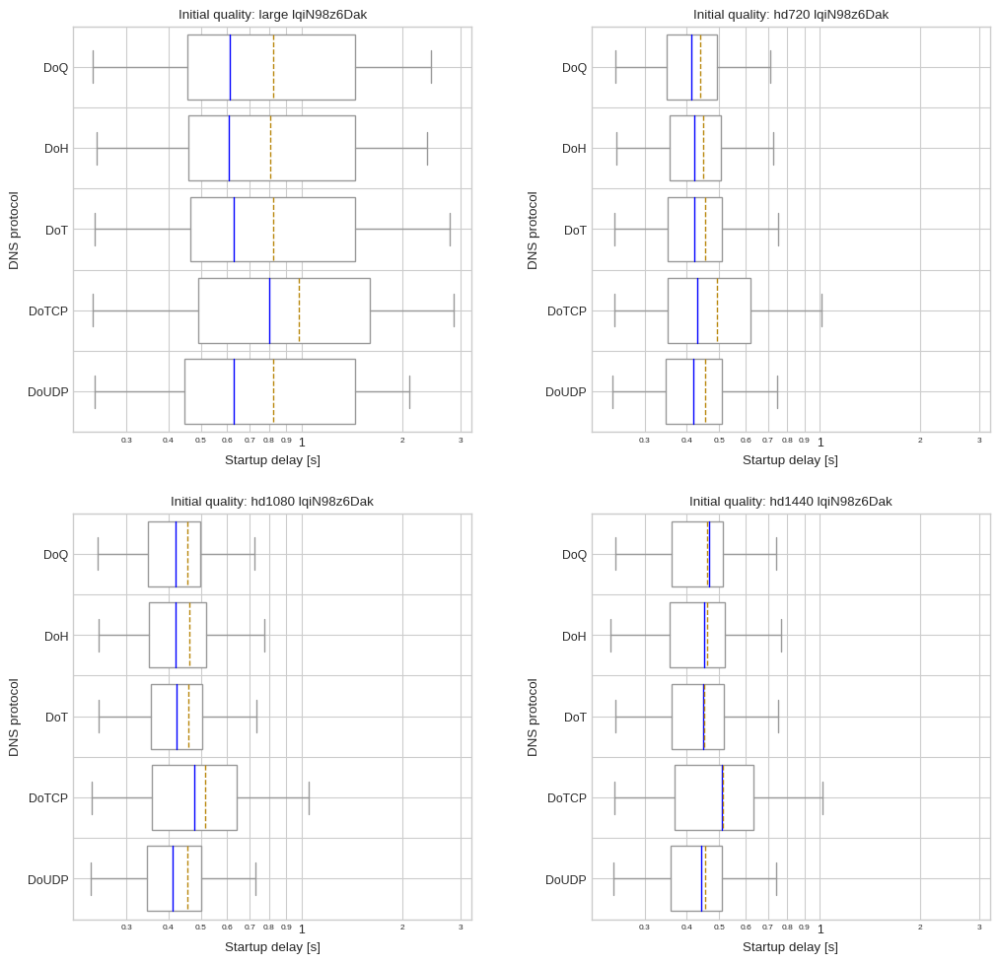

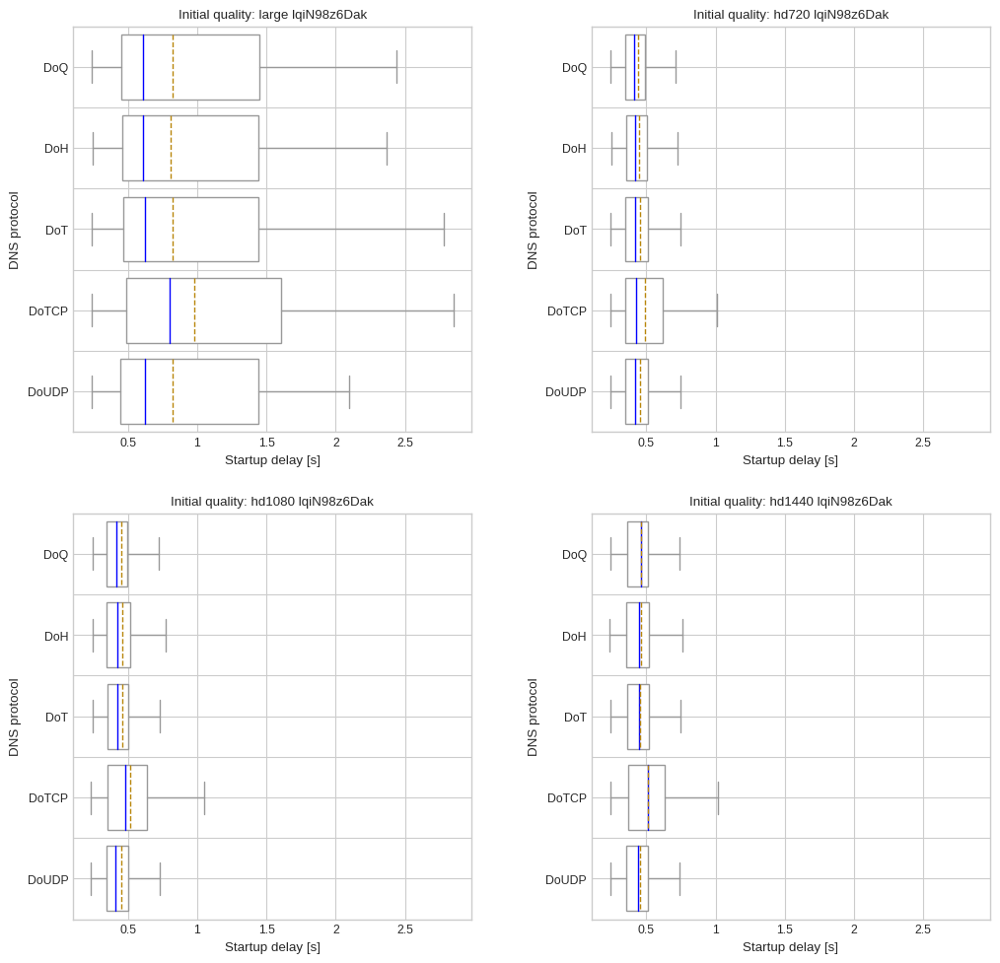

In [548]:
draw_boxplot_grid(df_start_time, 'true_initial_quality', 'protocol', 'startup_delay', [True, False], 'Startup delay [s]', 'Initial quality:', 'startup-delay-by-initial-quality-and-proto', [0,0], "DNS protocol", draw_all=True)

In [ ]:
draw_boxplot(df_start_time, 'true_initial_quality', 'protocol', 'startup_delay', [False], 'Startup delay [s]', 'Initial quality:', 'startup-delay-by-initial-quality-and-proto', [0,0], "DNS protocol")


Africa South


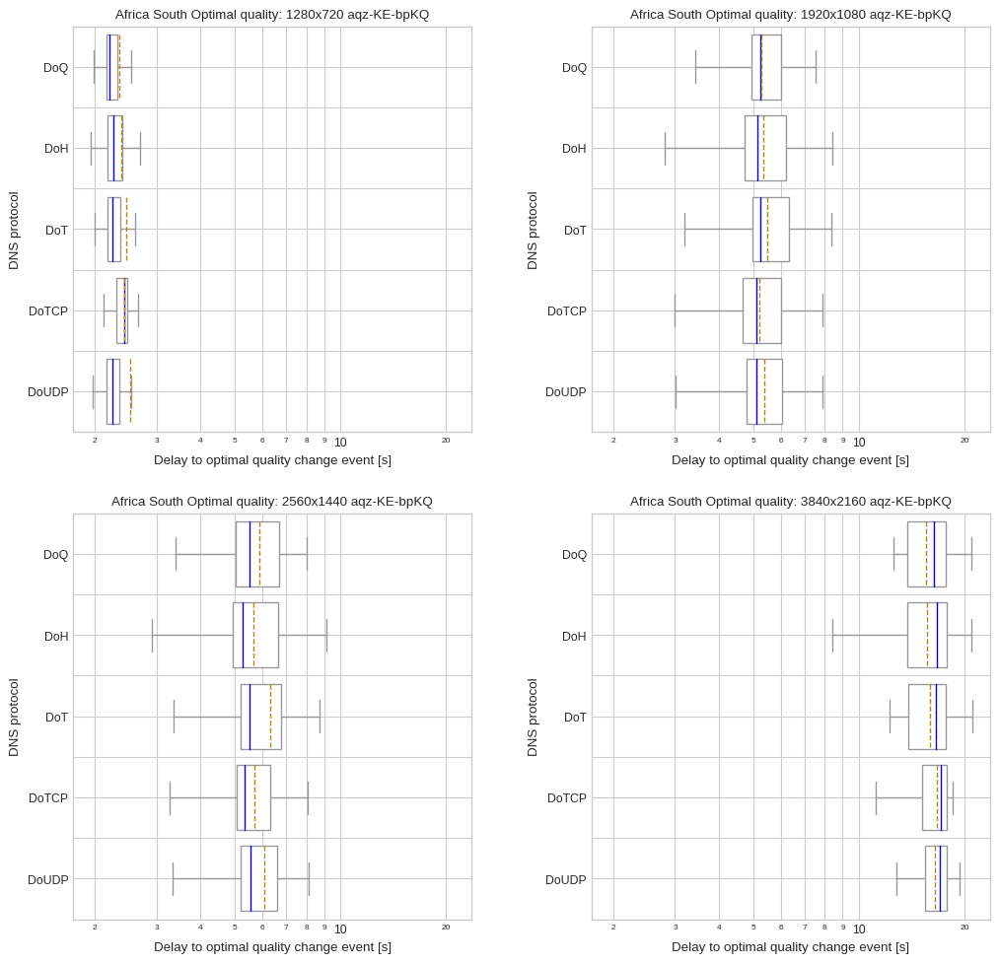

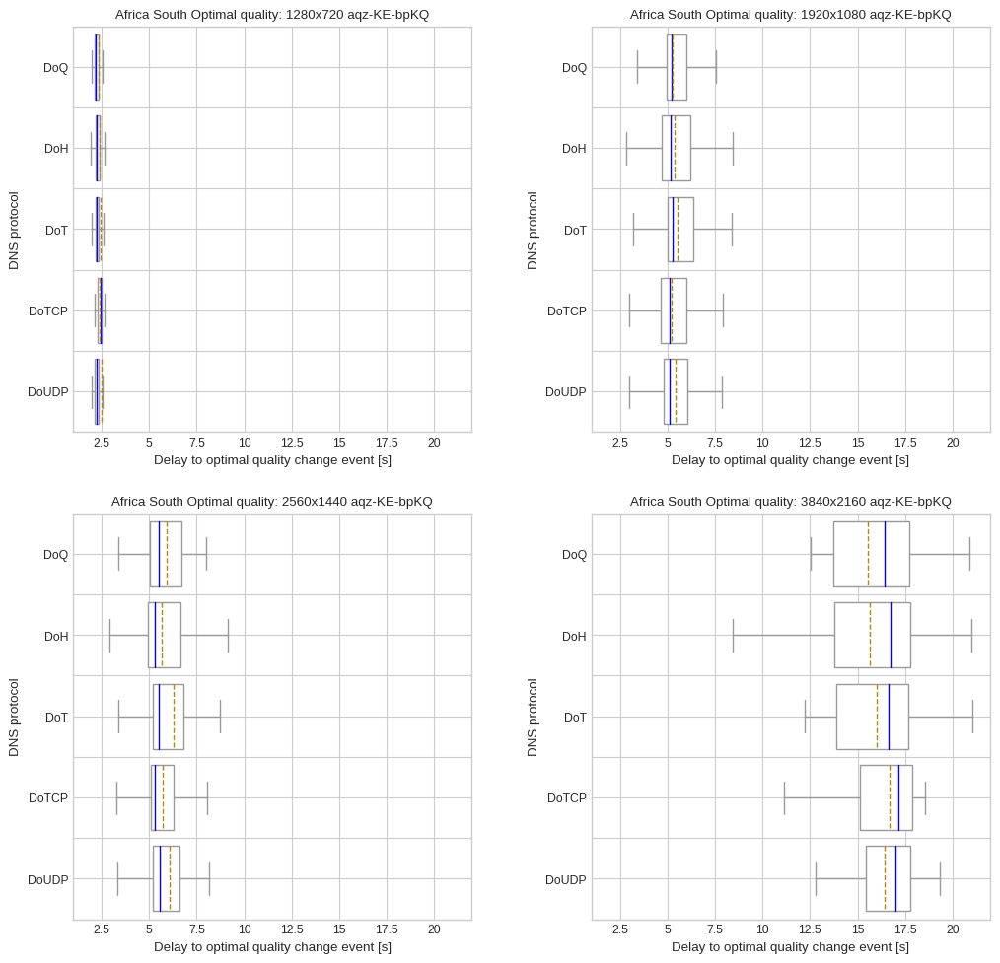

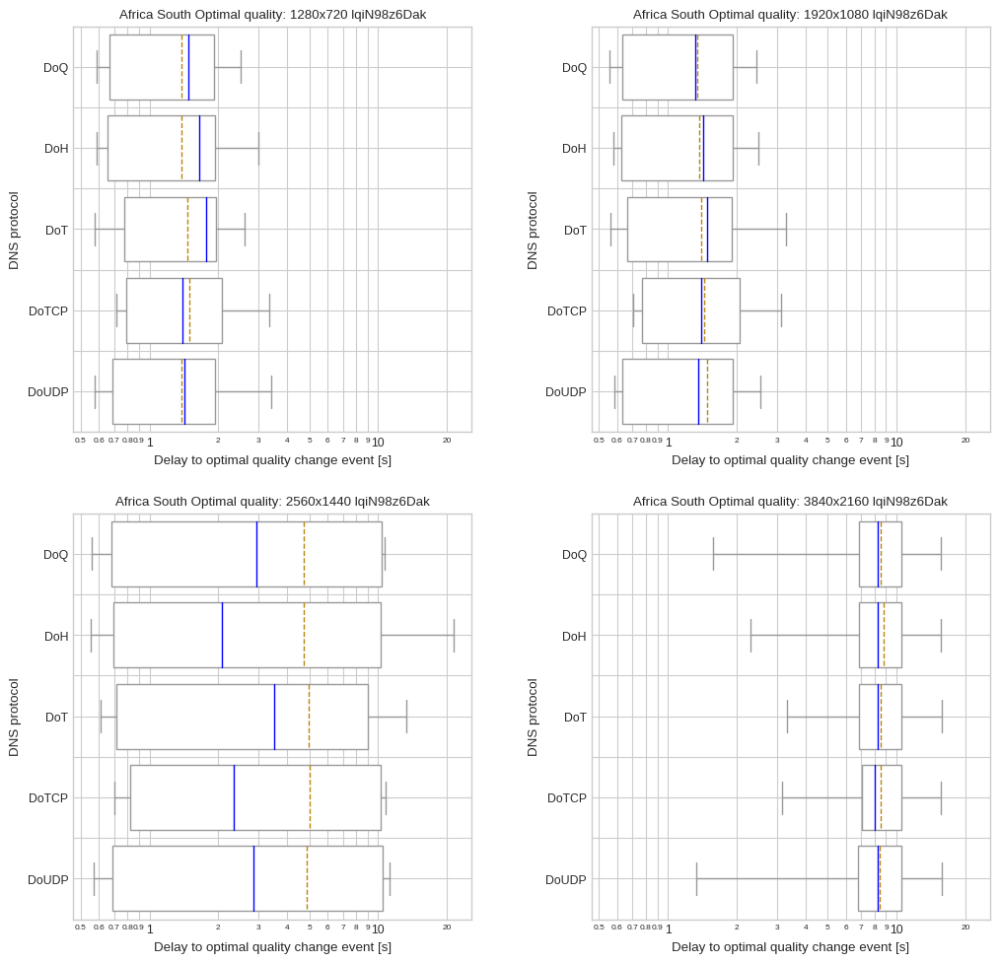

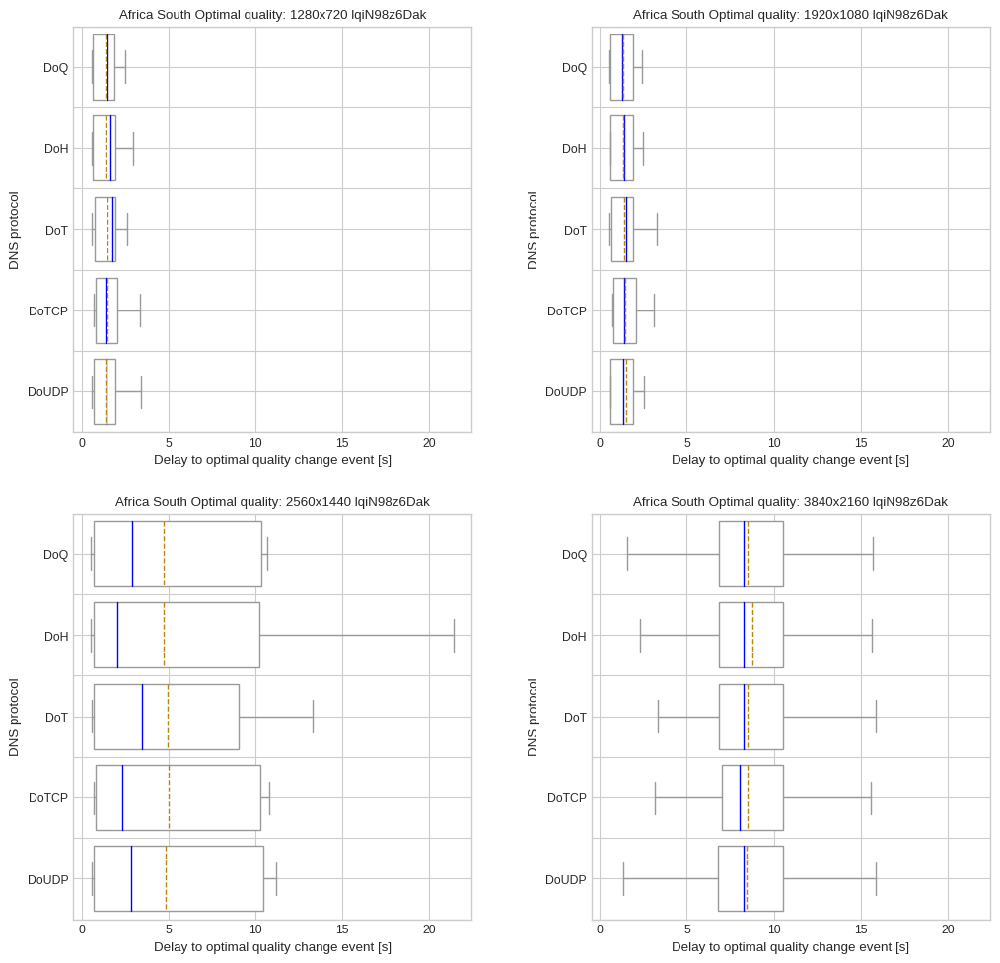

Asia Pacific Northeast


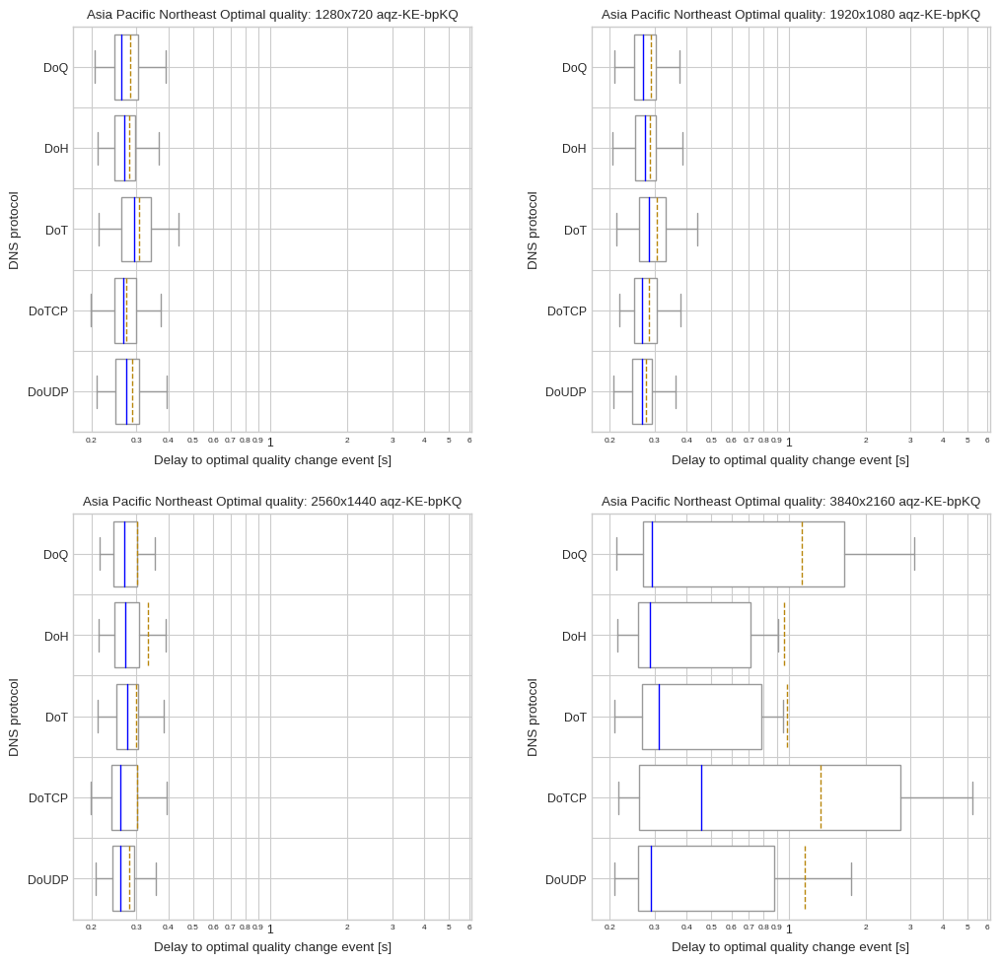

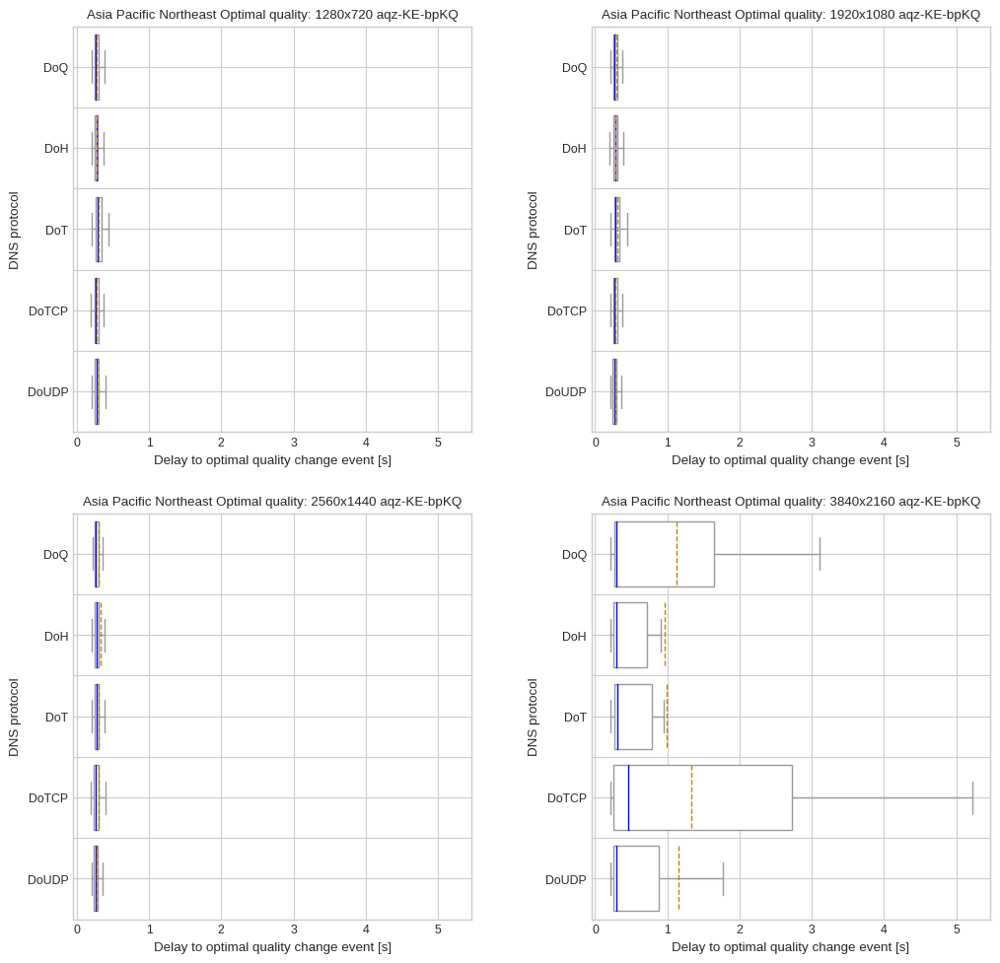

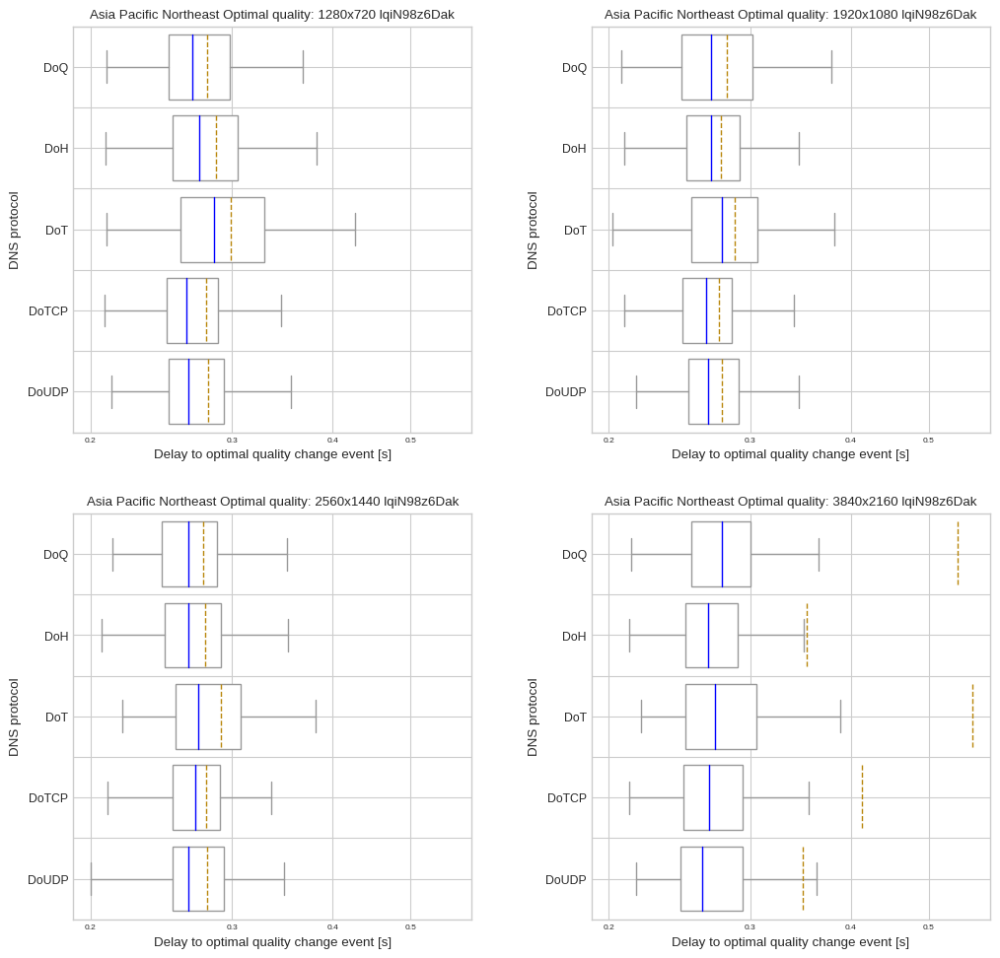

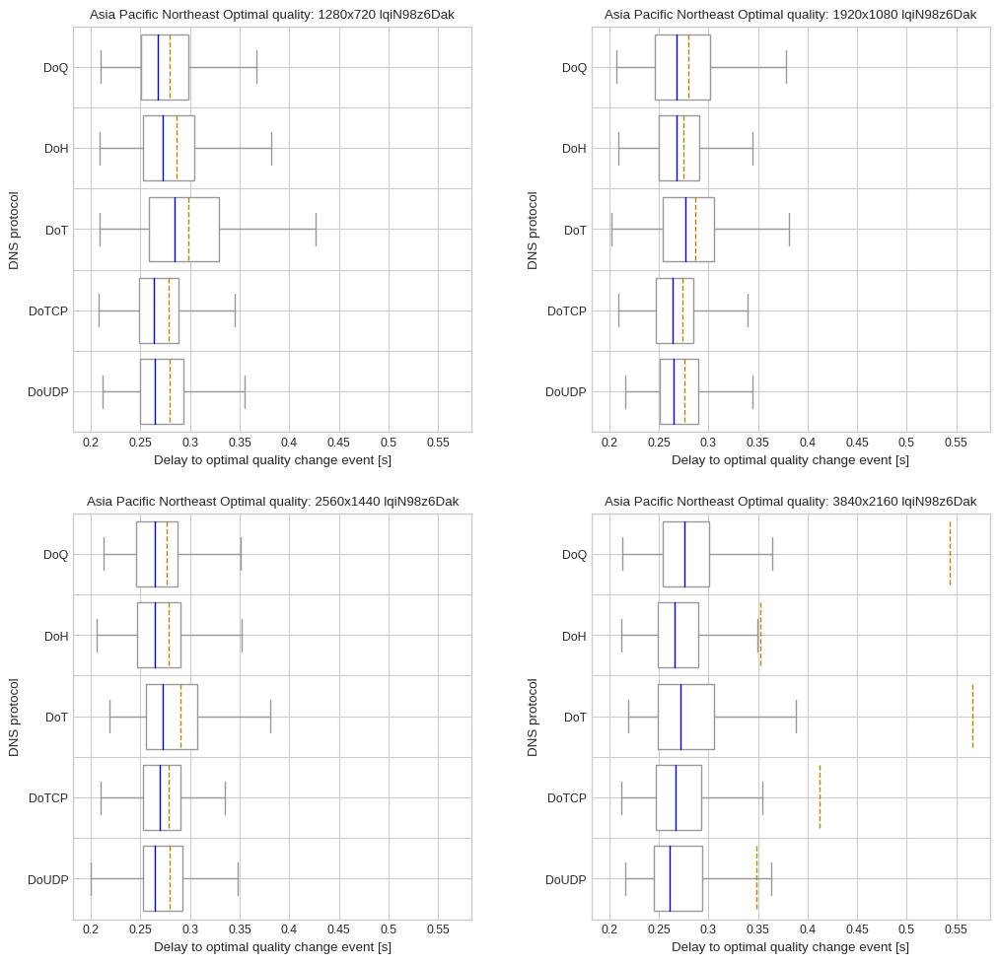

Asia Pacific Southeast


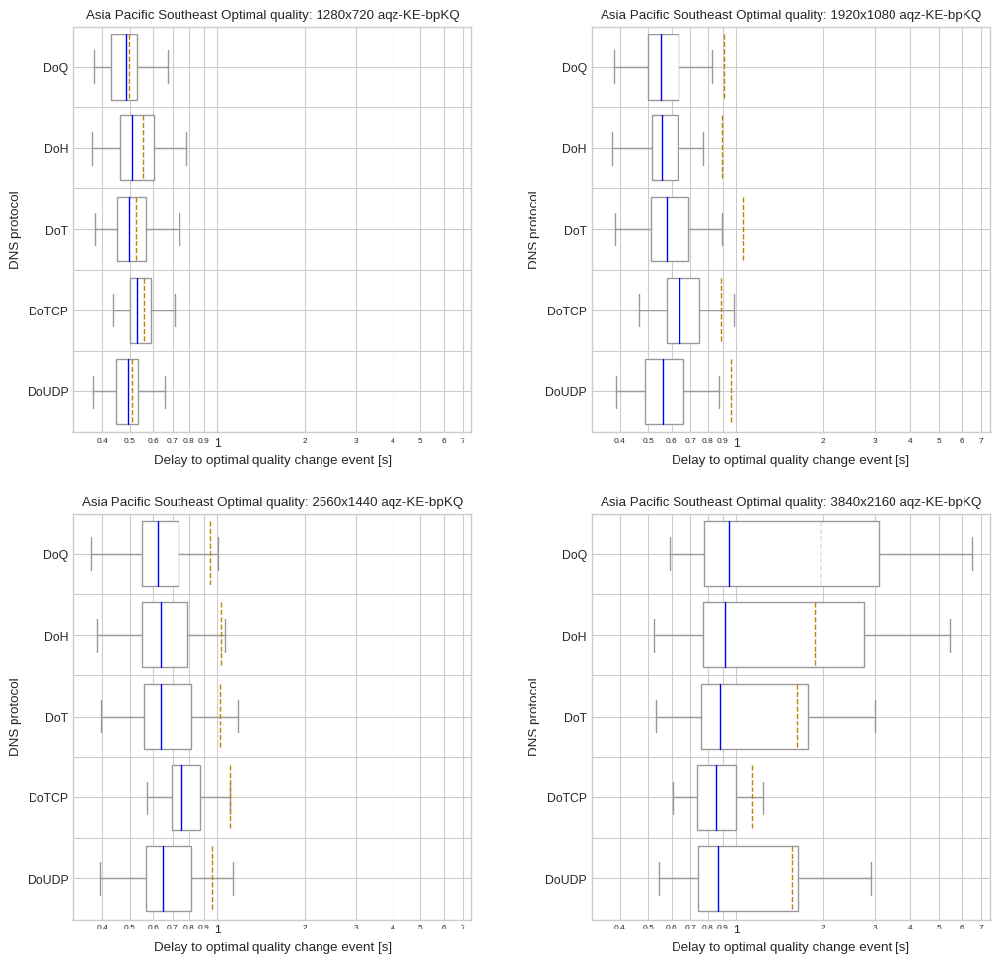

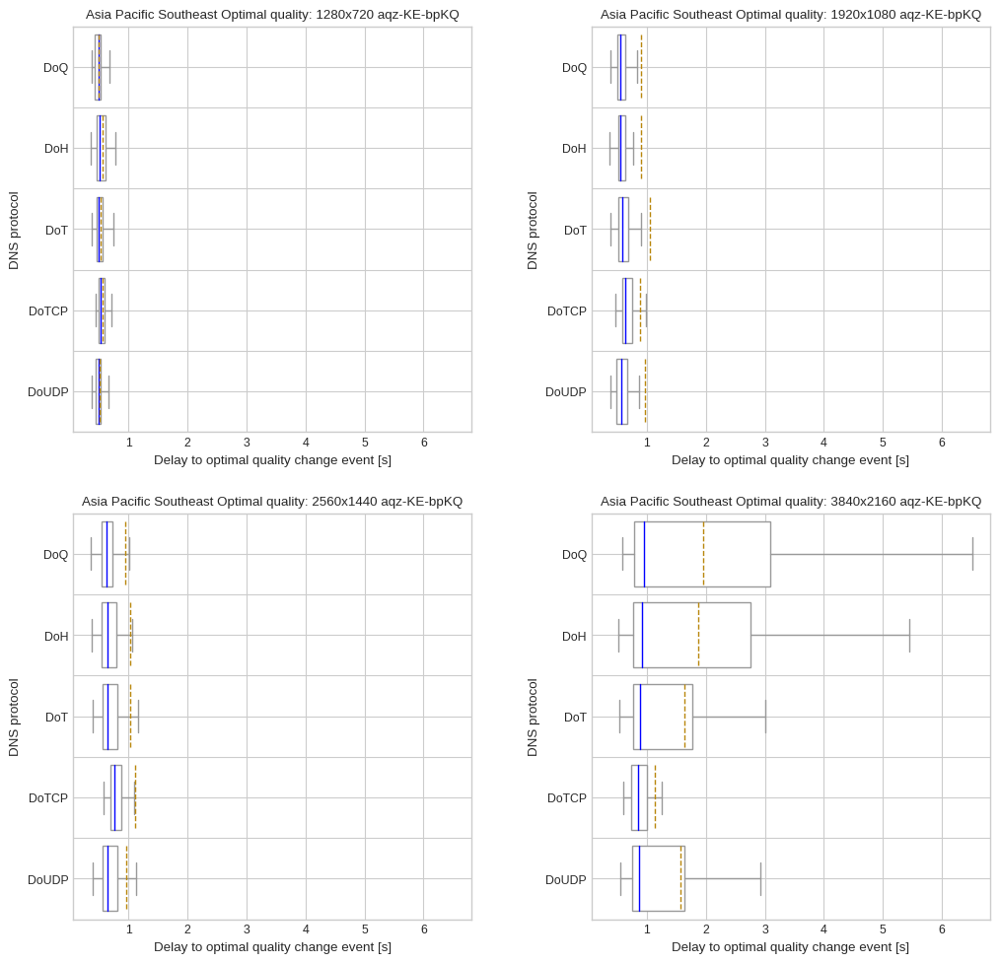

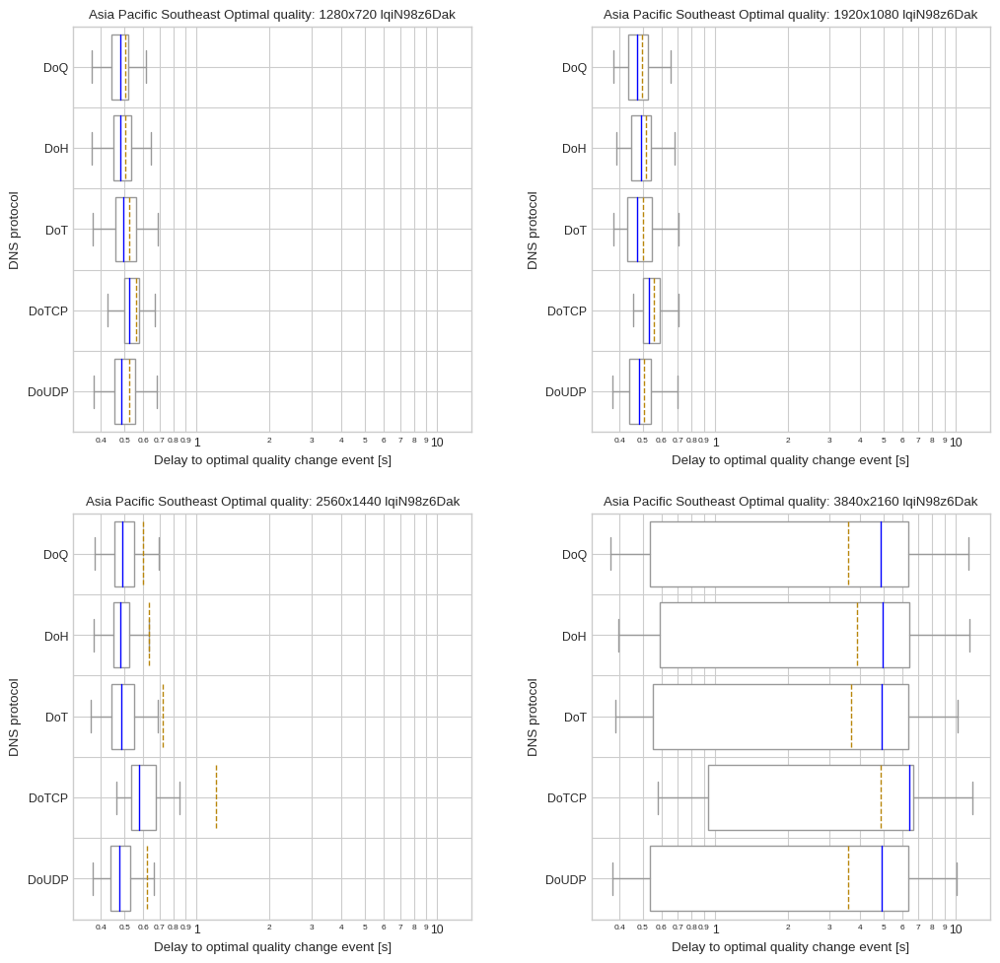

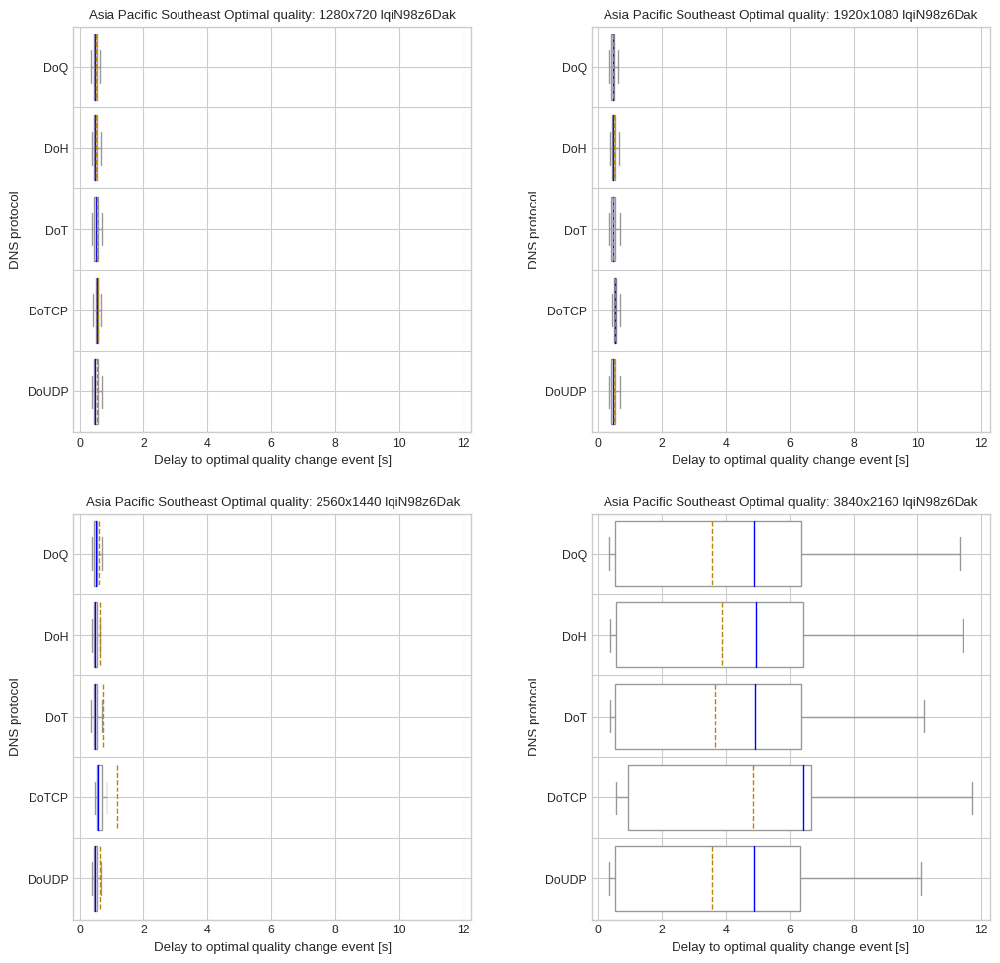

Europe Central


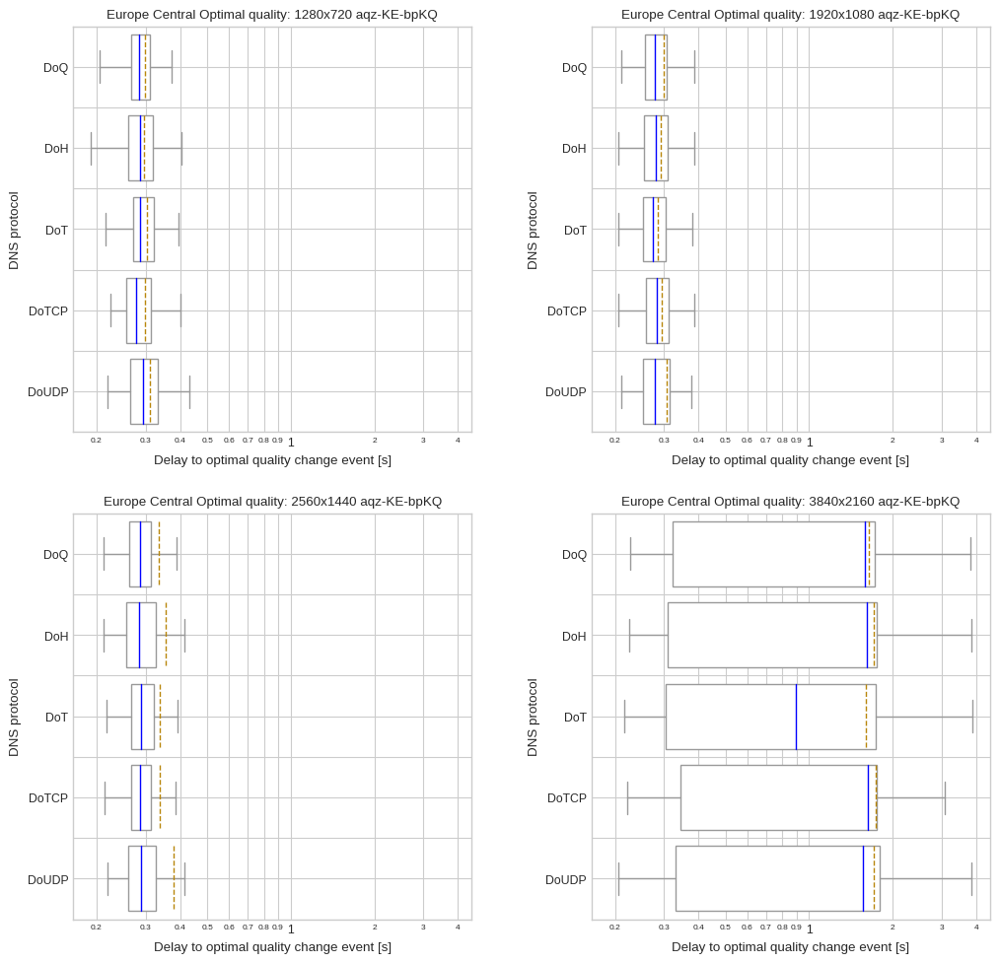

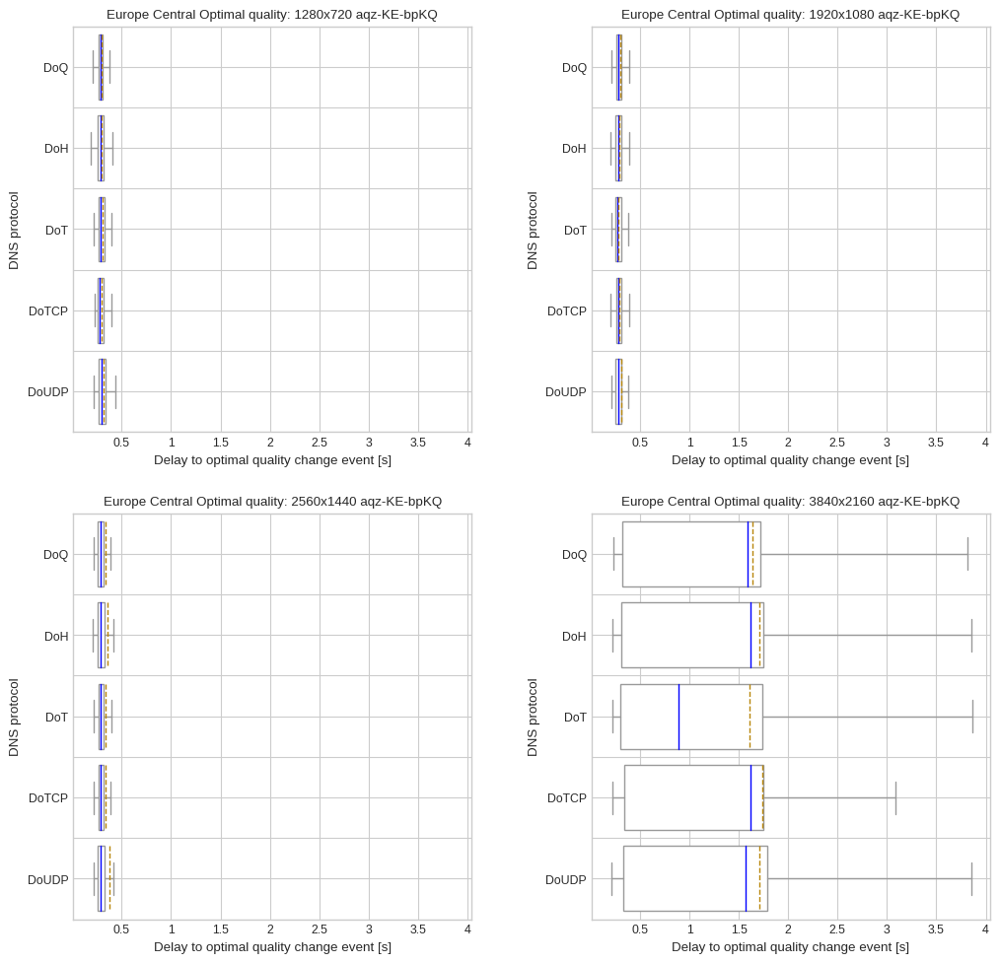

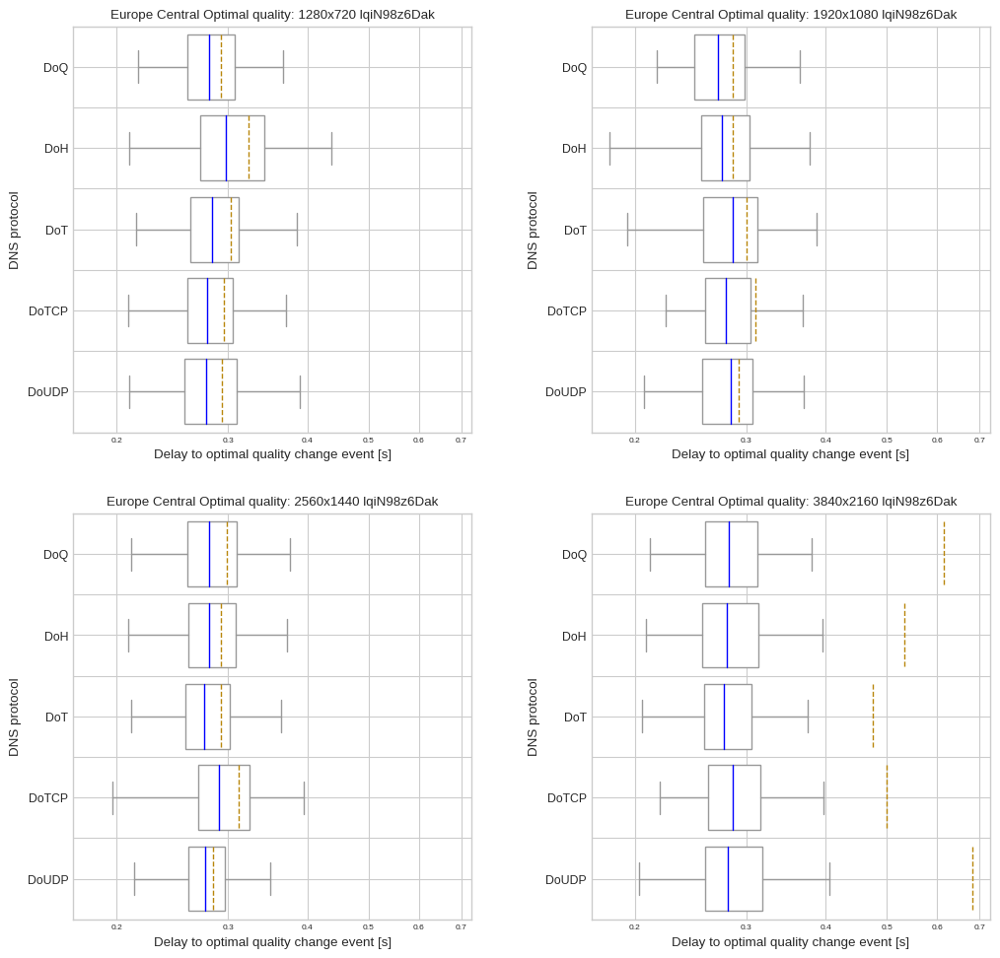

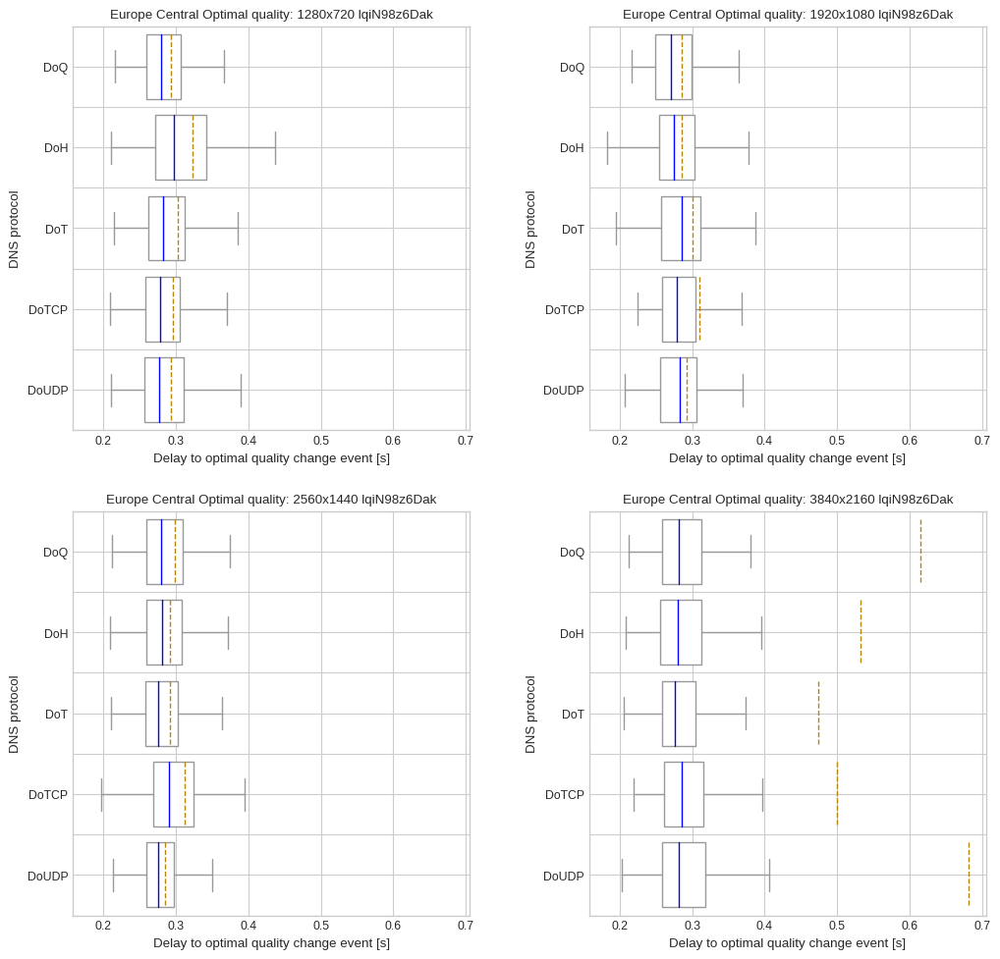

South America East


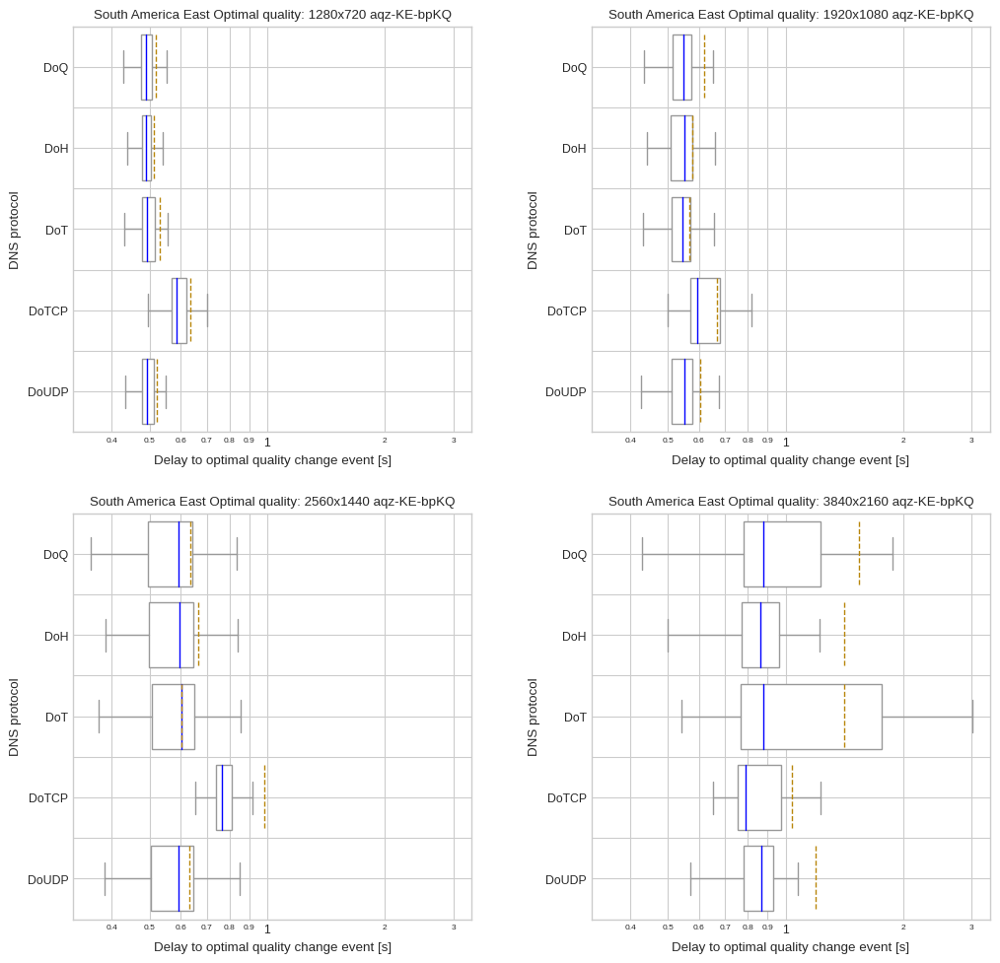

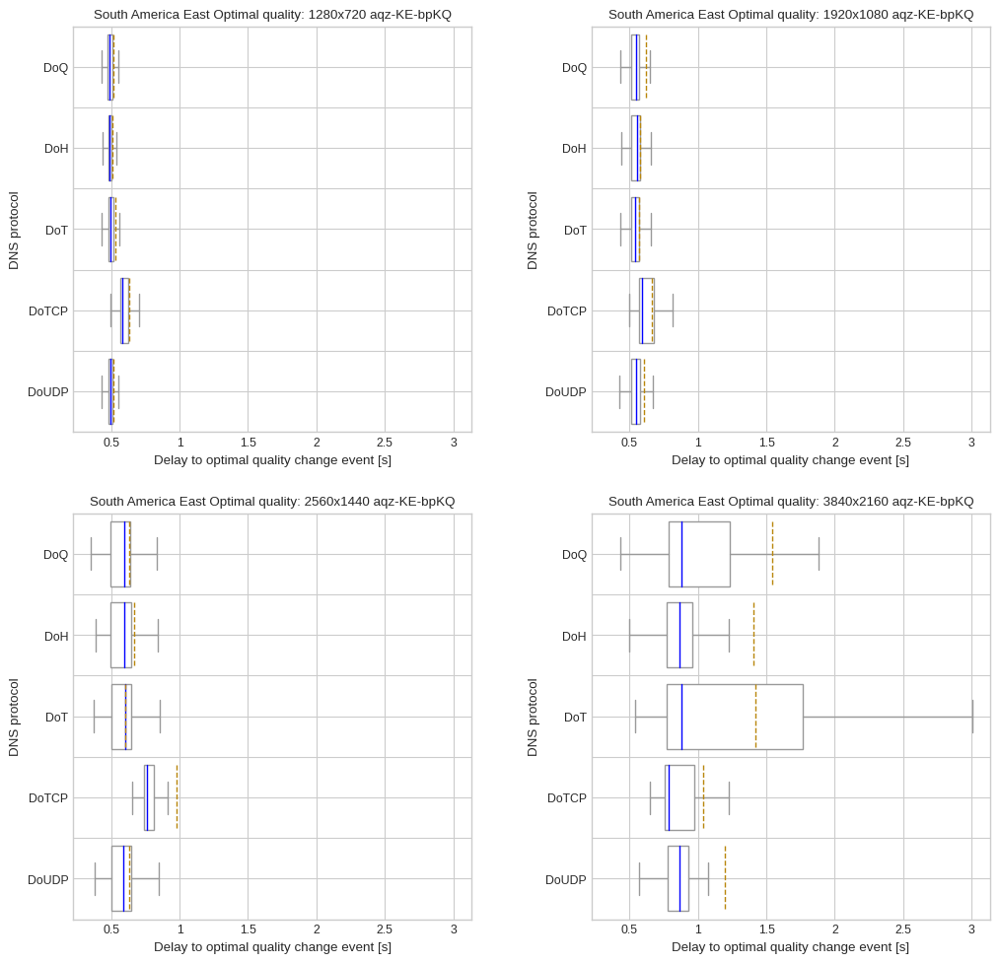

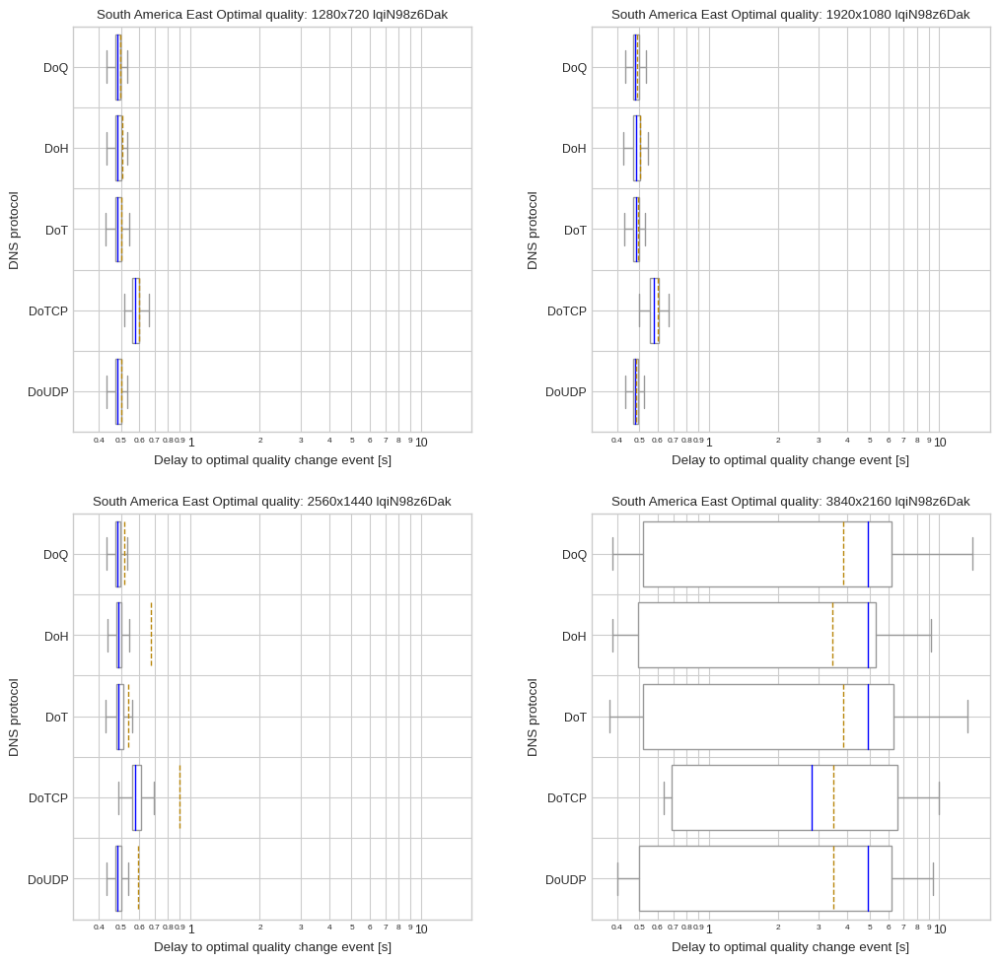

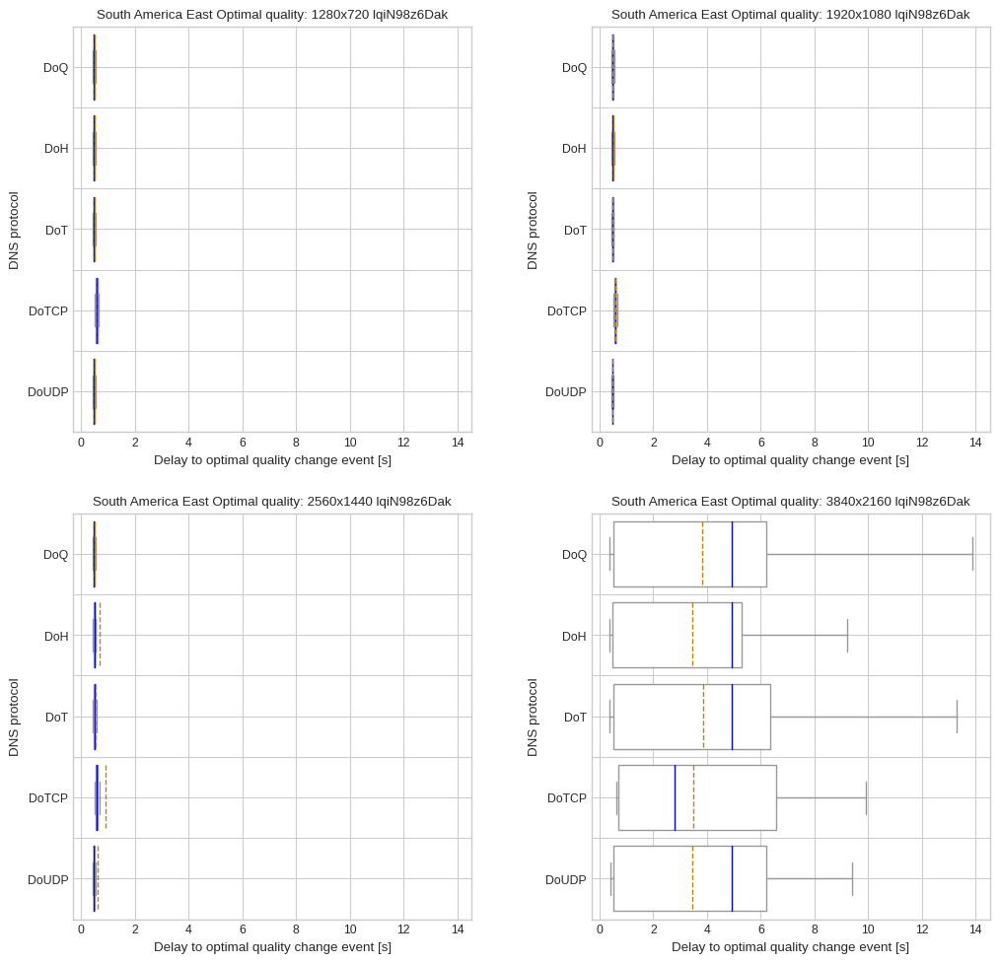

US East


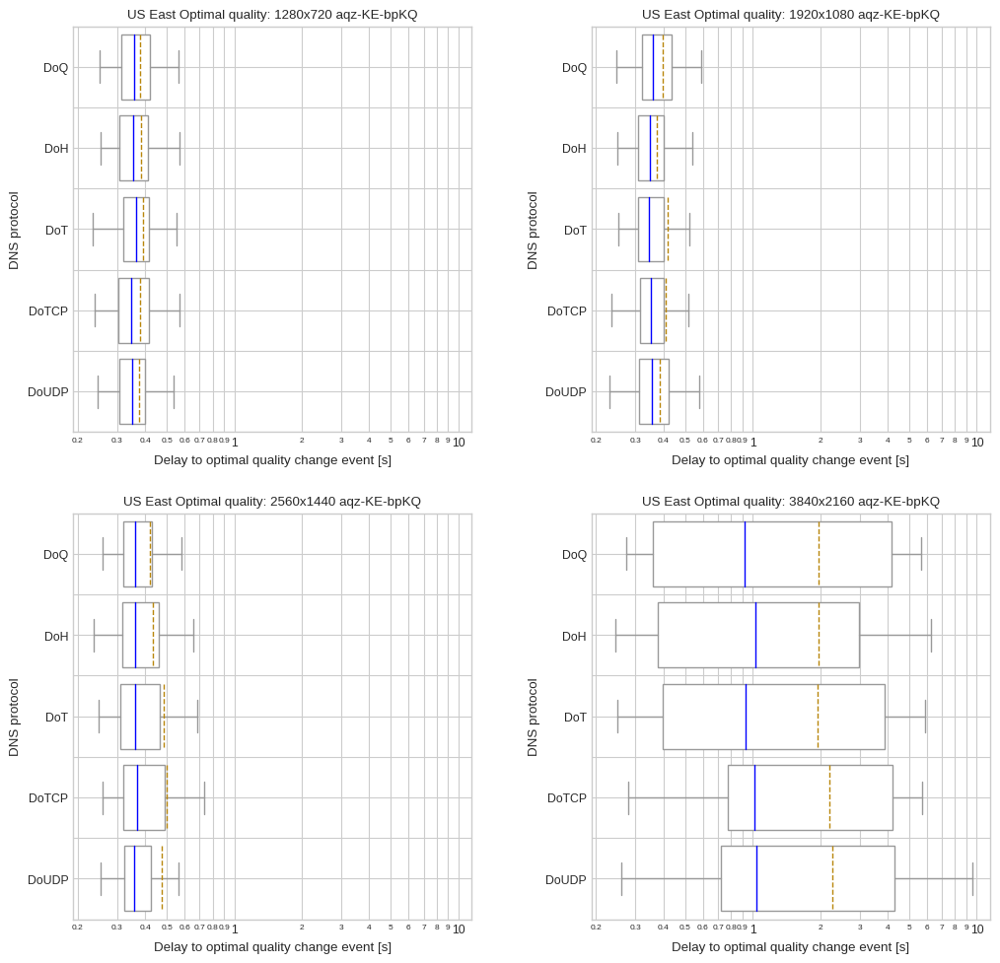

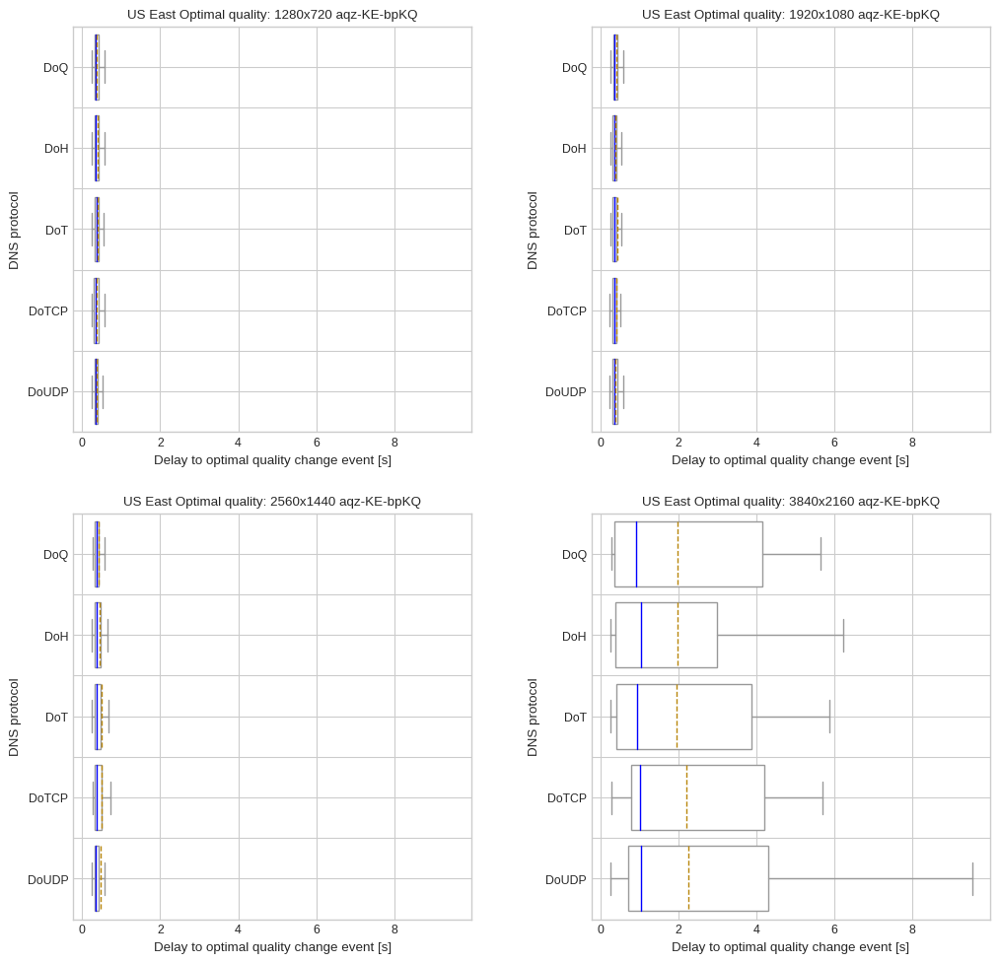

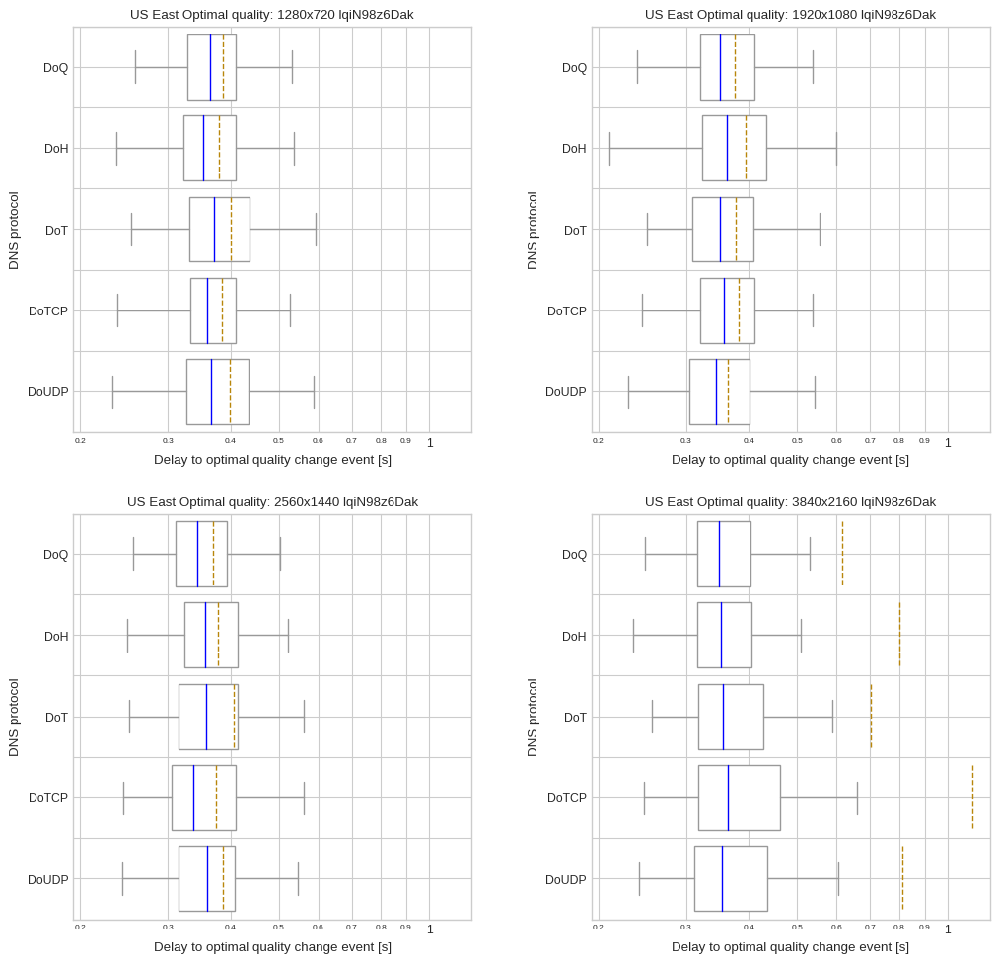

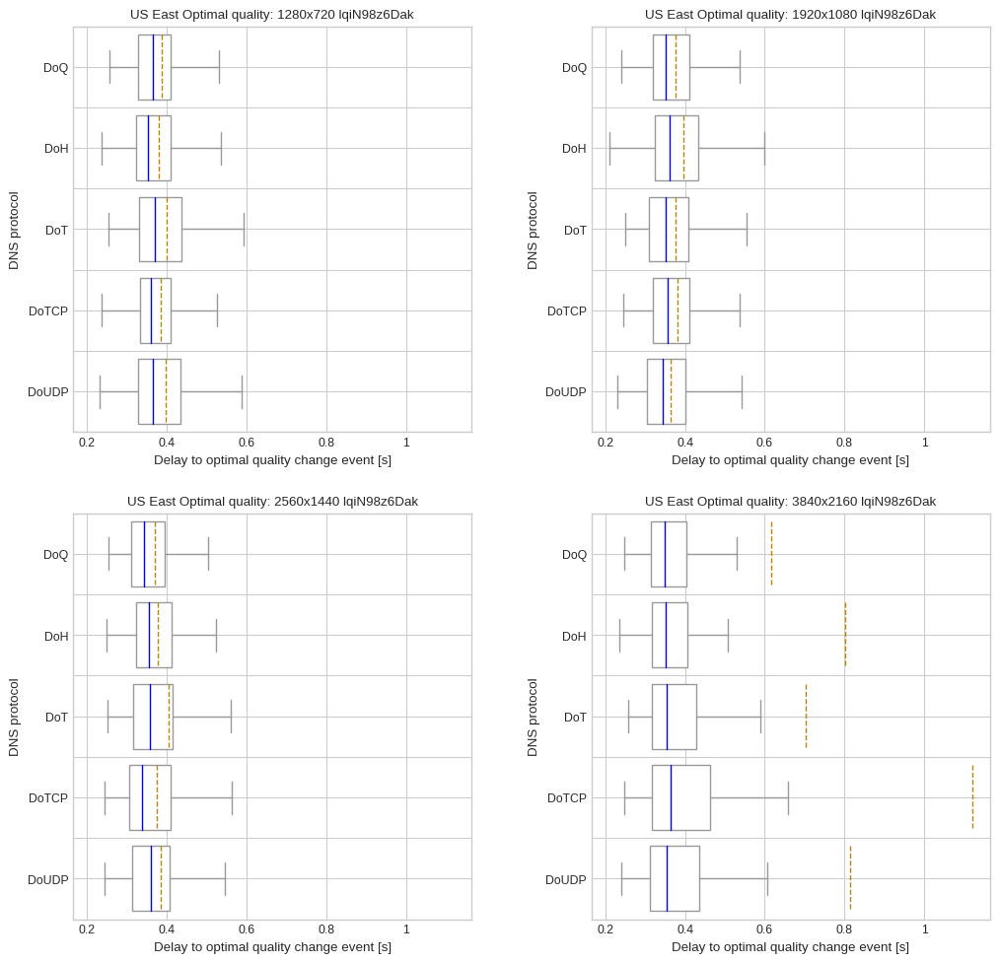

US West


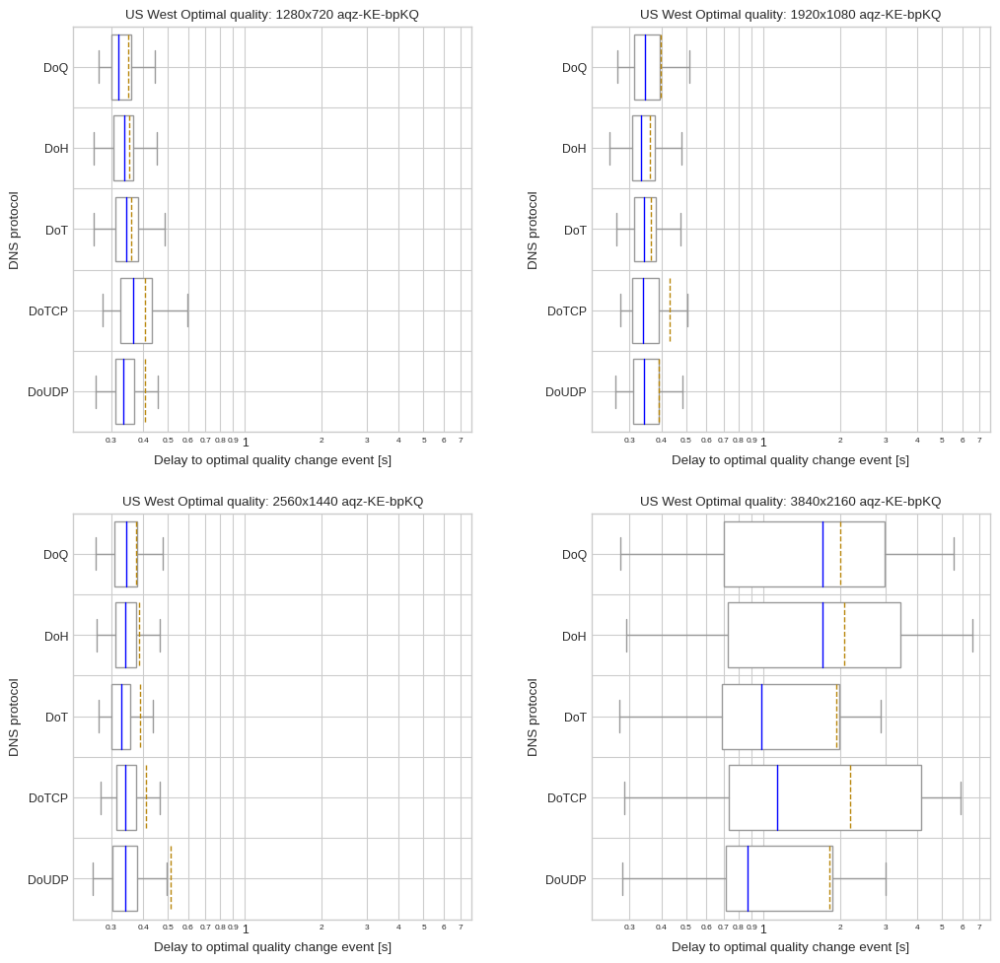

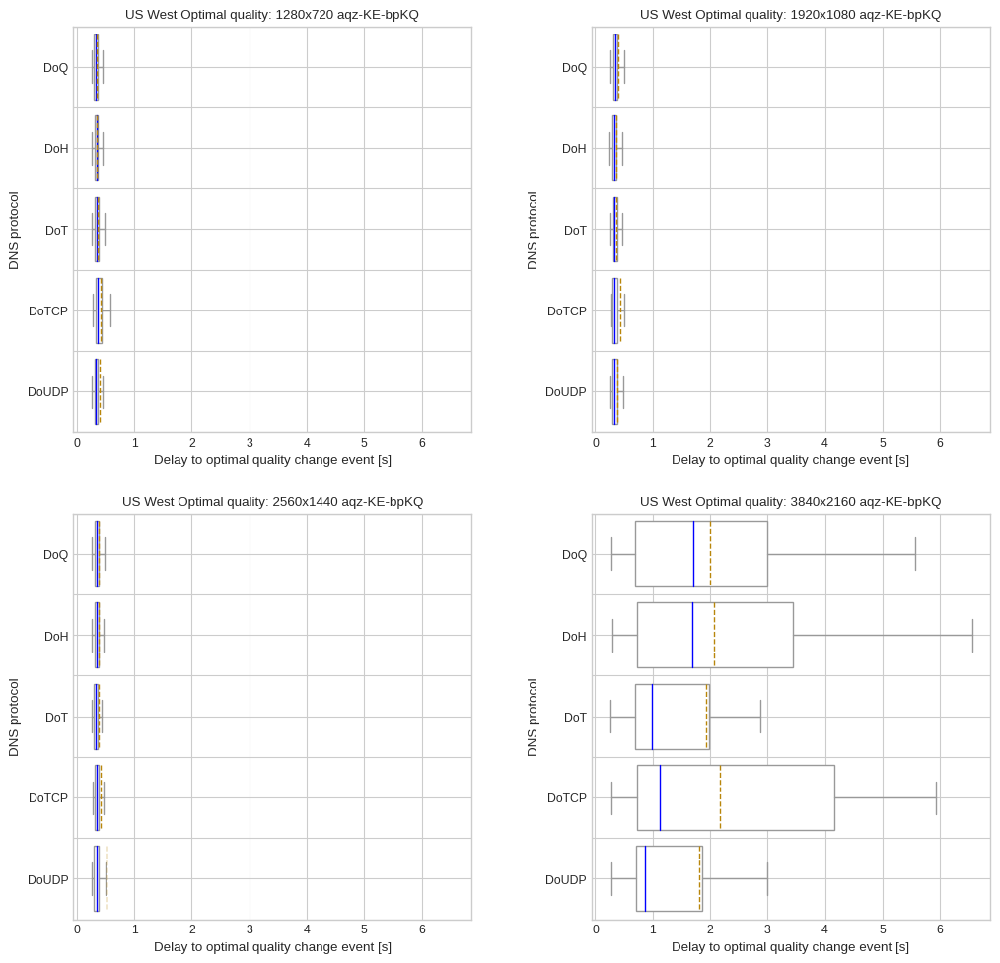

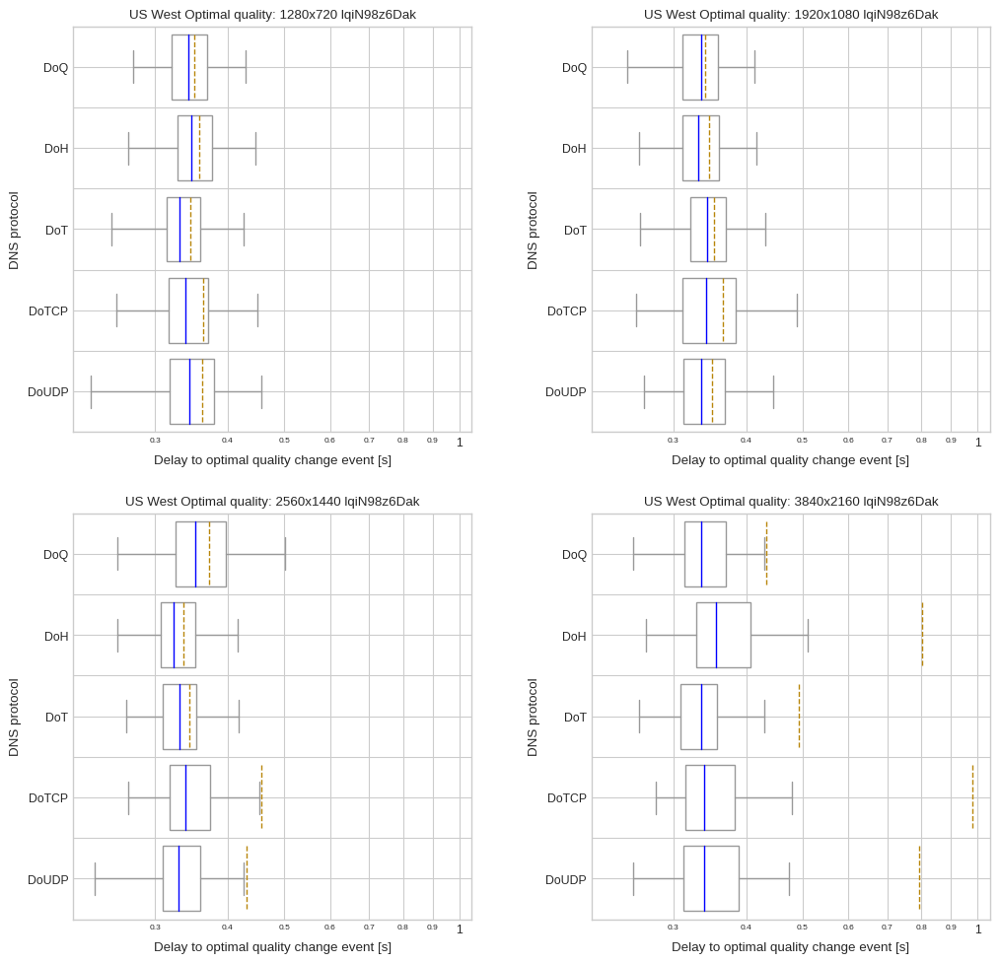

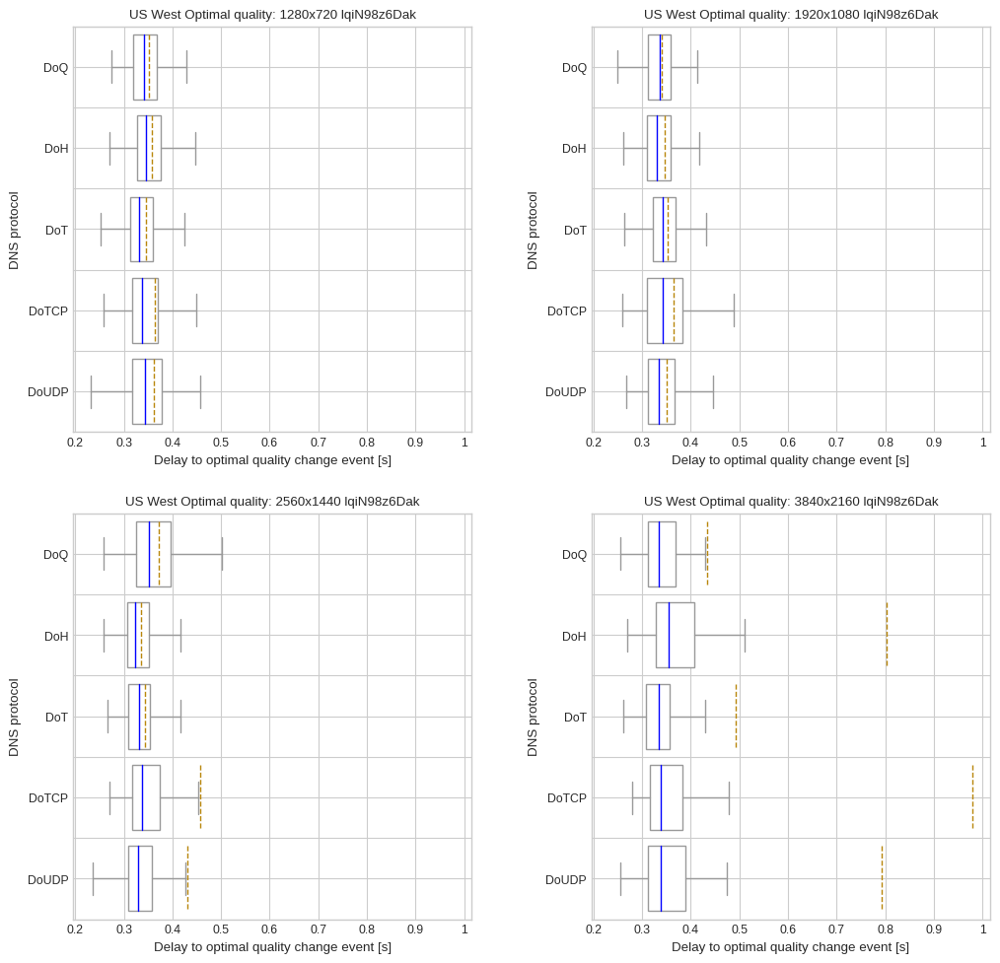

all vantage points


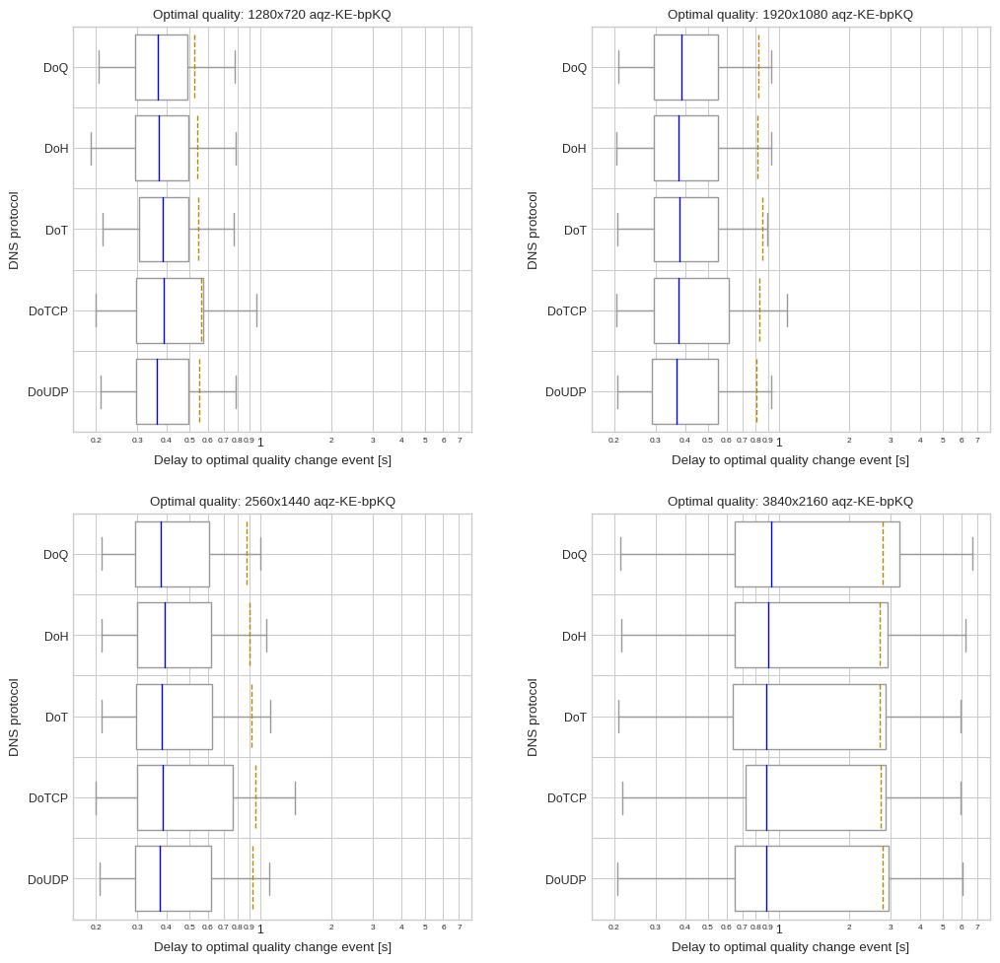

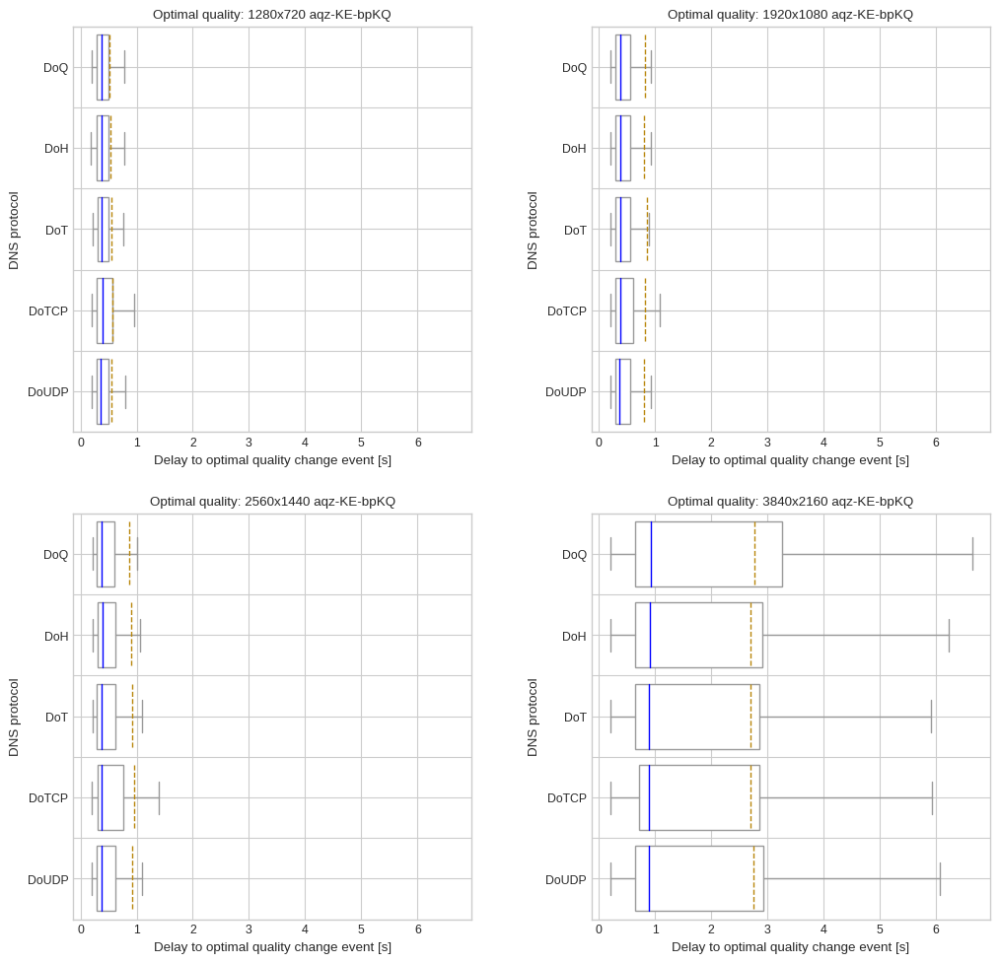

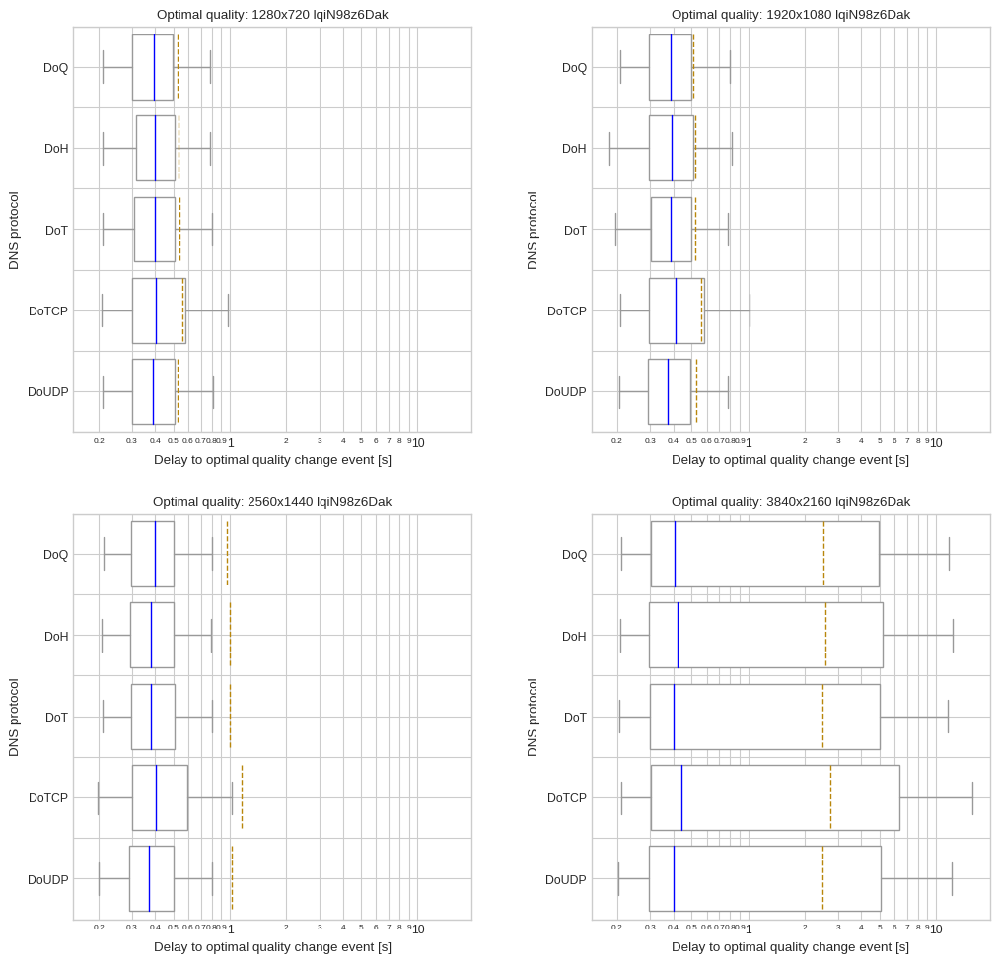

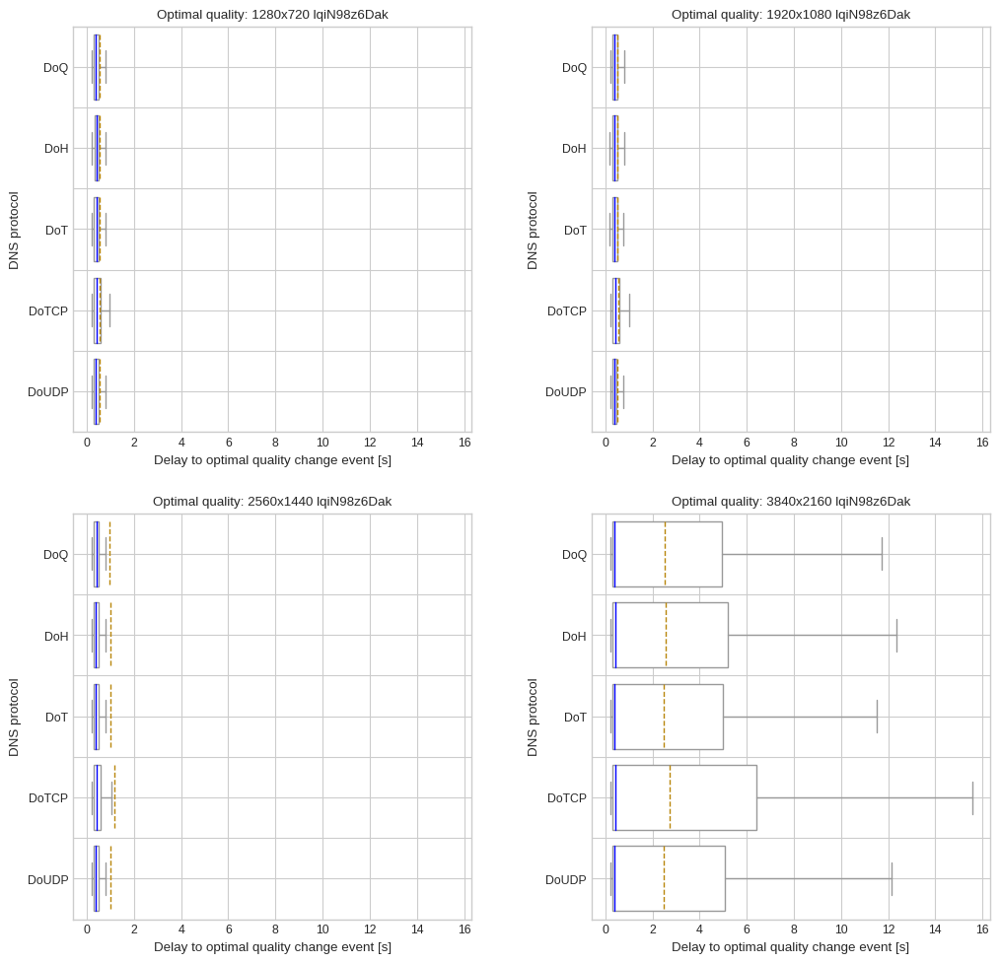

In [549]:
draw_boxplot_grid(df_player_quality_change_event_to_opt, 'optimal_res', 'protocol', 'optimal_quality_delay', [True, False], 'Delay to optimal quality change event [s]', 'Optimal quality:', 'optimal-quality-delay-by-optimal-quality-and-proto', [0,0], "DNS protocol", draw_all=True)

In [ ]:
draw_boxplot(df_player_quality_change_event_to_opt, 'optimal_res', 'protocol', 'optimal_quality_delay', [True], 'Delay to optimal quality change event [s]', 'Optimal quality:', 'optimal-quality-delay-by-optimal-quality-and-proto', [0,0], "DNS protocol")

## Lookup times

In [550]:
df_resolution_lookups = pd.read_sql_query("SELECT measurement_id as msm_id, elapsed, status, answer, domain as queried_domain FROM lookups", conn)

In [551]:
df_resolution_lookups = df_resolution_lookups[df_resolution_lookups.msm_id.isin(measurements.msm_id.unique())]

In [552]:
df_resolution_lookups.groupby('msm_id', as_index=False).size().sort_values('size')

,msm_id,size
25159,7840a01a-7458-6df1-74e6-8dec3dc295a2,8
40602,c20e077e-8b8e-8072-4f54-da4b81e1d10e,8
4173,1415c4e0-298c-4ab5-1958-2a622da6cad1,8
40834,c342acfb-726c-569f-9fc7-abb66bca0722,8
20454,617550a2-2f06-fcd0-112f-3a47af7fa29c,8
...,...,...
10182,300968e5-b315-1b58-3129-a1304ea7c834,13
27416,8333f910-b0cc-c13a-27e8-71622c3d07b8,13
20123,5fdacb17-5cc6-30ac-0a22-03d33cb007b2,13
39128,bb1b84f9-0687-322b-fa30-f22f3584615b,14


In [553]:
df_resolution_lookups[df_resolution_lookups.msm_id == '7e226777-5baf-08ea-90d0-c997c91f91c2']

,msm_id,elapsed,status,answer,queried_domain


In [554]:
df_resolution_lookups[df_resolution_lookups.status == 'NOERROR'].queried_domain.value_counts()

www.google.com.                      53672
www.youtube.com.                     53671
fonts.gstatic.com.                   53668
www.gstatic.com.                     53661
yt3.ggpht.com.                       53642
                                     ...  
r5---sn-q4flrnez.googlevideo.com.        1
r1---sn-5hne6nsz.googlevideo.com.        1
r5---sn-25ge7nse.googlevideo.com.        1
r2---sn-bg0eznek.googlevideo.com.        1
r4---sn-ab5szn7z.googlevideo.com.        1
Name: queried_domain, Length: 1881, dtype: int64

In [555]:
df_resolution_lookups[df_resolution_lookups.status != 'NOERROR'].queried_domain.value_counts()

Series([], Name: queried_domain, dtype: int64)

In [556]:
df_resolution_lookups.elapsed.describe()

count    496386.000000
mean         73.652471
std         109.467405
min           0.603431
25%           4.017744
50%          14.362714
75%         124.055945
max        9910.722734
Name: elapsed, dtype: float64

In [557]:
df_resolution_lookups = pd.merge(measurements[['msm_id', 'protocol', 'server', 'vantagePoint', 'domain', 'player_dimensions']], df_resolution_lookups, on='msm_id')

In [558]:
df_resolution_lookups = pd.merge(df_true_initial_quality[['msm_id', 'true_initial_quality']], df_resolution_lookups, on='msm_id')

In [559]:
df_resolution_lookups[df_resolution_lookups.status != 'NOERROR'].groupby('server', as_index=False).agg({'queried_domain':pd.Series.unique})

,server,queried_domain


In [560]:
df_resolution_lookups[df_resolution_lookups.status != 'NOERROR'].groupby('msm_id', as_index=False).agg({'queried_domain':pd.Series.unique})

,msm_id,queried_domain


In [561]:
df_resolution_lookups[df_resolution_lookups.status == 'SERVFAIL']['answer'].tolist()

[]

In [562]:
df_resolution_lookups[df_resolution_lookups.status == 'SERVFAIL'].protocol.value_counts()

Series([], Name: protocol, dtype: int64)

In [563]:
df_googlevideo_lookup_time = df_resolution_lookups[df_resolution_lookups.queried_domain.str.endswith('.googlevideo.com.')].groupby(['vantagePoint', 'domain', 'player_dimensions', 'protocol']).agg({'elapsed':'median'}).reset_index().copy().dropna()
df_overall_lookup_time = df_resolution_lookups.groupby(['vantagePoint', 'domain', 'player_dimensions', 'protocol']).agg({'elapsed':'median'}).reset_index().copy().dropna()

In [564]:
df_googlevideo_lookup_time.rename(columns=lambda x: x.replace('elapsed', 'metric'), inplace=True)
df_googlevideo_lookup_time.rename(columns=lambda x: x.replace('player_dimensions', 'resolution'), inplace=True)
df_overall_lookup_time.rename(columns=lambda x: x.replace('elapsed', 'metric'), inplace=True)
df_overall_lookup_time.rename(columns=lambda x: x.replace('player_dimensions', 'resolution'), inplace=True)

In [565]:
df_googlevideo_lookup_time['protocol'] = pd.Categorical(df_googlevideo_lookup_time['protocol'], ['DoQ', 'DoH', 'DoT', 'DoTCP', 'DoUDP'])
df_overall_lookup_time['protocol'] = pd.Categorical(df_overall_lookup_time['protocol'], ['DoQ', 'DoH', 'DoT', 'DoTCP', 'DoUDP'])

df_start_time, 'player_dimensions', 'protocol', 'startup_delay'

In [566]:
#startup_delay_medians = df_start_time[df_start_time.true_initial_quality.isin(['hd720', 'hd1080', 'hd1440', 'hd2160'])].groupby(['vantagePoint', 'domain', 'true_initial_quality', 'protocol']).agg({'startup_delay':'median'}).reset_index().copy().dropna()
#startup_delay_medians['true_initial_quality'] = startup_delay_medians['true_initial_quality'].map(map_quality_to_res)
#startup_delay_medians.rename(columns=lambda x: x.replace('startup_delay', 'metric'), inplace=True)
#startup_delay_medians.rename(columns=lambda x: x.replace('true_initial_quality', 'resolution'), inplace=True)

In [567]:
startup_delay_medians = df_start_time.groupby(['vantagePoint', 'domain', 'player_dimensions', 'protocol']).agg({'startup_delay':'median'}).reset_index().copy().dropna()
startup_delay_medians.rename(columns=lambda x: x.replace('startup_delay', 'metric'), inplace=True)
startup_delay_medians.rename(columns=lambda x: x.replace('player_dimensions', 'resolution'), inplace=True)

In [568]:
startup_delay_medians['protocol'] = pd.Categorical(startup_delay_medians['protocol'], ['DoQ', 'DoH', 'DoT', 'DoTCP', 'DoUDP'])

In [569]:
#make_quality_column_sortable(startup_delay_medians, 'true_initial_quality')

In [570]:
startup_delay_medians.sort_values(['domain', 'resolution', 'protocol'], inplace=True)

In [571]:
startup_delay_medians['metric'] = startup_delay_medians['metric'] * 1000

In [572]:
startup_delay_medians['resolution'].cat.remove_unused_categories(inplace=True)

/home/quic_net01/.pyenv/versions/3.8.12/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


df_player_quality_change_event_to_opt, 'optimal_res', 'protocol', 'optimal_quality_delay'

In [573]:
delay_to_opt_medians = df_player_quality_change_event_to_opt.groupby(['vantagePoint', 'domain', 'optimal_res', 'protocol']).agg({'optimal_quality_delay':'median'}).reset_index().copy().dropna()

In [574]:
#make_res_column_sortable(delay_to_opt_medians, 'optimal_res')

In [575]:
delay_to_opt_medians['protocol'] = pd.Categorical(delay_to_opt_medians['protocol'], ['DoQ', 'DoH', 'DoT', 'DoTCP', 'DoUDP'])

In [576]:
delay_to_opt_medians.sort_values(['domain', 'optimal_res', 'protocol'], inplace=True)

In [577]:
delay_to_opt_medians['optimal_quality_delay'] = delay_to_opt_medians['optimal_quality_delay'] * 1000

In [578]:
delay_to_opt_medians.rename(columns=lambda x: x.replace('optimal_quality_delay', 'metric'), inplace=True)
delay_to_opt_medians.rename(columns=lambda x: x.replace('optimal_res', 'resolution'), inplace=True)

In [579]:
#delay_to_opt_medians[(delay_to_opt_medians.vantagePoint == "") & (delay_to_opt_medians.domain == 'aqz-KE-bpKQ')].pivot(index='resolution', columns='protocol', values='metric').style.format(precision=2).background_gradient(cmap='coolwarm', axis=1)

In [580]:
#startup_delay_medians[(startup_delay_medians.vantagePoint == "") & (startup_delay_medians.domain == 'aqz-KE-bpKQ')].pivot(index='resolution', columns='protocol', values='metric').style.format(precision=2).background_gradient(cmap='coolwarm', axis=1)

In [581]:
#df_googlevideo_lookup_time[(df_googlevideo_lookup_time.vantagePoint == "") & (df_googlevideo_lookup_time.domain == 'aqz-KE-bpKQ')].pivot(index='resolution', columns='protocol', values='metric').style.format(precision=2).background_gradient(cmap='coolwarm', axis=1)

In [582]:
#df_overall_lookup_time[(df_overall_lookup_time.vantagePoint == "") & (df_overall_lookup_time.domain == 'aqz-KE-bpKQ')].pivot(index='resolution', columns='protocol', values='metric').style.format(precision=2).background_gradient(cmap='coolwarm', axis=1)

Africa South


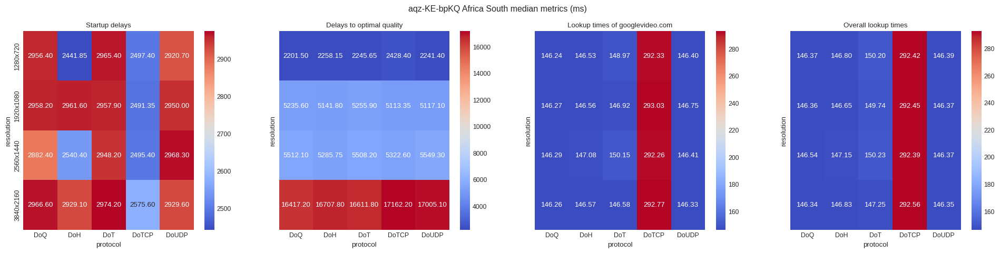

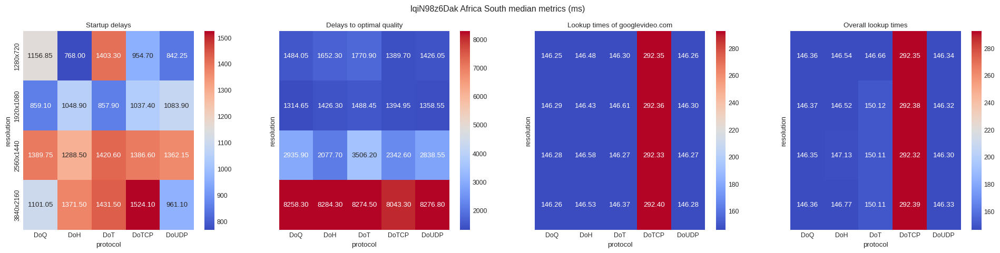

Asia Pacific Northeast


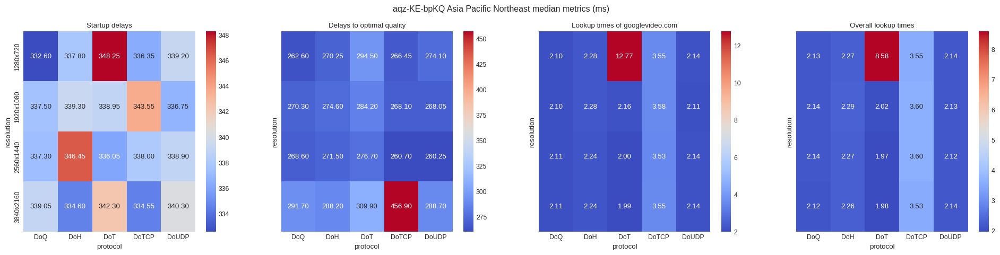

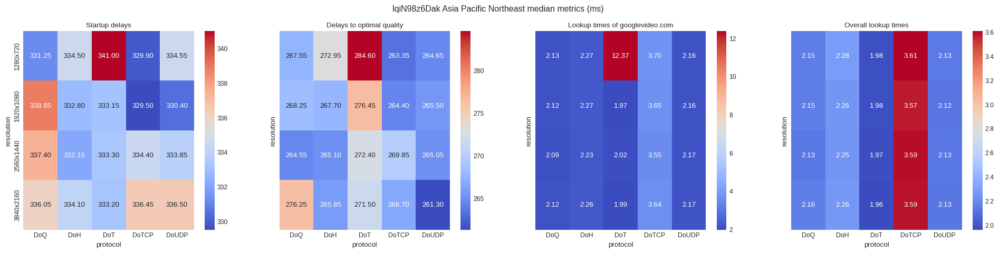

Asia Pacific Southeast


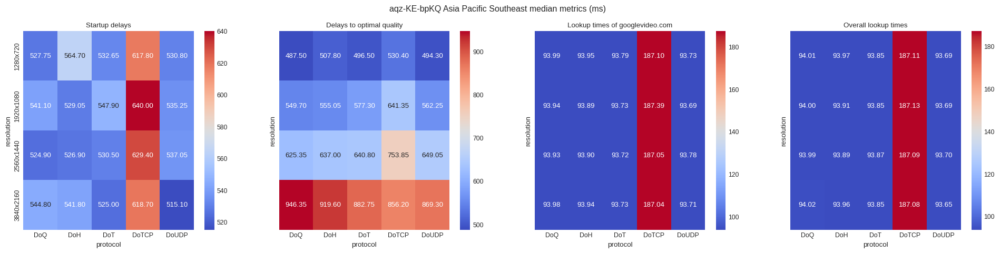

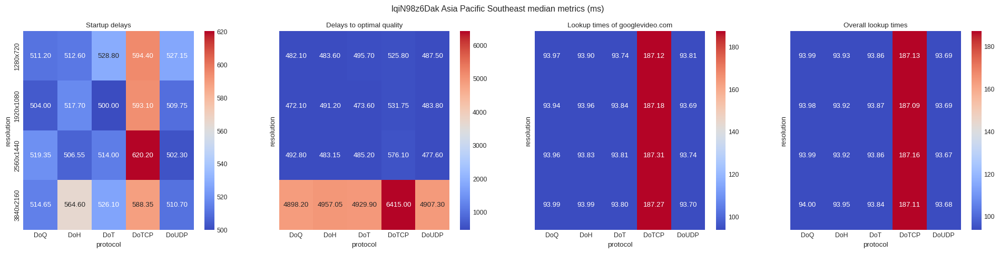

Europe Central


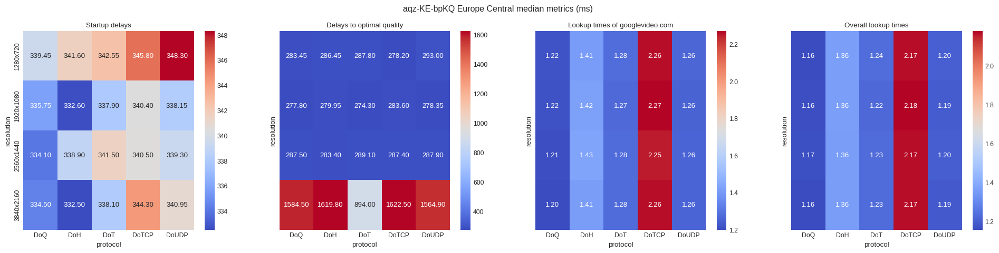

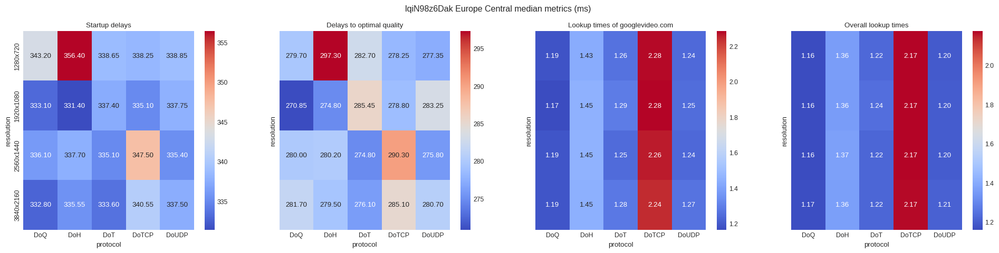

South America East


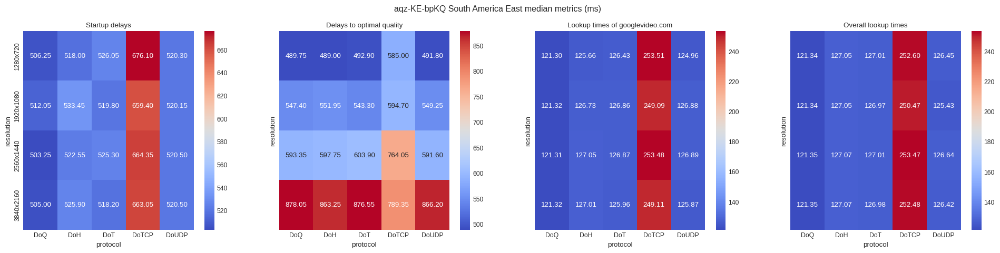

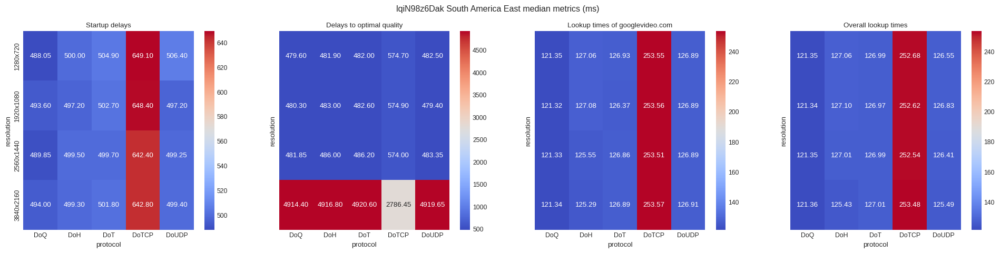

US East


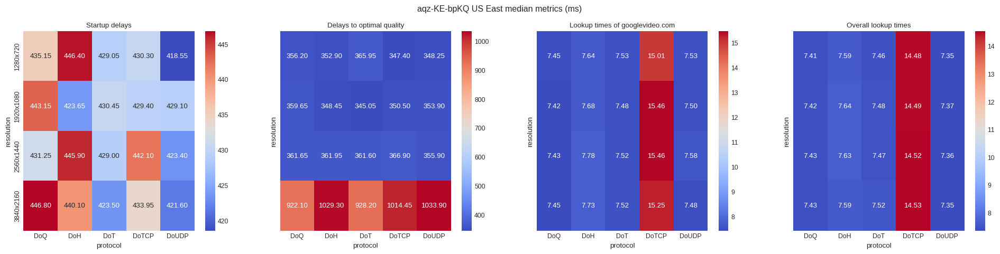

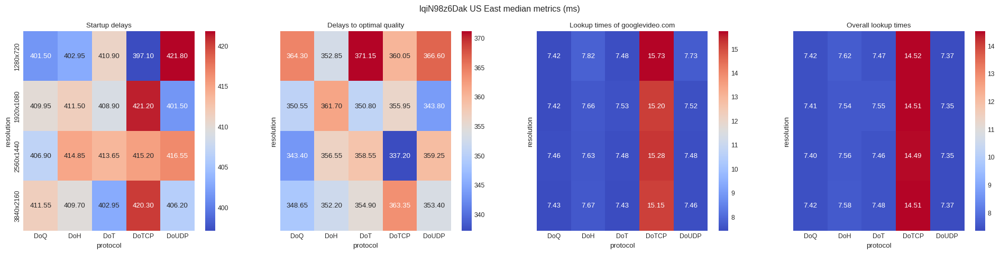

US West


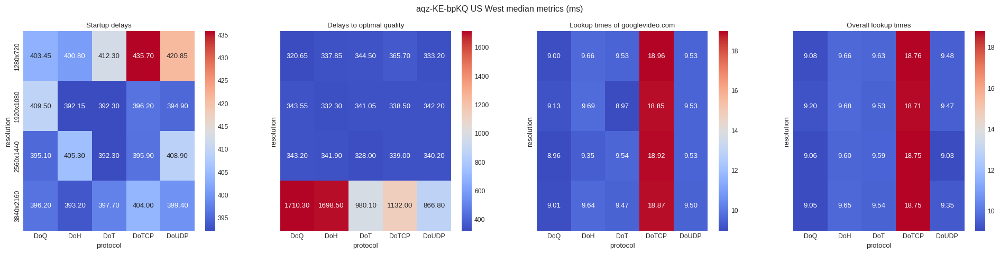

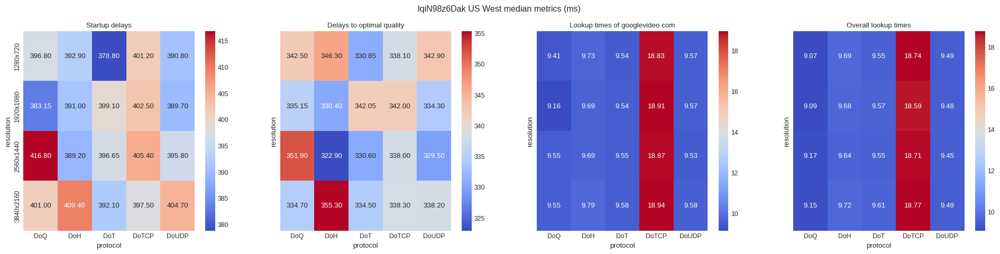

In [583]:
with plt.style.context('seaborn-whitegrid'):
    for vp in sorted(measurements['vantagePoint'].unique().tolist()):
        print(vp)
        for video in measurements['domain'].unique():
            fig, axs = plt.subplots(1, 4, sharex='all', figsize=(24,5), sharey='all')
            #fig.subplots_adjust(hspace=.2, wspace=.3)
            fig.suptitle(video+' '+vp+' median metrics (ms)')
            df_tmp_1 = startup_delay_medians[(startup_delay_medians.vantagePoint == vp) & (startup_delay_medians.domain == video)]
            df_tmp_2 = delay_to_opt_medians[(delay_to_opt_medians.vantagePoint == vp) & (delay_to_opt_medians.domain == video)]
            df_tmp_3 = df_googlevideo_lookup_time[(df_googlevideo_lookup_time.vantagePoint == vp) & (df_googlevideo_lookup_time.domain == video)]
            df_tmp_4 = df_overall_lookup_time[(df_overall_lookup_time.vantagePoint == vp) & (df_overall_lookup_time.domain == video)]

            for df, ax, title in zip(
                [df_tmp_1, df_tmp_2, df_tmp_3, df_tmp_4],
                axs.flat, ['Startup delays', 'Delays to optimal quality', 'Lookup times of googlevideo.com', 'Overall lookup times']):
                sns.heatmap(df.pivot(index='resolution', columns='protocol', values='metric'), ax=ax, cmap="coolwarm", annot=True, fmt='.2f')
                ax.set_title(title)

            plt.show()

In [584]:
df_4k_stall_count = df_stall_times[df_stall_times.player_dimensions == '3840x2160'].groupby('msm_id', as_index=False).agg({'stall_time':'count'})
df_4k_stall_count.stall_time.value_counts()

3    2679
2    1322
1     461
Name: stall_time, dtype: int64

In [585]:
one_stall = df_4k_stall_count[df_4k_stall_count.stall_time == 1].msm_id.unique().tolist()
two_stalls = df_4k_stall_count[df_4k_stall_count.stall_time == 2].msm_id.unique().tolist()
three_stalls = df_4k_stall_count[df_4k_stall_count.stall_time == 3].msm_id.unique().tolist()

In [586]:
df_4k_stalls = df_stall_times[df_stall_times.player_dimensions == '3840x2160'].copy().drop_duplicates()

In [587]:
first_stall = df_4k_stalls.loc[df_4k_stalls.groupby('msm_id').time.idxmin()].reset_index(drop=True).drop_duplicates()
latest_stall = df_4k_stalls.loc[df_4k_stalls.groupby('msm_id').time.idxmax()].reset_index(drop=True).drop_duplicates()

In [588]:
#get the second stall out of three by removing all first stalls and all last stalls -> this breaks if there are 4 stalls
#remove single stalls from the first merge because they would then get added in the second merge without getting dropped
second_stall_of_three = pd.concat([df_4k_stalls, first_stall[~first_stall.msm_id.isin(one_stall)]]).drop_duplicates(keep=False)
second_stall_of_three = pd.concat([second_stall_of_three, latest_stall]).drop_duplicates(keep=False)

In [589]:
print(first_stall.msm_id.nunique())
print(second_stall_of_three.msm_id.nunique())
print(latest_stall.msm_id.nunique())
print(latest_stall[latest_stall.msm_id.isin(one_stall)].msm_id.nunique())
print(latest_stall[latest_stall.msm_id.isin(two_stalls)].msm_id.nunique())
print(latest_stall[latest_stall.msm_id.isin(three_stalls)].msm_id.nunique())
print(latest_stall[~latest_stall.msm_id.isin(one_stall+two_stalls+three_stalls)].msm_id.nunique())
print(second_stall_of_three[second_stall_of_three.msm_id.isin(three_stalls)].msm_id.nunique())
print(second_stall_of_three[~second_stall_of_three.msm_id.isin(three_stalls)].msm_id.nunique())

4462
2679
4462
461
1322
2679
0
2679
0


In [590]:
first_stall

,play_time,msm_id,current_quality_x,time,curr_play_time,current_quality_y,player_dimensions,protocol,vantagePoint,domain,stall_time
0,2022-03-11 19:55:01.798200320,000d424a-29a0-c7e7-eaf0-532cba3dd933,hd2160,2022-03-11 19:55:00.637700096,23.114937,hd2160,3840x2160,DoT,South America East,aqz-KE-bpKQ,1.1605
1,2022-03-09 21:16:25.792400128,00135f60-bf34-db54-1290-a57f2eaee2ae,hd2160,2022-03-09 21:16:25.061799936,19.272848,hd2160,3840x2160,DoQ,Asia Pacific Southeast,aqz-KE-bpKQ,0.7306
2,2022-03-08 15:25:18.092600064,0019bce6-153e-8041-6e54-54aacbde8e1a,hd2160,2022-03-08 15:25:13.246500096,17.803340,hd2160,3840x2160,DoQ,US East,aqz-KE-bpKQ,4.8461
3,2022-03-08 12:30:21.525799936,001a4f2e-eac5-ac37-fa6f-0257546fb4db,hd2160,2022-03-08 12:30:19.535800064,28.110590,hd2160,3840x2160,DoQ,US East,aqz-KE-bpKQ,1.9900
4,2022-03-09 22:54:53.156400128,002ea5d3-1ebf-1321-8071-be320d652c80,hd2160,2022-03-09 22:54:52.341900032,19.262204,hd2160,3840x2160,DoH,US East,aqz-KE-bpKQ,0.8145
...,...,...,...,...,...,...,...,...,...,...,...
4457,2022-03-10 12:35:11.316199936,ffe65521-24ae-99d7-c807-f491624b0376,hd2160,2022-03-10 12:35:08.547400192,17.844986,hd2160,3840x2160,DoTCP,Asia Pacific Northeast,aqz-KE-bpKQ,2.7688
4458,2022-03-09 18:09:25.674500096,ffeb3d6e-8e58-d05f-61d9-d65852a01042,hd2160,2022-03-09 18:09:23.081899776,17.816993,hd2160,3840x2160,DoT,Asia Pacific Northeast,aqz-KE-bpKQ,2.5926
4459,2022-03-12 15:37:24.713699840,fff0e352-6d3a-49b9-cb3e-53f090dc8ce8,hd2160,2022-03-12 15:37:24.393199872,14.545697,hd2160,3840x2160,DoUDP,Asia Pacific Southeast,aqz-KE-bpKQ,0.3205
4460,2022-03-08 14:50:10.927700224,fff66457-a7f8-1f07-7ebf-98bd5e771f35,hd2160,2022-03-08 14:50:06.402600192,17.809466,hd2160,3840x2160,DoQ,US West,aqz-KE-bpKQ,4.5251


Africa South
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West
Africa South
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central


/tmp/ipykernel_12172/1327244453.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(6,8))


South America East
US East
US West


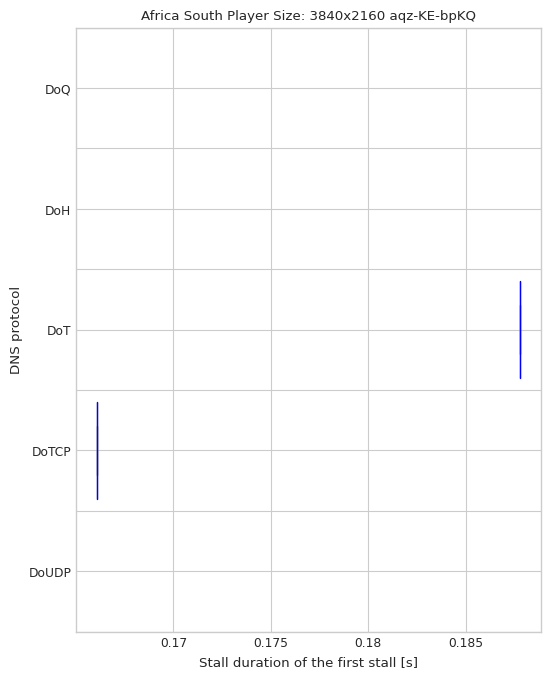

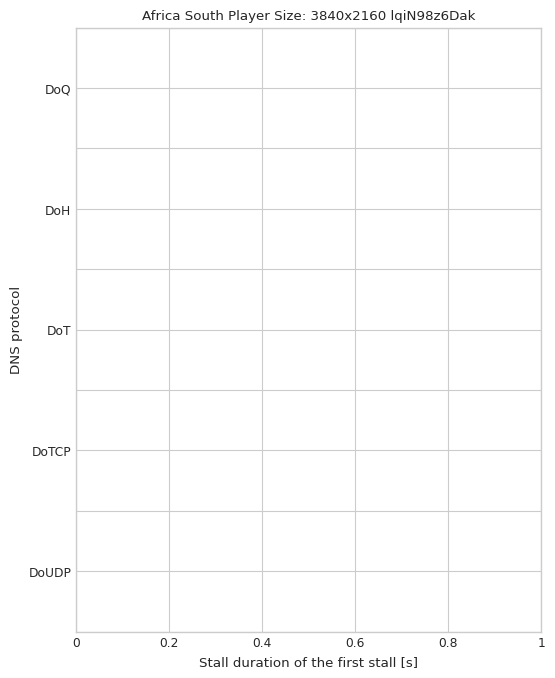

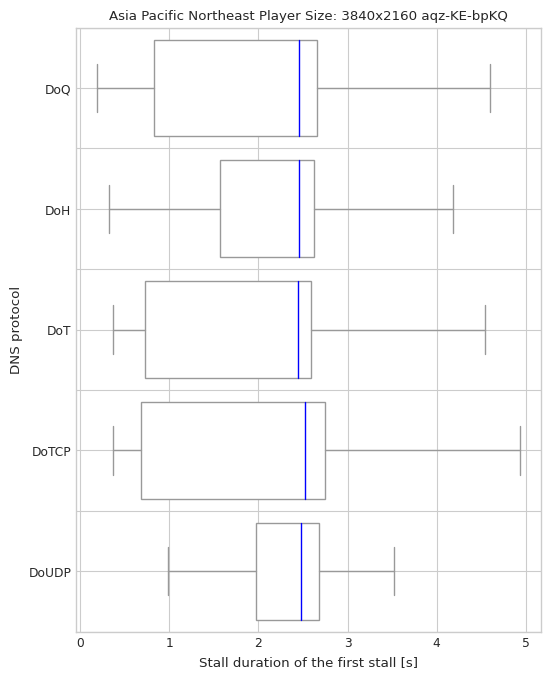

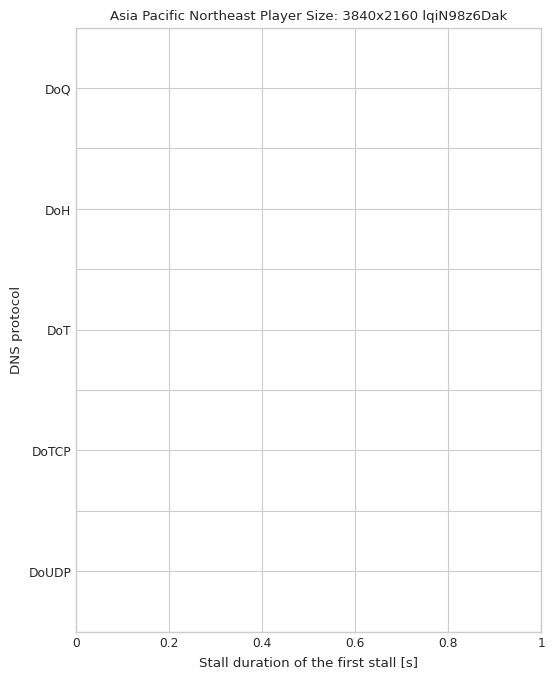

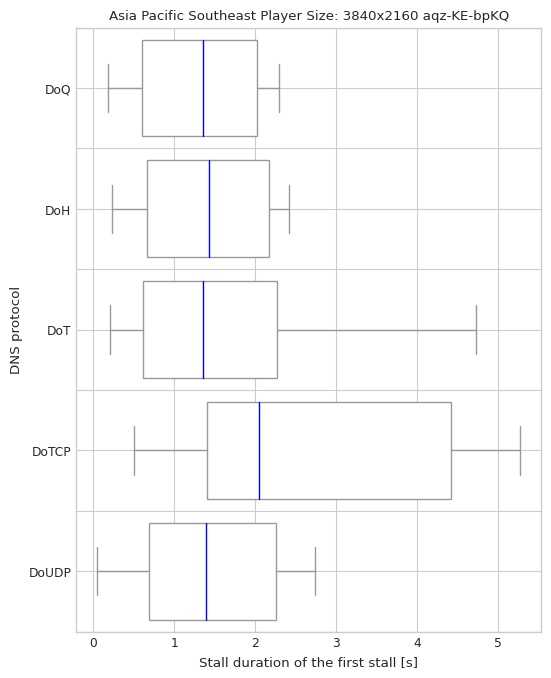

...

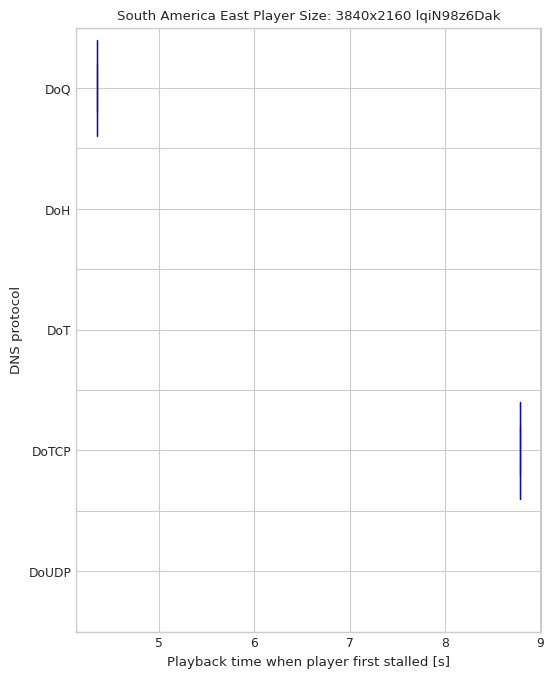

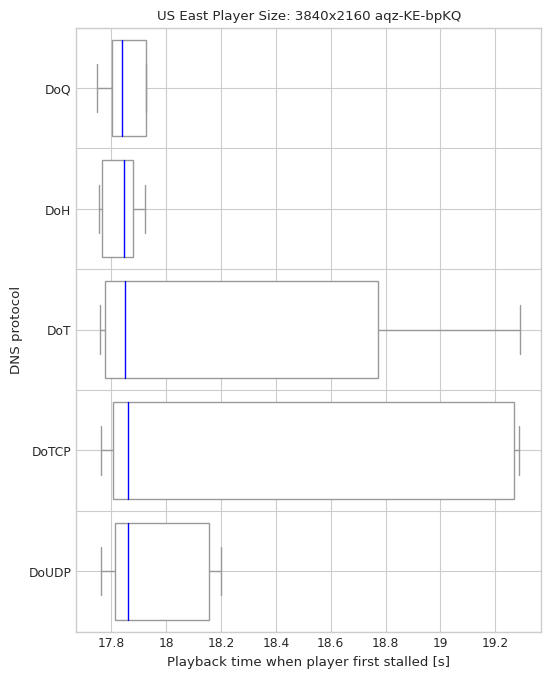

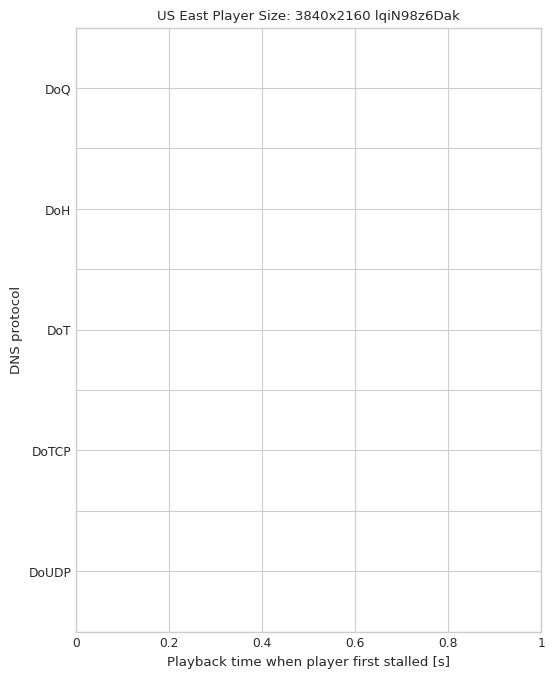

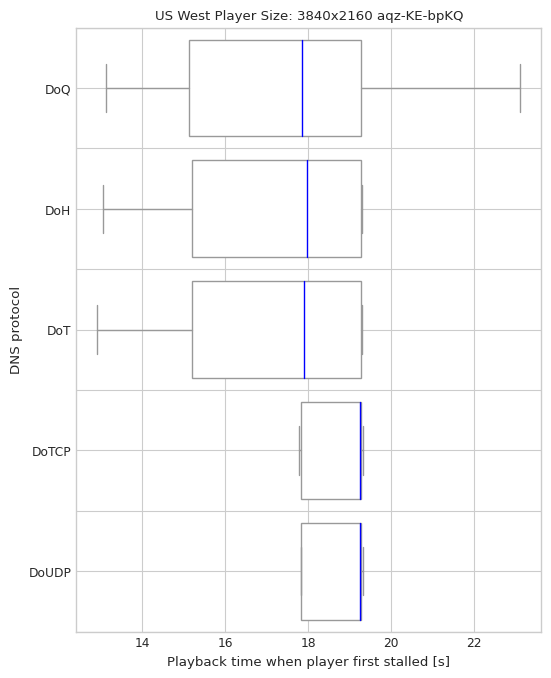

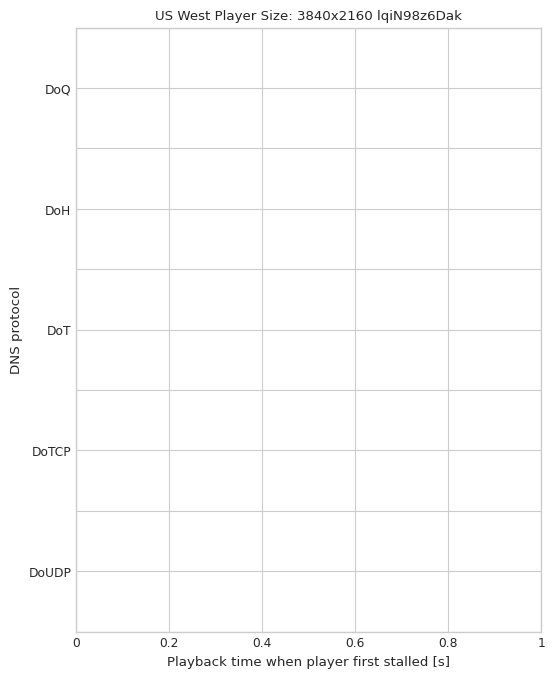

In [591]:
draw_boxplot(first_stall, 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration of the first stall [s]', 'Player Size:', 'first-stall-stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)
draw_boxplot(first_stall, 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player first stalled [s]', 'Player Size:', 'first-stall-buffer-events-with-play-events-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)

Africa South
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West
Africa South
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central


/tmp/ipykernel_12172/1327244453.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(6,8))


South America East
US East
US West


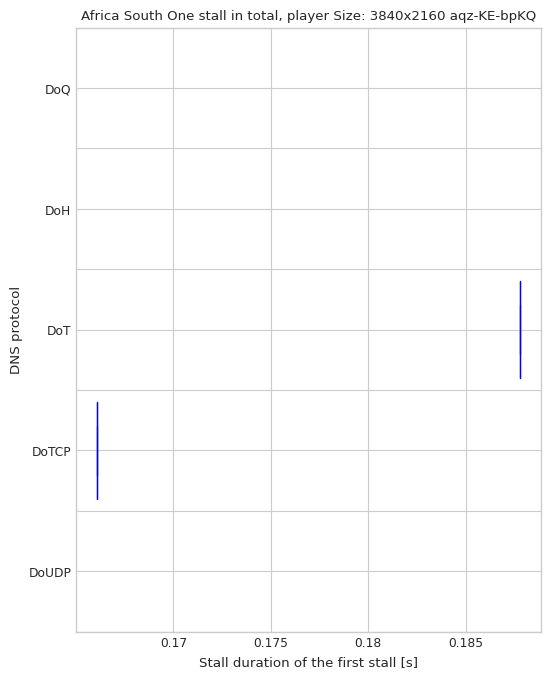

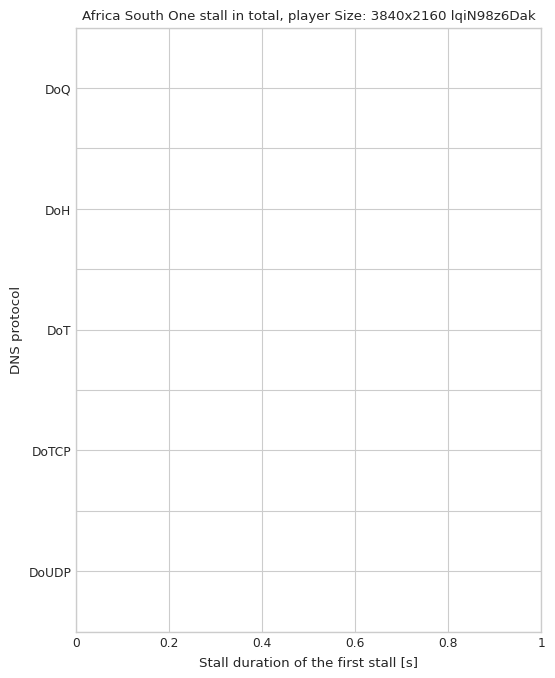

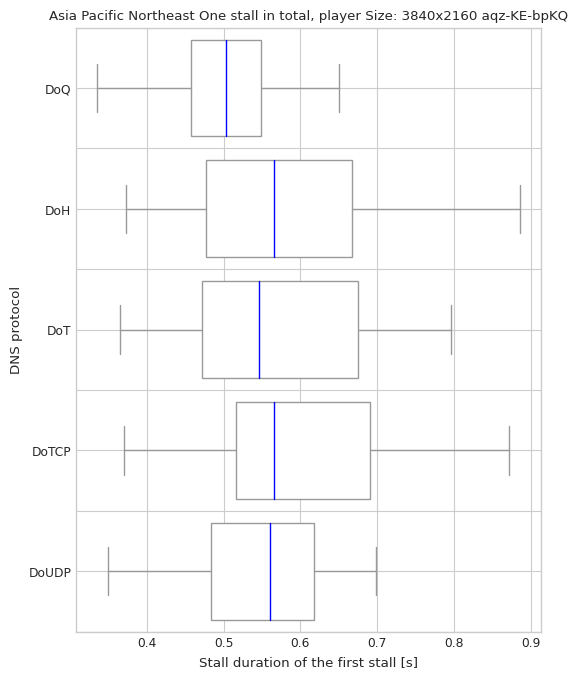

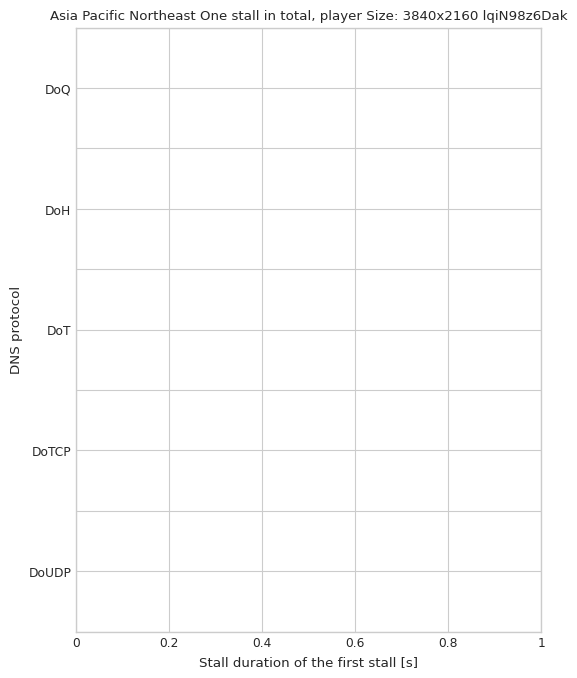

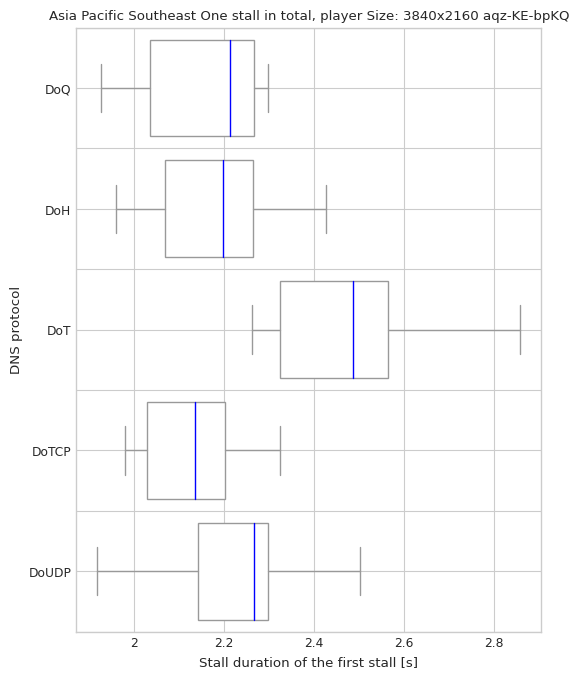

...

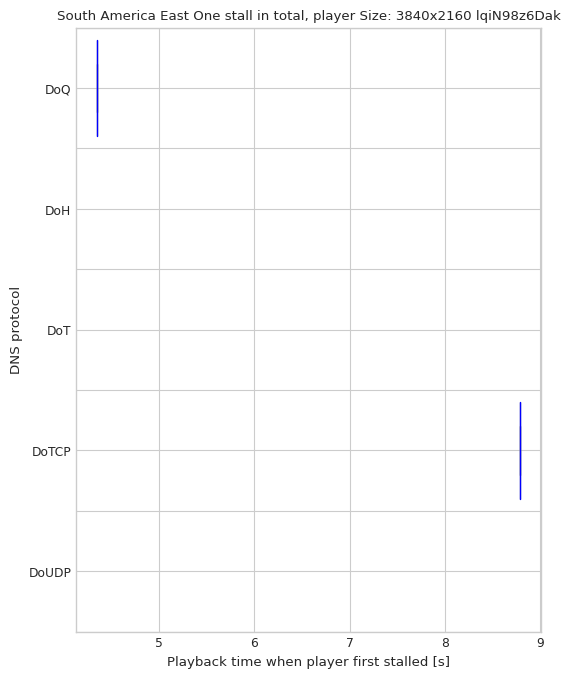

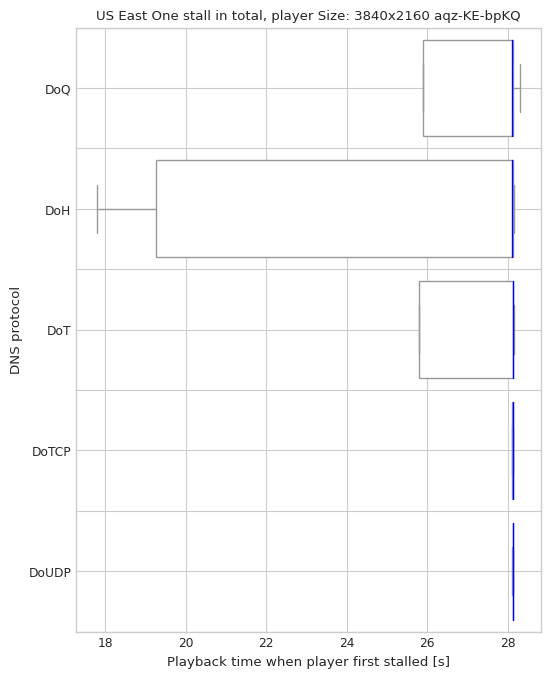

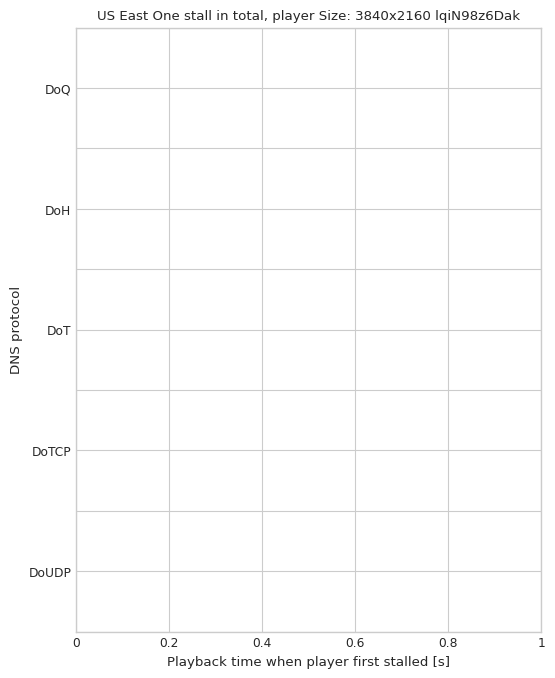

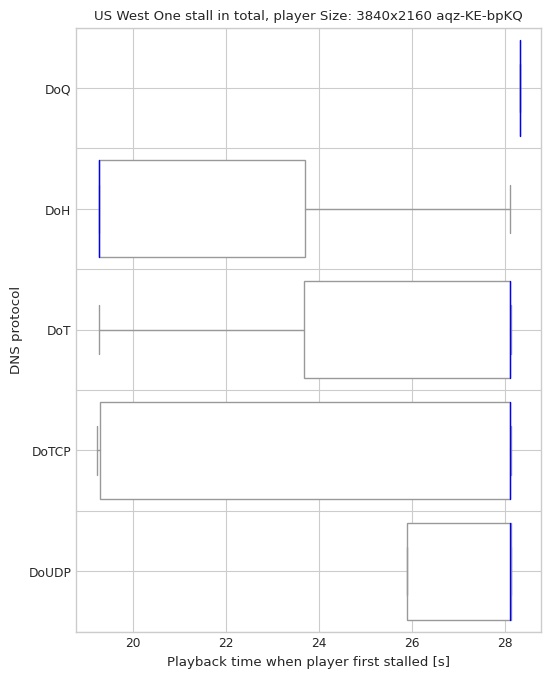

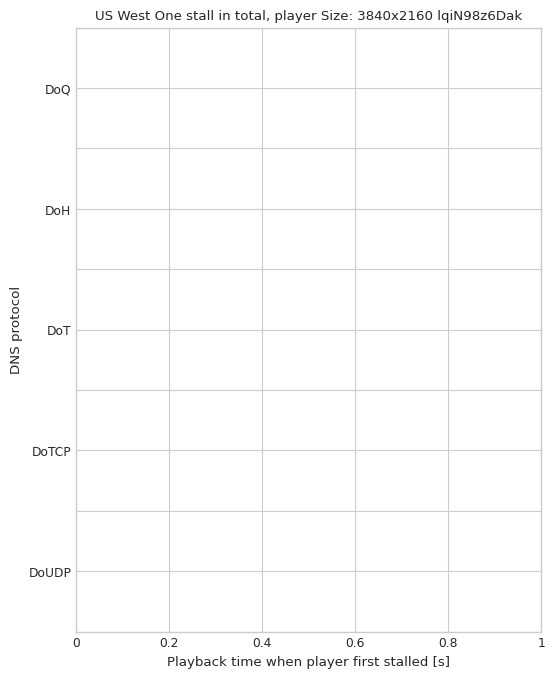

In [592]:
draw_boxplot(first_stall[first_stall.msm_id.isin(one_stall)], 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration of the first stall [s]', 'One stall in total, player Size:', 'one-stall-first-stall-stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)
draw_boxplot(first_stall[first_stall.msm_id.isin(one_stall)], 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player first stalled [s]', 'One stall in total, player Size:', 'one-stall-first-stall-buffer-events-with-play-events-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)

Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West


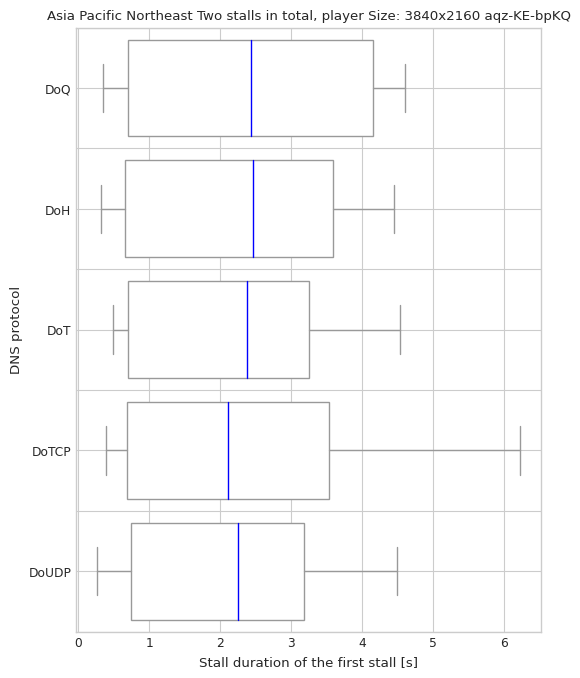

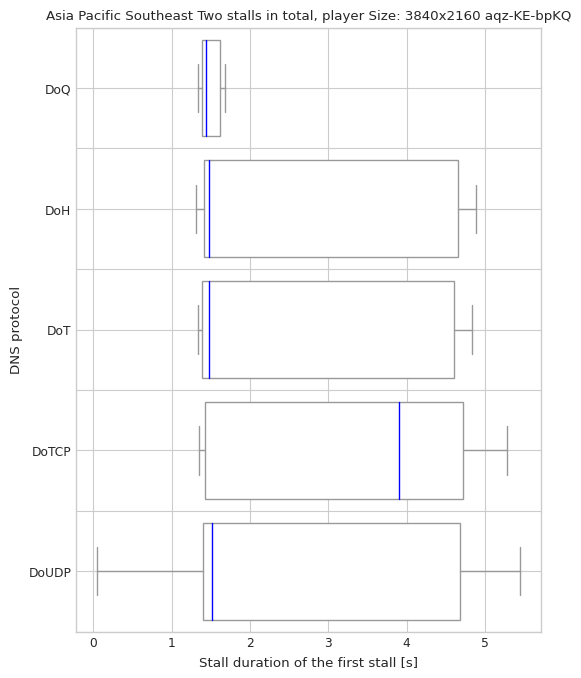

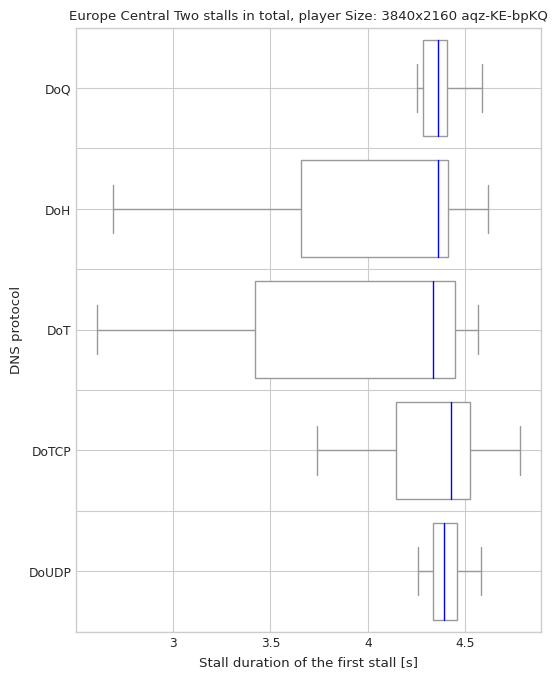

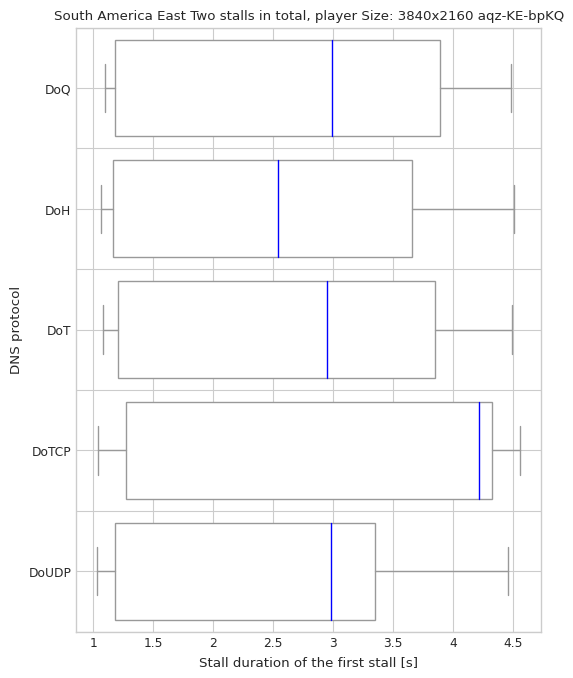

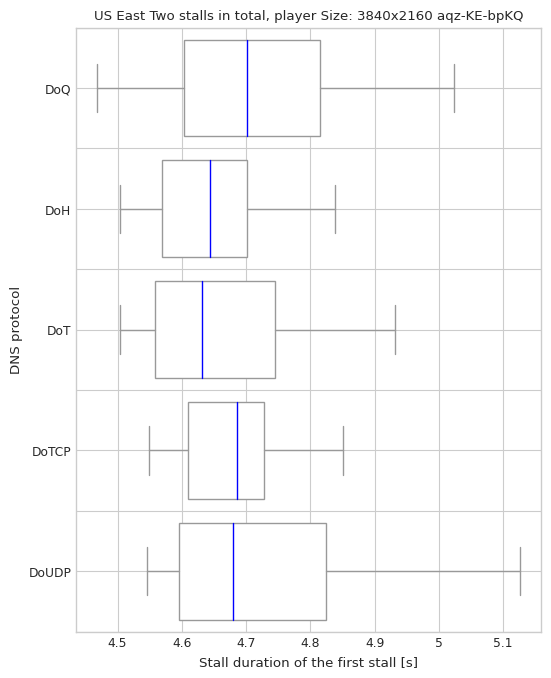

...

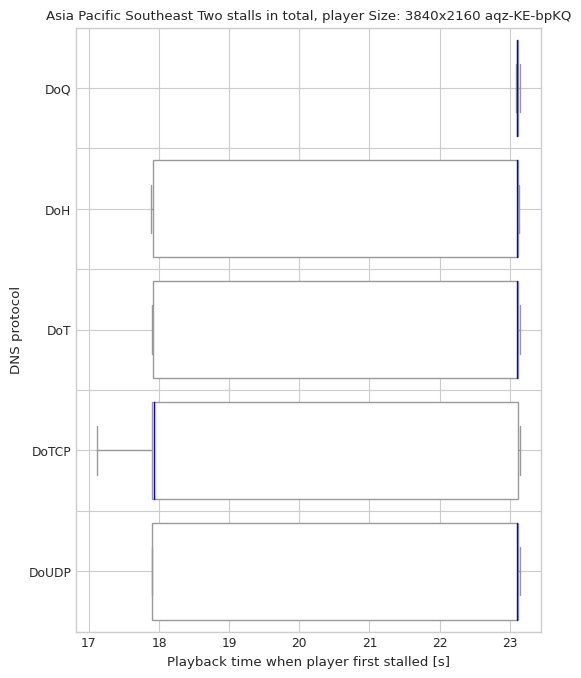

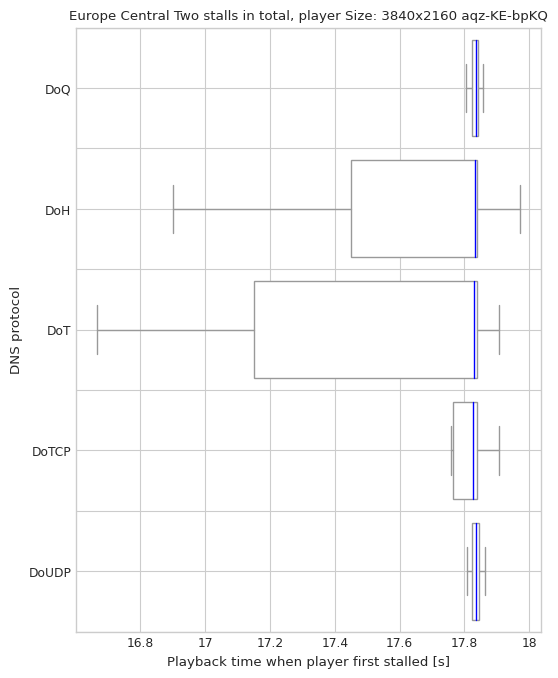

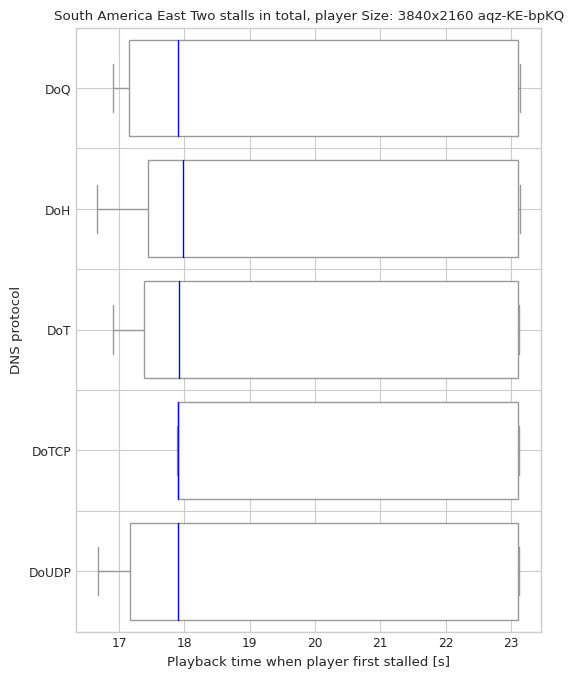

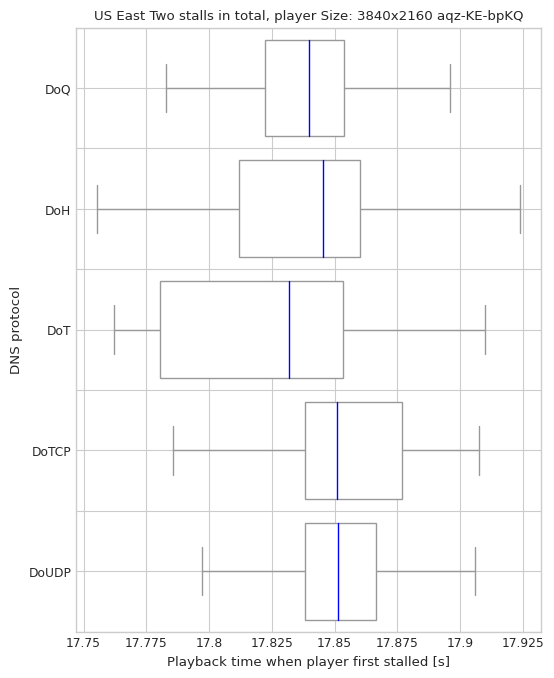

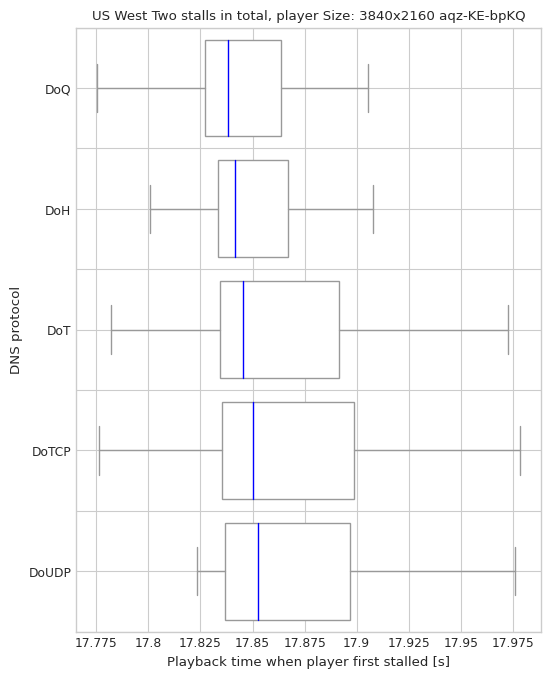

In [593]:
draw_boxplot(first_stall[first_stall.msm_id.isin(two_stalls)], 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration of the first stall [s]', 'Two stalls in total, player Size:', 'two-stalls-first-stall-stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)
draw_boxplot(first_stall[first_stall.msm_id.isin(two_stalls)], 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player first stalled [s]', 'Two stalls in total, player Size:', 'two-stalls-first-stall-buffer-events-with-play-events-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)

Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West


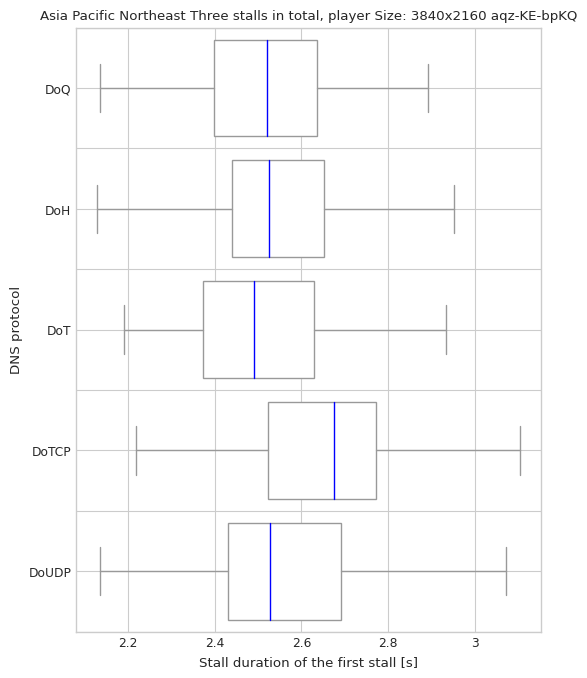

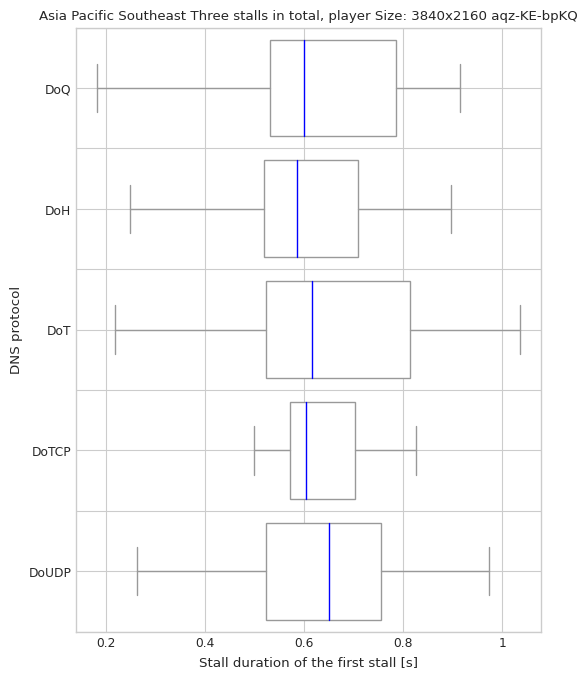

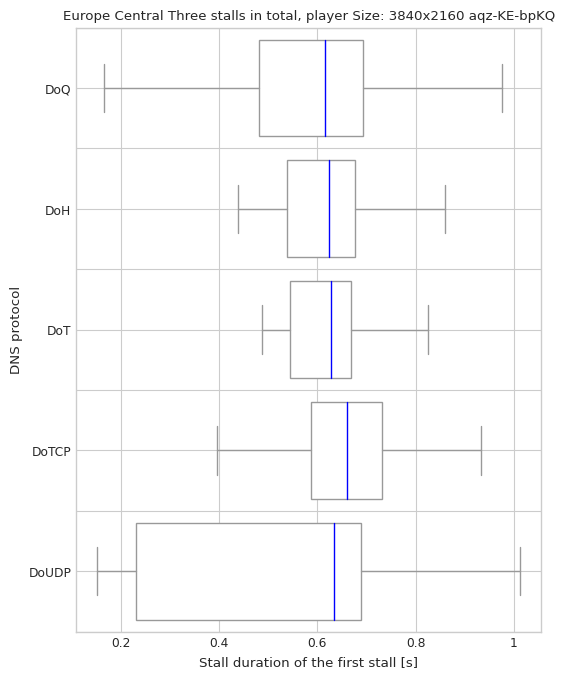

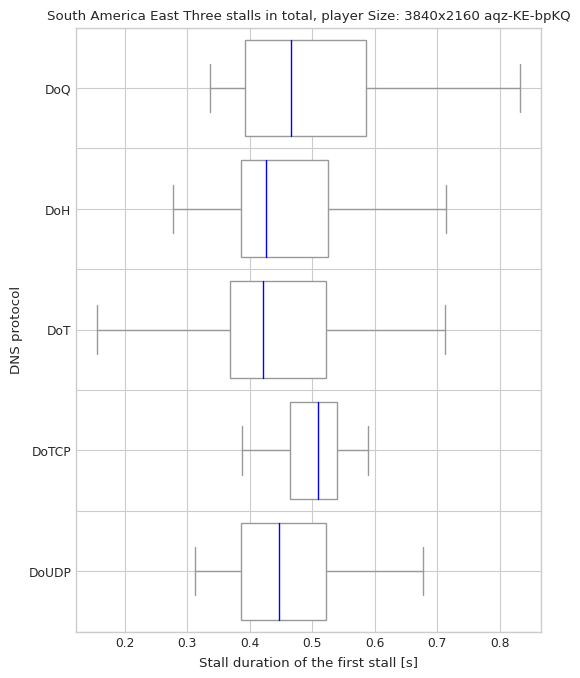

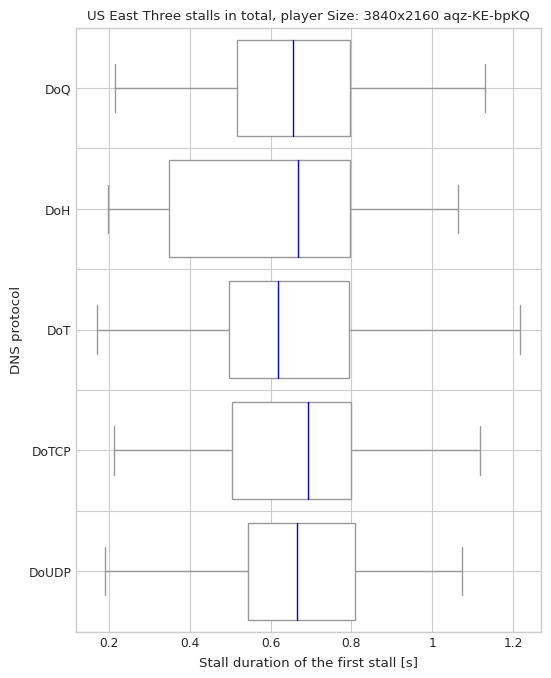

...

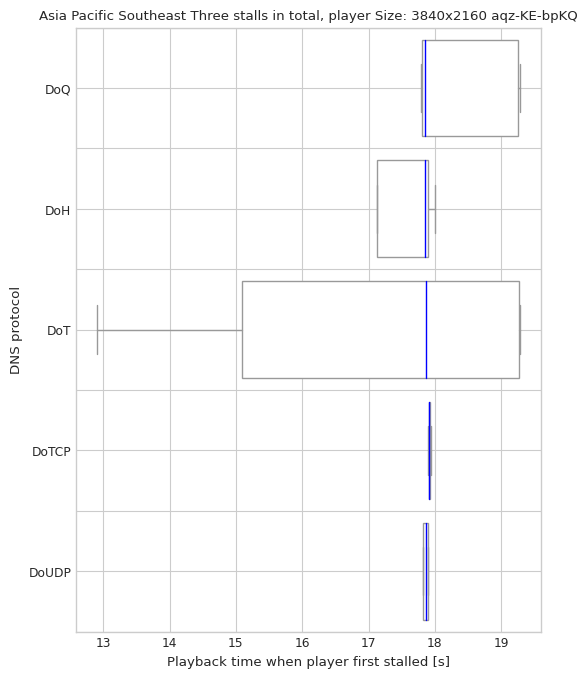

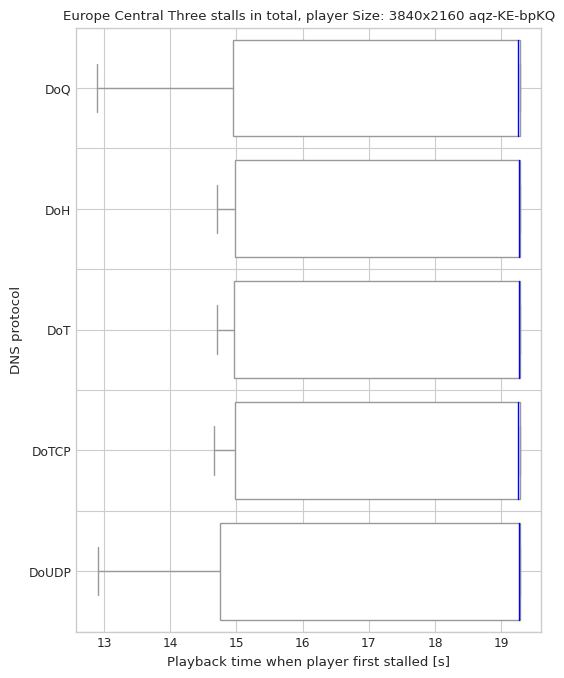

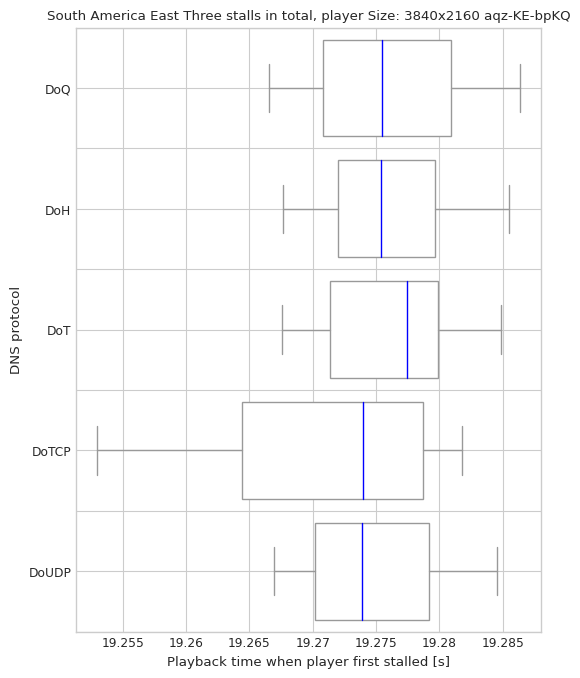

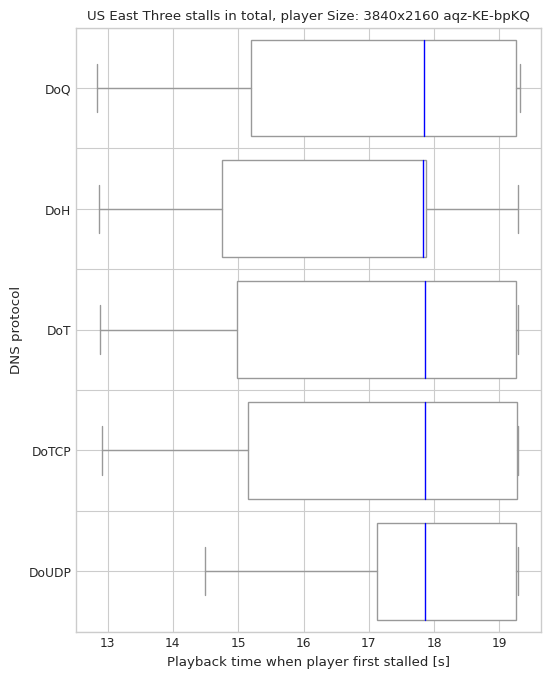

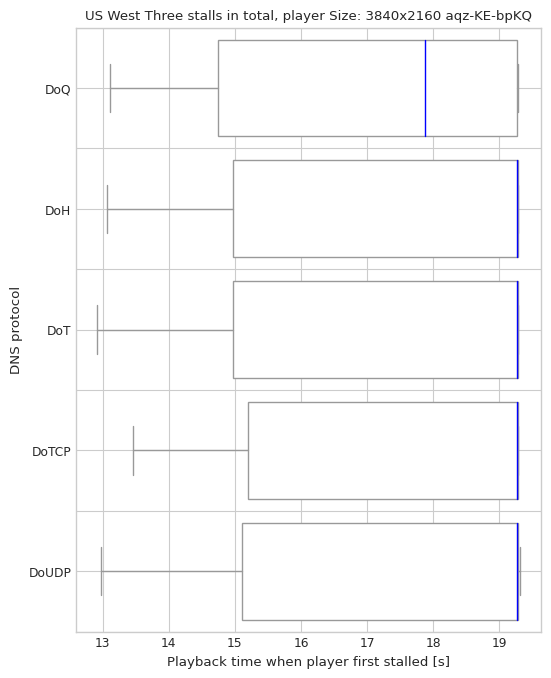

In [594]:
draw_boxplot(first_stall[first_stall.msm_id.isin(three_stalls)], 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration of the first stall [s]', 'Three stalls in total, player Size:', 'three-stalls-first-stall-stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)
draw_boxplot(first_stall[first_stall.msm_id.isin(three_stalls)], 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player first stalled [s]', 'Three stalls in total, player Size:', 'three-stalls-first-stall-buffer-events-with-play-events-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)

Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West


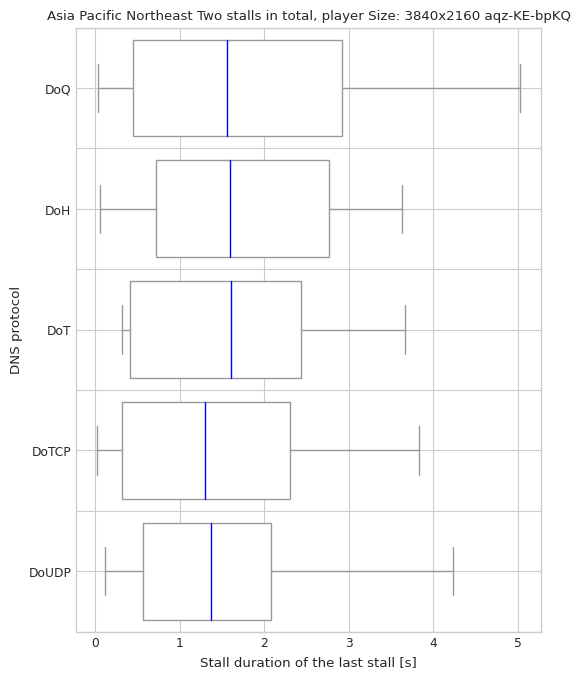

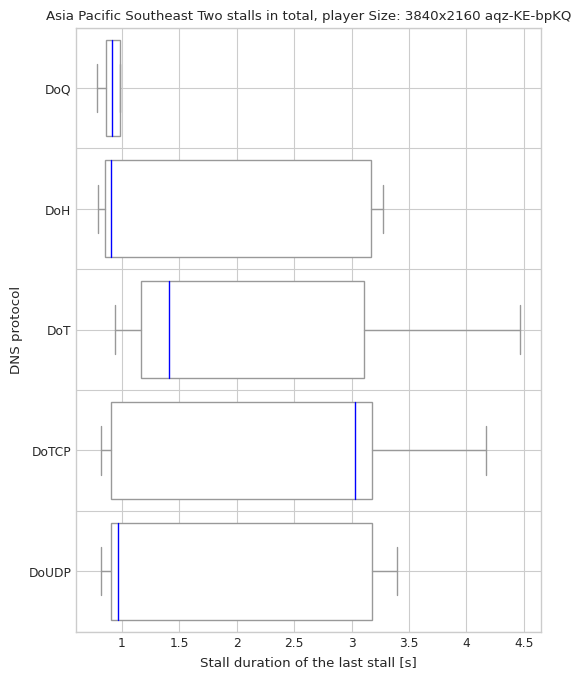

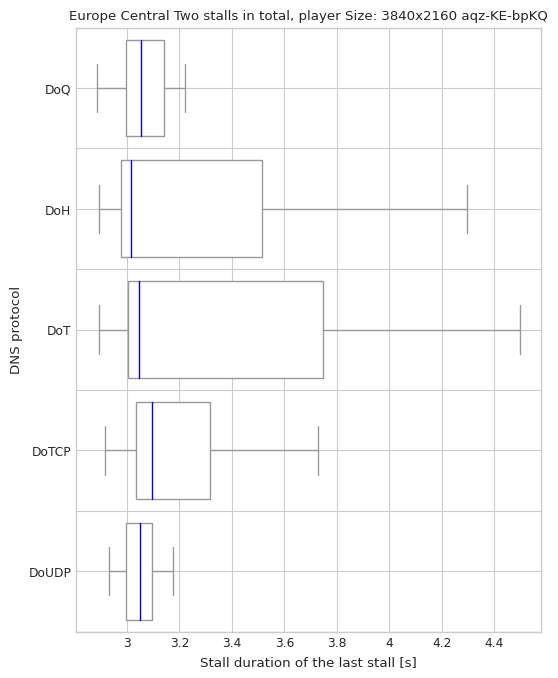

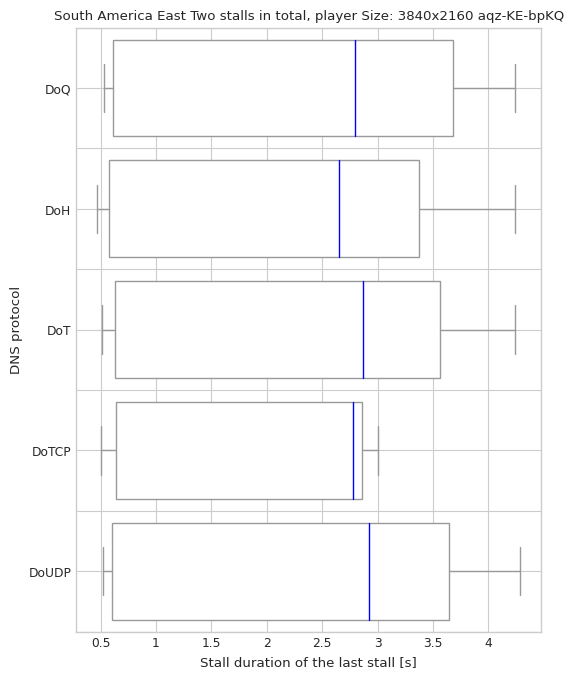

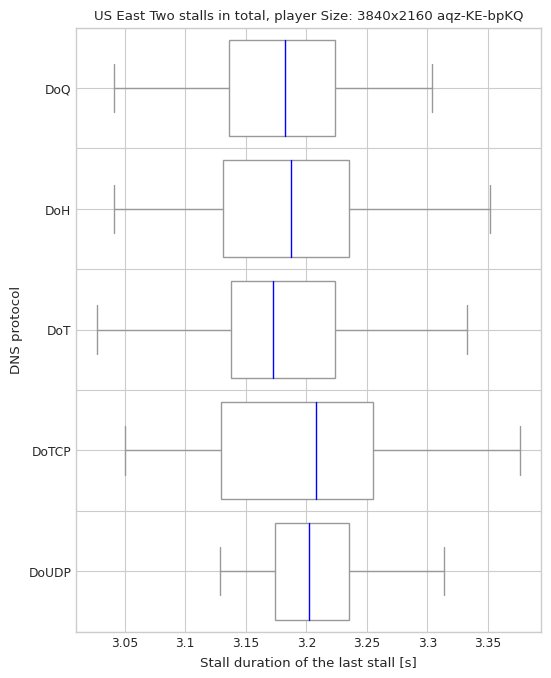

...

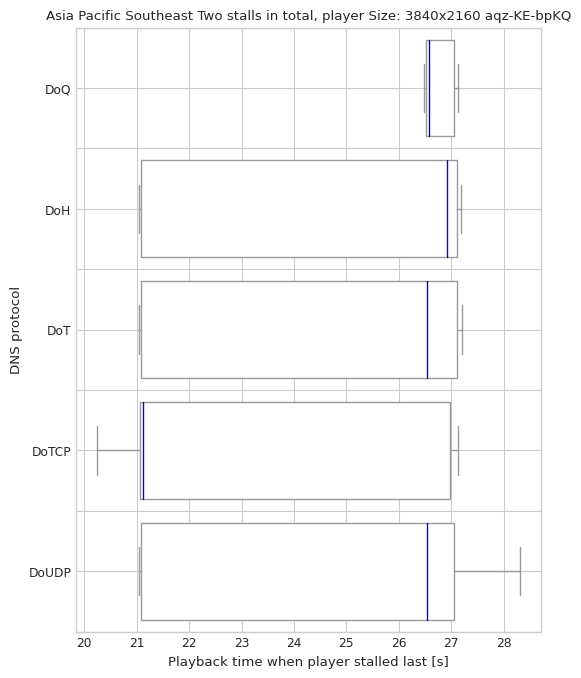

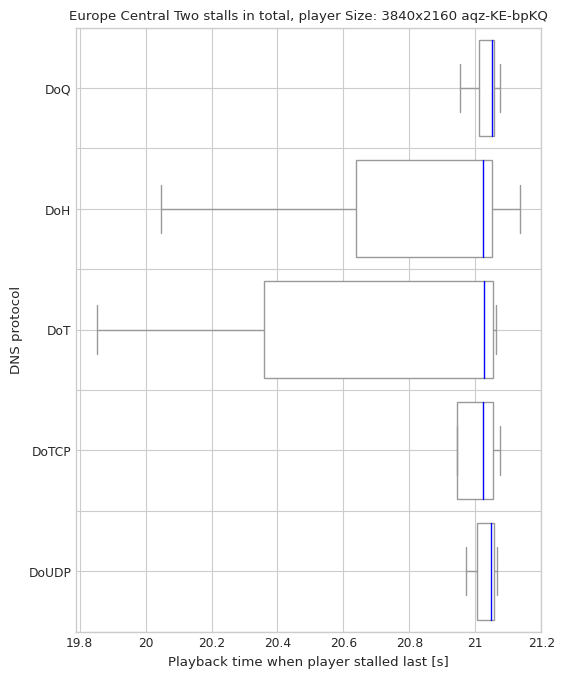

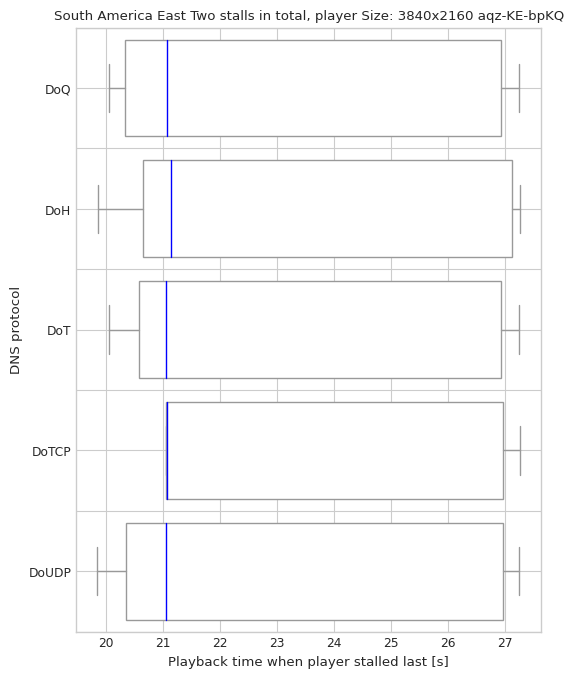

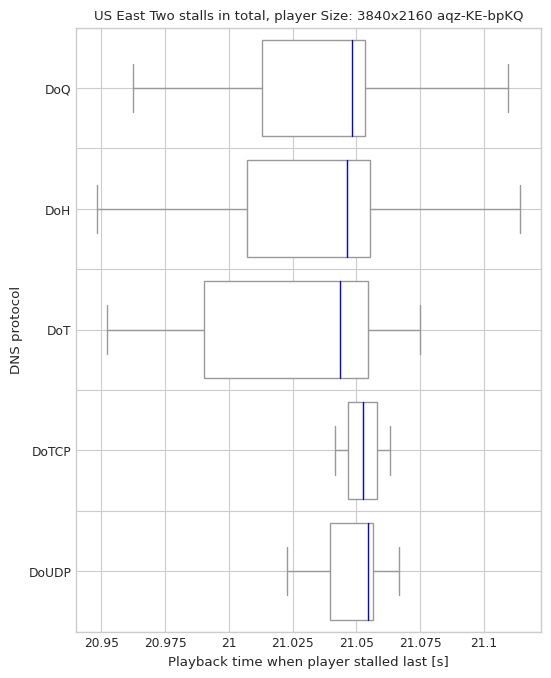

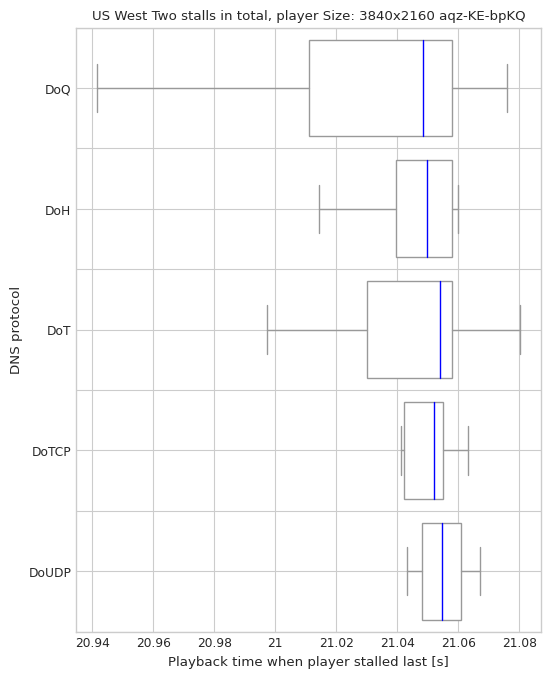

In [595]:
draw_boxplot(latest_stall[latest_stall.msm_id.isin(two_stalls)], 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration of the last stall [s]', 'Two stalls in total, player Size:', 'two-stalls-last-stall-stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)
draw_boxplot(latest_stall[latest_stall.msm_id.isin(two_stalls)], 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player stalled last [s]', 'Two stalls in total, player Size:', 'two-stalls-last-stall-buffer-events-with-play-events-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)

Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West


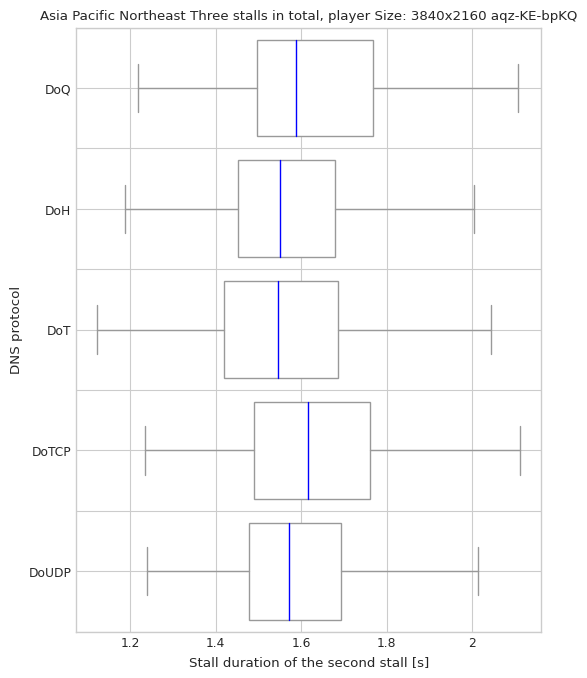

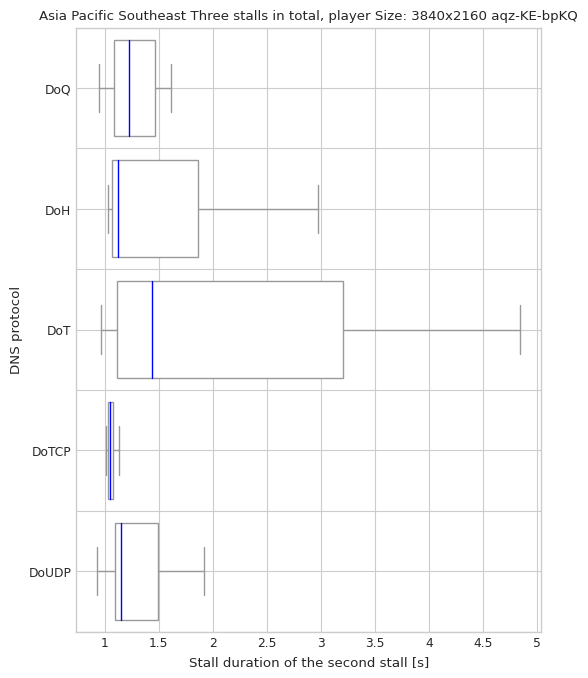

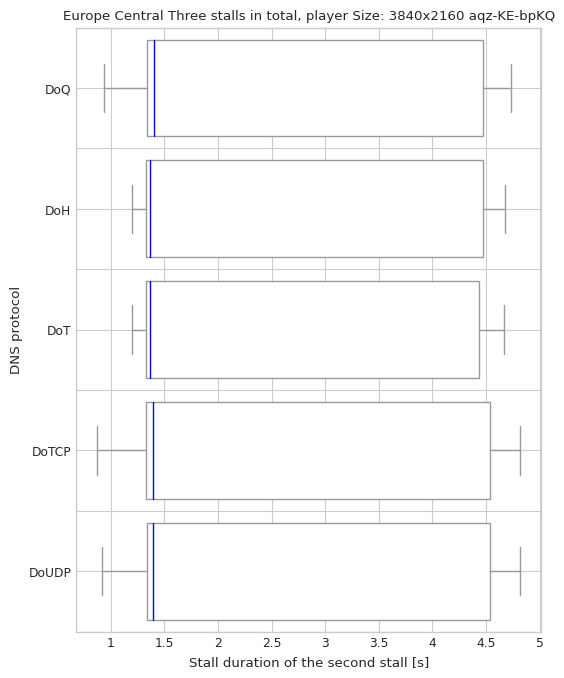

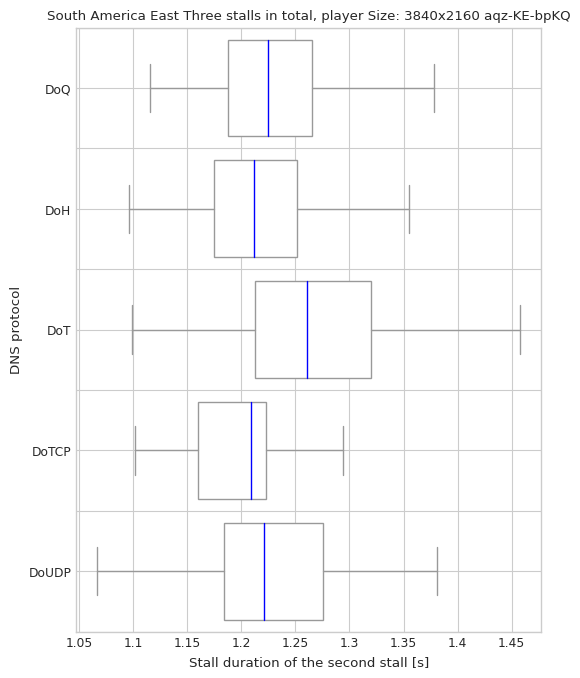

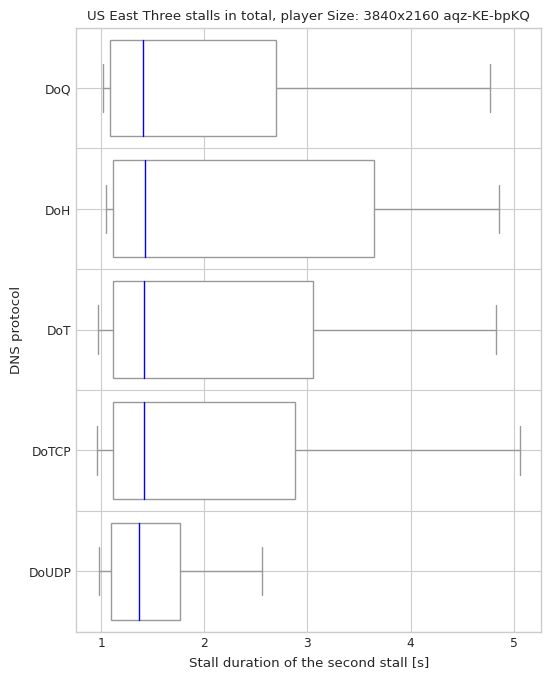

...

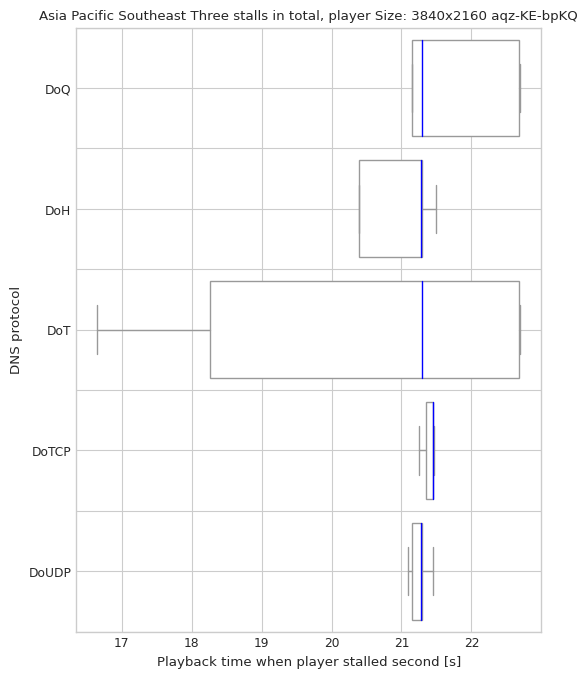

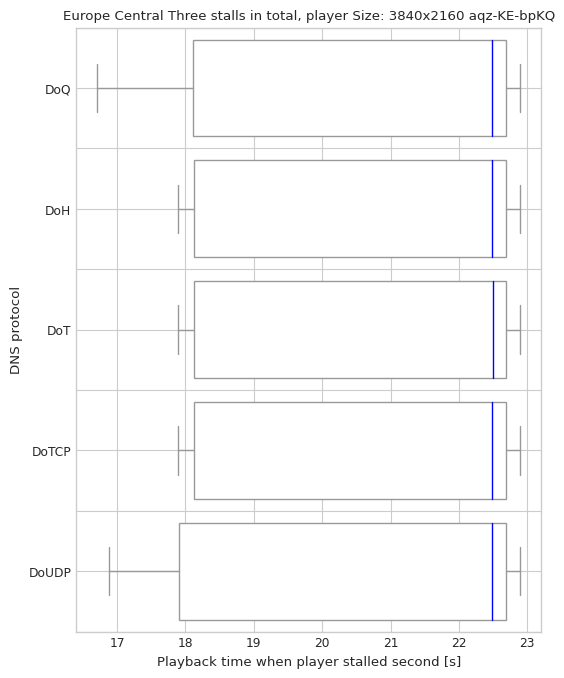

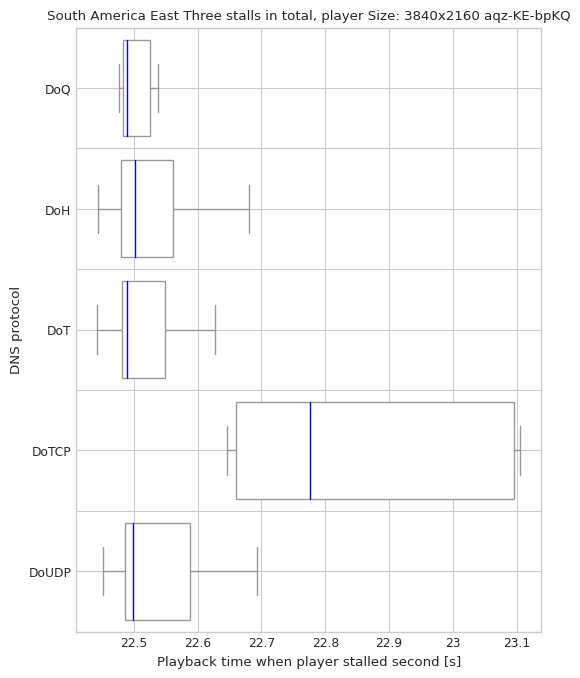

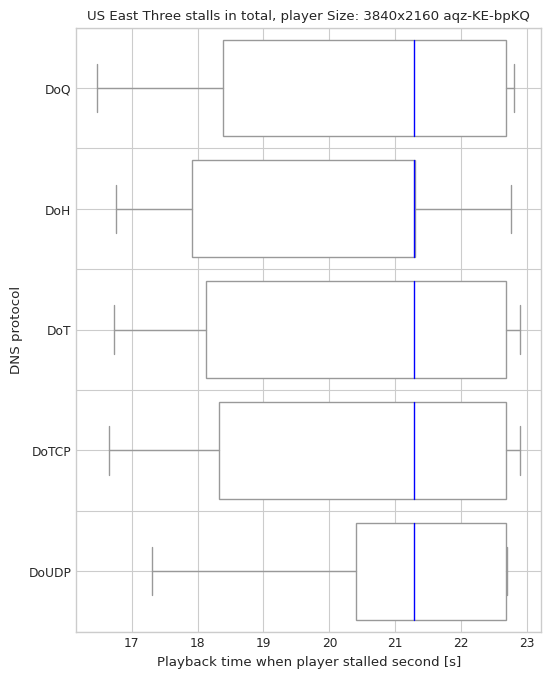

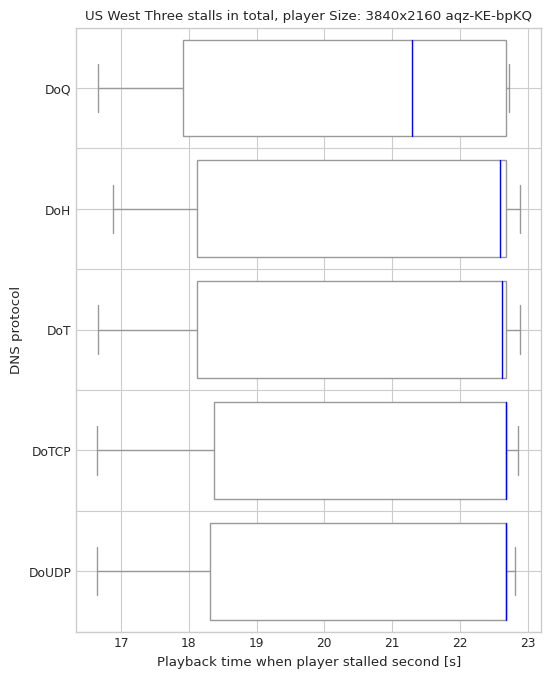

In [596]:
draw_boxplot(second_stall_of_three[second_stall_of_three.msm_id.isin(three_stalls)], 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration of the second stall [s]', 'Three stalls in total, player Size:', 'three-stalls-second-stall-stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)
draw_boxplot(second_stall_of_three[second_stall_of_three.msm_id.isin(three_stalls)], 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player stalled second [s]', 'Three stalls in total, player Size:', 'three-stalls-second-stall-buffer-events-with-play-events-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)

Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West


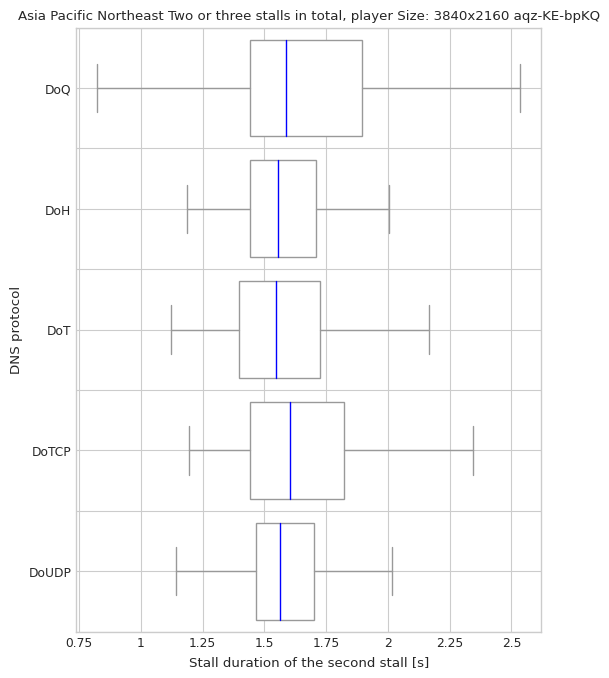

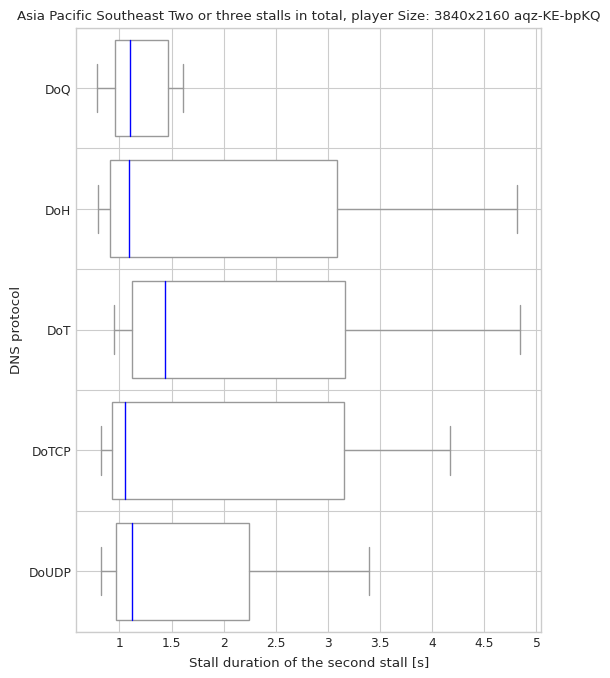

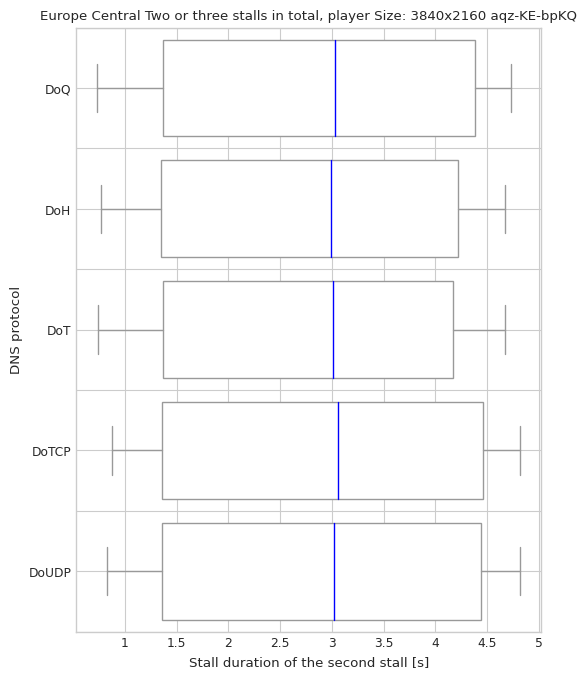

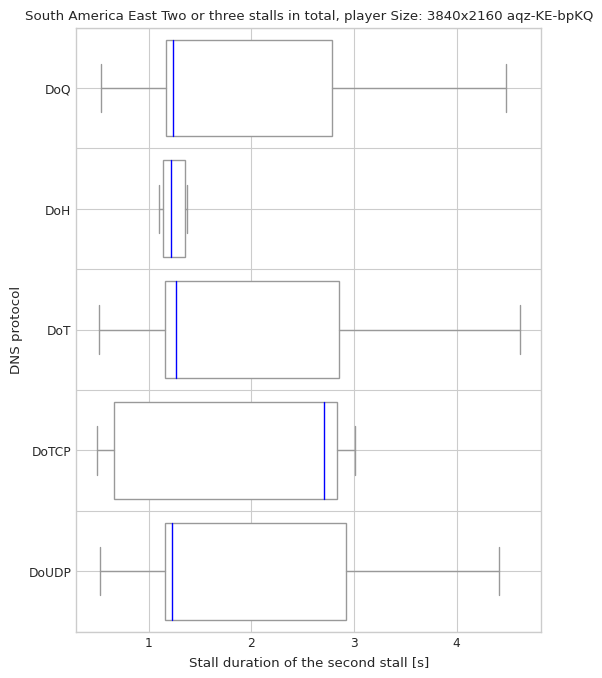

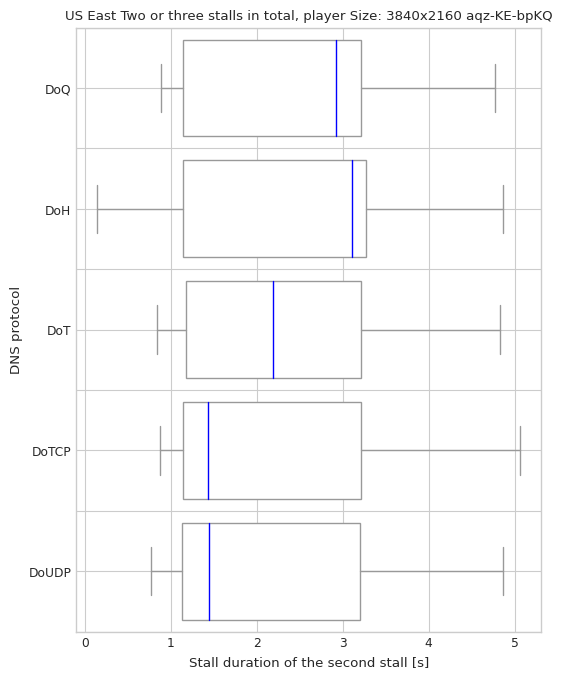

...

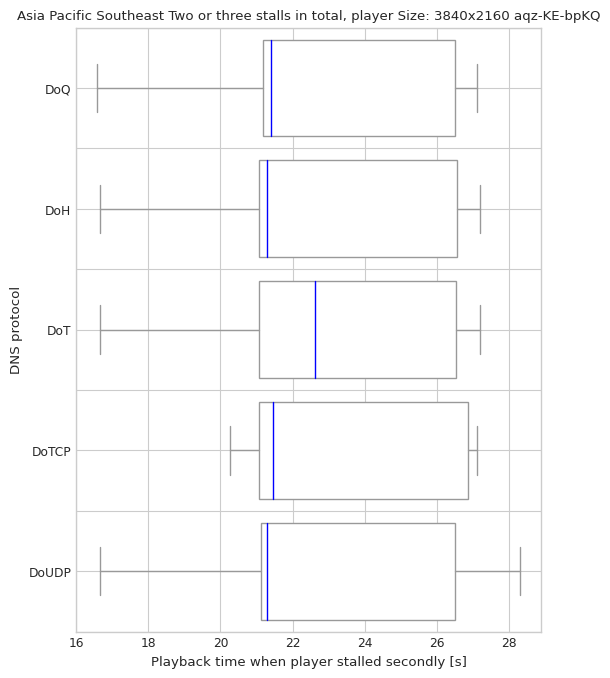

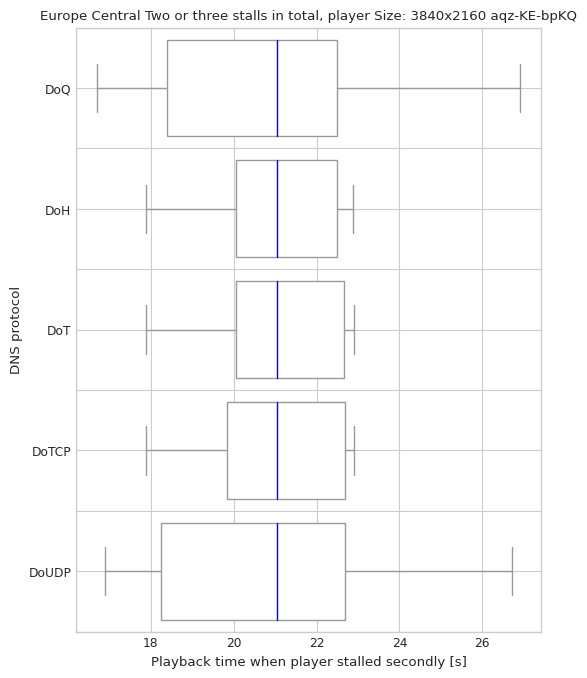

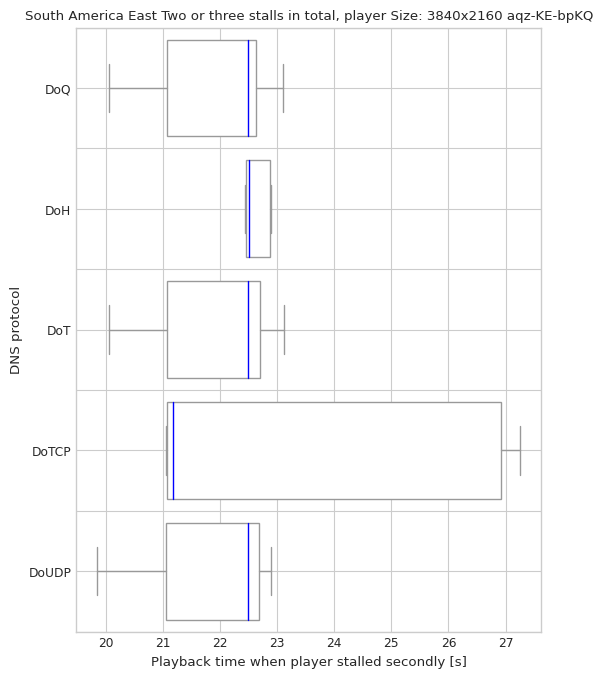

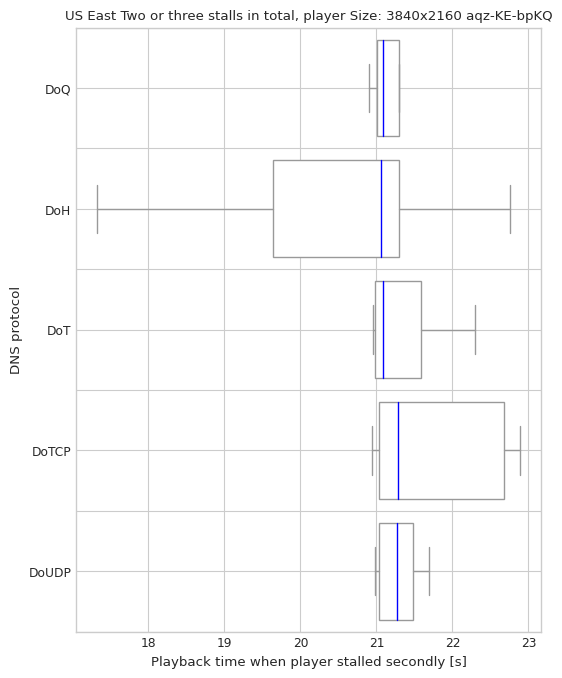

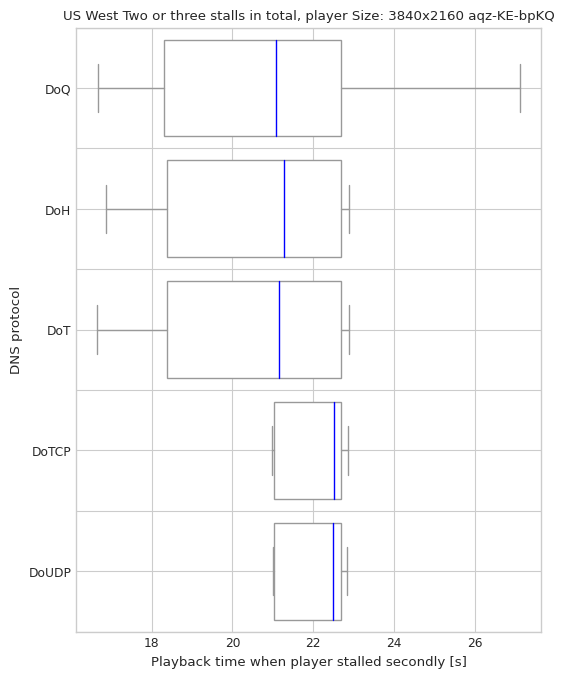

In [597]:
draw_boxplot(pd.concat([latest_stall[latest_stall.msm_id.isin(two_stalls)], second_stall_of_three[second_stall_of_three.msm_id.isin(three_stalls)]]), 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration of the second stall [s]', 'Two or three stalls in total, player Size:', 'second-stall-stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)
draw_boxplot(pd.concat([latest_stall[latest_stall.msm_id.isin(two_stalls)], second_stall_of_three[second_stall_of_three.msm_id.isin(three_stalls)]]), 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player stalled secondly [s]', 'Two or three stalls in total, player Size:', 'second-stall-buffer-events-with-play-events-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)

Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West
Asia Pacific Northeast
Asia Pacific Southeast
Europe Central
South America East
US East
US West


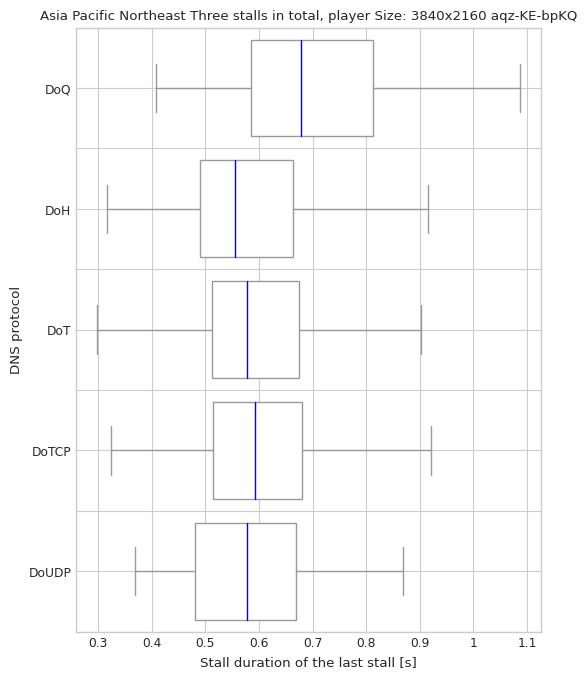

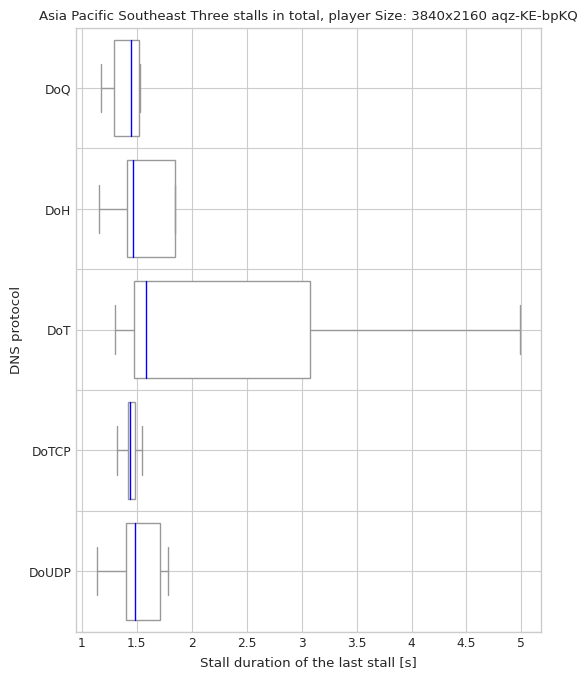

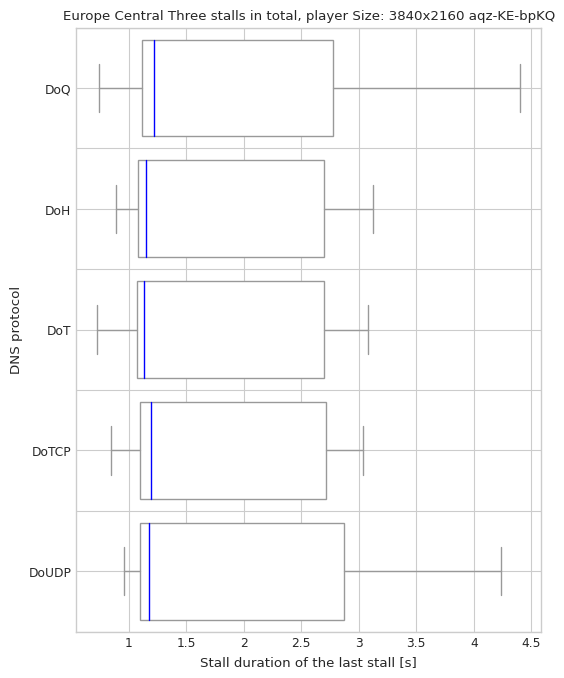

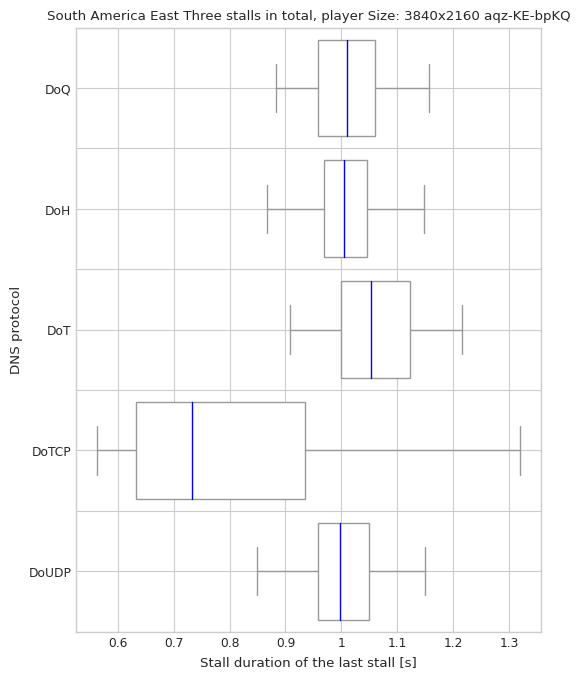

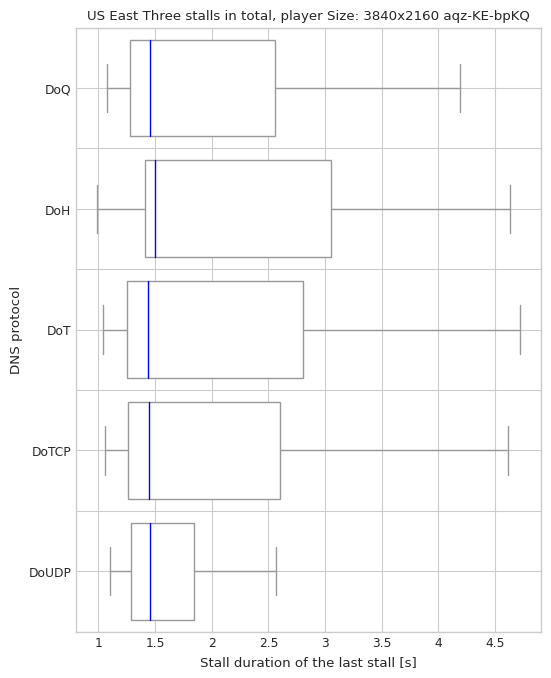

...

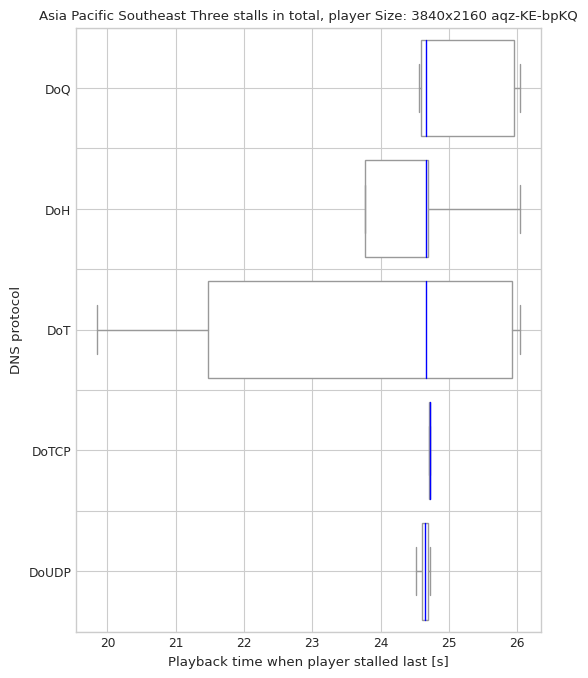

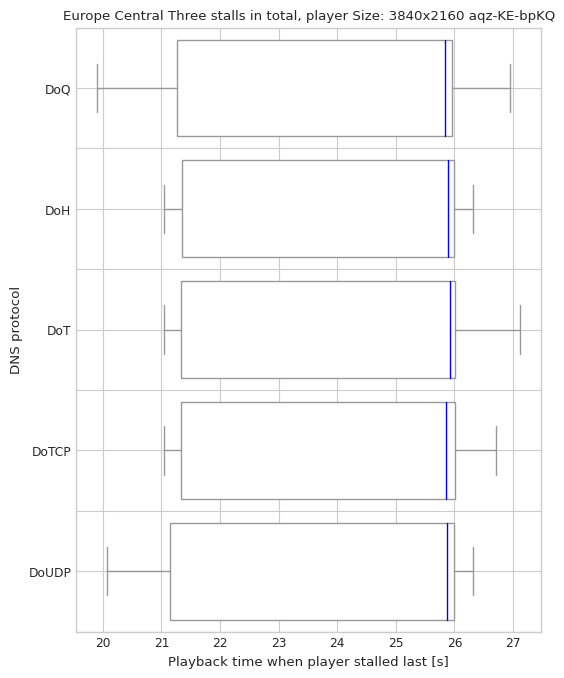

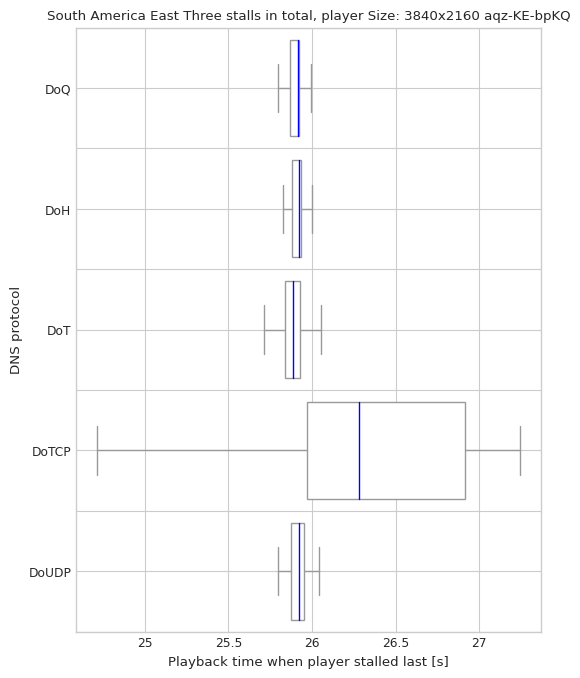

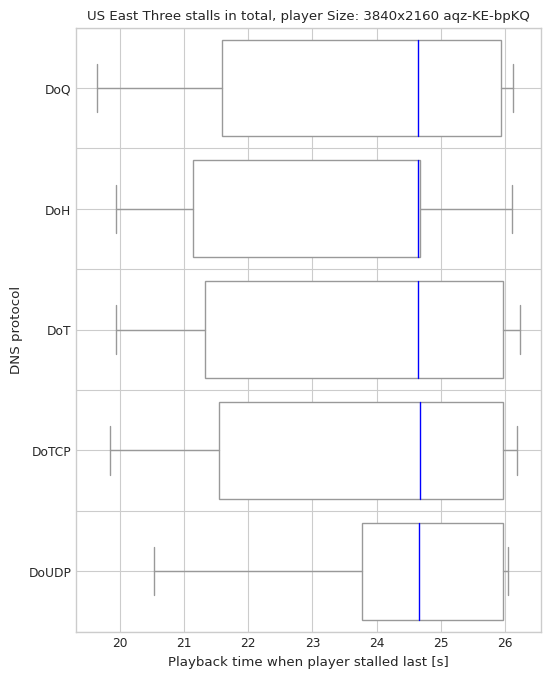

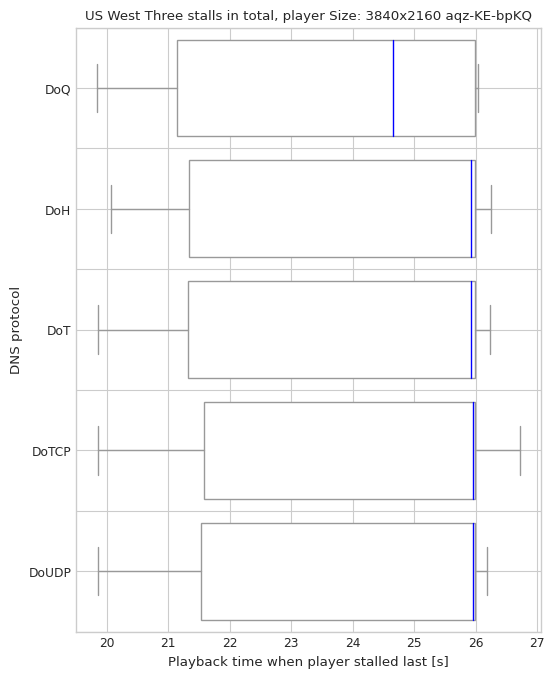

In [598]:
draw_boxplot(latest_stall[latest_stall.msm_id.isin(three_stalls)], 'player_dimensions', 'protocol', 'stall_time', [False], 'Stall duration of the last stall [s]', 'Three stalls in total, player Size:', 'three-stalls-last-stall-stall-durations-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)
draw_boxplot(latest_stall[latest_stall.msm_id.isin(three_stalls)], 'player_dimensions', 'protocol', 'curr_play_time', [False], 'Playback time when player stalled last [s]', 'Three stalls in total, player Size:', 'three-stalls-last-stall-buffer-events-with-play-events-by-player-size-and-proto', [0,0], "DNS protocol", showmean=False)

In [608]:
df_resource_timing[df_resource_timing.googlevideo == 'redirector.googlevideo.com'].vantagePoint.value_counts()

Asia Pacific Southeast    59
Africa South              26
South America East        22
Asia Pacific Northeast     5
Europe Central             5
US East                    4
US West                    2
Name: vantagePoint, dtype: int64

In [613]:
pd.merge(measurements, df_resolution_lookups[df_resolution_lookups.queried_domain.str.endswith('.googlevideo.com.')].groupby('msm_id', as_index=False).agg(num_queries=('queried_domain','count'), queried_names=('queried_domain',pd.Series.unique)), on='msm_id').sort_values('num_queries')

,msm_id,py_time,js_time,resource_time_origin,protocol,server,domain,vantagePoint,timestamp,suggested_quality,player_width,player_height,start_time,play_time,video_ids,cacheWarming,error,player_dimensions,num_queries,queried_names
0,544b9c53-fb16-e2fe-5fb0-0268b693a586,1646673799468697071,1.646674e+12,1.646674e+12,DoT,185.121.25.64,aqz-KE-bpKQ,Africa South,2022-03-07 17:22:43.846963,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,,1280x720,1,rr2---sn-5hnekn7z.googlevideo.com.
35192,b5660059-aa25-45f7-8896-28099381eb29,1646975961720044703,1.646976e+12,1.646976e+12,DoT,94.140.14.14,lqiN98z6Dak,South America East,2022-03-11 05:18:46.480332,auto,2560,1440,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,,2560x1440,1,rr4---sn-bg07dnsl.googlevideo.com.
35193,33a74815-1254-bdf3-ac37-bbb998a23664,1646976007251013596,1.646976e+12,1.646976e+12,DoT,94.140.14.14,aqz-KE-bpKQ,South America East,2022-03-11 05:19:31.680841,auto,3840,2160,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,,3840x2160,1,rr2---sn-bg07dn6r.googlevideo.com.
35195,86f4255f-8372-eaa4-6591-d9a9f6d83901,1646976094458454260,1.646976e+12,1.646976e+12,DoH,94.140.14.14,aqz-KE-bpKQ,South America East,2022-03-11 05:20:59.269241,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,,1280x720,1,rr2---sn-bg0eznek.googlevideo.com.
35196,ef9c26a9-c6ef-c441-39e8-d3c9fcafcc9a,1646976136345117466,1.646976e+12,1.646976e+12,DoH,94.140.14.14,lqiN98z6Dak,South America East,2022-03-11 05:21:41.192716,auto,1280,720,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,,1280x720,1,rr4---sn-bg0ezn7l.googlevideo.com.
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23506,e685fafa-b70c-9a43-8e96-ff01d7529d92,1646775846081752897,1.646776e+12,1.646776e+12,DoH,94.140.14.59,lqiN98z6Dak,Europe Central,2022-03-08 21:43:33.110167,auto,2560,1440,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,,2560x1440,4,"[redirector.googlevideo.com., r2---sn-4g5e6nzz..."
29252,4a881c13-e0f6-237a-c4a6-f4351c576f50,1647081547312065892,1.647082e+12,1.647082e+12,DoH,94.140.14.59,lqiN98z6Dak,Europe Central,2022-03-12 10:38:34.259472,auto,2560,1440,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,,2560x1440,4,"[redirector.googlevideo.com., r2---sn-4g5e6nzz..."
51920,547aab60-5ff4-1acf-2969-aadfdb50e31a,1647014724495236272,1.647015e+12,1.647015e+12,DoTCP,94.140.14.59,lqiN98z6Dak,US West,2022-03-11 16:04:51.165201,auto,2560,1440,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,,2560x1440,4,"[rr4---sn-a5msen7z.googlevideo.com., rr4---sn-..."
53511,bb1b84f9-0687-322b-fa30-f22f3584615b,1647101394046137502,1.647101e+12,1.647101e+12,DoUDP,94.140.14.59,aqz-KE-bpKQ,US West,2022-03-12 16:09:20.600608,auto,2560,1440,0,30,"aqz-KE-bpKQ, lqiN98z6Dak",0,,2560x1440,6,"[rr2---sn-o097znsr.googlevideo.com., rr2---sn-..."


In [615]:
df_resolution_lookups.groupby('msm_id').agg({'queried_domain':'count'}).describe()

,queried_domain
count,53670.000000
mean,9.248854
std,0.635493
min,8.000000
25%,9.000000
50%,9.000000
75%,9.000000
max,16.000000


In [616]:
df_queries_per_msm = df_resolution_lookups.groupby('msm_id').agg(num_queries=('queried_domain','count'), queried_names=('queried_domain',pd.Series.unique))
df_queries_per_msm

,num_queries,queried_names
msm_id,,
0000c85d-710c-e4df-8f0d-f4bc64dbac17,9,"[www.youtube.com., fonts.gstatic.com., static...."
0000ca8c-557d-f4c0-f38f-9ab4f628316f,9,"[www.youtube.com., fonts.gstatic.com., googlea..."
00011cc2-bc8e-214c-20b9-4a29610cbdfc,9,"[www.youtube.com., fonts.gstatic.com., googlea..."
0001402c-2c01-8135-e4c9-a91107183767,11,"[www.youtube.com., fonts.gstatic.com., googlea..."
00016162-7fd0-7bad-e433-9b925952d80e,10,"[www.youtube.com., fonts.gstatic.com., googlea..."
...,...,...
fff91fc5-d7ea-f6a4-4021-c02882311d11,9,"[www.youtube.com., fonts.gstatic.com., googlea..."
fffb4bf1-cf69-04c9-0bb1-c6546f2571e4,9,"[www.youtube.com., fonts.gstatic.com., googlea..."
fffbc4d3-c081-c9e3-8970-aae83393cf3e,9,"[www.youtube.com., fonts.gstatic.com., googlea..."


In [623]:
df_queries_per_msm[df_queries_per_msm.num_queries == 9].queried_names[0]

array(['www.youtube.com.', 'fonts.gstatic.com.',
       'static.doubleclick.net.', 'googleads.g.doubleclick.net.',
       'www.gstatic.com.', 'yt3.ggpht.com.', 'i.ytimg.com.',
       'rr4---sn-woc7ln7y.googlevideo.com.', 'www.google.com.'],
      dtype=object)